In [2]:
import numpy as np
import scipy.stats
import scipy.special
import scipy.optimize
import scipy.integrate
import matplotlib.pyplot as plt

In [3]:
title = "# Introduction"
# Print title and setup TeX defs for both KaTeX and MathJax
import bayesian_stats_course_tools
bayesian_stats_course_tools.misc.display_markdown_and_setup_tex(title)

import matplotlib.style
matplotlib.style.use("bayesian_stats_course_tools.light")

# Introduction

<!-- Define LaTeX macros -->
$\def\E{\operatorname{E}}$
$\def\Var{\operatorname{Var}}$
$\def\Cov{\operatorname{Cov}}$
$\def\dd{\mathrm{d}}$
$\def\ee{\mathrm{e}}$
$\def\Norm{\mathcal{N}}$
$\def\Uniform{\mathcal{U}}$

<!-- MathJax needs them to be defined again for the non-inline environment -->
$$\def\E{\operatorname{E}}$$
$$\def\Var{\operatorname{Var}}$$
$$\def\Cov{\operatorname{Cov}}$$
$$\def\dd{\mathrm{d}}$$
$$\def\ee{\mathrm{e}}$$
$$\def\Norm{\mathcal{N}}$$
$$\def\Uniform{\mathcal{U}}$$

# Bayesian Statistical Methods and Data Analysis

- Introductions 
- Logistics
- Structure of the course
- Intro to Python and JupyterHub

## Introductions


## Logistics

All lecture materials (slides, notebooks, etc) are available on JupyterHub (accessible from Moodle) and [github](https://github.com/tilmantroester/bayesian_statistical_methods/tree/hs24).

I will try to keep a recorded zoom connection open but the course is designed for in-person attendance.

### Grades

If you want credit points, the grade is going to be based on a small research project with a report and presentation.
- Usually the project should cover a data analysis.
    - Other topics, such as the theory behind a statistical tool can be acceptable as well
    - Project topics need to be discussed with me first
- Format: like a journal article (specifically a Letter):
    - Professional presentation, i.e. using LaTeX, nice plots
    - Proper references and appropriate structure
    - Page limit of 5 (excluding references)
    - I will add a good example report on Moodle
- Group work is strongly encouraged. Conditions:
    - Max group size: 5
    - Everyone in the group gets the same grade
    - Everyone needs to contribute to both the report and the analysis
    - The report needs to include a contribution statement that briefly describes what each member has done

Deadline is 2025/01/17 at 23:59 CET.

## Structure of the course

- Lesson, work on exercises, discuss solutions
- To get most out of the course, have a look at the material and exercises **before** the lecture
- Learning by doing: we will implement many of the basic methods ourselves to get an intuition for how they work
    - After that using well-developed and robust libraries is usually preferable


- Working in teams is encouraged
- Be ready for Clicker questions

- Feedback is always welcome!
    - EduApp: Course channel "Feedback"
    - Anonymous Google form (link on Moodle)
    - Email
    - In-person
    - Official course evaluation

## What is this course about?

### Statistical inference

Statistical inference is concerned with drawing conclusions from data about quantities that are not observed. 


### Goal of the course

The course should (hopefully) teach you how to approach statistical problems and how to solve them, while being confident in the solutions. 

So not blindly apply statistical tools following some flowchart but understand what the tools do, how they work, and when to use them.

### Bayesian data analysis

Bayesian statistics provides a framework to make inference about the world by combining data with prior knowledge.

The core of Bayesian data analyses is coming up with a probabilistic model of the world. 
These models describe both the observable and unobservable quantities of a problem in probabilistic terms.


#### Example: does it rain?

Imagine you want to know whether it rains on a mountain because you want to go on a hike. There is a weather station but unfortunately, the rain sensor is broken. 



From the weather station we have **data** on
- clouds
- humidity 
- wind speed


We have a **model** for what the clouds, humidity, and winds are like when it rains. For example, there are dark clouds and the humidity is high.


From experience having gone to this mountain before, we know that it rains at least some times but not all the time. This is our **prior** knowledge about the unknown quantity we want to infer: is it raining?



Bayesian statistics gives us a framework to infer probability that it rains from the observed data, a model for the data, and prior knowledge about rain in the region.




#### Think in distributions

In Bayesian statistics, the only thing that is exactly known are the observed data, everything else is uncertain.
To capture the complete uncertainty structure, we work with probability distributions.



In this example:
- The model of the data is a distribution: when it rains, there can be different types of clouds, humidity levels, and wind speeds. This distribution of the data given the quantity we want to infer is called the **likelihood**.
- Our prior knowledge about rain in the region is a distribution: for example, on average it rains 10% of all days and on the other 90% it does not. This is called the **prior** distribution.
- The probability of rain we infer is a distribution over the possible outcomes. This is the **posterior** distribution.


Treating everything as distributions is not just an academic exercise: knowing about the uncertainty in a quantity can be as important as its mostly likely outcome.

For example: we could ask not just if it rains but how much rain is expected.



Consider two outcomes of our analysis of the chance for rain:
- it is very likely to rain about 1mm
- it is likely to rain about 1mm but there is also a chance it might rain up to 10mm 

Both statements can be summarised as "there will likely be 1mm of rain".

But knowledge about the uncertainty is important: in the first case you might bring in umbrella, in the second case you might stay at home to avoid being caught in a downpour.

### Bayesian workflow
#### 1. Build a model
- The model should describe the data-generating process that gave rise to the observed data. 
- For example, not only predict the mean, but also the uncertainty in the data.

#### 2. Fit the model to the data
- Condition our probabilistic model on the observed data 
- Obtain the posterior distribution: the probability distribution of the unobserved quantities of interest

#### 3. Check the model
- Do the results make sense?
- Could our model have produced data like those we have observed?
- If not, go back to step 1.


### Computational statistics

Outside of simple models and special cases, our models will likely rely on numerical methods. 
This is especially the case in Bayesian data analysis, where drawing samples from complex distributions is often a key part of the analysis.

#### Monte-Carlo simulation

Once our models become complex, there are usually no analytic solutions any more. 
But we can often still _simulate_ the model and work with the simulated output to make inferences.

Much of statistical inference is about evaluating integrals. Usual integration routines do not work most of the time. For example, because the dimensionality is too high, the boundary conditions are complicated, or we cannot evaluate the integrands explicitly.

Using Monto-Carlo sampling, these problems can often be solved. 

## Literature

- Practical Statistics for Astronomers, Wall, 2012 [ETH library](https://eth.swisscovery.slsp.ch/permalink/41SLSP_ETH/lshl64/alma99117170816205503). Short, with a focus on practical applications. Many of the examples and exercises are from astrophysics but are generally applicable, especially for the physical sciences, which often come a bit short in general statistics textbooks. Solutions and data sets are [available online](https://www.astro.ubc.ca/people/jvw/ASTROSTATS/pracstats_web_ed2.html).
- Bayesian Data Analysis, Gelman, 2013 [ETH library](https://eth.swisscovery.slsp.ch/permalink/41SLSP_ETH/lshl64/alma99117222397805503), [Link](http://www.stat.columbia.edu/~gelman/book/). The title says it all.
- Statistical Rethinking, McElreath, 2020 [ETH library](https://eth.swisscovery.slsp.ch/permalink/41SLSP_ETH/lshl64/alma99117227648305503). A very nice introduction to Bayesian statistics. The book uses `R` and `stan` but implemtations in other languages are available. Unfortunately, not available online as a PDF.
- Information Theory, Inference, and Learning Algorithms, MacKay, 2003 [Link](http://www.inference.org.uk/itprnn/book.pdf). Heavy on the information theory but also covers inference methods nicely. The exercises come with solutions.
- Weighing the odds, a course in probability and statistics, Williams, 2001 [ETH library](https://eth.swisscovery.slsp.ch/permalink/41SLSP_ETH/lshl64/alma99117170967205503). A good introduction to probability theory and statistics with a high level of mathematical rigour.


## Python, Jupyter notebooks, and JupyterLab

The course focusses on computational methods to do data analysis with Bayesian statistics.

We will be using Python. There are other options, such as R and Julia, but once the models become more complex, Python has a much larger ecosystem available. 
For example astrophysics software or deep learning libraries.



### Jupyter notebooks

A key part of a statistical analysis is understanding your data.
Data exploration and visualisation is made easy by using Jupyter notebooks, which allow combining code, visualisations, and documentation in one place. 

They are not good for complex modelling however. Once your code goes beyond some simple data analysis and plotting, splitting the modelling code into standalone modules and packages makes things more robust and maintainable.



### JupyterLab

[JupyterLab](https://jupyterlab.readthedocs.io) is an environment that centres around editing notebooks in your browser but can do a lot more as well. For example, it provides debugging and version control interfaces, access to a terminal, etc. 

ETH provides an instance of JupyterLab for everyone in the course. 
This is an online development environment and comes with all the necessary packages installed. 
Changes you make will persist throughout the course. 
If you set up version control, it is easy to synchronise your JupyterLab instance with a local copy on your own device. 

You are free to use your own setup as well.

#### Using JupyterLab

If you are seeing this in the course JupyterLab, you are probably in the directory with the course materials:

<img src="../assets/jupyterlab_landing.png" height="200">

To make your life easier later on with version control, go up one level in the directory structure and make your own directory for the code you are going to write in this course:

<img src="../assets/jupyterlab_toplevel_annotated.png" height="400">

#### On your own device

All the materials can be access outside of JupyterLab as well. The repository with the course materials can be found [on github](https://github.com/tilmantroester/bayesian_statistical_methods/tree/hs24).

To set up your own computing environment I strongly recommend anaconda. Either using [miniconda](https://docs.conda.io/en/latest/miniconda.html) or the much faster [mamba](https://mamba.readthedocs.io/en/latest/installation.html#install-script) implementation.

### Useful extensions

Two very useful JupyterLab extensions are enabled on the ETH instance: debugging and version control with git.


#### Debugging

Any code ever written has bugs. Do not trust anyone that claims their code does not contain bugs. That includes yourself!

A common approach to debugging is the sprinkle `print` statements throughout the code and try to figure out when something does not work as it should.

What are some reasons why this approach might be sub optimal?

The alternative is using a debugger.

A debugger allows to
- Step through a program line-by-line
- Set breakpoints, so the execution automatically pauses when reaching the breakpoint
- Inspect the values of variables while the program is running and evaluate expressions based on them

One of the biggest downsides to using debugger used to be the set up. But JupyterLab allows [debugging](https://jupyterlab.readthedocs.io/en/latest/user/debugger.html
) of notebook cells, without having to setup `pdb`, `gdb`, etc. 

Debuggers built into other tools, such as [VS Code](https://code.visualstudio.com/), are even more powerful, with features such as [conditional breakpoints](https://code.visualstudio.com/Docs/editor/debugging#_advanced-breakpoint-topics).


![jupyterlab debugger](../assets/jupyterlab_debug_annotated.png)


#### Version control

If you are already familiar with version control and git, great! If not and your version control looks something like

- `my_great_research_project.py`
- `my_great_research_project_ver2.py`
- `my_great_research_project_ver3.py`
- `my_great_research_project_final.py`
- `my_great_research_project_really_final.py`
- `my_great_research_project_really_really_final.py`

I suggest [this introduction](https://learn.microsoft.com/en-us/training/paths/intro-to-vc-git/). Knowing how to use version control like git is essential if you work on code (or reports) together with other people. 



To use git on JupyterLab you can use either the command line interface by opening a terminal or the graphical interface provided by JupyterLab:

- Clone an existing repository:
    1. Create a repository on your provider of choice (github, gitlab, bitbucket, etc)
    2. On JupyterLab, `Git->Clone a Repository`. 
- Initialise an empty repository on JupyterLab:
    1. `Git->Initialize a Repository`
    2. If you want to synchronise with a repository outside of JupyterLab, add the remote: `Git->Manage Remote Repositories`

Once the repository is set up on JupyterLab, you can add files by right-clicking on it and selecting `Git->Add` from the context menu.

Opening the git pane on the left allows you to see the files with changes, look at the diffs, stage/unstage files, and commit the changes.


![git interface](../assets/jupyterlab_git_annotated.png)

## Your python package

The goal of this course is for you to build a toolbox with statistical and computational methods that you can use in your future data analyses. 

For that toolbox to be useful it needs to contain reusable code. Notebooks are great for quick development and data exploration but terrible for reusable and maintainable code. 
As soon as you think about copy & pasting some piece of code from one notebook to another (or within the same notebook), you should instead consider putting that piece of code into your toolbox. 

This toolbox can be made into a python package, so that you can import it where ever you need it.


For example, under `course_tools` in the course repository is a small python package with some helper functions, for example for creating the slides. 

The package can be installed from the `course_tools` directory by calling `pip install --user --editable .`

I can then `import` the package like any other python package and use it


In [1]:
import bayesian_stats_course_tools
bayesian_stats_course_tools.misc.load_tex_defs()

import matplotlib.style
matplotlib.style.use("bayesian_stats_course_tools.light")

To create your own package, have a look at the example in `course_tools` and the documentation at https://packaging.python.org/en/latest/tutorials/packaging-projects/.

The key files are
- The `pyproject.toml` file, which specifies that this is a python package
- The `src/bayesian_stats_course_tools/__init__.py`, which makes `bayesian_stats_course_tools` a python module that can be imported.

### Exercise

1. Create a new directory at the top of the JupyterLab file system
2. Create a new Python notebook

3. Obtain an estimate of the value of $\pi$
    - From the definition in `numpy`
    - Using an analytic series expansion: $\pi = 4 \sum_{k=0}^\infty \frac{(-1)^{k}}{2k + 1}$
    - Using a Monte-Carlo estimate: 
        1. Sample $n$ points uniformly on the unit square using `numpy.random.uniform`
        2. Count the number $n_{<r}$ of points with distance $r = \sqrt{x^2+y^2} \leq 1$
        3. Compare the fraction $\frac{n_{<r}}{n}$ to the ratio of the area of a quadrant of a disc to the area of the square to derive an estimate of $\pi$
    - Bonus: Repeat for (hyper) cube and (hyper) ball in 3 or more dimensions. How does the number of samples required to get a robust estimate of $\pi$ change with the number of dimensions? 

4. Use the debugger to step through some iterations of your code.

5. Create plots showing the estimated value as the number of terms in the series expansion and the number of Monte-Carlo samples is varied

In [2]:
title = "# Probabilities"
# Print title and setup TeX defs for both KaTeX and MathJax
import bayesian_stats_course_tools
bayesian_stats_course_tools.misc.display_markdown_and_setup_tex(title)

import matplotlib.style
matplotlib.style.use("bayesian_stats_course_tools.light")

# Probabilities

<!-- Define LaTeX macros -->
$\def\E{\operatorname{E}}$
$\def\Var{\operatorname{Var}}$
$\def\Cov{\operatorname{Cov}}$
$\def\dd{\mathrm{d}}$
$\def\ee{\mathrm{e}}$
$\def\Norm{\mathcal{N}}$
$\def\Uniform{\mathcal{U}}$

<!-- MathJax needs them to be defined again for the non-inline environment -->
$$\def\E{\operatorname{E}}$$
$$\def\Var{\operatorname{Var}}$$
$$\def\Cov{\operatorname{Cov}}$$
$$\def\dd{\mathrm{d}}$$
$$\def\ee{\mathrm{e}}$$
$$\def\Norm{\mathcal{N}}$$
$$\def\Uniform{\mathcal{U}}$$

## Outline 
- What are probabilities?
- Notation and basic concepts
    - Sets
    - Outcomes, events
    - Probabilities
        - Addition and multiplication
        - Independence, conditional
        - Bayes' theorem
- Exercises
    - Birthday problem
    - Monty Hall problem

## What are probabilities?

- **Probability as frequency of outcome of events**: 
    - In this way of thinking about probabilities we look at the number of times a given event happens over a large number of tries.
    - It is difficult to define consistently however, without running into circular reasoning.




- **Probability as degree of belief**: 
    - Subjective probability is associated with personal judgements about how likely something is to happen.
    - For example, 'I believe that team X will beat team Y, because teams Y's star player has an injury, while team X has been training really hard.' Such statements can be made even if teams X and Y have never played each other.
    - By requiring that two people arrive at the same conclusion if given the same assumptions and data, this definition of probability can be formalised into a mathematical system equivalent to the other definitions.



- **Probably derived from axioms**:  
    - Probability is a measure that satisfies a set of axioms derived from logic and set theory, such as the Kolmogorov or Cox axioms.
    - This sidesteps the frequentist vs Bayesian interpretation by sticking to purely mathematical concepts.

In this course we start out with this definition. 
In general we will follow the Bayesian degree-of-believe way of thinking about probability.

## Notation and basic concepts

### Set notation

- A set is a collection of elements, e.g.: $A = \{1, 2, 3\}$

- $e \in A$ means $e$ is a member of the set $A$, e.g.: $1 \in \{1, 2, 3\}$

- A set can also be represented by a rule: $\{x|x ~{\rm follows ~a ~rule} \}$

    For example, the set $E$ of even integers: $E = \{x| x=2y,\, y \in \mathbb{Z} \}$

- Set inclusion ($\subseteq$). A is included in B (or is a subset of B) if all the elements of A are also elements of B. 
    
    For example: $\{ 1, 2 \} \subseteq \{1, 2, 3\}$

#### Set operators
Let $A = \{1, 3, 5\}$; $B = \{ 2, 3, 4\}$

- **Union $\cup$**
    All elements of A and all elements of B

    $A \cup B = \{1, 2, 3, 4, 5\}$


- **Intersection $\cap$**:
    Elements that are in both A and B

    $A \cap B = \{3\} $


- **Difference $\setminus$**
    Elements that are in A but not in B

    $A \setminus B = \{1, 5\}$

    $B \setminus A = \{2, 4 \}$

- **Complement**:

    The complement of A in reference to $\Omega$ includes all elements in $\Omega$ that are not in A. 
    For the die example $\Omega = \{1, 2, 3, 4, 5, 6\}$, 

    $A^c = \{ 2, 4, 6 \}$ or 

    $A^c = \{\omega:\omega \in \Omega ~{\rm and}~ \omega\not\in A\}$

- **Empty set $\varnothing$**

    The empty set, $\varnothing$, is the complement of the universal set:

    $\Omega^c = \varnothing$ and $\varnothing^c = \Omega$.

    This means, $A\cup \varnothing = A$ and $A\cap\varnothing = \varnothing$.

- **Power set**

    Collection of all possible sets of a given set
    
    $A = \{1, 3, 5\}$
    
    $\mathcal P(A) = \left\{\varnothing,\{ 1\},\{3 \},\{5 \},\{1, 3 \},\{1, 5 \},\{3, 5 \}, \{1, 3, 5\} \right\}$

## Outcomes, events, probability

### Outcomes and sample space

The outcomes $\omega$ of an experiment are elements of the set of all possible outcomes, called the sample space $\Omega$.

Consider the experiment of tossing a (fair) coin twice:
- $\omega=\text{HH}$ ("two heads")
- $\omega \in \Omega=\{\text{HH}, \text{HT}, \text{TH}, \text{TT}\}$



### Events and event space
An event $F$ is a set of outcomes
- $F=\{\text{HH}, \text{HT}, \text{TH}\}$ ("at least one head")

Events are elements of the event space $\mathcal{F}$: the power set of the sample space (the set of all possible outcomes)

Note that $\Omega$ and $\mathcal{F}$ are not the same. The sample space contains the basic outcomes and event space contains sets of outcomes.



### Probability
The probability function $P$ assigns a probability (a number between 0 and 1) to events
- $F=\{\text{HH}, \text{HT}, \text{TH}\}$
- $\Pr(F) = \frac{3}{4}$


### Kolmogorov's axioms of probability

- The probability measure of events is a real number equal or larger than 0: 

    $0 \le \Pr(A)$

- The probability measure of the universal set is 1.

    $\Pr(\Omega) = 1$

- If the sets $A_1$, $A_2$, $A_3$ ... $\in \mathcal{F}$ are disjoint, then

    $\Pr(A_1 \cup A_2 \cup ...) = \Pr(A_1) + \Pr(A_2) + ...$

### Consequences of the axioms of probability

- Numeric bound:

    $0 \leq \Pr(A) \leq 1$

- Monoticity:

    $A\subseteq B$ then $\Pr(A) \leq \Pr(B)$

- Complement rule:

    $\Pr(A^c) = 1 - \Pr(A)$

- Sum rule:

    $\Pr(A \cup B) = \Pr(A) + \Pr(B) - \Pr(A \cap B)$

Example, a single fair die:

- $\Omega = \{1,2,3,4,5,6\}$
- $\Pr(\omega) = \frac{1}{6}\quad \forall \omega \in \Omega$
- Events $A = \{1, 3\}$ and $B = \{1,2,3,4\}$



- Monoticity:

    $A\subseteq B$, $\Pr(A)=\frac{1}{3} \leq \Pr(B)=\frac{2}{3}$
- Complement rule:

    $\Pr(A^c) = \Pr(\{2,4,5,6\}) = \frac{2}{3} = 1 - \Pr(A)$
- Sum rule:

    $\Pr(A \cup B) = \Pr(\{1,2,3,4\}) = \frac{2}{3}$

    $\Pr(A \cup B) = \Pr(A) + \Pr(B) - \Pr(A \cap B) = \frac{1}{3} + \frac{2}{3} - \Pr(\{1, 3\}) = \frac{2}{3}$

### Clicker

Two fair six-sided dice are rolled. What's the probability to obtain two sixes?
- 1/25
- 1/36
- 2/36
- 1/6

## Conditional probabilities and independence

### Conditional probabilities

The conditional probability of event A happening, given that event B happened, is

$\Pr(A|B) = \frac{\Pr(A\cap B)}{\Pr(B)}$

Instead of the Kolmogorov axioms, probability theory can also be defined in terms of conditional probabilities, using the Cox axioms.


### Independence
If A is independent of B, $\Pr(A|B) = \Pr(A)$: the conditional probability of A given B does not depend on B. From this follows that

$\Pr(A\cap B) = \Pr(A)\Pr(B)$

### Law of total probability

Let $\{H_1, H_2, ... \}$ be a countable collection of sets which is a partition of $\Omega$, where

$H_i \cap H_j = \varnothing$ for $i \ne j$

$H_1 \cup H_2 \cup ... = \Omega$

The probability of an event $D$ can be calculated as

$\Pr(D) = \Pr(D \cap H_1) + \Pr(D \cap H_2) + \dots$

or in terms of conditional probabilities

$\Pr(D) = \Pr(D | H_1)\Pr(H_1) + \Pr(D | H_2)\Pr(H_2) + \dots$

### Clicker

Two fair six-sided dice are rolled. Let A be the event that the sum of the dice is 7, and let B be the event that at least one of the two dice is a 4. Are A and B independent?


<img src="../assets/dice.png" height="400">

What about when B is the event that the first die is a 4?

<img src="../assets/dice_2.png" height="400">

### Bayes' theorem

Applying the definition of the conditional probability twice we get Bayes' theorem:

$\Pr(A|B) = \frac{\Pr(A\cap B)}{\Pr(B)} = \frac{\Pr(B|A)\Pr(A)}{\Pr(B)}$

Named after Thomas Bayes, British clergyman, 1702-1761


#### Clicker: a test for rare events

Let us assume there is a rare disease that affects 0.1% of the population. 
There is a test that can detect this disease. It has a detection efficiency of 99% and a probability of error (false-positive) of 2%. 

What is the probability $\Pr(D | +)$ of having the disease when receiving a positive test?


$\Pr(D | +) = \frac{\Pr(+ | D)\Pr(D)}{\Pr(+)} = \frac{\Pr(+ | D)\Pr(D)}{\Pr(+ | D)\Pr(D) + \Pr(+ | D^c)\Pr(D^c)}$
  (law of total probability)


- $\Pr(+ | D) = 0.99$: probability of a postive test result, given the disease is present (detection efficiency of 99%)
- $\Pr(D) = 0.001$: the disease affects 0.1% of the population
- $\Pr(+ | D^c) = 0.02$: probability of a postive test result, given the disease is not present (false-positive rate of 2%)



$\Pr(D | +) = \frac{0.99 \cdot 0.001}{0.99 \cdot 0.001 + 0.02 \cdot 0.999} = 0.047$

The disease is only present in 5% of the cases where the test is positive!


In [17]:
import numpy as np
import scipy.stats
import matplotlib.pyplot as plt

from matplotlib.animation import FuncAnimation
from IPython.display import HTML

In [32]:
title = "# Random variables and probability distributions"
# Print title and setup TeX defs for both KaTeX and MathJax
import bayesian_stats_course_tools
bayesian_stats_course_tools.misc.display_markdown_and_setup_tex(title)

import matplotlib.style
matplotlib.style.use("bayesian_stats_course_tools.light")

# Random variables and probability distributions

<!-- Define LaTeX macros -->
$\def\E{\operatorname{E}}$
$\def\Var{\operatorname{Var}}$
$\def\Cov{\operatorname{Cov}}$
$\def\dd{\mathrm{d}}$
$\def\ee{\mathrm{e}}$
$\def\Norm{\mathcal{N}}$
$\def\Uniform{\mathcal{U}}$

<!-- MathJax needs them to be defined again for the non-inline environment -->
$$\def\E{\operatorname{E}}$$
$$\def\Var{\operatorname{Var}}$$
$$\def\Cov{\operatorname{Cov}}$$
$$\def\dd{\mathrm{d}}$$
$$\def\ee{\mathrm{e}}$$
$$\def\Norm{\mathcal{N}}$$
$$\def\Uniform{\mathcal{U}}$$


Random variables (RVs) are functions of the outcomes. 

In the case of a throw of a fair die the outcomes are $\omega \in \Omega=\{1,2,3,4,5,6\}$. 
Examples of random variables $X: \Omega \rightarrow F$, $F$ a measureable space:
- $X=1$ if the thrown number is even, $X=0$ otherwise: 
$$
X(\omega) = \begin{cases}
    1 &\omega\in\{2,4,6\} \\
    0 &\omega\in\{1,3,5\}
\end{cases}
$$

- $X$ is a 3d unit vector pointing in the +x, -x, +y, -y, +z, -z directions: 
$$X(\omega) = \begin{cases}
    \vec e_x &\omega = 1 \\
    -\vec e_x &\omega = 2 \\
    \vec e_y &\omega = 3 \\
    \dots
\end{cases}$$
- $X$ is the outcome of the throw: $X(\omega) = \omega$


## Probability distributions

### Discrete random variables

If the random variable $X$ is discrete, the probability of $X$ taking the value $x$ is given by the probability mass function $p_X(x)$:
- $p_X(x) = \Pr(X = x)$
- $0 \leq p_X(x) \leq 1\ \forall x$
- $\sum_x p_X(x) = 1$


#### Example: binomial distribution

Consider an experiment that can have two outcomes: success and failure, with probability of success being $p$ and failure being $q=1-p$. 

The binomial distribution gives the probability of having success $k$ times in $n$ independent trials:

$$
\Pr(X=k) = \binom{n}{k}p^k(1-p)^{n-k}
$$
- Parameters:
    - $p$: probability of success
    - $n$: number of trials

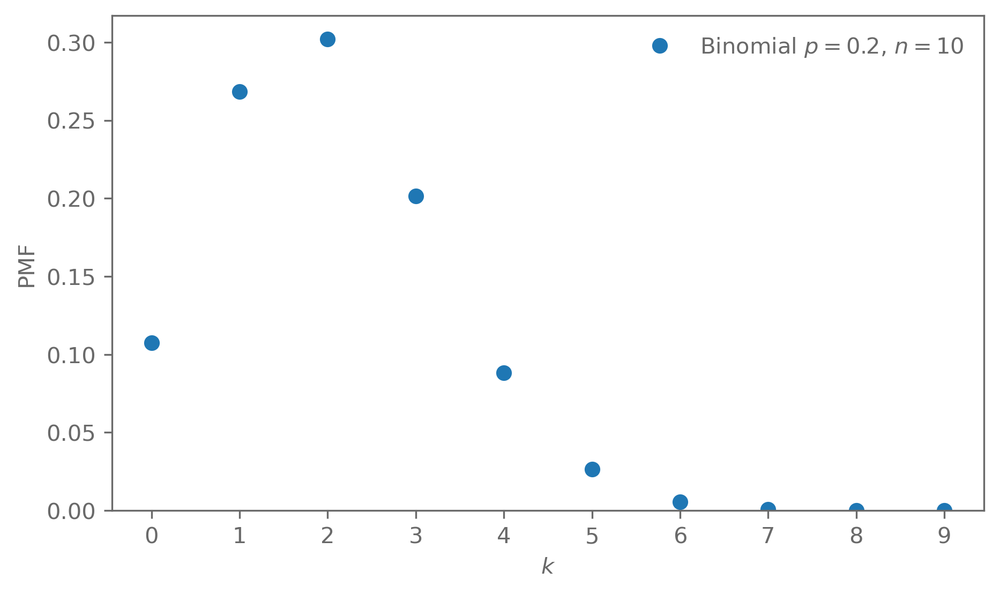

In [11]:
distr = scipy.stats.binom(p=0.2, n=10)
k = np.arange(10)
plt.plot(k, distr.pmf(k), "o", label="Binomial $p=0.2$, $n=10$")
plt.ylim(bottom=0)
plt.legend(frameon=False)
plt.xticks(k)
plt.ylabel("PMF")
plt.xlabel("$k$");

### Continuous random variables

For continuous $X$, the probability density function $f_X(x)\dd x$ is the probability of $x$ falling into the interval $[x,x+\dd x]$. 
More formally:
- $\Pr(a\leq X \leq b) = \int_a^b f_X(x)\dd x$
- $\int_{-\infty}^\infty f_X(x)\dd x = 1$
- $f_X(x) \geq 0\ \forall x$

Going forward, we will often abuse notation a bit and use $p$, such as $p(x)$, to refer to probabilities, probability density functions, probability distributions etc. From the context it is usually clear which random variable they refer to. If not, we will add the subscript for clarity.

#### Example: chi-squared distribution

The pdf of the chi-squared distribution with $\nu$ degrees of freedom is
$$
p(x) = \frac{1}{2^\frac{\nu}{2}\Gamma(\frac{\nu}{2})}x^{\frac{\nu}{2}-1}\ee^{-\frac{x}{2}}
$$
- Parameter:
    - $\nu$: number of degrees of freedom

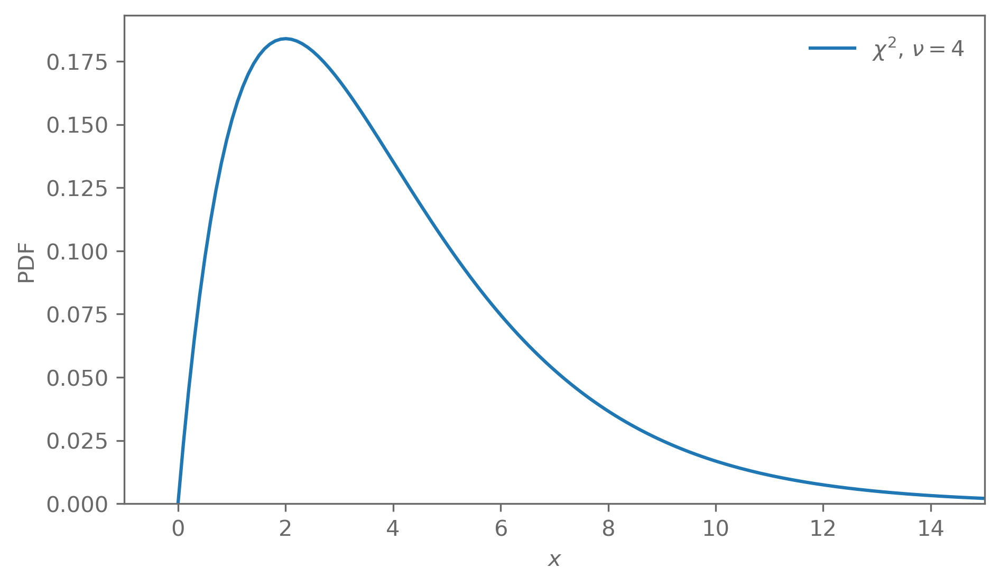

In [25]:
distr = scipy.stats.chi2(df=4)
x = np.linspace(0, 20, 200)
plt.plot(x, distr.pdf(x), label=r"$\chi^2$, $\nu=4$")
plt.ylim(bottom=0)
plt.xlim(right=15)
plt.legend(frameon=False)
# plt.xticks(k)
plt.ylabel("PDF")
plt.xlabel("$x$");

## Cumulative distribution function (CDF)

The cumulative distribution function (CDF) $F_X(x)$ is the probability of $X$ being at most $x$:

$\Pr(X \leq x) = F_X(x) = \int_{-\infty}^x f_X(x)\dd x$

The fundamental theorem of calculus gives the relationship between the probability density function and the cumulative distribution function:
- $f_X(x) = \frac{\dd }{\dd x}F_X(x)$
- $\Pr(a\leq X \leq b) = F_X(b) - F_X(a)$

Because $f_X(x) \geq 0$, it follows that $F_X(x)$ is monotonic.

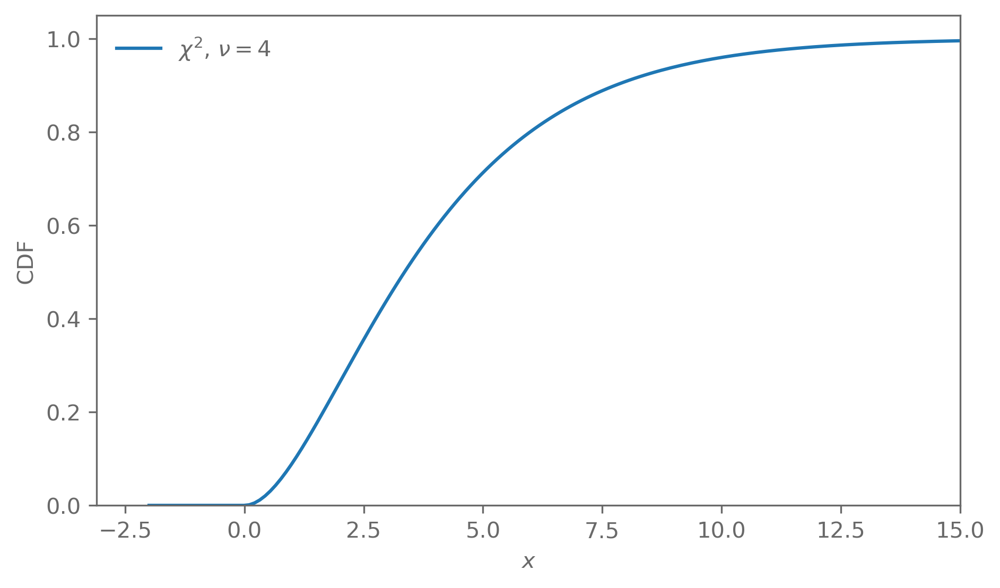

In [29]:
distr = scipy.stats.chi2(df=4)
x = np.linspace(-2, 20, 200)
plt.plot(x, distr.cdf(x), label=r"$\chi^2$, $\nu=4$")
plt.ylim(bottom=0)
plt.xlim(right=15)
plt.legend(frameon=False)
plt.ylabel("CDF")
plt.xlabel("$x$");

### Clicker

Match the PDF (1, 2, 3) with its corresponding CDF (A, B, C).

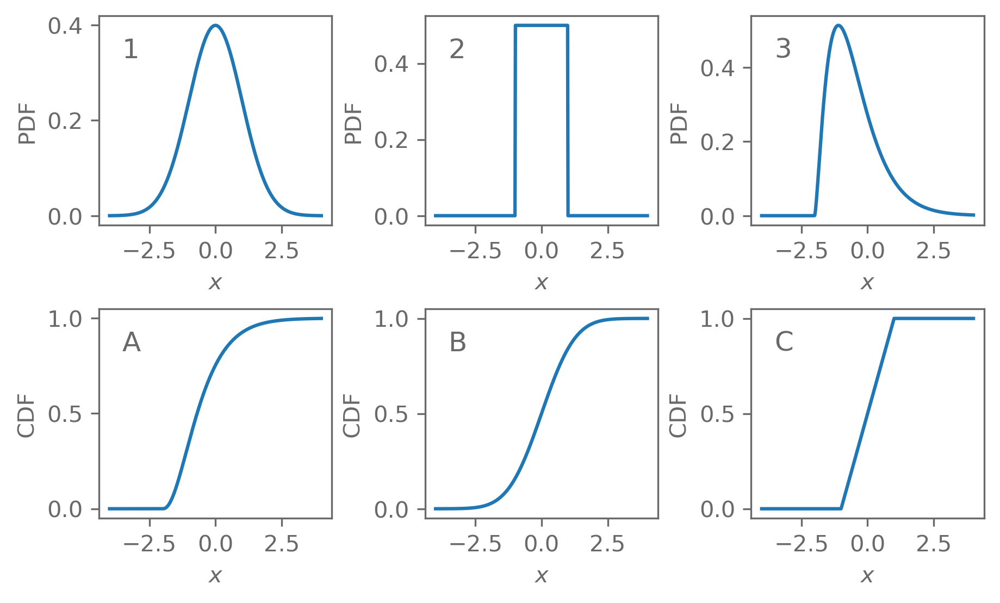

In [30]:
distr = [scipy.stats.norm(), scipy.stats.uniform(-1, 2), scipy.stats.chi2(df=5, loc=-2, scale=0.3)]

x = np.linspace(-4, 4, 500)
fig, ax = plt.subplots(2, len(distr))
fig.subplots_adjust(wspace=0.4, hspace=0.4)
idx = [2, 0, 1]

for i in range(len(distr)):
    ax[0, i].plot(x, distr[i].pdf(x))
    ax[1, i].plot(x, distr[idx[i]].cdf(x))

    ax[0, i].text(x=0.1, y=0.8, s=f"{i+1}", transform= ax[0, i].transAxes, fontsize="large")
    ax[1, i].text(x=0.1, y=0.8, s=f"{['A', 'B', 'C'][i]}", transform= ax[1, i].transAxes, fontsize="large")

    ax[0, i].set_ylabel("PDF")
    ax[0, i].set_xlabel("$x$")
    ax[1, i].set_ylabel("CDF")
    ax[1, i].set_xlabel("$x$")

fig.savefig("../assets/pdf_vs_cdf.png", dpi=300)

## Independent and identically distributed random variables

Often random variables are assumed to be independent and identically distributed (i.i.d.):
- They are mutually independent
- They are all drawn from the same probability distribution

Many theorems assume i.i.d random variables but real data often violate either or both of these assumptions!

## Change of variables

Let $g : \mathbb{R} \rightarrow \mathbb{R}$ be a monotonic function that maps the random variable $X$ to $Y$. 

What is the PDF $f_Y(y)$, $y=g(x)$ of $Y$?

The probability of $Y$ in a small interval $[y,y+\dd y]$ should be the same as that of $X$ in a small interval $[x,x+\dd x]$: $f_X(x)\dd x = f_Y(y) \dd y$

From this follows that
$$
    f_Y(y) = f_X(g^{-1}(y))\left|\frac{\dd}{\dd y}g^{-1}(y)\right|
$$

If $g$ is not monotonic,
$$
    f_Y(y) = \sum_i f_X(g_i^{-1}(y))\left|\frac{\dd}{\dd y}g_i^{-1}(y)\right| \ ,
$$
where $g_i^{-1}(y)$ are the solutions to $g(x)=y$ at $y$.


### Clicker

Let $X$ be a random variable with PDF $f_X(x) = e^{-x}$ for $x \geq 0$. If $Y = 2X$, which of the following is the correct PDF of Y?

### Inverse transform sampling

An important application of the change of variables formula is inverse transform sampling:

Let $U\sim\Uniform(0,1)$ and $Y = g(U)$

\begin{align}
    f_U(u)\dd u &= f_Y(y)\dd y \\
    \int^u f_U(u')\dd u' &= \int^{y=g(u)} f_Y(y')\dd y' \\
    F_U(u) &= u = F_Y(y) \\
    y = g(u) &= F_Y^{-1}(u)
\end{align}

If we know the inverse of the CDF of $Y$, then we can sample from the distribution of $Y$.


$$y = F_Y^{-1}(u)$$

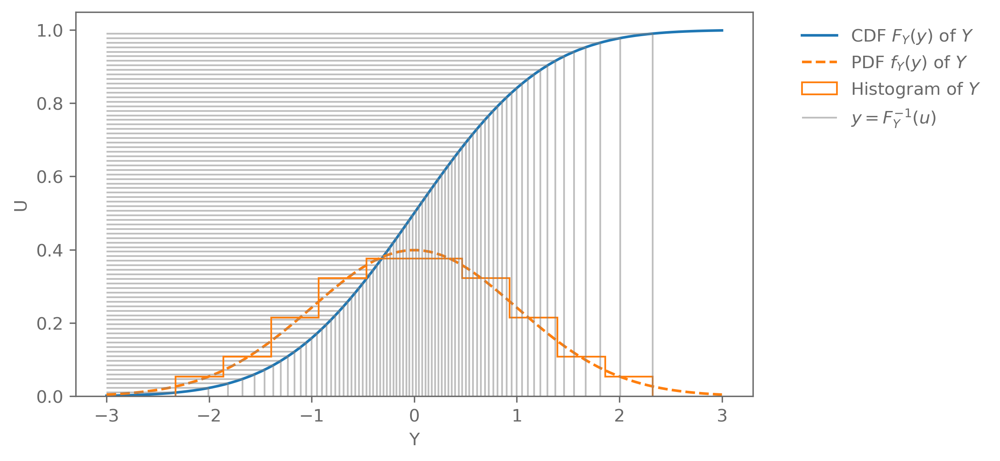

In [7]:
base_distr = scipy.stats.norm

u = np.linspace(0.01, 0.99, 80)
y = base_distr.ppf(u)

fig, ax = plt.subplots()

x = np.linspace(-3, 3, 100)
ax.plot(x, base_distr.cdf(x), label="CDF $F_Y(y)$ of $Y$", c="C0")
ax.plot(x, base_distr.pdf(x), label="PDF $f_Y(y)$ of $Y$", c="C1", ls="--")
ax.hlines(y=u, xmin=-3, xmax=y, lw=1, alpha=0.5, color="grey")
ax.hist(y, density=True, alpha=1.0, label="Histogram of $Y$", histtype="step", color="C1")
ax.vlines(x=y, ymin=0, ymax=u, lw=1, alpha=0.5, color="grey", label="$y = F_Y^{-1}(u)$")

ax.set_xlabel("Y")
ax.set_ylabel("U")
ax.legend(frameon=False, loc=2, bbox_to_anchor=(1.05, 1.))

fig.dpi = 300;

### Exercise

Sample from the distribution with PDF
$$
    p(x) = \begin{cases}
                0 & x < 0 \\
                \frac{1}{2}\sin x & \text{otherwise} \\
                0 & x > \pi
            \end{cases}
$$
- Plot the PDF and CDF
- Sample from the distribution using invere transform sampling
- Compare the histogram of the samples to the PDF


## Expectation

We usually want to know what values a random variable "typically" takes. There are many ways to define "typically" but a common one is the expectation, or mean, of the random variable $X$ with respect to its probability distribution $p_X(x)$:
\begin{equation}
    \E_{p_X(x)}[x] = \int_{-\infty}^\infty x\, p_X(x) \dd x
\end{equation}

We usually drop the subscripts if it is clear from context: $\E[x] = \int_{-\infty}^\infty x\, p(x) \dd x$

More generally, the expectation can be with respect to functions of random variables:

\begin{equation}
    \E[f(x)] = \int_{-\infty}^\infty f(x)\, p(x) \dd x
\end{equation}

We treat this as a definition but it is a consequence of the definition of the expectation and the change-of-variables formula.


### Mean and variance

Some of these functions are used often and have their own names:

Mean $\E[x]$, sometimes also written as $<x>$
- $f(x)=x$
- The value of the mean is often written as $\mu$: $\E[x] = \mu$
- For some constant $a$: $\E[x + a] = \mu + a$
- For some constant $c$: $\E[cx] = c\mu$


Variance $\Var[x]$
- $f(x) = (x - \E[x])^2$
- The value of the variance is often written as $\sigma^2$: $\Var[x] = \sigma^2$
- $\Var[x] = \E[(x - \E[x])^2] = \E[x^2] - \E[x]^2$
- For some constant $a$: $\Var[x + a] = \sigma^2$
- For some constant $c$: $\Var[cx] = c^2\sigma^2$


### Moments

More generally, the $n$-th (raw) moment is given by $\E[X^n]$.
- The first raw moment is the mean

The $n$-th central moment is given by $\E[(X-\mu)^n]$.
- The second central moment is the variance

The $n$-th standardised moment is given by $\E\left[\left(\frac{X-\mu}{\sigma}\right)^n\right]$.
- The 3rd standardised moment is called the skewness. The skewness is a measure of the asymmetry in a distribution
- The 4th standardised moment is called the kurtosis. The kurtosis measures how heavy the tails of a distribution are


### Mode

Often we are also interested in what value a random variable is most likely to take. 
This is given by the mode, which is the location of the maximum of the distribution:

$$
x^* = \underset{x}{\mathrm{argmax}}\ p(x) \,.
$$

### Exercise

Show the expressions for the mean and variance:

- For some constant $a$: $\E[x + a] = \mu + a$
- For some constant $c$: $\E[cx] = c\mu$

- $\Var[x] = \E[(x - \E[x])^2] = \E[x^2] - \E[x]^2$
- For some constant $a$: $\Var[x + a] = \sigma^2$
- For some constant $c$: $\Var[cx] = c^2\sigma^2$

## Joint distributions

The definitions so far were for univariate distributions but they can be generalised to joint distributions $f_{X_1,\dots X_n}(x_1,\dots,x_n)$ of multiple random variables:

\begin{equation}
    \Pr(X_1, \dots, X_n \in D) = \int_D f_{X_1,\dots X_n}(x_1,\dots,x_n)\dd x_1\dots \dd x_n
\end{equation}

And similarly for the CDF:

\begin{equation}
    \begin{split}
        F_{X_1,\dots X_n}(x_1,\dots,x_n) &= \Pr(X_1\leq x_1, \dots, X_n\leq x_n) \\
        &= \int_{-\infty}^{x_1}\dots \int_{-\infty}^{x_n} f_{X_1,\dots X_n}(x_1',\dots,x_n')\dd x_1'\dots \dd x_n'
    \end{split}
\end{equation}

with

$$
f_{X_1,\dots X_n}(x_1,\dots,x_n) = \frac{\partial^n }{\partial x_1\dots\partial x_n}F_{X_1,\dots X_n}(x_1,\dots,x_n)
$$


### Marginal distributions

We often only care about some subset $X_1,\dots X_j$ of random variables out of all $X_1,\dots X_n$, $j<n$. 
For example, the first $j$ RVs might correspond to physical parameters we want to infer and the others are parameters that we require in our model but do not care about their values, so-called nuisance parameters.

The marginal density function of $X$, given the joint density of $X$ and $Y$ is

\begin{equation}
    f_{X}(x) = \int f_{X,Y}(x,y)\dd y
\end{equation}

For discrete random variables we recover the formula for law of total probability from earlier:

$$p_X(x) = \sum_y p_{X,Y}(x, y) = \sum_y p_{X, Y}(x | y)p_{Y}(y)$$

This is in contrast to the conditional distribution
$$
    f_{X|Y}(x | y) = \frac{f_{XY}(x, y)}{f_Y(y)}
$$

Both of these marginal and conditional distributions are distributions of $X$. 

The marginal distribution is the distribution of $X$, with the dependence on $Y$ integrated (marginalised) out.

The conditional distribution is the distribution of $X$, given $Y=y$.

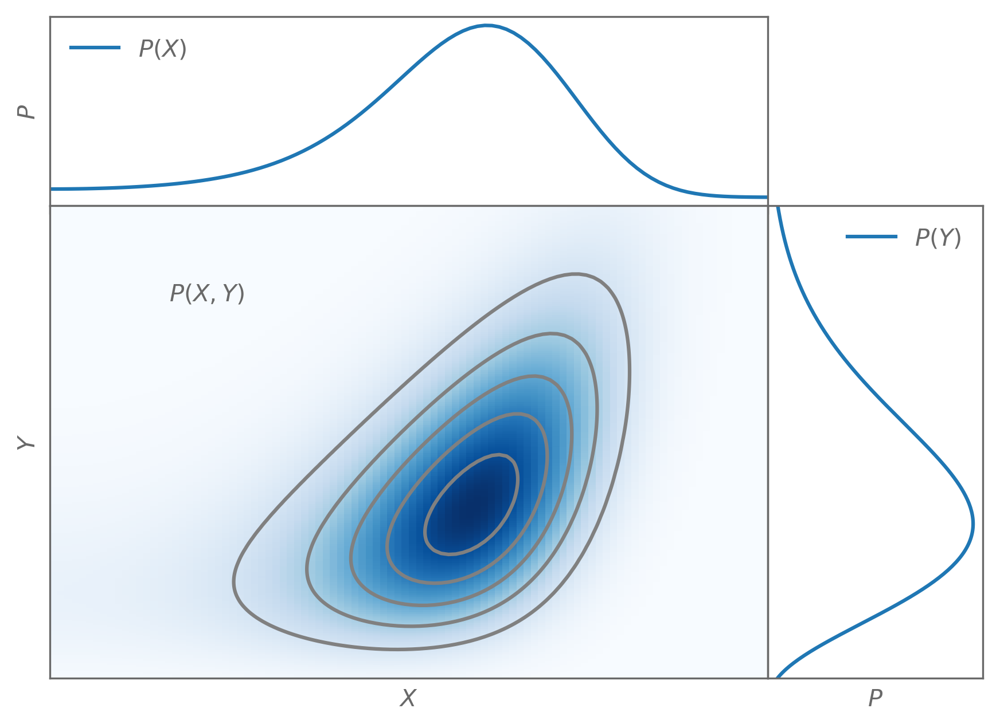

In [35]:
def make_2d_distr(n, cond_x, cond_y):
    chi2 = scipy.stats.gamma(loc=-4, a=4)
    rho = 0.8
    sigma_x = 2
    sigma_y = 3.5
    normal = scipy.stats.multivariate_normal(
        mean=[3.5, 0],
        cov=np.array([[sigma_x**2, sigma_x*sigma_y*rho],
                      [sigma_x*sigma_y*rho, sigma_y**2]])
    )
    x_range = (0, 3)
    y_range = (-3.5, 4)
    x = np.linspace(*x_range, n)
    y = np.linspace(*y_range, int((y_range[1]-y_range[0])/(x_range[1]-x_range[0])*n))
    pos = np.dstack(np.meshgrid(x**2, y))
    grid = normal.pdf(pos)
    # grid = np.ones((x.size, y.size)).T
    grid *= chi2.pdf(y)[:, None]

    dx = (x[1]-x[0])
    dy = (y[1]-y[0])
    grid /= grid.sum()*dx*dy

    x_marg = np.sum(grid, axis=0)*dy
    y_marg = np.sum(grid, axis=1)*dx

    x_cond_idx = np.searchsorted(x, cond_x)
    y_cond_idx = np.searchsorted(y, cond_y)

    y_cond = grid[:,x_cond_idx]/x_marg[x_cond_idx]
    x_cond = grid[y_cond_idx]/y_marg[y_cond_idx]

    return grid, x_marg, y_marg, x_cond, y_cond, x, y, x_range, y_range

grid, x_marg, y_marg, x_cond, y_cond, x, y, x_range, y_range = make_2d_distr(100, cond_x=1.5, cond_y=-2)

def make_joint_plot(grid, x, y, x_range, y_range):
    fig, ax = plt.subplots(
        2, 2, sharex="col", sharey="row",
        figsize=(7, 5),
        gridspec_kw=dict(
            width_ratios=[1, 0.3], height_ratios=[0.4, 1.0],
            wspace=0, hspace=0
        )
    )

    ax[1,0].contour(x, y, grid, origin="lower", extent=x_range+y_range, levels=5, colors="grey")
    ax[1,0].imshow(grid, origin="lower", extent=x_range+y_range, cmap="Blues")
    ax[1,0].set_aspect("auto")
    ax[0,1].axis("off")

    ax[0,0].tick_params(labelleft=False, left=False)
    ax[1,0].tick_params(labelbottom=False, labelleft=False, left=False, bottom=False)
    ax[1,1].tick_params(labelleft=False, left=False, labelbottom=False, bottom=False)

    ax[1,0].set_xlabel("$X$")
    ax[1,0].set_ylabel("$Y$")
    ax[1,0].text(0.5, 2.5, "$P(X,Y)$")

    return fig, ax

fig, ax = make_joint_plot(grid, x, y, x_range, y_range)

ax[0,0].plot(x, x_marg, c="C0", label="$P(X)$")
ax[1,1].plot(y_marg, y, c="C0", label="$P(Y)$")

ax[0,0].set_ylabel("$P$")
ax[1,1].set_xlabel("$P$")

ax[0,0].legend(frameon=False, loc="upper left")
ax[1,1].legend(frameon=False);

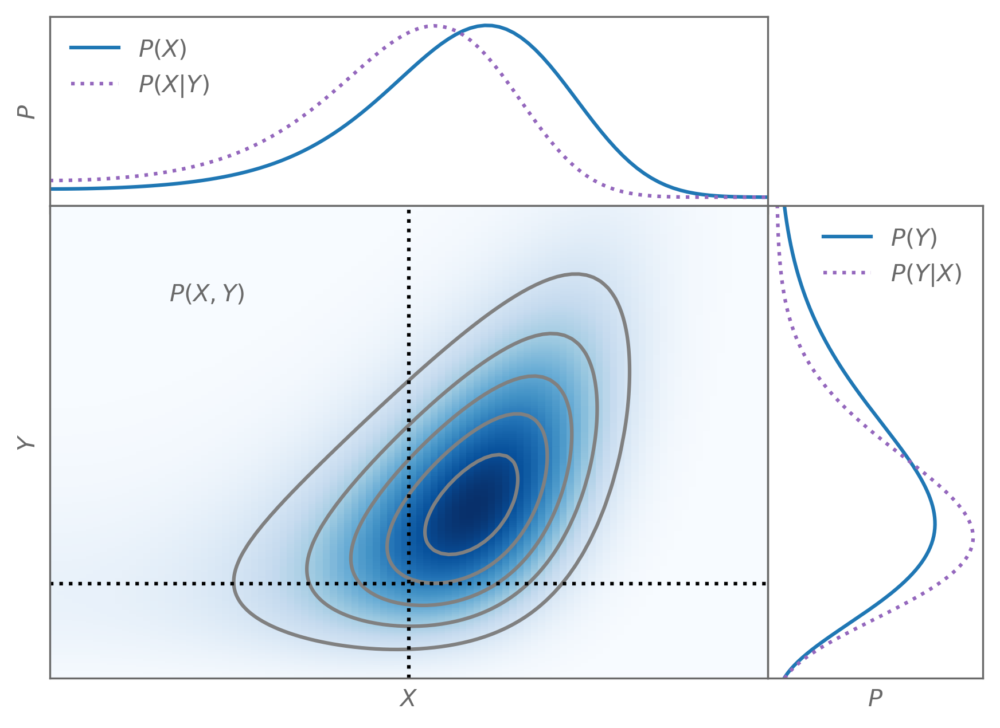

In [36]:
fig, ax = make_joint_plot(grid, x, y, x_range, y_range)

ax[0,0].plot(x, x_marg, c="C0", label="$P(X)$")
ax[1,1].plot(y_marg, y, c="C0", label="$P(Y)$")

ax[0,0].plot(x, x_cond, c="C4", ls=":", label="$P(X|Y)$")
ax[1,1].plot(y_cond, y, c="C4", ls=":", label="$P(Y|X)$")

ax[1,0].axhline(y=-2, c="k", ls=":")
ax[1,0].axvline(x=1.5, c="k", ls=":")

ax[0,0].set_ylabel("$P$")
ax[1,1].set_xlabel("$P$")

ax[0,0].legend(frameon=False, loc="upper left")
ax[1,1].legend(frameon=False);

### Change of variables

In the multivariate case, $\vec y = g(\vec x)$ and $g : \mathbb{R}^n \rightarrow \mathbb{R}^n$.

The PDF $f_{Y}(\vec y)$ is given by

\begin{equation}
    f_{Y}(\vec y) = f_X\left(g^{-1}(\vec y)\right)|J|
\end{equation}

where $|J|$ is the determinant of the Jacobian of $g^{-1}(\vec y)$

$$
    J_{ij} = \frac{\partial g^{-1}_i(\vec y)}{\partial y_j}
$$

The deep learning method of normalising flows is based on this formula.

## Common probability distributions


### Uniform

The uniform distribution has equal probability within its support and zero outside.



### Clicker

Consider the uniform distribution on the interval $x \in [2, 5]$: $\mathcal{U}(2, 5)$.

If $X \sim \mathcal{U}(2, 5)$, what is the probability density function $p_X(x)$ for $x \in [2, 5]$?

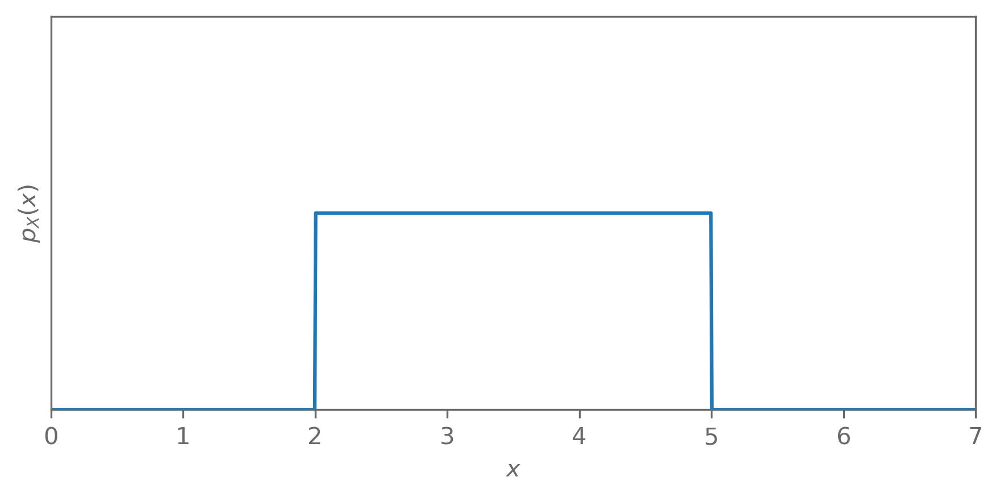

In [51]:
x = np.linspace(0, 7, 1000)
f = np.piecewise(x, (2 < x) & (x < 5), [1, 0])

plt.figure(figsize=(7, 3))
plt.plot(x, f)
plt.xlabel("$x$")
plt.ylabel("$p_X(x)$")
plt.tick_params("y", labelleft=False, left=False)
plt.ylim(bottom=0, top=2)
plt.xlim(0, 7);

### Uniform

The uniform distribution has equal probability within its support and zero outside.

$$
p(x) = \begin{cases}
    \frac{1}{b-a} &x\in[a,b] \\
    0 &\text{otherwise}
\end{cases}
$$
- Parameters:
    - $a$: lower bound
    - $b$: upper bound
- Symbol: $X\sim\Uniform(a, b)$
- Mean: $\frac{a+b}{2}$
- Variance: $\frac{(b-a)^2}{12}$


### Binomial

Consider an experiment that can have two outcomes: success and failure, with probability of success being $p$ and failure being $q=1-p$. 

The binomial distribution gives the probability of having success $k$ times in $n$ independent trials:

$$
\Pr(X=k) = \binom{n}{k}p^k(1-p)^{n-k}
$$
- Parameters:
    - $p$: probability of success
    - $n$: number of trials
- Mean: $\E[X]=np$
- Variance: $\Var[X]=np(1-p)$

As $n\to\infty$, with $p$ fixed, the binomial distribution approaches a normal distribution.

As $n\to\infty$, with $np$ fixed, the binomial distribution approaches a Poisson distribution.


### Multinomial

Instead of only having two outcomes, consider an experiment that can have $k$ outcomes with probabilities $p_1,\dots,p_k$, $\sum_i p_i = 1$.

The multinomial distribution gives the probability that in $n$ trials, outcome $i\in\{1,\dots,k\}$ occurred $x_i$ times. Each trial only has one outcome, so $\sum_i x_i = n$. 

$$
\Pr(X=x_1,\dots,x_k) = \frac{n!}{x_1!\dots x_k!}p_1^{x_1}\dots p_k^{x_k}
$$
- Parameters:
    - $p_i$: probabilities of outcomes $i\in\{1,\dots,k\}$
    - $n$: number of trials
- Mean: $\E[X_i] = n p_i$
- Covariance: $\Cov[X_i, X_j] = \delta_{ij}n p_i - n p_i p_j$


### Poisson

The Poisson distribution gives the probability of $k$ (independent) events happening in a time interval, with expected rate $\lambda$.

$$
\Pr(X=k) = \frac{\lambda^k}{k!}\ee^{-\lambda}
$$
- Parameter:
    - $\lambda$: event rate
- Mean: $\lambda$
- Variance: $\lambda$

The Poisson distribution appears commonly when events are rare and independent. Examples are decay of nuclei, arrival of photons in telescopes. 
Note that the interval for which the rate is defined does not need to be a time interval, it can also be spatial. 

As $\lambda\to\infty$, the Poisson distribution approaches a normal distribution.


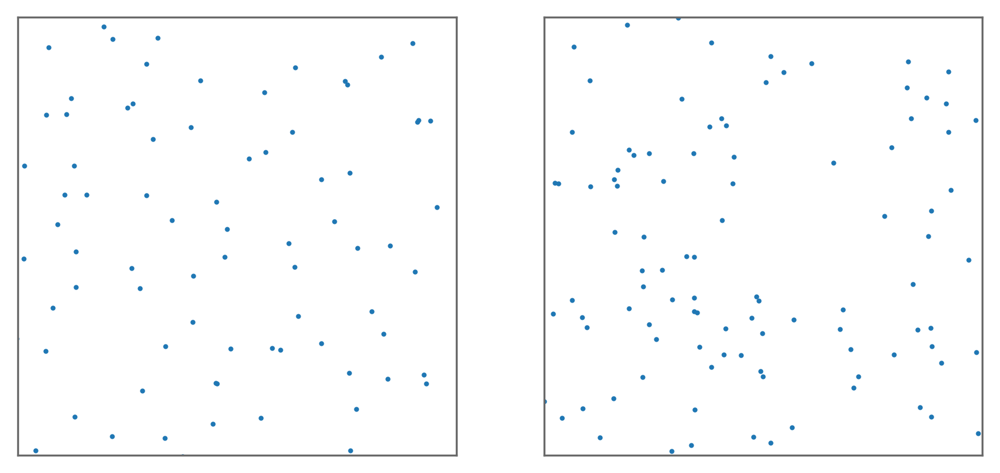

In [39]:
n = 10
fig, ax = plt.subplots(1, 2)

points = np.dstack(np.meshgrid(np.linspace(0, 1, n),  np.linspace(0, 1, n))).reshape(-1, 2)
points += np.random.normal(size=(n**2, 2))*0.04

points_poisson = np.random.uniform(size=points.shape)

ax[0].scatter(*points.T, s=1)
ax[1].scatter(*points_poisson.T, s=1)

ax[0].set_xlim(0, 1)
ax[0].set_ylim(0, 1)
ax[1].set_xlim(0, 1)
ax[1].set_ylim(0, 1)

ax[0].set_aspect("equal")
ax[1].set_aspect("equal")

ax[0].tick_params(labelbottom=False, labelleft=False, left=False, bottom=False)
ax[1].tick_params(labelbottom=False, labelleft=False, left=False, bottom=False)

fig.dpi = 300;


### Exercises

- Confirm by simulation that the probability of $k$ out of $n$ iid $X_i\sim\Uniform(0,1)$ being in a small interval $\Delta x$ follows a Poisson distribution.
- Derive the Poisson distribution from the binomial distribution.

### Normal

Also called Gaussian distribution. If there is only one distribution you need to remember, it is this one. It appears *everywhere*, and has many fascinating properties.

$$
p(x) = \frac{1}{\sqrt{2\pi\sigma^2}}\ee^{-\frac{(x-\mu)^2}{2\sigma^2}}
$$
- Parameters:
    - $\mu$: mean
    - $\sigma^2$: variance
- Symbol: $X\sim\Norm(\mu, \sigma^2)$
- Mean: $\mu$
- Variance: $\sigma^2$



Some properties:
- Sums of Gaussian RVs are Gaussian
- Jointly Gaussian RVs that are uncorrelated are independent. This is not true in general!
- Sample mean and sample variance are independent
- For a given mean and variance, the normal distribution is the distribution with the highest entropy
 

### Multivariate normal

Multivariate generalisation of the normal distribution. Let $\vec x \in \mathbb{R}^n$, then
$$
p(\vec x) = \frac{1}{(2\pi)^\frac{n}{2}\det\Sigma}\exp\left(-\frac{1}{2}(\vec x - \vec\mu)^T\Sigma^{-1}(\vec x - \vec\mu)\right)
$$
- Parameters:
    - $\vec\mu$: mean
    - $\Sigma$: covariance
- Symbol: $\vec X\sim \Norm(\vec\mu, \Sigma)$
- Mean: $\vec\mu$
- Covariance: $\Sigma$, positive definite symmetric matrix

### Chi-squared

The square of a normally distributed RV $X \sim \Norm(0, 1)$ is chi-squared distributed with 1 degree of freedom. 

The sum of the squares of $n$ iid $X_i \sim \Norm(0, 1)$ is chi-squared distributed with $n$ degrees of freedom: $\sum_i^n X_i^2 \sim \chi^2_n$

The pdf of the chi-squared distribution with $\nu$ degrees of freedom is
$$
p(x) = \frac{1}{2^\frac{\nu}{2}\Gamma(\frac{\nu}{2})}x^{\frac{\nu}{2}-1}\ee^{-\frac{x}{2}}
$$
- Parameter:
    - $\nu$: number of degrees of freedom
- Symbol: $\chi^2_\nu$
- Mean: $\nu$
- Variance: $2\nu$

Approaches a normal distribution for large $\nu$.


An important application is that for a $n$-dimensional multivariate RV $\vec X\sim\Norm(\vec\mu, \Sigma)$, we have

$$(\vec X - \vec\mu)^T\Sigma^{-1}(\vec X - \vec\mu)\sim\chi^2_{n}$$

We will come back to this when we look at the goodness of fit in Gaussian likelihoods.


### Cauchy

The Cauchy distribution comes up occationally and sets itself apart by how pathological it is. 
The PDF looks innocuous but it has no defined mean or variance.
$$
    p(x) = \frac{1}{\pi\gamma\left(1+\frac{(x-x_0)^2}{\gamma}\right)}
$$
- Parameters:
    - $x_0$: location
    - $\gamma$: scale
- Mean: undefined!
- Variance: undefined!


### Power law

Scale invariance is a property that is common in the physical sciences. Consider the function $f(x) = a x^{-k}$. The function does not change it shape when scaling the argument, it is scale invariant: 
$$
    f(cx) = c^{-k} f(x)\propto f(x)\ .
$$


Depending on the exponent, such function cannot be a probability distribution. In practice, there are physical lower and/or upper limits that make the distribution well-defined. 
The PDF is
$$
    f(x) = 
        \begin{cases}
            \frac{1-\alpha}{b^{1-\alpha} - a^{1-\alpha}} x^{-\alpha} & a \leq x \leq b \\
            0 &\text{otherwise}
        \end{cases}\ ,
$$
with CDF
$$
    F(x) = 
        \begin{cases}
            0 &x < a \\
            \frac{1}{b^{1-\alpha} - a^{1-\alpha}} \left(x^{1-\alpha} -  a^{1-\alpha}\right) & a \leq x \leq b \\
            1 & x > b
        \end{cases}\ .
$$
- Parameters:
    - $a$, $b$: lower and upper limits
    - $\alpha$: power low exponent

The mean and variance are formally defined for appropriate lower/upper limits and exponents. They are usually poor descriptors for the distribution, however. For steep power laws, these distributions can behave quite unintuitively.

## Central limit theorem

One reason the normal distribution is so ubiquitous is the central limit theorem:

The mean $\bar X_n = \frac{X_1 + \dots + X_n}{n}$ of $n$ iid RVs with $\E[X_i]=\mu$ and $\Var[X_i]=\sigma^2 <\infty$ tends to a normal distribution. 
$$
\sqrt{n}\frac{\bar X_n - \mu}{\sigma} \xrightarrow{d} \Norm(0, 1)\quad(n\to\infty)
$$

In [9]:
def get_samples(n, base_distr, n_sample=50000):
    samples = base_distr.rvs(size=(n, n_sample)).mean(axis=0)
    samples = (samples - base_distr.mean())/base_distr.std()*np.sqrt(n)
    return samples

fig, ax = plt.subplots(1, 1)
fig.subplots_adjust(top=0.9, bottom=0.2)

x = np.linspace(-5, 5, 100)

base_distr = scipy.stats.chi2(df=2)
samples = get_samples(n=1, base_distr=base_distr)

# ax.plot([], [], ls="none", label=r"$X_i\sim \chi^2_{\nu=2},\, i=1,\dots,n$")
ax.set_title(r"$X_i\sim \chi^2_{\nu=2},\, i=1,\dots,n$")
_, bins, hist_container = ax.hist(
    samples, bins=np.linspace(-5, 5, 50), density=True,
    facecolor="C0", alpha=0.7,
    label=r"$\frac{\sqrt{n}(\bar X_n - \mu)}{\sigma}$"
)
ax.plot(x, scipy.stats.norm().pdf(x), c="grey", label=r"$\mathcal{N}(0,1)$")

ax.set_xlim(-5, 5)
ax.set_ylim(top=0.65)
ax.legend(frameon=False, loc=(0.65, 0.7), fontsize="x-large")
counter = ax.text(2.8, 0.4, f"$n={1}$", fontsize="x-large")

ax.set_xlabel(r"$\bar X_n = \frac{1}{n}\sum_i^n X_i$")
ax.set_ylabel("$P$")

def update(i):
    samples = get_samples(n=i, base_distr=base_distr)
    n, _ = np.histogram(samples, bins)
    n = n/(n.sum()*(bins[1]-bins[0]))
    for count, rect in zip(n, hist_container.patches):
        rect.set_height(count)
    counter.set_text(f"$n={i}$")
    return hist_container.patches

ani = FuncAnimation(
    fig, update, np.unique(np.geomspace(1, 1000, 50, dtype=int)),
    repeat=False, blit=True, interval=400
)
plt.close()
HTML(ani.to_jshtml())


- The CLT can be generalised for non-iid random variables in certain cases but care needs to be taken when trying to apply it to non-iid data.

- The "limit" part in the CLT is important - for finite $n$ (which is always the case for real data) the distribution of the mean might not have sufficiently converged.

## Exercises

- Make plots of the PDFs of the distributions we covered so far, varying their parameters
- Compute the distribution of the sum of two independent Gaussian RVs.
- What is the distribution of the sum of two independent RVs $X\sim f$ and $Y\sim g$?
- Derive the PDF of the $\chi^2_{\nu=1}$ distribution
- Bonus:
    - What is the product of two independent RVs $U$ and $V$?
    - Compute the distribution of the ratio of two Gaussian RVs.


In [1]:
import numpy as np
import scipy.stats
import scipy.special
import scipy.optimize
import scipy.integrate
import matplotlib.pyplot as plt

In [121]:
title = "# Introduction to Bayesian statistics"
# Print title and setup TeX defs for both KaTeX and MathJax
import bayesian_stats_course_tools
bayesian_stats_course_tools.misc.display_markdown_and_setup_tex(title)

import matplotlib.style
matplotlib.style.use("bayesian_stats_course_tools.light")

# Introduction to Bayesian statistics

<!-- Define LaTeX macros -->
$\def\E{\operatorname{E}}$
$\def\Var{\operatorname{Var}}$
$\def\Cov{\operatorname{Cov}}$
$\def\dd{\mathrm{d}}$
$\def\ee{\mathrm{e}}$
$\def\Norm{\mathcal{N}}$
$\def\Uniform{\mathcal{U}}$

<!-- MathJax needs them to be defined again for the non-inline environment -->
$$\def\E{\operatorname{E}}$$
$$\def\Var{\operatorname{Var}}$$
$$\def\Cov{\operatorname{Cov}}$$
$$\def\dd{\mathrm{d}}$$
$$\def\ee{\mathrm{e}}$$
$$\def\Norm{\mathcal{N}}$$
$$\def\Uniform{\mathcal{U}}$$

In Bayesian statistics we want to infer the probability distribution of some unobserved parameters $\theta$, given some data $d$. 

That is, we want to infer the *posterior* probability distribution $p(\theta | d)$. It is called posterior, because it describes the probability of $\theta$ *after* we have observed the data.

Using Bayes' theorem, we can write the posterior as
$$
    p(\theta | d) = \frac{p(d | \theta)p(\theta)}{p(d)}
$$



The different terms on the right-hand side have specific names:
- The *likelihood* $p(d | \theta)$ is the probability of the data $d$, given the parameters $\theta$
- The *prior* $p(\theta)$ is the probability of the parameters $\theta$ (in the sense of our degree of believe) *before* we observe the data $d$. 
- The *evidence* $p(d)$ (sometimes also called marginal likelihood) can often be treated as an overall normalisation factor and ignored. It becomes important for model comparison, however.

The power of Bayes' theorem comes from how it relates what we want to know (the probability of the parameters, given the data) to what we can calculate (the probability of the data, given the parameters).

Consider the case of an urn with $n$ balls, $r$ of which are red and $w$ of which are white. The question is then often along the lines of "what is the probability of getting 2 red balls in 5 draws?"



In science, we are usually faced with a different problem: we have just drawn 2 red balls and 3 white ones and we want to know how many balls of each kind are in the urn.

Here Bayes comes to the rescue:
$$
    p(\text{content of urn}|\text{data}) \propto p(\text{data}|\text{content of urn})p(\text{content of urn})
$$

### Likelihood

The first term is the likelihood $p(\text{data}|\text{content of urn})$, which we can (usually) calculate.

Assuming that we are drawing with replacement, no clumping of the balls or other funny business, the probability of drawing a red ball is $\theta=\frac{r}{n}$.

We assume we know the total number of balls in the urn $n$.



The probability of drawing $k$ red balls in $t$ trials it is given by a binomial distribution:
$$
    p(k, t| r) = \binom{t}{k}\left(\frac{r}{n}\right)^k\left(1-\frac{r}{n}\right)^{t-k}
$$
Here the data are $k$ and $t$, the number of red balls we have drawn $k$ and the number of trials $t$. 

The parameter is $r$, the number of red balls in the urn. 



### Prior

The second term is the prior $p(\text{content of urn})$, which we need to define. 

Assuming we have no prior information or other indication on how many of the balls are red, a reasonable assumption is that the number of red balls is equally likely between 0 and $n$:

$$
    p(r) = \frac{1}{n+1}
$$

### Posterior

What is the probability distribution of $r$, the number of red balls, given 2 red balls were drawn in 5 trials? I.e.
$$
    p(r | k=2, t=5)
$$

Define our likelihood, prior, and posterior:

In [87]:
n = 10

def likelihood(k, t, r):
    theta = r/n
    return scipy.special.binom(t, k) * theta**k * (1-theta)**(t-k)

def prior(r):
    p = 1/(n+1)
    return p * np.ones_like(r)  # Make prior(r) play nice if r is an array

def posterior(r, k, t):
    return likelihood(k, t, r) * prior(r)

### Clicker

Compute the posterior distribution of the $r$, the number of red balls in the urn, given that 2 red balls were drawn out of an urn with 10 balls in 5 trials.

What is the most likely value of red balls? For this we need to find the maximum of the posterior. This is called the maximum a-posteriori (MAP) and is the "best-fit" value:
$$
    r_\mathrm{MAP} = \underset{r}{\mathrm{argmax}}\ p(r| k=2, t=5)
$$

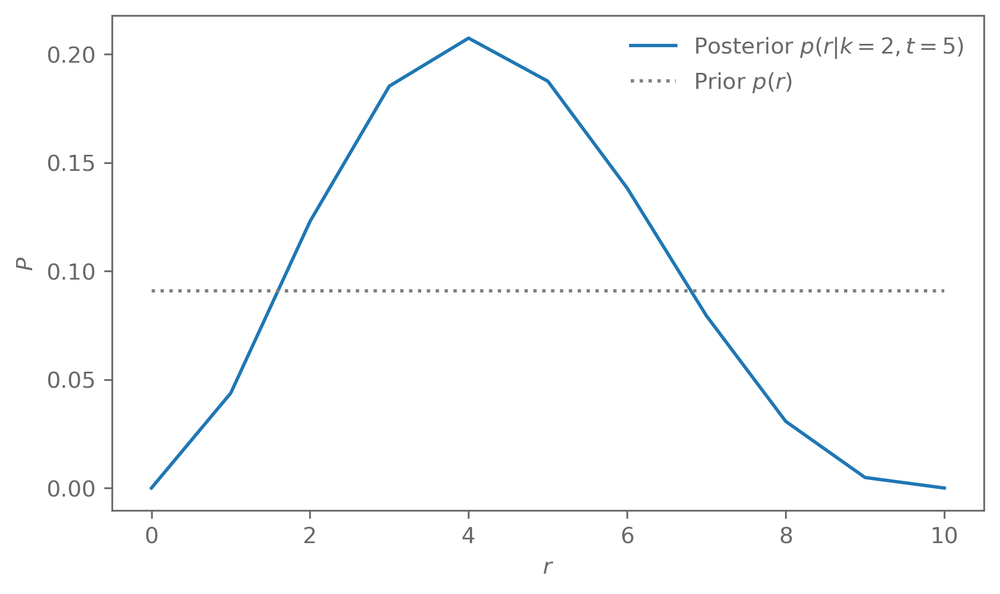

In [89]:
r = np.arange(0, n+1)

posterior_2_5 = posterior(r, k=2, t=5)
# Normalise the posterior
posterior_2_5 /= posterior_2_5.sum()

plt.plot(r, posterior_2_5, label="Posterior $p(r|k=2, t=5)$")
plt.plot(r, prior(r), c="grey", ls=":", label="Prior $p(r)$")
plt.legend()
plt.ylabel("$P$")
plt.xlabel("$r$");

### Clicker

How does the posterior change when 20 red balls were drawn in 50 trials (still with the same total number of 10 balls in the urn)?

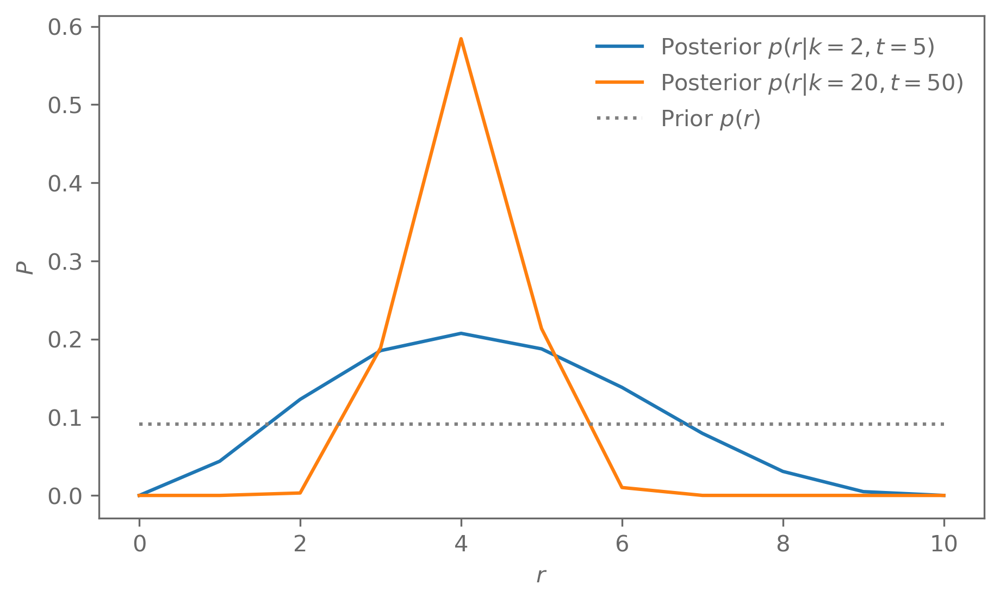

In [90]:
posterior_20_50 = posterior(r, k=20, t=50)
# Normalise the posterior
posterior_20_50 /= posterior_20_50.sum()

plt.plot(r, posterior_2_5, label="Posterior $p(r|k=2, t=5)$")
plt.plot(r, posterior_20_50, label="Posterior $p(r|k=20, t=50)$")
plt.plot(r, prior(r), c="grey", ls=":", label="Prior $p(r)$")
plt.legend()
plt.ylabel("$P$")
plt.xlabel("$r$");

### Updating the prior

The Bayesian formalism allows us to update our prior believes once new data comes in. 

Assume we have just finished the experiment where we drew 2 red balls in 5 trials.

If we now do a new experiment (using the same urn), we can use our knowledge from the previous experiment to update our prior on the number of red balls in the urn.



For example, we can use the posterior from the previous experiment as the prior.

What is the posterior on $r$ after the 2nd experiment where you draw $k=6$ red balls in $t=12$ trials, using the previous posterior distribution as the prior?

In [91]:
def updated_prior(r):
    return posterior(r, k=2, t=5)

def updated_posterior(r, k, t):
    return likelihood(k, t, r) * updated_prior(r)

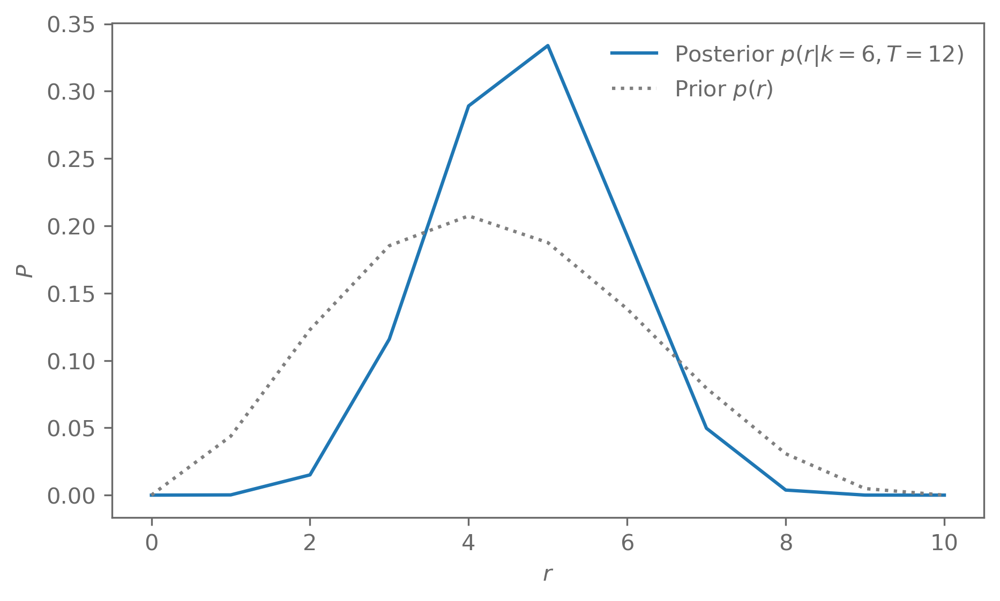

In [92]:
updated_posterior_6_12 = updated_posterior(r, k=6, t=12)
# Normalise
updated_posterior_6_12 /= np.sum(updated_posterior_6_12)

plt.plot(r, updated_posterior_6_12, label="Posterior $p(r|k=6, T=12)$")
plt.plot(r, posterior_2_5, c="grey", ls=":", label="Prior $p(r)$")
plt.legend()
plt.ylabel("$P$")
plt.xlabel("$r$");


## Making predictions

Because the likelihood is a probability distribution of the data, we can use it to sample new data given the model and parameters. 

Before the observed data are considered, the (marginal) distribution of the data is
$$
    p(d) = \int p(d,\theta)\dd\theta = \int p(d|\theta)p(\theta)\dd\theta\ .
$$
In the context of making predictions, this is called the **prior predictive distribution**: 
- Prior, because it is not conditioned on the observed data
- Predictive, because it is the distribution of a quantity that is observable


It allows us to make predictions of how the observed data will look like under our prior, likelihood, and model. 
Comparing these predictions to the observed data can give us some indication if our priors, likelihoods, and models are reasonable.


As long as we can sample from the prior and from the likelihood, we can create samples from the prior predictive distribution:
1. Create samples $\theta_i$ from the prior
2. Sample new data from the likelihood, at parameter $\theta_i$: $\tilde d_i\sim p(\cdot | \theta_i)$

Our priors are usually simple enough to allow easy sampling. 
Because the likelihood describes the data generating process, we can almost always sample from it.



Even if we cannot evaluate the value of the likelihood, we can usually still sample from it.
- For example, a complex simulation of an experiment can simulate data but writing down a closed form for the probability density function $p(d|\theta)$ is impossible.

Once we have observed our actual data and found our posterior $p(\theta|d_\mathrm{obs})$, we can predict new data $\tilde d$, based on the data we just observed.

The **posterior predictive distribution** is

\begin{equation}
    \begin{split}
        p(\tilde d | d_\mathrm{obs}) &= \int p(\tilde d, \theta | d_\mathrm{obs})\dd \theta \\
        &= \int p(\tilde d | d_\mathrm{obs}, \theta)p(\theta|d_\mathrm{obs})\dd \theta \\
        &= \int p(\tilde d | \theta)p(\theta|d_\mathrm{obs})\dd \theta\,,
    \end{split}
\end{equation}

where we assumed $\tilde d$ and $d_\mathrm{obs}$ are conditionally independent given $\theta$: $p(\tilde d, d_\mathrm{obs} | \theta) = p(\tilde d | \theta)p(d_\mathrm{obs} | \theta)$.



We can sample from it similarly to the prior predictive distribution we saw before. Instead of sampling $\theta_i$ from the prior, we sample it from posterior $p(\theta | d_\mathrm{obs})$:
1. Create samples $\theta_i\sim p(\cdot | d_\mathrm{obs})$
2. Sample new data from the likelihood, at parameter $\theta_i$: $\tilde d_i\sim p(\cdot | \theta_i)$


The posterior predictive distribution comes in handy:
- Check that our model for the data actually agrees with the observed data. This is an important step in Bayesian analysis: the nicest posteriors on parameters are worthless if the parameters do not actually describe the data.
- Predict future observations: imaging we have some time-series data. Once we have conditioned our model on the observed data, we can predict how future data will look.


Often we are in the situation where we have an underlying model $f(\theta)$ and the observed data scatter around this model, described by the likelihood.

For example, in a Gaussian likelihood with fixed variance $\sigma^2$, $f(\theta)$ would give the mean and the data would be distributed as $d\sim\Norm(f(\theta), \sigma^2)$.

In our analysis we might want to know the posterior distribution of the model $f(\theta)$.


This distribution of the model function is a variant of the prior and posterior predictive distributions and is sometimes called translated or model predictive distrution.

We sample from it by drawing samples $\theta_i$ from the posterior and evaluating the $f(\theta_i)$. 

This essentially corresponds to assuming a Dirac delta for the likelihood.

## Model comparison

Suggested reading: Information Theory, Inference, and Learning Algorithms, chapter 28

So far all the expressions implicitly assumed a model for how the parameters and data are connected. 

But what if there are multiple plausible models? How do we choose among the models?



Bayesian statistics gives a clear answer to this. Let us first write out Bayes' theorem but now explicitly include that everything depends on the underlying model $M$:
$$
    p(\theta|d, M) = \frac{p(d|\theta, M)p(\theta|M)}{p(d|M)}\ .
$$
What we now want to know is the probability of the model $M$, given the data:
$$
    p(M|d) = \frac{p(d|M)p(M)}{p(d)}
$$



If we have two models $M_1$ and $M_2$, we look at the ratio of their posteriors, called the Bayes' ratio:
$$
    \frac{p(M_1|d)}{p(M_2|d)} = \frac{p(d|M_1)}{p(d|M_2)}\frac{p(M_1)}{p(M_2)}
$$

The odds of model $M_1$ being true compared to model $M_2$ is given by the ratio of the evidences $\frac{p(d|M_1)}{p(d|M_2)}$ times the ratio of the priors of the models. 
If we assume both models to be equally like apriori, the Bayes ratio is just the ratio of the evidences.

Computing the evidence $p(d)$ is challenging in general. We will come back to this once we looked at nested sampling, which is one possible approach to compute it.

## Fitting a line

To see how all these concepts work a bit more in practice, let us fit a line to some data. 
For a polemic view on this topic, see https://arxiv.org/abs/1008.4686.

Take a look at the data in `lectures/data/linear_fits/data_0.txt`

In [145]:
def plot_linear_data_set(x, y, y_err=None):
    """Plot linear data set and format the plot."""
    fig, ax = plt.subplots(1, 1)

    if y_err is not None:
        ax.errorbar(x, y, y_err, fmt=".", label="Data")
    else:
        ax.plot(x, y, marker=".", linestyle="none", label="Data")

    ax.set_xlabel("$x$")
    ax.set_ylabel("$y$")
    ax.legend(loc="upper left")

    return fig, ax

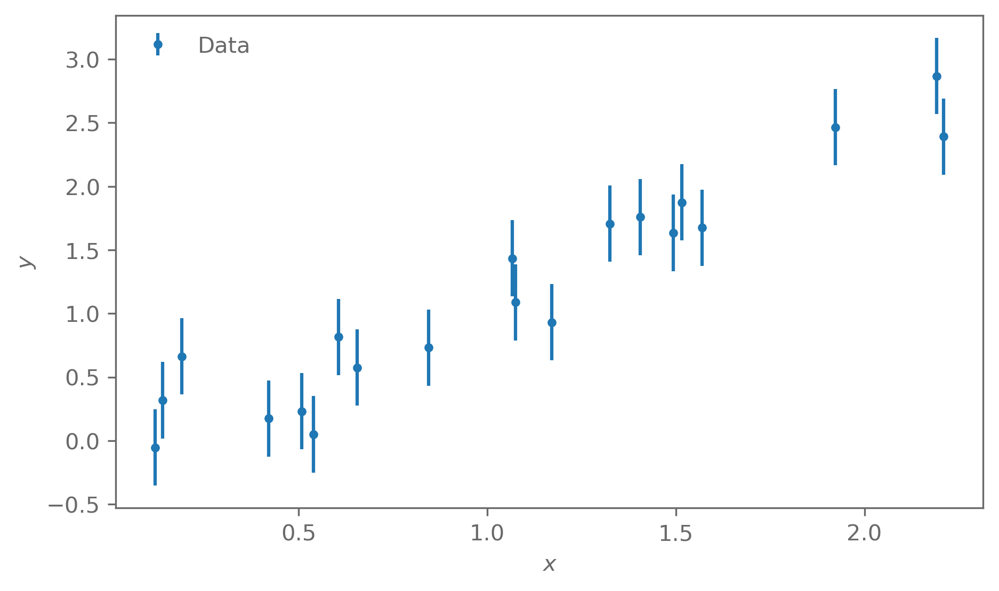

In [131]:
x, y, y_err = np.loadtxt("data/linear_fits/data_0.txt", unpack=True)
# For now, all errors are the same
sigma_y = y_err[0]

_ = plot_linear_data_set(x, y, sigma_y)

### Bayesian workflow

Let us recall the steps of the Bayesian data analysis workflow:

1. Build a probabilistic model
2. Fit model to the data
3. Check that the model describes the data

### 1. Build a probabilistic model

Let us assume the following model for the data:

The data $y_i$ are Gaussian distributed around a linear model $f(x) = mx + b$, with a constant variance $\sigma_y^2$:

\begin{align}
    \mu(m, b, x) &= mx + b \\
    y_i&\sim\Norm\left(\mu(m, b, x_i),\sigma_y^2\right)
\end{align}

Note that when we plot error bars, this is a visualisation of the likelihood.

In Bayesian statistics there is no uncertainty on the observed data. 

But we often show the width of the distribution the observed data came from (the likelihood) with error bars.

This lets us define our probabilistic model:

In [170]:
# The linear model
def model(m, b, x):
    return m*x + b

# Probability of the data, given the model parameters: P(y|m, b)
# We use the logarithm here for computational reasons
def log_likelihood_probability(y, m, b, x, sigma_y):
    prediction = model(m, b, x)

    n = len(y)
    # log of the PDF of a multivariate Gaussian
    return (
        -0.5 * np.sum((y - prediction)**2/sigma_y**2)  # Exponent
        - n/2*np.log(2*np.pi*sigma_y**2)               # Normalisation
    )

We also need to define a prior. 

Let us assume that we have some prior knowledge:
- $m$ should be around 1 with uncertainty 1: $m\sim\Norm(1, 1^2)$
- $b$ should be around 0 with uncertainty 1.2: $b\sim\Norm(0, 1.2^2)$


In [171]:
m_prior = scipy.stats.norm(loc=1, scale=1)
b_prior = scipy.stats.norm(loc=0, scale=1.2)

def log_prior_probability(m, b):
    return m_prior.logpdf(m) + b_prior.logpdf(b)

#### Is our model reasonable?

Now that we have defined our probabilistic model, we should check that it is reasonable.

For this we look at the prior predictive distributions: the distributions of the model and (future) data, given parameters from the prior.

In [172]:
def sample_prior(n_sample):
    """Sample n_sample times from the prior distribution."""
    return np.vstack((m_prior.rvs(n_sample), b_prior.rvs(n_sample))).T

# Fix the pseudo random number generator seed for reproducibility
np.random.seed(42)

# Evaluate the model at the prior sample parameters
prior_model_predictive = np.array(
    [model(*parameters, x) for parameters in sample_prior(n_sample=20)]
)

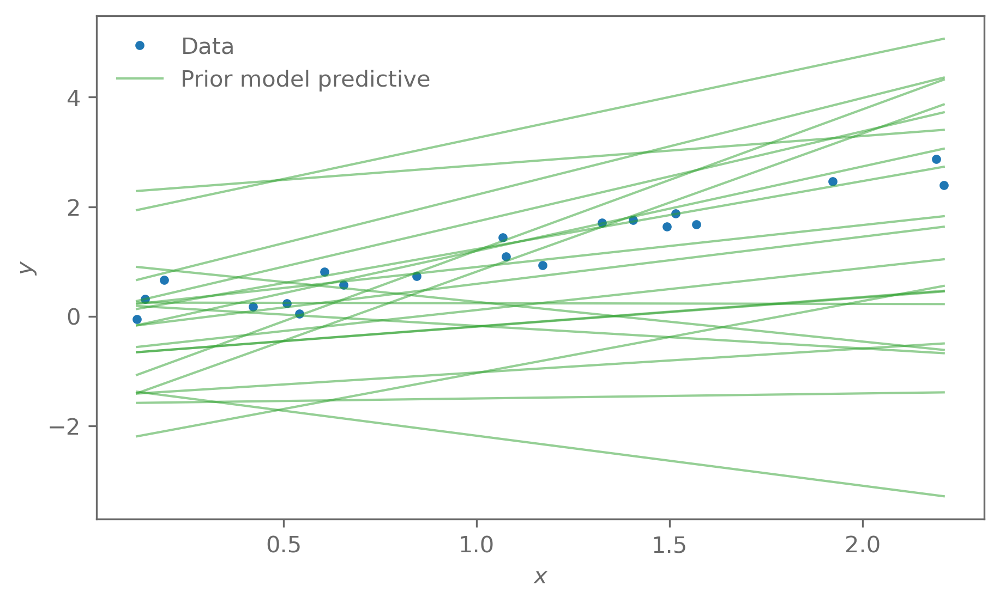

In [162]:
_, ax = plot_linear_data_set(x, y)

style = dict(c="C2", lw=1, alpha=0.5)
ax.plot(x, prior_model_predictive.T, **style)
ax.plot([], [], label="Prior model predictive", **style)
ax.legend();

This looks reasonable! Let us also check that data created based on these models look reasonable as well:

In [173]:
# Since we have a Gaussian likelihood, we can add Gaussian noise with the 
# correct variance to our prior model predictions
prior_predictive = (
    prior_model_predictive
    + sigma_y*np.random.normal(size=prior_model_predictive.shape)
)

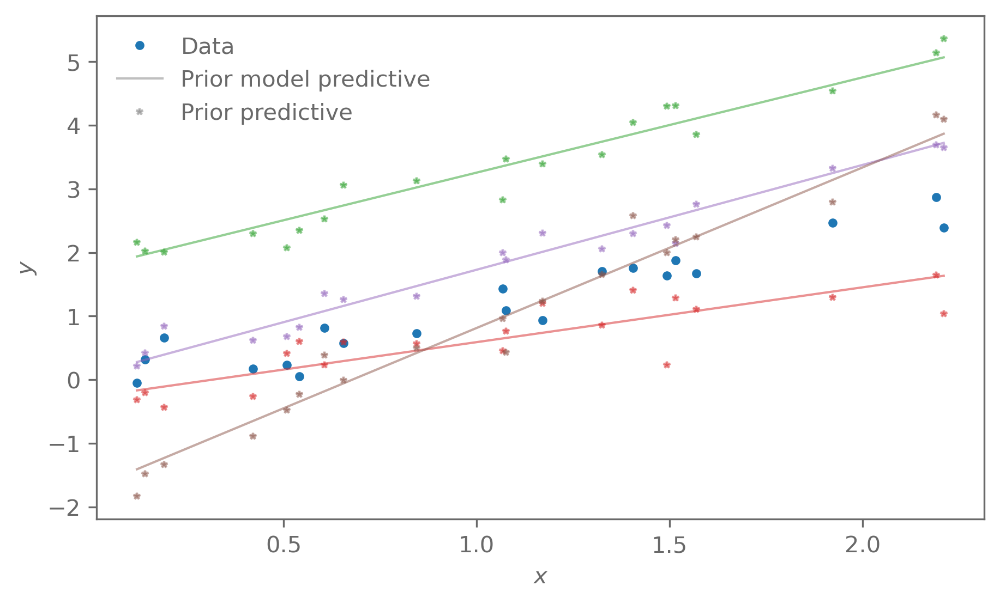

In [174]:
_, ax = plot_linear_data_set(x, y)

pmp_style = dict(lw=1, alpha=0.5)
pp_style = dict(ls="none", marker="*", ms=3, alpha=0.5)

for i in range(4):
    ax.plot(x, prior_model_predictive[i], c=f"C{i+2}", **pmp_style)
    ax.plot(x, prior_predictive[i], c=f"C{i+2}", **pp_style)

ax.plot([], [], label="Prior model predictive", c="grey", **pmp_style)
ax.plot([], [], label="Prior predictive", c="grey", **pp_style)
ax.legend();

### 2. Fit the model

Now that we have convinced ourselves that the prior model looks reasonable, we can move on the fit the model.

This means evaluating the posterior distribution:

In [175]:
def log_posterior_probability(m, b, x, sigma_y, y):
    return (
        log_likelihood_probability(y, m, b, x, sigma_y)
        + log_prior_probability(m, b)
    )


#### MAP

We now defined our posterior, so we can start calculating things with it.

A first step might be to ask, what is the most probable set of parameters $(m, b)$ that describe the data?

For this we need to find the maximum of the posterior. This is called the maximum a-posteriori (MAP) and is the "best-fit" value:
$$
    \theta_\mathrm{MAP} = \underset{\theta}{\mathrm{argmax}}\ p(\theta|d)
$$

In [176]:
# The scipy minimizer finds the minimum, so we need to take the 
# negative of the posterior. The scipy minimizer also passes an array 
# with the parameters, this wrapper splits this array into m and b.
def negative_log_posterior(theta, x, sigma_y, y):
    m, b = theta
    return -log_posterior_probability(m, b, x, sigma_y, y)

MAP_result = scipy.optimize.minimize(
    fun=negative_log_posterior,
    x0=(1, 0),
    args=(x, sigma_y, y)
)
m_MAP, b_MAP = MAP_result.x
m_true = 1.3
b_true = -0.2

print("MAP results")
print(f"m_MAP = {m_MAP:.3f}, b_MAP = {b_MAP:.3f}")
print(f"m_true = {m_true:.3f}, b_true = {b_true:.3f}")

MAP results
m_MAP = 1.251, b_MAP = -0.145
m_true = 1.300, b_true = -0.200


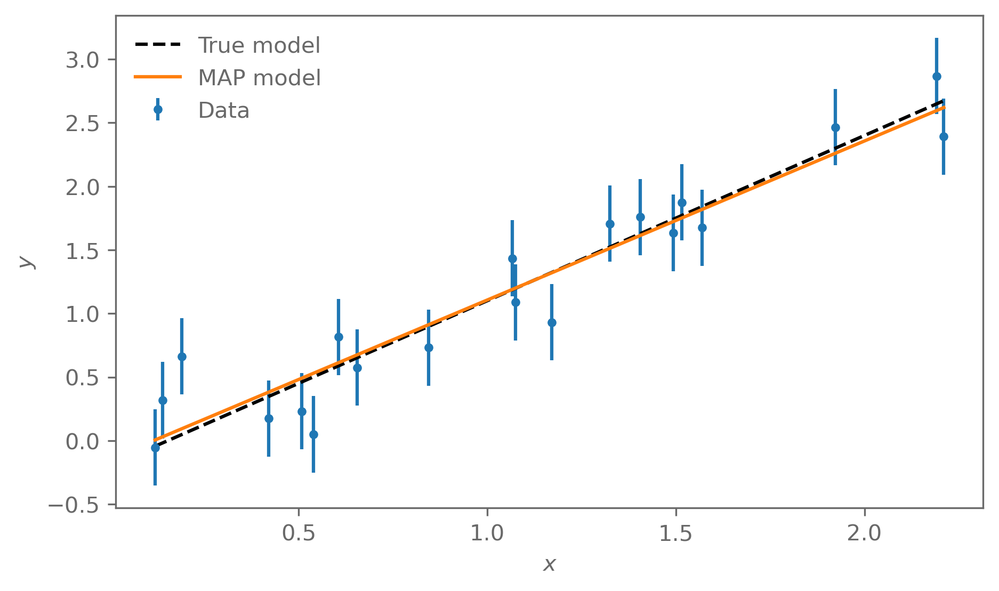

In [177]:
_, ax = plot_linear_data_set(x, y, sigma_y)

x_grid = np.linspace(0, 2.5, 100)
ax.plot(x, model(m_true, b_true, x), c="k", ls="--", label="True model")
ax.plot(x, model(m_MAP, b_MAP, x), c="C1", label="MAP model")
ax.legend();

#### Sampling the posterior

The MAP only tells us about the mode of the posterior. 

In Bayesian statistics we care about the whole probability structure.

To get there, we need to create samples from the posterior. 

We will cover the details of how and why we sample from distribution in much more detail later in the course. This is just to give you a flavour for how this works!

In this specific example there would be an analytic expression for the posterior but in general that is not the case!

In [178]:
import emcee

# emcee passes an array of values for the sampled parameters
# This wrapper just splits the array theta into m and b
def log_posterior_wrapper(theta, x, sigma_y, y):
    m, b = theta
    return log_posterior_probability(m, b, x, sigma_y, y)

# emcee requires some extra settings to run
n_param = 2       # Number of parameter we are sampling
n_walker = 10     # Number of walkers. This just needs to be 
                  # larger than 2*n_param + 1!
n_step = 5000     # How many steps each walker will take. The number
                  # of samples will be n_walker*n_step

# The starting point for each walker
theta_init = np.array([0.5, 0.5]) \
    + 0.1*np.random.normal(size=(n_walker, n_param))

sampler = emcee.EnsembleSampler(
    nwalkers=n_walker, ndim=n_param,
    log_prob_fn=log_posterior_wrapper,
    args=(x, sigma_y, y)
)
state = sampler.run_mcmc(theta_init, nsteps=n_step)

In [190]:
# The samples will be correlated, this checks how correlated they are
# We will discuss this once we come to MCMC methods
print("Auto-correlation time:")
for name, value in zip(["m", "b", "f"], sampler.get_autocorr_time()):
    print(f"{name} = {value:.1f}")

# We need to discard the beginning of the chain (a few auto-correlation times)
# to get rid of the initial conditions
chain = sampler.get_chain(discard=300, thin=10, flat=True)

Auto-correlation time:
m = 38.2
b = 36.2


What does the posterior distribution of the model parameters look like?

A simple summary is the mean and standard deviation of the samples:

In [191]:
print("Posterior results (mean±std)")
print(f"m = {np.mean(chain[:,0]):.2f}±{np.std(chain[:,0]):.2f}")
print(f"b = {np.mean(chain[:,1]):.2f}±{np.std(chain[:,1]):.2f}")

Posterior results (mean±std)
m = 1.25±0.10
b = -0.15±0.13


We often want to know more about the posterior distribution, however. 

For example
- are there correlations between parameters?
- does the posterior push against the prior somewhere?
- etc

A useful visualisation tool in this case is a corner plot. 

A corner (or triangle) plot shows the 1d marginal distributions of the parameters together with all 2d marginals.

In [199]:
import corner

fig = plt.figure()
fig = corner.corner(
    chain,
    bins=40,
    labels=["m", "b"],
    color="C0",
    truths=[m_true, b_true],
    truth_color="C1",
    levels=1-np.exp(-0.5*np.array([1, 2])**2), # Credible contours corresponding
                                               # to 1 and 2 sigma in 2D
    quantiles=[0.025, 0.16, 0.84, 0.975],
    fig=fig
);
fig.get_axes()[0].plot([], [], c="C0", label="Samples from the posterior")
fig.get_axes()[0].plot([], [], c="C1", label="True parameters")
fig.get_axes()[0].legend(loc=2, bbox_to_anchor=(1, 1))
plt.close()

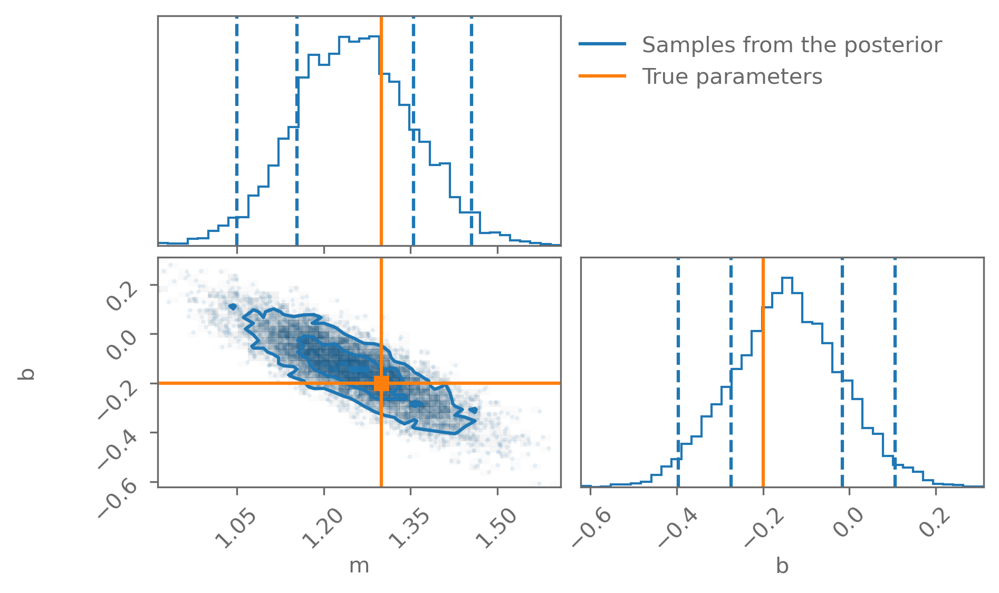

In [200]:
fig

### 3. Check the model

#### Making predictions

First, let us look at the uncertainty of the model, given the posterior. 

For this we compute samples of the translated posterior predictive distribution.

In [186]:
# Choose a small subsample of the chain for plotting purposes
chain_samples = chain[np.random.choice(chain.shape[0], size=200)]
# Evaluate the model at the sample parameters
model_predictive = np.array(
    [model(*sample, x) for sample in chain_samples]
)
model_quantiles = np.quantile(
    model_predictive, q=[0.025, 0.16, 0.84, 0.975], axis=0
)

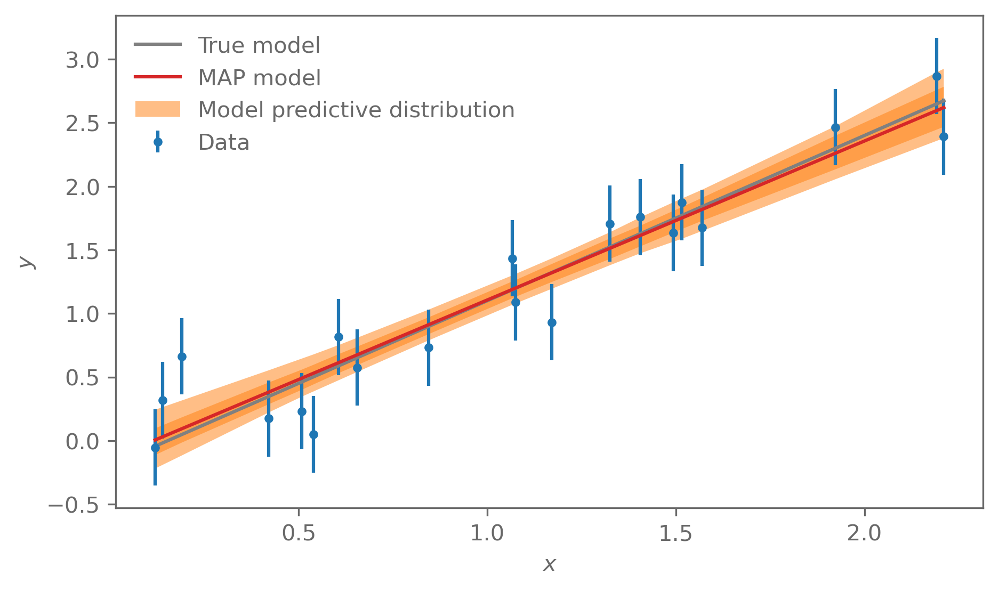

In [187]:
_, ax = plot_linear_data_set(x, y, sigma_y)
ax.plot(x, model(m_true, b_true, x), c="grey", label="True model")

ax.plot(x, model(m_MAP, b_MAP, x), c="C3", label="MAP model")
ax.fill_between(x, model_quantiles[0], model_quantiles[-1], alpha=0.5, facecolor="C1",
                label="Model predictive distribution")
ax.fill_between(x, model_quantiles[1], model_quantiles[-2], alpha=0.5, facecolor="C1")
ax.legend();

We can also see if the observed data agree with what the posterior predictive distribution says new data would look like.

In [188]:
# Because we have a Gaussian likelihood with variance \sigma_y^2, we can sample
# from the posterior predictive distribution by adding Gaussian noise with
# variance \sigma_y^2 to the model prediction samples
posterior_predictive = \
    model_predictive + sigma_y*np.random.normal(size=model_predictive.shape)

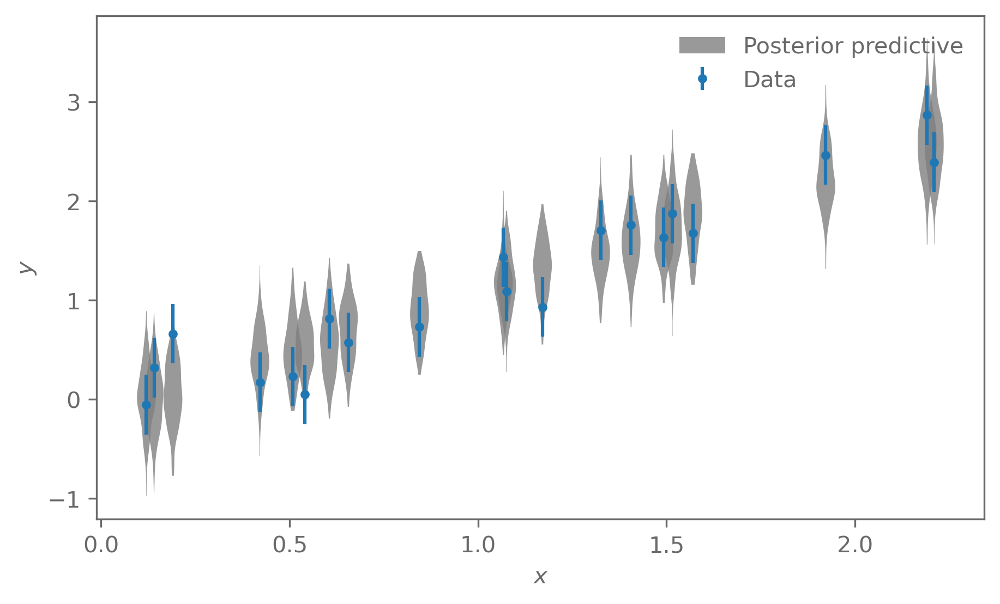

In [189]:
_, ax = plot_linear_data_set(x, y, sigma_y)

violin_plots = ax.violinplot(
    dataset=posterior_predictive,
    positions=x, widths=0.05,
    vert=True, showmeans=False, showextrema=False,
)
for body in violin_plots["bodies"]:
    body.set(color="grey", alpha=0.8, edgecolor=None)
body.set(label="Posterior predictive")

ax.legend();

### Clicker

Which of the following distributions is not conditioned on data?
- Prior predictive distribution
- Posterior predictive distribution
- Posterior model predictive distribution

Which of the following distributions does not predict the distribution of future/hypothetical data?

- Posterior model predictive
- Prior predictive
- Posterior predictive

# Exercise

- Implement your own version of the line-fitting procedure, using the same data.
- Now try it with the data in `lectures/data/linear_fits/data_1.txt`
    - First plot the data. What has changed?
    - Try the same model and likelihood on the new data. You might want to adjust the prior on $m$ and $b$ for this new data set.
    - What if you use the provided uncertainty per data point $\sigma_{y_i}$, instead of assuming a constant variance $\sigma_y$ for all data points?
    - Instead use the actual likelihood of the data:
\begin{align}
    \mu(x) &= mx + b \\
    \sigma(x_i) &= \sigma_{y_i} + f\mu(x_i)^2 \quad f > 0\ \text{a parameter} \\
    y_i&\sim\Norm(\mu(x_i),\sigma(x_i)^2)
\end{align}
Careful with the normalisation of the Gaussian likelihood. Because we vary the variance, this matters now!


## Jovian moons

We now repeat the same workflow on a small but more realistic data set. The goal is to measure Jupiter's mass from observations of its largest moons. 
Kepler's 3rd law relates the orbital period, semimajor axis of the elliptical orbit, and total mass of the system:
$$
T^2 = \frac{4\pi^2}{G(M+m)} a^3\,,
$$
where $T$ is period, $a$ the semi-major axis, $G$ Newton's constant, and $M$ and $m$ the masses of the orbiting bodies. Usually one mass is much larger than the other (e.g. Jupiter and its moons), so $m$ can usually be neglected.

The Jovian moos we consider (Io, Europa, Ganymede, and Calisto) have very low eccentricity, so we assume a circular orbit. 

Because we can only measure the angular separation between Jupiter and its moons (and not the distance along the line of sight), the observed projected distance $d_\mathrm{proj}$ is
$$
d_\mathrm{proj}(t) = d\sin(\frac{2\pi}{T} t + \phi)\,,
$$
where $d$ is the radius of the orbit and $\phi$ is its phase.

In [3]:
def plot_data(t, distance, distance_err, subtract_y=None):
    fig, ax = plt.subplots()

    if subtract_y is None:
        ax.errorbar(t, distance, distance_err, linestyle="none", marker=".", label="Data")
        ax.set_ylabel("Projected distance to Jupiter [$10^6$ km]")
    else:
        ax.axhline(0, color="dimgrey", lw=1)
        ax.errorbar(t, distance-subtract_y, distance_err, linestyle="none", marker=".", label="Data")
        ax.set_ylabel("Residual projected distance to Jupiter [$10^6$ km]")
    
    ax.set_xlabel("Time since 2024-01-08 18:00 [h]")

    return fig, ax

def plot_quantiles(ax, x, quantiles, **style):
    n_quantiles = len(quantiles)
    default_style = dict(alpha=0.5, color="C1", label="")
    style = {**default_style, **style}
    label = style.pop("label")
    for lower, upper in zip(quantiles[:n_quantiles//2], quantiles[n_quantiles//2+1::-1]):
        ax.fill_between(x, lower, upper, **style)


The data we are using is located in `data/jovian_moons/Io_synthetic.dat`. It has three columns:
- the observation time
- the measured distance between the moon and Jupiter
- the estimated measurement uncertainty

In [202]:
moon = "Io"

t, distance, distance_err = np.loadtxt(
    f"./data/jovian_moons/{moon}_synthetic.dat", unpack=True)

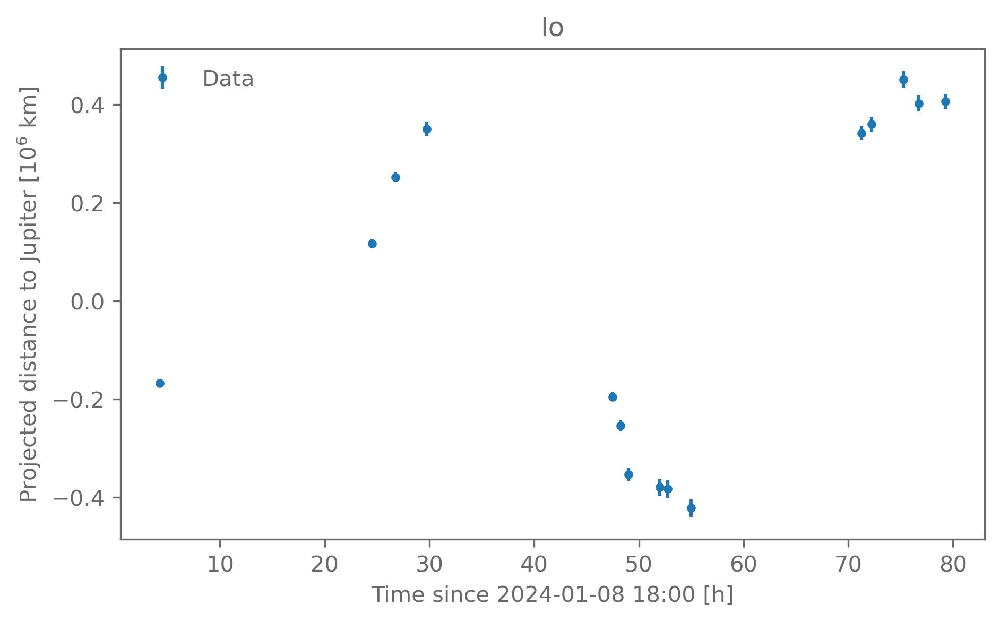

In [32]:
fig, ax = plot_data(t, distance, distance_err)
ax.legend()
_ = ax.set_title(f"{moon}")

### Step 1: Build the model

We assume circular orbits with no inclination and a Gaussian likelihood. The variance of the likelihood is given.

In [204]:
def model(theta, t):
    semimajor, period, phi = theta
    return semimajor * np.sin(2*np.pi/period * t + phi)

In [205]:
def build_likelihood():
    # Sample new data from the likelihood
    def predict(theta, t, sigma_d):
        mu = model(theta, t)
        return np.random.normal(loc=mu, scale=sigma_d)

    # Evaluate the log-likelihood
    def log_likelihood(d, theta, t, sigma_d):
        mu = model(theta, t)

        n = len(d)
        return (
            -0.5 * np.sum((d - mu)**2/sigma_d**2)  # Exponent
            - 0.5*np.log(2*np.pi) - 0.5*np.sum(np.log(sigma_d**2)) # Normalisation
        )
    
    return predict, log_likelihood

#### Is the model reasonable?

To check if the model seems reasonable a-priori, let us look at the prior predictive distribution: sample parameters from the prior and see what kind of data the model predicts before fitting it to the observed data.

For the prior we try to be quite uninformative. For example
- $a / 10^6\,\mathrm{km} \sim\Uniform(0, 3)$
- $T / \mathrm{h} \sim\Uniform(10, 100)$
- $\phi \sim\Uniform(0, 2\pi)$


In [34]:
def build_prior():
    low_a, high_a = 0.0, 3.0
    low_T, high_T = 10, 100
    low_phi, high_phi = 0, 2*np.pi

    def sample_from_prior(n):
        semimajor = np.random.uniform(low=low_a, high=high_a, size=(n,))
        period = np.random.uniform(low=low_T, high=high_T, size=(n,))
        phase = np.random.uniform(low=low_phi, high=high_phi, size=(n,))

        return np.stack((semimajor, period, phase)).T

    def log_prior(theta):
        semimajor, period, phase = theta
        if (semimajor < low_a or high_a < semimajor
                or period < low_T or high_T < period
                or phase < low_phi or high_phi < phase):
            return -np.inf
        return 0 # ignore normalisation for now

    return sample_from_prior, log_prior

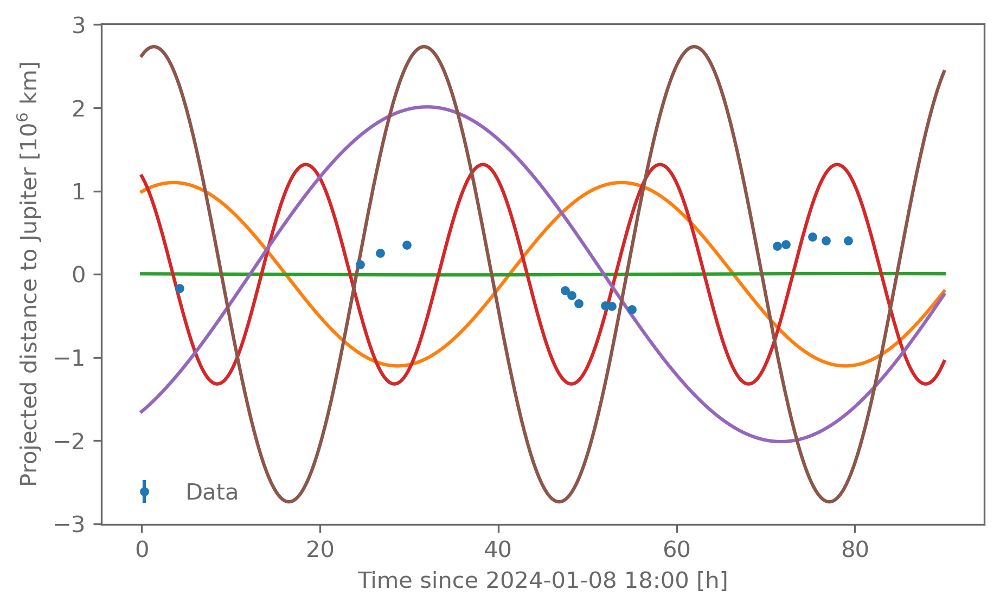

In [36]:
sample_from_likelihood, log_likelihood = build_likelihood()
sample_from_prior, log_prior = build_prior()

t_fine = np.linspace(0, 90, 500)

fig, ax = plot_data(t, distance, distance_err)

for p in sample_from_prior(5):
    ax.plot(t_fine, model(p, t_fine))

_ = ax.legend()

In [37]:
def log_posterior(theta, t, sigma_d, d):
    prior = log_prior(theta)
    if not np.isfinite(prior):
        return prior
    return log_likelihood(d, theta, t, sigma_d) + prior

log_posterior(sample_from_prior(1)[0], t, distance_err, distance)

# Make the output on the slides look nice
import warnings
warnings.filterwarnings('ignore')

### Step 2: Fit the model

First, let us find the best-fitting model parameters.

In [59]:
MAP_result = scipy.optimize.minimize(
    fun=lambda theta: -log_posterior(theta=theta, t=t,
                                     sigma_d=distance_err, d=distance),
    x0=(1.0, 40.0, 1.0)
)

In [60]:
print(f"Optimisation successful: {MAP_result.success}")

Optimisation successful: False


The numerical optimisation can sometimes fail when the optimisation gets stuck.

Solutions:
- Try a different starting point
- Try a different optimisation method
- If you have access to the derivatives of your function, these help a lot

In [64]:
MAP_result = scipy.optimize.minimize(
    fun=lambda theta: -log_posterior(theta=theta, t=t,
                                     sigma_d=distance_err, d=distance),
    x0=(1.0, 40.0, 1.0), method="Nelder-Mead"
)
assert MAP_result.success

semimajor_MAP, period_MAP, phase_MAP = MAP_result.x
print("MAP results")
print(f"{semimajor_MAP=:.3f}, {period_MAP=:.3f}, {phase_MAP=:.3f}")

MAP results
semimajor_MAP=0.431, period_MAP=42.508, phase_MAP=2.925


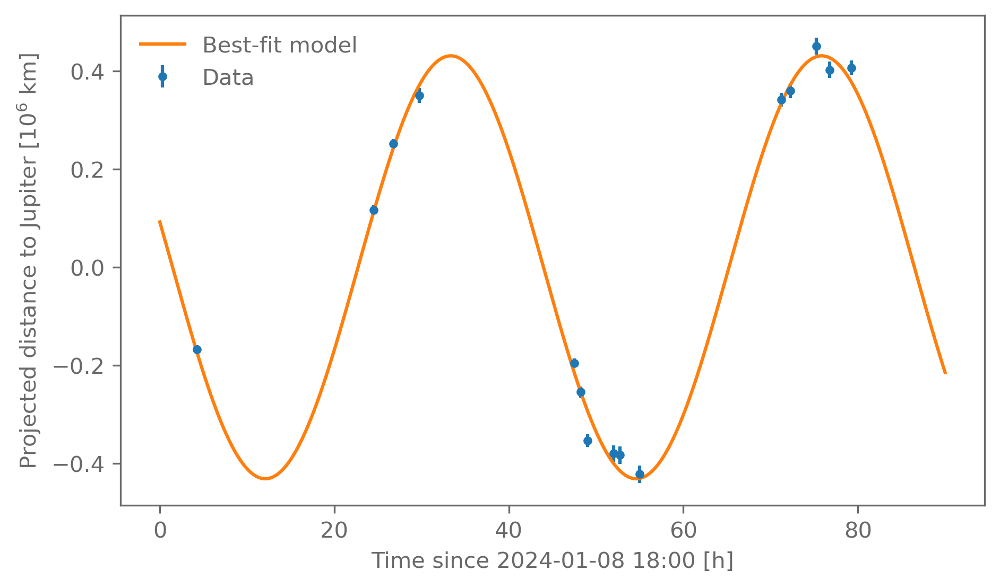

In [65]:
fig, ax = plot_data(t, distance, distance_err)
ax.plot(t_fine, model(MAP_result.x, t_fine), label="Best-fit model")
_ = ax.legend()

#### Sample the posterior

Even though our model is still quite simple, there is no analytic expression for the posterior, so we need to sample it with something like an MCMC method. We use `emcee` again.

In [68]:
import emcee

n_param = 3       # Number of parameter we are sampling
n_walker = 10     # Number of walkers. This just needs to be 
                  # larger than 2*n_param + 1!
n_step = 5000     # How many steps each walker will take. The number
                  # of samples will be n_walker*n_step

# The starting point for each walker. The MAP or something close is usually
# a good choice
theta_init = np.array([0.5, 40.0, 3.0]) \
    + 0.1*np.random.normal(size=(n_walker, n_param))

sampler = emcee.EnsembleSampler(
    nwalkers=n_walker, ndim=n_param,
    log_prob_fn=lambda theta: log_posterior(theta=theta, t=t,
                                            sigma_d=distance_err, d=distance),
)
state = sampler.run_mcmc(theta_init, nsteps=n_step)

Check that the chain has converged

In [69]:
print("Auto-correlation time:")
for name, value in zip(["a", "T", "phi"], sampler.get_autocorr_time()):
    print(f"{name} = {value:.1f}")

# We need to discard the beginning of the chain (a few auto-correlation times)
# to get rid of the initial conditions
chain = sampler.get_chain(discard=300, thin=20, flat=True)

Auto-correlation time:
a = 38.8
T = 49.9
phi = 36.2


We can now compute the mass of Jupiter from the the semi-major axis and period.

In [70]:
def mass_from_Kepler_3rd_law(theta):
    semimajor, period = theta[:2]
    return 4*(np.pi**2)/6.674e-11*((1e9*semimajor)**3)/((period*3600)**2)

mass_Jupiter = mass_from_Kepler_3rd_law(chain.T)
chain_with_mass = np.column_stack((chain, mass_Jupiter))

print("Posterior results (mean±std)")
for i, param in enumerate(["semi-major axis a [10^6 km]", "period T [km]",
                           "phase phi", "mass M [kg]"]):
    mean = np.mean(chain_with_mass[:,i])
    std = np.std(chain_with_mass[:,i])
    print(f"{param} = {mean:.4g} ± {std:.2g}")

Posterior results (mean±std)
semi-major axis a [10^6 km] = 0.4308 ± 0.0063
period T [km] = 42.51 ± 0.14
phase phi = 2.926 ± 0.019
mass M [kg] = 2.021e+27 ± 8.8e+25


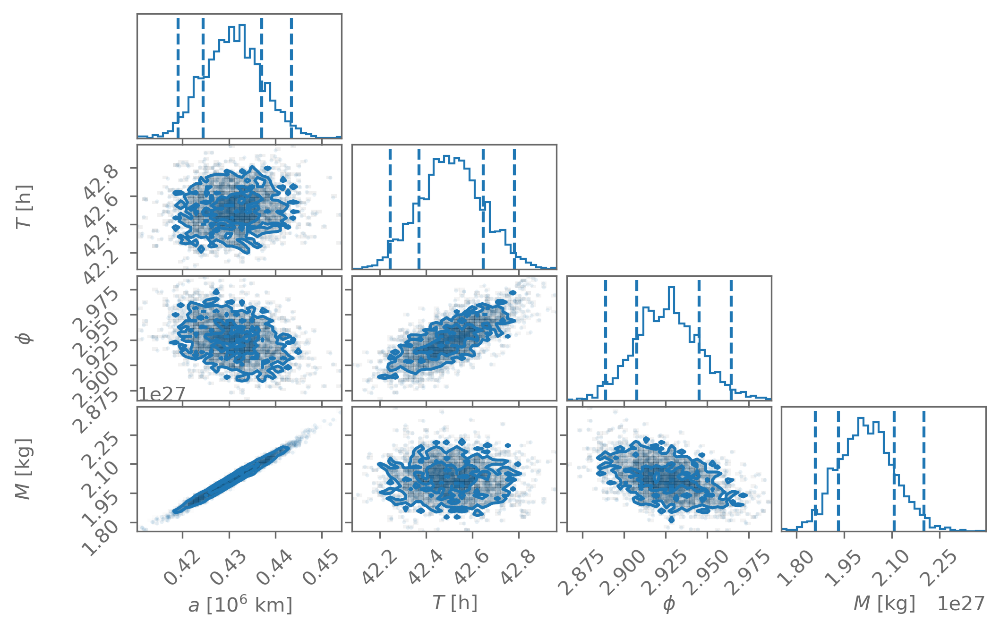

In [208]:
import corner

fig = plt.figure(figsize=(7.0, 6.0))
fig = corner.corner(
    chain_with_mass,
    bins=40,
    color="C0",
    labels=["$a$ [$10^6$ km]", "$T$ [h]", r"$\phi$", "$M$ [kg]"],
    levels=1-np.exp(-0.5*np.array([1, 2])**2),
    quantiles=[0.025, 0.16, 0.84, 0.975],
    title_quantiles=[0.16, 0.5, 0.84],
    labelpad=0.2,
    fig=fig
);
fig.subplots_adjust(bottom=0.35)
# plt.close()

### Step 3: Check the model

The posterior distribution looks reasonable at first glance. But can our model describe the data?

In [72]:
chain_samples = chain[np.random.choice(chain.shape[0], size=200)]

# Evaluate the model at the sample parameters
model_predictive = np.array(
    [model(theta=sample, t=t_fine) for sample in chain_samples]
)
posterior_predictive = np.array(
    [sample_from_likelihood(theta=sample, t=t, sigma_d=distance_err)
     for sample in chain_samples]
)

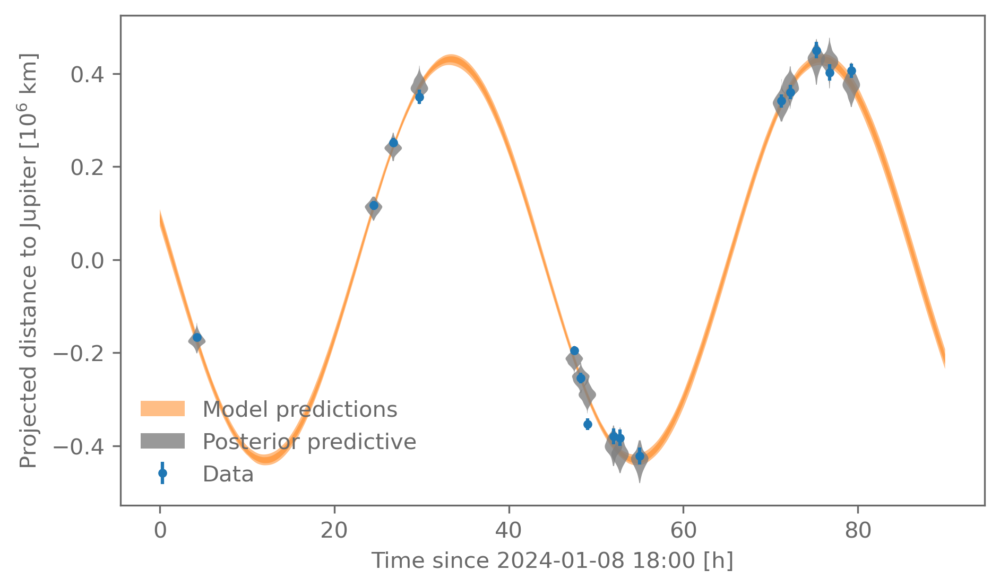

In [85]:
best_fit_model = model(MAP_result.x, t)
best_fit_model_fine = model(MAP_result.x, t_fine)

model_quantiles = np.quantile(
    model_predictive, q=[0.025, 0.16, 0.84, 0.975], axis=0
)

fig, ax = plot_data(t, distance, distance_err)

ax.fill_between(t_fine, model_quantiles[1], model_quantiles[-2],
                alpha=0.5, color="C1", label="Model predictions")
ax.fill_between(t_fine, model_quantiles[0], model_quantiles[-1],
                alpha=0.5, color="C1")

violin_plots = ax.violinplot(
    dataset=posterior_predictive,
    positions=t, widths=2.0,
    vert=True, showmeans=False, showextrema=False,
)
for body in violin_plots["bodies"]:
    body.set(color="grey", alpha=0.8)
body.set(label="Posterior predictive")

_ = ax.legend()

That looks reasonable!

We can now also compare to the literature values of the parameters: 
- $a = 0.4217 \cdot 10^6$ km
- $T = 42.456$ h
- $M = 1.8982 \cdot 10^{27}$ kg

Note that in a real experiment you might not have access to such values. 

There can also be good reasons to be blind to such other results.

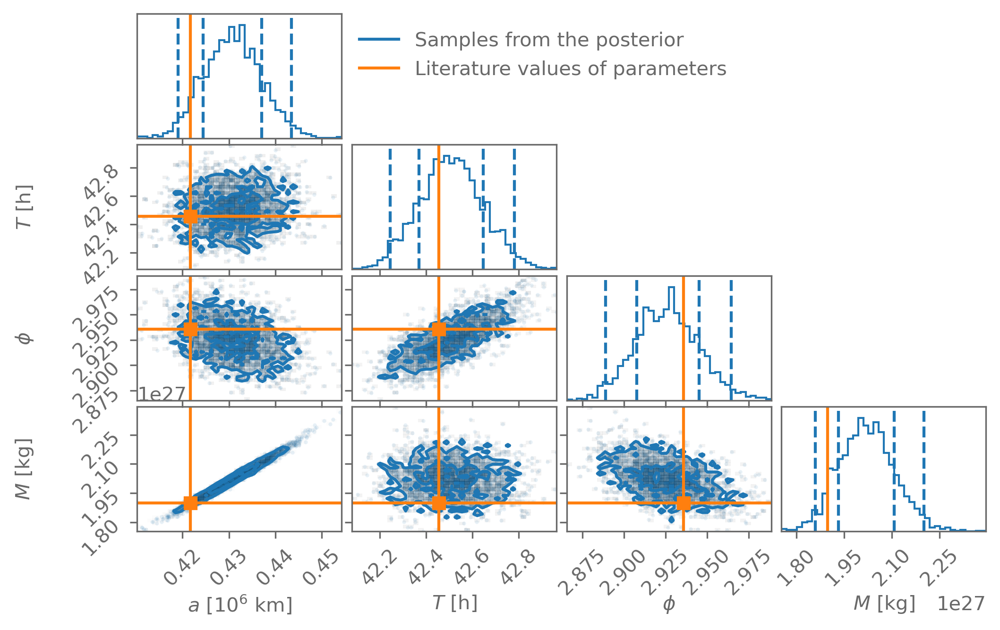

In [207]:
theta_true = dict(
    Io=[0.421700, 1.769*24, 2.935632897970926],
    Ganymede=[1.070400, 7.155*24, 1.5793369771861996],
    Europa=[0.671100, 3.551*24, 3.0779939041348796],
    Callisto=[1.882700, 16.689*24, 1.9374307501130097],
)
mass_Jupiter_true = 1.8982e27


fig = plt.figure(figsize=(7.0, 6.0))
fig = corner.corner(
    chain_with_mass,
    bins=40,
    color="C0",
    labels=["$a$ [$10^6$ km]", "$T$ [h]", r"$\phi$", "$M$ [kg]"],
    levels=1-np.exp(-0.5*np.array([1, 2])**2), # Credible contours corresponding to 1 and 2 sigma in 2D
    quantiles=[0.025, 0.16, 0.84, 0.975],
    truths=theta_true[moon] + [mass_Jupiter_true],
    truth_color="C1",
    title_quantiles=[0.16, 0.5, 0.84],
    labelpad=0.2,
    fig=fig
)
fig.get_axes()[0].plot([], [], c="C0", label="Samples from the posterior")
fig.get_axes()[0].plot([], [], c="C1", label="Literature values of parameters")
fig.get_axes()[0].legend(loc=2, bbox_to_anchor=(1, 1))
fig.subplots_adjust(bottom=0.35)

# Exercise

The data in the previous example were a synthetic version of real observations that were obtained in an AstroWoche project in 2024 by Jonas Spiller, Theo Lequy, Clara Bleich. 

<!-- ![jovian moons data](../assets/jovian_moons_raw_data.png) -->
<img style="display: block; 
    margin-left: auto;
    margin-right: auto;
    width: 60%;"
    src="../assets/jovian_moons_raw_data.png" alt="jovian moons data"/>

The real observations can be found in `data/jovian_moons/{moon}.dat`:

In [ ]:
moon = "Io"

t, distance, distance_alt, distance_err = np.loadtxt(
    f"./data/jovian_moons/{moon}.dat", unpack=True)

1. Repeat the analysis with the real data set. What do you find?

There is another distance estimate provided. The difference between the distance estimates comes from different approaches to converting the measured distance between Jupiter and its moons from the number of pixels to a physical distance in km.

2. How does the analysis look when using this other distance estimate (what I call `distance_alt`)? What about the other moons?



Because there are two distance estimates that do not agree, both of which are based on reasonable approaches, this suggests that there might be a _systematic_ error in the measurements. Systematic errors are usually not random (which means they do not get smaller as you obtain more data). But we could pretend the offset between the two measurements is an estimate of an unaccounted statistical uncertainty. 

3. How does the analysis look when we assume `sigma_d**2 = distance_err**2 + (distance - distance_alt)**2`?



4. Instead of assuming that the uncertainty is underestimated by this offset, we can also model it. Does the model work better if the variance is a free parameter?


### Project idea

Dig deeper into this data set. For example
- Do the modelling assumptions (no eccentricity, no inclination) affect the outcome? You might want to work with simulated data where you know what kind of systematic effects are present.
- Are there other systematics that you can include in the model that better describe the data?
- Do the real (or simulated) data prefer one model over another?
- How to get a combined estimate of the mass of Jupiter from the different moons?

In [2]:
from functools import partial
from collections.abc import Iterable

import numpy as np
import scipy.stats

import matplotlib.pyplot as plt

from matplotlib.animation import ArtistAnimation
from IPython.display import HTML

In [1]:
title = "# Sampling from distributions 1"
# Print title and setup TeX defs for both KaTeX and MathJax
import bayesian_stats_course_tools
bayesian_stats_course_tools.misc.display_markdown_and_setup_tex(title)

import matplotlib.style
matplotlib.style.use("bayesian_stats_course_tools.light")

# Sampling from distributions 1

<!-- Define LaTeX macros -->
$\def\E{\operatorname{E}}$
$\def\Var{\operatorname{Var}}$
$\def\Cov{\operatorname{Cov}}$
$\def\dd{\mathrm{d}}$
$\def\ee{\mathrm{e}}$
$\def\Norm{\mathcal{N}}$
$\def\Uniform{\mathcal{U}}$

<!-- MathJax needs them to be defined again for the non-inline environment -->
$$\def\E{\operatorname{E}}$$
$$\def\Var{\operatorname{Var}}$$
$$\def\Cov{\operatorname{Cov}}$$
$$\def\dd{\mathrm{d}}$$
$$\def\ee{\mathrm{e}}$$
$$\def\Norm{\mathcal{N}}$$
$$\def\Uniform{\mathcal{U}}$$

Working with distributions often involves integrals:

- Expectation values: $\E[f(\vec x)] = \int f(\vec x)p(\vec x)\dd x^n$
- Marginal distributions: $p(\vec x) = \int p(\vec x, \vec y)\dd y^n$

How would you evaluate these integrals numerically?

Does that approach work in >3 dimensions? How about >10? 

### Clicker

Why is evaluating integrals over probability distributions in high-dimensional spaces challenging?

Computing integrals in more than 2-3 dimensions becomes very difficult, and realistic models can have dozens of parameters (i.e. dimensions to integrate over).

For example, if we use the trapezoidal rule to compute an integral in one dimension, we might need 50 evaluations of the integrand to get a good estimate.
For just 6 dimensions, we would already need $50^6\approx 1.6\cdot10^{10}$ evaluations!

This is made worse by the curse of dimensionality: as the number of dimension increases, the volume of high probability gets smaller and smaller.



Is the volume of a unit $n$-ball always larger than a unit $n$-cube?

<img style="display: block; 
    margin-left: auto;
    margin-right: auto;
    width: 40%;"
    src="../assets/disk_vs_square.svg" alt="disk vs square"/>

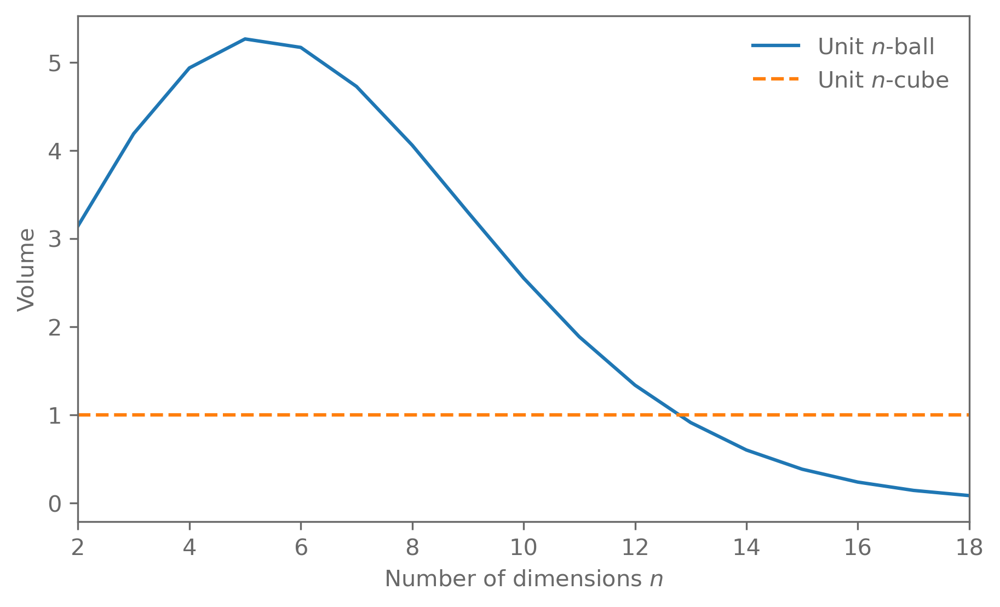

In [ ]:
from scipy.special import gamma as Gamma
n = np.arange(2, 20)
plt.plot(n, np.pi**(n/2)/Gamma(n/2+1), label="Unit $n$-ball")
plt.axhline(1, c="C1", ls="--", label="Unit $n$-cube")
plt.xlim(n[0], n[-2])
plt.xlabel("Number of dimensions $n$")
plt.ylabel("Volume")
plt.legend();

The good news is that if we can draw samples from our distributions, we can use them to compute the integrals.



If we want to evaluate the expectation of $f(x)$ with respect to the distribution $p$:
$$
    \Phi = \E[f(\vec x)] = \int f(\vec x)p(\vec x)\dd x^n
$$

If we have $N$ samples $\vec x_i\sim p$, we can approximate $\Phi$ as
$$
    \hat\Phi = \frac{1}{N}\sum_i f(\vec x_i)
$$

If we have $N$ samples $x_{ij}$ from a $d$-dimensional distribution ($i = 1,\dots,N$, $j=1,\dots,d$):
- $\vec x_1 = (x_{11}, x_{12}, \dots, x_{1d})$
- $\vec x_2 = (x_{21}, x_{22}, \dots, x_{2d})$
- ...
- $\vec x_N = (x_{N1}, x_{N2}, \dots, x_{Nd})$

If we want samples $\vec y_i$ from the marginal distribution of the 1st and last dimension, we drop the columns of the matrix $x_{ij}$ that correspond the dimensions we want to marginalise over:
- $\vec y_1 = (x_{11}, x_{1d})$
- $\vec y_2 = (x_{21}, x_{2d})$
- ...
- $\vec y_N = (x_{N1}, x_{Nd})$



Luckily the rise of Monte Carlo algorithms and powerful computers have made this possible.

We first have a look at rejection sampling. Conceptionally easy but very inefficient in high dimensions.

Then we go through three common sampling approaches:
- Metropolis-Hastings
- Slice sampling
- Nested sampling

Hamilton Monte Carlo and variational inference we leave until later.

The standard reference for this topic is chapter 29 in Information Theory, Inference, and Learning Algorithms.


Our target distribution we want to sample from:

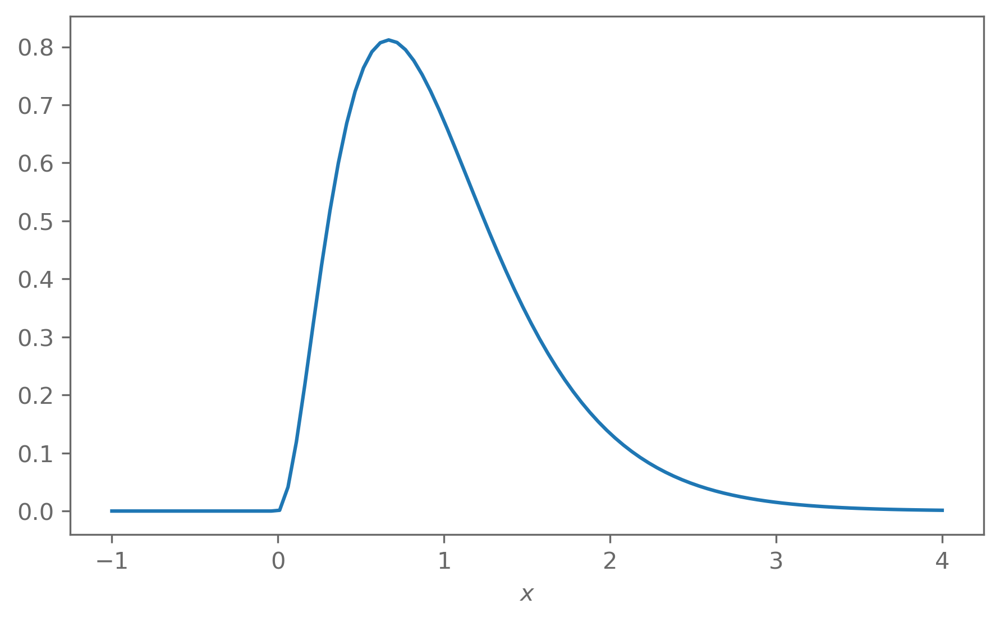

In [8]:
target_distr = scipy.stats.gamma(a=3, scale=1/3)

grid = np.linspace(-1, 4, 100)
plt.plot(grid, target_distr.pdf(grid))
plt.xlabel("$x$");

## Rejection sampling

The basic idea is to generate points $(x, y)$ that sample the area under $p(x)$ uniformly.



While we cannot sample from $p(x)$ directly, we assume we can find a distribution $q(x)$ that we can sample from and for which
$$
M q(x) > p(x)\ \forall x
$$
for some constant $M$.



We then sample $x_i$ from $q(x)$ and $u_i|x_i\sim\Uniform(0, M q(x_i))$. 
The points $(x_i, u_i)$ sample the area under the curve $M q(x)$ uniformly.

From this sample of points, we remove those where $u_i > p(x_i)$, which leaves us with points that uniformly sample the area under $p(x)$ and thus $x_i\sim p$.

In [5]:
# We use a Gaussian as our proposal distribution q and set M to 3
proposal_distr = scipy.stats.norm(loc=0.5, scale=1.3)
M = 3

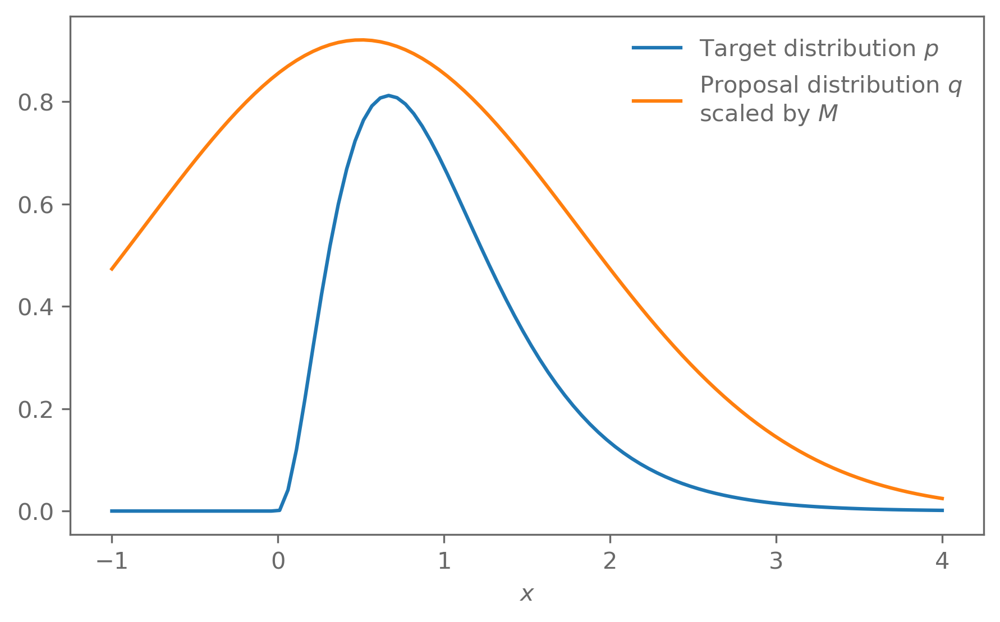

In [6]:
plt.plot(grid, target_distr.pdf(grid), label="Target distribution $p$")
plt.plot(grid, M*proposal_distr.pdf(grid), label="Proposal distribution $q$\nscaled by $M$")
plt.xlabel("$x$")
plt.legend(frameon=False);

In [10]:
def sample_with_viz(n):
    samples_generated = 0
    while samples_generated < n:
        x = proposal_distr.rvs(size=1)
        u = np.random.uniform(size=1)

        f = target_distr.pdf(x)
        g = proposal_distr.pdf(x)

        accept = u < f/(M*g)
        samples_generated += 1
        yield accept, x, u, f, M*g

wide_grid = np.linspace(-3, 4, 100)

hist_bins = np.linspace(wide_grid[0], wide_grid[-1], 20)
hist_bin_width = hist_bins[1] - hist_bins[0]

fig, ax = plt.subplots(1, 1, facecolor="none")
fig.patch.set_alpha(0.0)

ax.plot(wide_grid, target_distr.pdf(wide_grid), color="C0")
ax.plot(wide_grid, M*proposal_distr.pdf(wide_grid), color="grey")
ax.set_xlabel("$x$")

_, _, hist = ax.hist(
    x=np.array([]), bins=hist_bins,
    density=False, alpha=0.5, color="C0"
)

samples = []
artists = []
accepted_points_artists = []
rejected_points_artists = []

generated_objects = list(sample_with_viz(80))
n_accepted = sum(accept for accept, _, _, _, _ in generated_objects)

for i, (accept, x, u, f, Mg) in enumerate(generated_objects):
    if i < 4:
        vline = ax.vlines(x=x, ymin=0, ymax=Mg, color="grey")
        artists.append([vline] + accepted_points_artists + rejected_points_artists + list(hist.patches))

        point = ax.plot(x, Mg*u, marker="o", color="black")
        artists.append([vline] + point + accepted_points_artists + rejected_points_artists + list(hist.patches))

    if accept:
        samples.append(x)
        point = ax.plot(x, Mg*u, marker="o", color="C0")
        accepted_points_artists += point
    else:
        point = ax.plot(x, Mg*u, marker="o", color="grey")
        rejected_points_artists += point
    _, _, hist = ax.hist(
        x=np.array(samples), bins=hist_bins,
        weights=1/n_accepted/hist_bin_width*np.ones(len(samples)),
        density=False, alpha=0.5, color="C0"
    )

    artists.append(accepted_points_artists + rejected_points_artists + list(hist.patches))


rejection_sampling_ani = ArtistAnimation(fig, artists=artists, blit=True)
# rejection_sampling_ani.save("plots/rejection_sampling.html", writer="html")
plt.close()
HTML(rejection_sampling_ani.to_jshtml())

In [7]:
def sample(n):
    samples_generated = 0
    rejections = 0
    while samples_generated < n:
        x = proposal_distr.rvs(size=1)
        u = np.random.uniform(size=1)

        f = target_distr.pdf(x)
        g = proposal_distr.pdf(x)

        if u < f/(M*g):
            samples_generated += 1
            yield x
        else:
            rejections += 1

    acceptance_rate = samples_generated/(samples_generated+rejections)
    print(f"Acceptance rate: {acceptance_rate}")

Acceptance rate: 0.3359086328518643


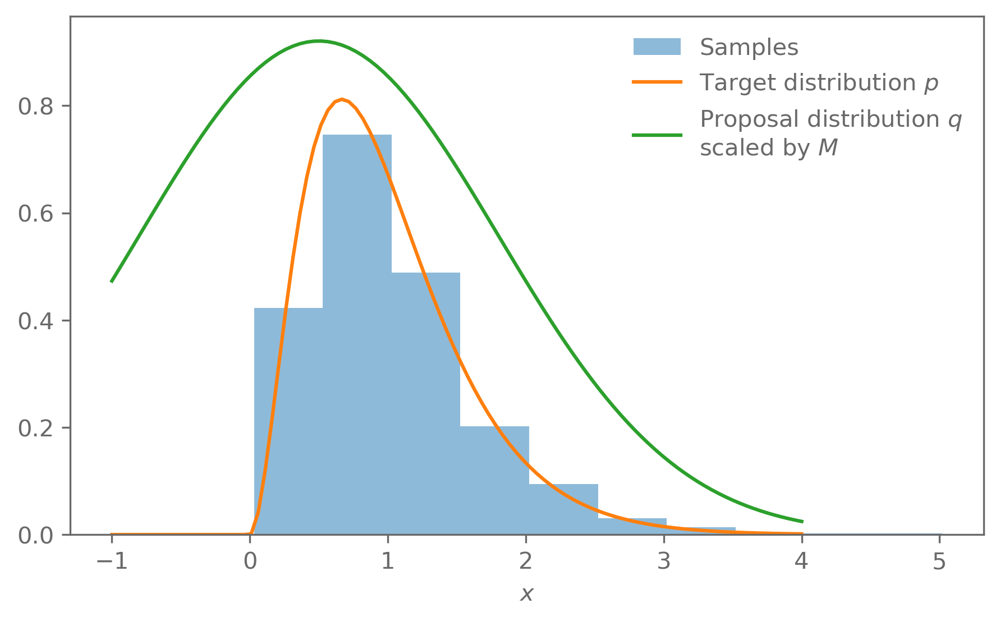

In [8]:
samples = []
for x in sample(1000):
    samples.append(x)

plt.hist(np.array(samples), density=True, alpha=0.5, label="Samples")
plt.plot(grid, target_distr.pdf(grid), label="Target distribution $p$")
plt.plot(grid, M*proposal_distr.pdf(grid), label="Proposal distribution $q$\nscaled by $M$")
plt.xlabel("$x$")
plt.legend(frameon=False);

### Challenges with rejection sampling

Finding a good proposal and $M$.

Curse of dimensionality: assume we want to sample uniformly from a disc of radius 1 and use uniform distribution on the square around the disc as the proposal distribution. 

The acceptance rate in this case is $\frac{\text{area of disc}}{\text{area of square}} = \frac{\pi}{2^2} \approx 0.79$. Pretty good!

In $d$ dimensions, the acceptance rate is 
$$
    \frac{\text{volume of unit n-ball}}{\text{volume of n-cube}} = \frac{\pi^\frac{d}{2}}{\Gamma(\frac{d}{2}+1)}\frac{1}{2^d}
$$


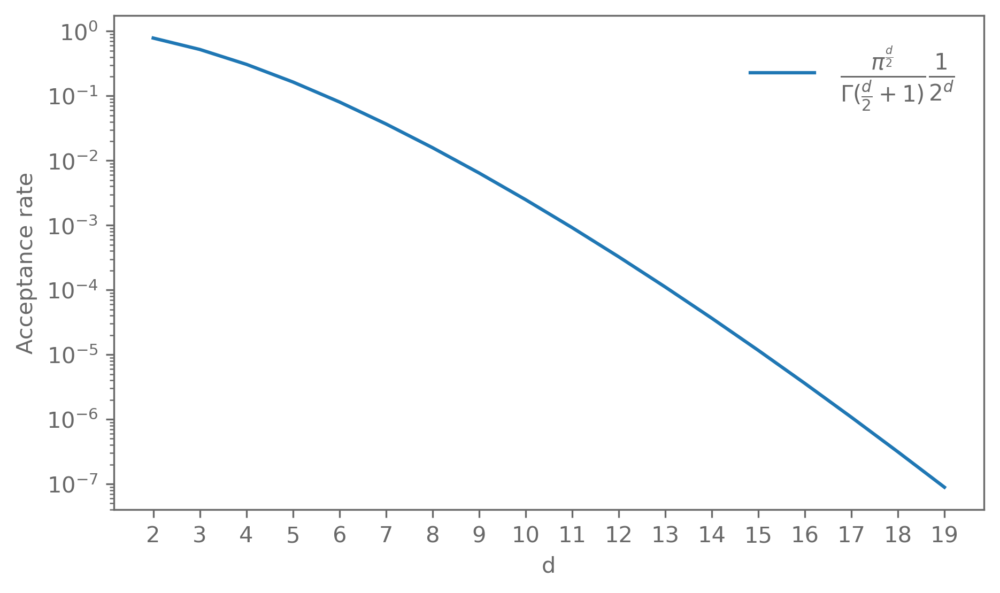

In [9]:
from scipy.special import gamma as Gamma
n = np.arange(2, 20)
acceptance_rate = np.pi**(n/2)/Gamma(n/2+1)/2**n

fig, ax = plt.subplots()
ax.semilogy(n, acceptance_rate, label=r"$\frac{\pi^\frac{d}{2}}{\Gamma(\frac{d}{2}+1)}\frac{1}{2^d}$")
ax.set_xlabel("d")
ax.set_ylabel("Acceptance rate")
ax.set_xticks(n)
ax.legend(frameon=False, fontsize="x-large")
fig.dpi = 300

### Exercise

Implement your own rejection sampling routine and test it with different target and proposal distributions.

## Markov chains Monte Carlo

Many of the Monte Carlo methods in use are built around the concept of Markov chains. 
Using such Markov chains to sample from a distribution is called Markov chain Monte Carlo (MCMC). 



A Markov chain is a sequence of RVs $X_0,\dots,X_t$ where the distribution of $X_t$ only depends on $X_{t-1}$. 

$$
\Pr(X_t = x_t | X_0=x_0,\dots X_{t-1}= x_{t-1}) = \Pr(X_t = x_t | X_{t-1}= x_{t-1})
$$

Knowing the states $X_0,\dots,X_{t-2}$ in addition to $X_{t-1}$ does not provide more information.

The probability to transition from state $y$ to $x$ in a Markov chain is given by the transition probability $T(x | y) = \Pr(X_t=x | X_{t-1}=y)$.

We want the Markov chain to sample our target distribution $p$. 
If the transition probability $T$ has the property
$$
T(x|y)p(y) = T(y | x)p(x) 
$$
it is said to respect detailed balance.



If $T$ satisfies detailed balance, then $p$ is a stationary distribution of the Markov chain:
$$
    p(x) = \sum_{y} T(x | y)p(y)
$$
If we start on $p$ and transition with $T$, then we end up with the same distribution $p$. This is what we want: as the chain transitions from one state to the next, the states should all be distributed according to $p$.

To show this
\begin{align}
    \sum_y T(x|y)p(y) &= \sum_y T(y|x)p(x) \quad \text{(detailed balance)}\\
    &= p(x) \sum_y T(y|x) \\
    & = p(x)
\end{align}

This is the distribution we care about in MCMC: we can sample from $p(x)$ by creating a Markov chain using the transition probabilities $T(x|y)$, provided they satisfy detailed balance. 
We skipped over a lot of mathematical details and conditions here but this is the basic idea on how to sample from some distribution $p(x)$.

### Metropolis-Hastings

Metropolis-Hastings is a classical MCMC algorithm. It works as follows:
Given a distribution $p(x)$ we want to sample from, a proposal distribution $q(x|y)$, and a starting point $x_{t=0}$
1. Sample a proposal $x'$ from $q$: $x'\sim q(\cdot|x_t)$
2. Compute the quantity 
$$
    a = \frac{p(x')q(x_t|x')}{p(x_t)q(x'|x_t)}
$$
3. If $a\geq 1$, accept $x'$. If $a < 1$, accept $x'$ with probability $a$:
    - If accepted: $x_{t+1} = x'$
    - If rejected: $x_{t+1} = x_t$

In the case where $q$ is symmetric ($q(x|y)=q(y|x)$), $a = \frac{p(x')}{p(x_t)}$: if the proposed point has a higher probability than the previous point, accept it. Else, accept it with probability $a$.

In [7]:
# We use a normal distribution with variance 1 as the proposal
proposal_distr = partial(scipy.stats.norm, scale=1)

def sample_transition(x0):
    return proposal_distr(loc=x0).rvs(size=1)

def transition_prob(x, y):
    # Q(x; y)
    return proposal_distr(loc=y).pdf(x)

In [15]:
def sample_for_viz(n, x0):
    x0 = np.array([x0])
    for _ in range(n):
        x1 = sample_transition(x0)
        p0 = target_distr.pdf(x0)
        p1 = target_distr.pdf(x1)

        q01 = transition_prob(x0, x1)
        q10 = transition_prob(x1, x0)

        a = p1/p0 * q01/q10
        u = np.random.uniform(size=1)

        accept = a > u
        x0_tmp, x1_tmp = x0, x1
        if accept:
            x0 = x1
        yield accept, x0, x0_tmp, x1_tmp, p0, p1, u


fig, ax = plt.subplots(1, 1)
fig.patch.set_alpha(0.0)

ax.plot(grid, target_distr.pdf(grid), color="C0")

_, _, hist = ax.hist(
    x=np.array([]), bins=hist_bins,
    density=False, alpha=0.5, color="C0"
)

samples = []
artists = []
accepted_points_artists = []

n_sample = 100

for i, (accept, x, x0, x1, p0, p1, u) in enumerate(sample_for_viz(n_sample, x0=2.0)):
    if i < 4:
        x0_point = ax.plot(x0, p0, marker="o", color="k")
        x0_label = ax.text(x=x0+0.02, y=p0+0.02, s="$x_0$")

        artists.append(x0_point + [x0_label] + accepted_points_artists + list(hist.patches))

        x0_grid = np.linspace(x0-3, x0+3, 100)
        proposal_plot = ax.plot(x0_grid, transition_prob(x0_grid, x0), color="grey")

        artists.append(x0_point + [x0_label] + proposal_plot + accepted_points_artists + list(hist.patches))

        x1_point = ax.plot(x1, p1, marker="o", color="C4")
        x1_label = ax.text(x=x1+0.02, y=p1+0.02, s="$x_1$")

        artists.append(x0_point + [x0_label] + proposal_plot + x1_point + [x1_label] + accepted_points_artists + list(hist.patches))

        hlines = [ax.hlines(p0, xmin=x0, xmax=x1, color="k")]
        hlines.append(ax.hlines(p1, xmin=x0, xmax=x1, color="C4"))
        artists.append(x0_point + [x0_label] + proposal_plot + x1_point + [x1_label] + hlines + accepted_points_artists + list(hist.patches))

        if p0 > p1:
            hlines.append(ax.hlines(p0*u, xmin=x0, xmax=x1, ls="--", color="grey"))
            artists.append(x0_point + [x0_label] + proposal_plot + x1_point + [x1_label] + hlines + accepted_points_artists + list(hist.patches))

    samples.append(x)
    _, _, hist = ax.hist(
        x=np.array(samples), bins=hist_bins,
        weights=1/n_sample/hist_bin_width*np.ones(len(samples)),
        density=False, alpha=0.5, color="C0"
    )

    if accept:
        new_point = ax.plot(x1, p1, marker="o", color="C0")
    else:
        new_point = ax.plot(x0, p0, marker="o", color="C0")
    accepted_points_artists += new_point

    artists.append(list(hist.patches) + accepted_points_artists)

mh_animation = ArtistAnimation(fig, artists=artists)
plt.close()
HTML(mh_animation.to_jshtml())

In [4]:
def sample_metropolis_hastings(n, x0, target_distr,
                               sample_transition, transition_prob):
    x0 = np.atleast_1d(x0)
    for i in range(n):
        # Sample proposal
        x1 = sample_transition(x0)
        # Compute probabilities of the old and proposed states
        p0 = target_distr.pdf(x0)
        p1 = target_distr.pdf(x1)

        # Compute the transition probabilities
        q01 = transition_prob(x0, x1)
        q10 = transition_prob(x1, x0)

        a = p1/p0 * q01/q10

        u = np.random.uniform(size=1)
        if a >= u:
            # accept, proposed state becomes new state
            x0 = x1
            yield x1
        else:
            # reject, stay with current state
            yield x0

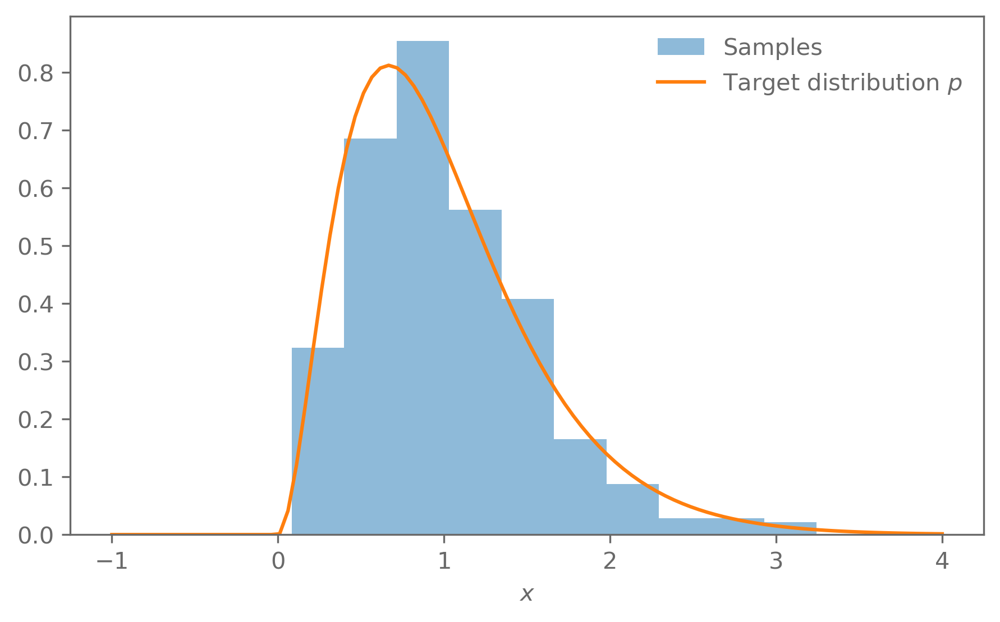

In [8]:
samples = []
for x in sample_metropolis_hastings(
        1000, x0=3, 
        target_distr=target_distr,
        sample_transition=sample_transition,
        transition_prob=transition_prob):
    samples.append(x)

plt.hist(np.array(samples)[100:], density=True, alpha=0.5, label="Samples")
plt.plot(grid, target_distr.pdf(grid), label="Target distribution $p$")
plt.xlabel("$x$")
plt.legend(frameon=False);

### Clicker

In the Metropolis-Hastings algorithm, what is the role of the proposal distribution $q(x' | x_t)$?

### Clicker

Consider using the Metropolis-Hastings algorithm to sample from a target distribution $p(x) = e^{-x^2/2}$. 

Suppose you propose a new sample $x' = x_t + \epsilon$, where $\epsilon \sim \mathcal{N}(0,1)$. 

If $x_t = 0$ and $x' = 1$, what is the acceptance probability? (Why do you not have to calculate the proposal probabilities for that?)

### Clicker

In the same situation, what is the acceptance probability to go from $x_t = 1$ to $x' = 0$?

### Challenges with Metropolis-Hastings

Metropolis-Hastings still requires a well-tuned proposal distribution to work well.

If the proposal is too broad, the acceptance rate goes down, because proposed points are likely in a low-probability part of the target distribution.

If the proposal is too narrow, Metropolis-Hasting becomes a random walk, which takes a long time to explore the full volume of the target distribution.

Having the proposal be as close to the target distribution is optimal but for that you need to know the target distribution first!

## Practical considerations for MCMC methods

The implementations shown here are the most barebones and simplest version of these methods. 
Implementing them yourselves is important to understand how these methods work and what some of the pitfalls are.

In a real-world application, with many parameters and complicated likelihoods, you probably want to use established implementations that use more sophisticated methods and are well-tested, instead of your own implementation. 

Examples are emcee, zeus, and dynesty.


Because the state of a Markov chains depends on the previous state, the samples generated in MCMC are not independent. This has a few implications:
- The chain will take some time to move from the starting position to the bulk of the target distribution. This burn-in phase needs to be removed from the chain.
- If we use $n$ samples from the chain to estimate a quantity of the distribution, for example the mean, then the variance of this estimate will not decrease as $\frac{1}{n}$, because the samples are correlated. 

This is demonstrated in the solutions to the Metropolis-Hasting exercise. 

A good description of the process can be found on the emcee documentation: https://emcee.readthedocs.io/en/stable/tutorials/autocorr/


### Exercise

- Implement Metropolis-Hastings for $n$ dimensional distributions
    - Sample from a 2D Gaussian (code on the next slide)
    - Plot the samples in the chain. How do the samples depend on the starting position?
- Show that Metropolis-Hastings satisfies detailed balance
    - Hint: $T(x|y) = q(x|y)\min(1, a)$

In [25]:
# Define variances and correlation
sigma_x = 1
sigma_y = 2
rho = 0.7

# Define mean and covariance
mean = np.array([1, 0.5])
cov = np.array([[sigma_x**2, sigma_x*sigma_y*rho],
                [sigma_x*sigma_y*rho, sigma_y**2]])

# Create distribution object
bivariate_normal = scipy.stats.multivariate_normal(mean=mean, cov=cov)

# Sample 1000 points. Do this with your MCMC implementation instead!
samples = bivariate_normal.rvs(size=1000)

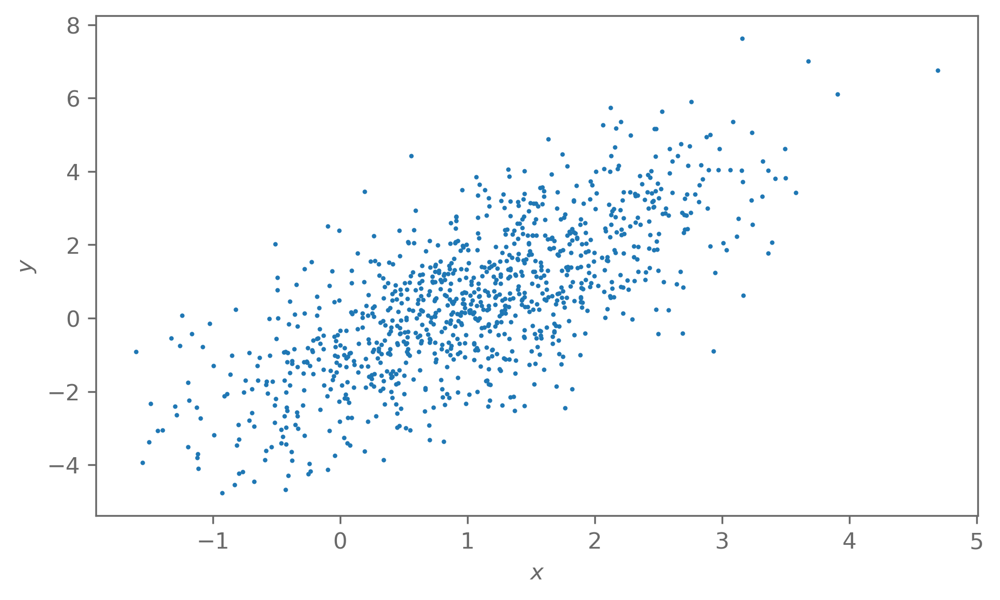

In [26]:
plt.scatter(*samples.T, s=1)
plt.ylabel("$y$")
plt.xlabel("$x$");

In [1]:
from functools import partial
from collections.abc import Iterable

import numpy as np
import scipy.stats
import astropy

import dynesty

import matplotlib.pyplot as plt

from matplotlib.animation import ArtistAnimation
from IPython.display import HTML

In [2]:
title = "# Sampling from distributions 2: slice and nested sampling"
# Print title and setup TeX defs for both KaTeX and MathJax
import bayesian_stats_course_tools
bayesian_stats_course_tools.misc.display_markdown_and_setup_tex(title)

import matplotlib.style
matplotlib.style.use("bayesian_stats_course_tools.light")

# Sampling from distributions 2: slice and nested sampling

<!-- Define LaTeX macros -->
$\def\E{\operatorname{E}}$
$\def\Var{\operatorname{Var}}$
$\def\Cov{\operatorname{Cov}}$
$\def\dd{\mathrm{d}}$
$\def\ee{\mathrm{e}}$
$\def\Norm{\mathcal{N}}$
$\def\Uniform{\mathcal{U}}$

<!-- MathJax needs them to be defined again for the non-inline environment -->
$$\def\E{\operatorname{E}}$$
$$\def\Var{\operatorname{Var}}$$
$$\def\Cov{\operatorname{Cov}}$$
$$\def\dd{\mathrm{d}}$$
$$\def\ee{\mathrm{e}}$$
$$\def\Norm{\mathcal{N}}$$
$$\def\Uniform{\mathcal{U}}$$

## Slice sampling

Slice sampling is another MCMC method and similar in that regard to Metropolis-Hastings.

Because it also samples the volume under the target distribution uniformly, it has some similarities to rejection sampling. 

The advantage over MH is that is much less reliant on tuning the proposal.

Slice sampling proceeds as follows:

1. Sample $u$ uniformly between 0 and $p(x_t)$: $u\sim\Uniform(0, p(x_t))$
2. Find an interval $L < x_t < R$ such that $p(L) < u$ and $p(R) < u$
3. Draw $x'$ uniformly from the interval $[L, R]$: $x'\sim\Uniform(L, R)$
    - If $p(x') \leq u$, shrink the interval and return to 3.
    - If $p(x') > u$, the point $(x', u)$ lies under the curve $p(x)$, so accept $x'$: $x_{t+1} = c'$


- Finding the interval for step 2 uses a stepping out procedure:

    Given a step size $w$ (this is the tuning parameter of slice sampling)
    1. Draw $r\sim\Uniform(0,1)$
    1. Set $L= x_t - rw$, $R = x_t + (1-r)w$
    1. While $p(L) > u$: $L = L - w$
    1. While $p(R) > u$: $R = R + w$



- Shrinking the interval in step 3:
    1. While $p(x') \leq u$
        - If $x' > x_t$, $R = x'$
        - Else $L = x'$


In [3]:
target_distr = scipy.stats.gamma(a=3, scale=1/3)

In [34]:
step = 1

def sample_for_viz(n, x0):
    p0 = target_distr.pdf(x0)

    for _ in range(n):
        u = np.random.uniform()
        q = p0*u

        w = np.random.uniform()

        x_l, x_r = x0 - w*step, x0 + (1-w)*step

        def step_out(x, left=True):
            p = target_distr.pdf(x)
            xs = [x]
            while p > q:
                if left:
                    x -= step
                else:
                    x += step
                p = target_distr.pdf(x)
                xs.append(x)
            return xs
        
        xs_l_out, xs_r_out = step_out(x_l, left=True), step_out(x_r, left=False)
        x_l, x_r = xs_l_out[-1], xs_r_out[-1]
        x1s = []
        xs_l_in, xs_r_in = [], []
        while True:
            x1 = np.random.uniform(low=x_l, high=x_r)
            x1s.append(x1)
            xs_l_in.append(x_l)
            xs_r_in.append(x_r)
            p1 = target_distr.pdf(x1)
            if p1 >= q:
                break
            else:
                if x1 >= x0:
                    x_r = x1
                else:
                    x_l = x1
        
        x0_tmp, p0_tmp = x0, p0
        x0 = x1
        p0 = p1
        yield x0_tmp, p0_tmp, q, xs_l_out, xs_r_out, xs_l_in, xs_r_in, x1s

def plot_slice(ax, l, r, y):
    hline = ax.hlines(y=y, xmin=l, xmax=r, color="grey")
    xl_label = ax.text(x=l+0.02, y=q+0.02, s="$x_L$")
    xr_label = ax.text(x=r+0.02, y=q+0.02, s="$x_R$")
    return [hline, xl_label, xr_label]

fig, ax = plt.subplots(1, 1)
fig.patch.set_alpha(0.0)
grid = np.linspace(-1, 4, 100)
ax.plot(grid, target_distr.pdf(grid), color="C0")

wide_grid = np.linspace(-3, 4, 100)

hist_bins = np.linspace(wide_grid[0], wide_grid[-1], 20)
hist_bin_width = hist_bins[1] - hist_bins[0]

_, _, hist = ax.hist(
    x=np.array([]), bins=hist_bins,
    density=False, alpha=0.5, color="C0"
)

samples = []
artists = []
accepted_points_artists = []

n_sample = 80

for i, (x0, p0, q, xs_l_out, xs_r_out, xs_l_in, xs_r_in, x1s) in enumerate(sample_for_viz(n=n_sample, x0=2)):
    if i < 4:
        vline = ax.vlines(x=x0, ymin=0, ymax=p0, color="grey")
        x0_label = ax.text(x=x0+0.02, y=p0+0.02, s="$x_0$")

        artists.append([vline, x0_label] + accepted_points_artists + list(hist.patches))

        q_point = ax.plot(x0, q, marker="o", color="k")
        q_label = ax.text(x=x0+0.02, y=q+0.02, s="$q$")
        artists.append([vline, x0_label] + q_point + [q_label] + accepted_points_artists + list(hist.patches))

        n_out = max(len(xs_l_out), len(xs_r_out))
        xs_l_out += (n_out - len(xs_l_out)) * [xs_l_out[-1]]
        xs_r_out += (n_out - len(xs_r_out)) * [xs_r_out[-1]]
        for l, r in zip(xs_l_out, xs_r_out):
            slice_artist = plot_slice(ax, l, r, q)
            artists.append([vline, x0_label] + q_point + [q_label] + slice_artist + accepted_points_artists + list(hist.patches))
        
        for l, r, x1 in zip(xs_l_in, xs_r_in, x1s):
            x1_point = ax.plot(x1, q, marker="o", color="C4")
            slice_artist = plot_slice(ax, l, r, q)
            artists.append([vline, x0_label] + q_point + [q_label] + slice_artist + x1_point + accepted_points_artists + list(hist.patches))

    x1 = x1s[-1]
    x1_point = ax.plot(x1, q, marker="o", color="C0")
    accepted_points_artists += x1_point

    samples.append(x1)
    _, _, hist = ax.hist(
        x=np.array(samples), bins=hist_bins,
        weights=1/n_sample/hist_bin_width*np.ones(len(samples)),
        density=False, alpha=0.5, color="C0"
    )
    artists.append(accepted_points_artists + list(hist.patches))

    
slice_sampling_ani = ArtistAnimation(fig, artists=artists)
plt.close()
HTML(slice_sampling_ani.to_jshtml())

In [35]:
def sample_slice_sampling(n, x0, target_distr, step):
    p0 = target_distr.pdf(x0)

    for _ in range(n):
        u = np.random.uniform(0, p0)

        # Define the initial interval
        w = np.random.uniform(0, 1)
        x_l, x_r = x0 - w*step, x0 + (1-w)*step

        # Define a step-out function
        def step_out(x, left=True):
            p = target_distr.pdf(x)
            while p > u:
                if left:
                    x -= step
                else:
                    x += step
                p = target_distr.pdf(x)
            return x
        
        # Step out until p(x_l) < u and p(x_r) < u
        x_l, x_r = step_out(x_l, left=True), step_out(x_r, left=False)

        # Shrink the interval until we have a sample from under the 
        # curve of the target distribution
        while True:
            x1 = np.random.uniform(low=x_l, high=x_r)
            p1 = target_distr.pdf(x1)
            if p1 > u:
                # Accept the point x1
                break
            else:
                # Shrink the inverval
                if x1 >= x0:
                    x_r = x1
                else:
                    x_l = x1

        x0 = x1
        p0 = p1
        yield x0

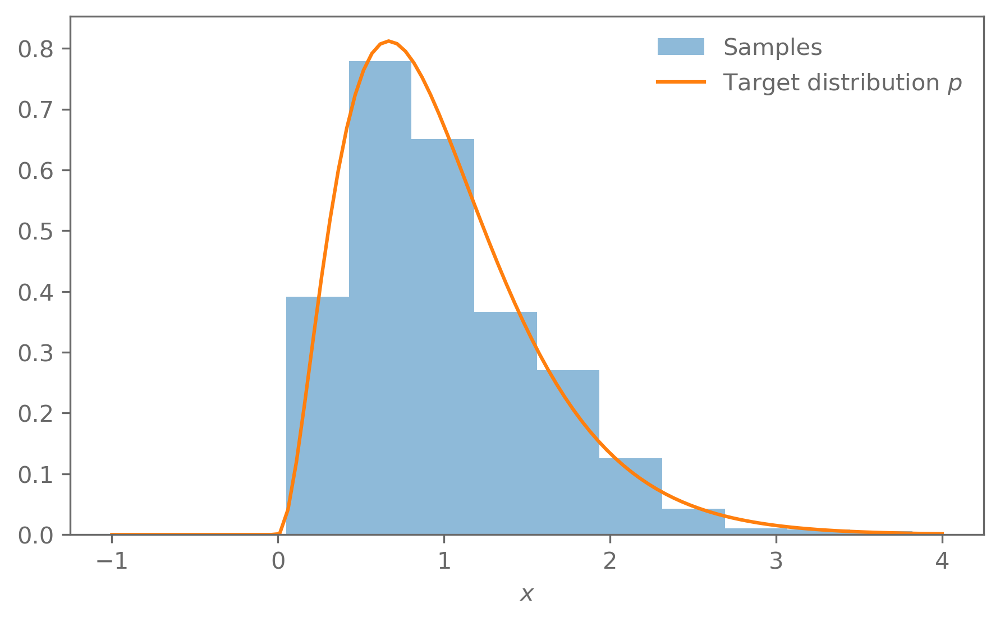

In [36]:
samples = []
for x in sample_slice_sampling(1000, x0=3, target_distr=target_distr, step=1):
    samples.append(x)

plt.hist(np.array(samples)[10:], density=True, alpha=0.5, label="Samples")
plt.plot(grid, target_distr.pdf(grid), label="Target distribution $p$")
plt.xlabel("$x$")
plt.legend(frameon=False);

Slice sampling is for example implemented in [zeus](https://zeus-mcmc.readthedocs.io), which uses a set of walkers like emcee to do the sampling.

Slice sampling is also being used under the hood in many nested sampling implementations.

### Clicker

Which of the following is a key advantage of slice sampling over the Metropolis-Hastings algorithm?
- It does not require any tuning parameters.
- It automatically adjusts the step size to achieve optimal mixing.
- It requires less tuning.
- It guarantees faster convergence to the target distribution.

## Nested sampling

A good review paper is https://arxiv.org/abs/2205.15570, which has come out just recently and gives a good introduction as well as summarises the state of the art in nested sampling.

Nested sampling takes a very different approach to sampling than the MCMC methods covered so far. 
The main advantage is its ability to estimate the evidence $p(d)$ in Bayes' theorem:
$$
    p(\theta|d) = \frac{p(d|\theta)p(\theta)}{p(d)}
$$


The evidence becomes very useful when comparing models:

Recall that we can use the Bayes' ratio to compare the probability of two models $M_1$ and $M_2$:
$$
    R = \frac{p(d | M_1)}{p(d | M_2)}
$$
With nested sampling we can compute the evidences $p(d | M_1)$ and $p(d | M_2)$.


To make the notation clearer (and consistent with some of the literature on nested sampling), write this as
$$
    p(\theta) = \frac{L(\theta)\pi(\theta)}{Z} \ ,
$$
where
- $L(\theta) = p(d|\theta)$ is the likelihood,
- $\pi(\theta)=p(\theta)$ is the prior,
- $Z=p(d)$ is the evidence or marginal likelihood,
- $p(\theta)$ is the posterior.


How to compute the evidence?

Since the posterior is a normalised probability distribution:
$$
    \int p(\theta | d) p(d)\dd \theta = \int p(d|\theta)p(\theta)\dd \theta = p(d)\,.
$$



Or in the other notation:
$$
    Z = \int L(\theta)\pi(\theta)\dd \theta
$$

For high-dimensional problems this is usually intractable by naive integration. 

To see this, imagine discretising the integral into 50 intervals: $Z = \sum_i^{50} L(\theta_i)\pi(\theta_i)\Delta\theta$. In 10 dimensions (which is not much as far as real-world applications are concerned), this would require $50^{10}\approx 10^{17}$ evaluations of the likelihood. 



The idea behind nested sampling is to rewrite the integral so that instead of integrating over $\theta$, the integral is over levels of the likelihood. This is somewhat like doing Lebesgue integration instead of Riemann integration. 

Define $\dd X = \pi(\theta)\dd\theta$. Then
$$ 
    Z = \int L(\theta)\pi(\theta)\dd \theta = \int L(X)\dd X\,.
$$


$L(X)$ is the inverse of $X(L)$, which is the volume of the likelihood (weighted by the prior) above some likelihood level $L^*$:
$$
    X(L^*) = \int_{L(\theta)>L^*}\pi(\theta)\dd \theta
$$ 


With this, the integral for $Z$ can now be evaluated numerically, since $X \in (0,1)$, for example with the trapezoidal rule:
$$
    Z \approx \sum_i w_i L_i,\quad w_i=\frac{1}{2}(X_{i-1} - X_{i+1}), \quad L_i = L(X_i)
$$

So we need an algorithm to compute the likelihoods $L_i$ and volumes $X_i$. 

The nested sampling algorithm works like this:
1. Sample $n_\mathrm{live}$ live points from the prior
2. At each iteration $i$, find the point with the lowest likelihood. This now becomes a dead point. We record its likelihood $L_i^*$ and remove the dead point from our live points.
3. Sample a new point from the prior, with the constraint that $L(\theta) > L_i^*$
4. Estimate the volume $X_i$ of the likelihood above $L_i^*$.
5. Estimate $Z = \sum_i L_i^*\Delta X_i$ and iterate from 2. until some convergence criterion on $Z$ is reached.


How do we estimate the volumes $X_i$? 

The idea is similar to the Monte Carlo estimation of $\pi$ at the beginning of the course: we sample an outer volume (the square) and count how many points end up inside the smaller inner volume (the quadrant of the circle).

The ratio of the volumes is then approximated by the ratio of the points inside the inner volume over all the points:

$$
    \frac{V_\mathrm{inner}}{V_\mathrm{outer}} \approx \frac{\text{number of samples in }V_\mathrm{inner}}{\text{number of samples in }V_\mathrm{outer}}
$$



In nested sampling, the inner volume is $X_i$, the volume of the likelihood where $L(\theta)>L_i^*$, has the $n_\mathrm{live}$ live points.

The outer volume, the volume of the likelihood where $L(\theta)>L_{i-1}^*$ has $n_\mathrm{live}+1$ points. The $n_\mathrm{live}$ live points plus the recent dead point. 

At each iteration, the volume $X(L)$ therefore decreases by a factor of approximately $t_i\approx\frac{n_\mathrm{live}}{n_\mathrm{live}+1}$. 

The volume after $i$ iterations is then $X_i = t_i X_{i-1} =  t_i \dots t_1 X_0$, with $X_0 = 1$.

The dead points sample the posterior, when weighted appropriately. 
To see this, consider how an expectation of $f$ with respect to the posterior $p(\theta)$ is defined:
$$
    \E_p[f] = \int f(\theta)p(\theta)\dd\theta = \int f(\theta)\frac{L(\theta)\pi(\theta)}{Z}\dd\theta \,. 
$$


Now write this in terms of $\dd X=\pi(\theta)\dd\theta$:
$$
    \E_p[f] = \frac{1}{Z}\int f L \dd X \approx \sum_i \frac{w_i L_i}{Z} f_i, \quad f_i = f(\theta_i) 
$$



So the dead point are posterior samples if they are weighted with weights $p_i$:
$$
    p_i = \frac{w_i L_i}{Z}\ ,\quad w_i=\frac{1}{2}(X_{i-1} - X_{i+1})
$$

Nested sampling is built around estimating the evidence but we get posterior samples for free in the process!

In [37]:
# We need to define separate likelihood and prior for nested sampling
log_likelihood = target_distr.logpdf
prior = scipy.stats.uniform(0., 2.)

In [43]:
import scipy.optimize
import matplotlib.patches
import matplotlib.collections


def sample_for_viz(log_likelihood, prior, n_live, n_iter):
    live_points = prior.rvs(n_live)
    log_L = log_likelihood(live_points)
    if not np.all(np.isfinite(log_L)):
        raise ValueError("Non-finite log likelihood for some points.")

    dead_points = []
    dead_points_log_L = []

    birth_points = []
    birth_points_log_L = []

    n_eval = live_points.shape[0]
    for i in range(n_iter):
        idx = np.argmin(log_L)
        log_L_star = log_L[idx]

        dead_points.append(live_points[idx])
        dead_points_log_L.append(log_L_star)

        while True:
            new_point = prior.rvs(1).squeeze()
            log_L_new = log_likelihood(new_point)
            n_eval += 1
            if np.isfinite(log_L_new) and log_L_new > log_L_star:
                birth_points.append(new_point)
                birth_points_log_L.append(log_L_new)
                break
        
        yield live_points, log_L, idx, dead_points, dead_points_log_L, birth_points, birth_points_log_L
        
        live_points[idx] = new_point
        log_L[idx] = log_L_new

        

fig, ax = plt.subplots(1, 1)
fig.patch.set_alpha(0.0)

ax.plot(grid, target_distr.pdf(grid), color="C0")

artists = []

L_star_last = 0
L_levels = []

for live_points, log_L, idx, dead_points, dead_points_log_L, birth_points, birth_points_log_L in sample_for_viz(
        log_likelihood=log_likelihood, prior=prior, n_live=10, n_iter=20):
    
    live_points_plot = ax.scatter(live_points, np.exp(log_L), c="grey")
    dead_points_plot = ax.scatter(dead_points[:-1], np.exp(dead_points_log_L[:-1]), c="C3")

    new_dead_point = ax.scatter(dead_points[-1], np.exp(dead_points_log_L[-1]), c="C3")
    new_point = ax.scatter(birth_points[-1], np.exp(birth_points_log_L[-1]), c="C2")

    log_L_star = dead_points_log_L[-1]
    theta_star = dead_points[-1]
    try:
        res = scipy.optimize.root_scalar(lambda x: log_likelihood(x) - log_L_star, method="brentq", bracket=(0, theta_star-1e-4), x0=0)
    except ValueError:
        res = scipy.optimize.root_scalar(lambda x: log_likelihood(x) - log_L_star, method="brentq", bracket=(theta_star+1e-4, 4), x0=4)
    theta_prime = res.root

    L_levels += [matplotlib.patches.Rectangle(
        xy=(min(theta_prime, theta_star), L_star_last),
        width=abs(theta_prime-theta_star),
        height=np.exp(log_L_star)-L_star_last
    )]
    L_star_last = np.exp(log_L_star)

    boxes = [ax.add_collection(matplotlib.collections.PatchCollection(L_levels[:-1]))]

    artists.append(
        [live_points_plot] + [dead_points_plot] + [new_dead_point] + boxes
    )
    artists.append(
        [live_points_plot] + [dead_points_plot] + [new_dead_point] + [new_point] + boxes
    )
    boxes = [ax.add_collection(matplotlib.collections.PatchCollection(L_levels))]
    artists.append(
        [live_points_plot] + [dead_points_plot] + [new_dead_point] + [new_point] + boxes
    )



nested_sampling_ani = ArtistAnimation(fig, artists=artists)
plt.close()
HTML(nested_sampling_ani.to_jshtml())

In [41]:
from scipy.special import logsumexp
import tqdm

def sample_nested_sampling(log_likelihood, prior, n_live,
                           tol=0.01, n_max_iter=100000):
    # Sample the initial set of live points from the prior
    live_points = prior.rvs(n_live)
    # Get their log likelihoods
    log_L = log_likelihood(live_points)
    if not np.all(np.isfinite(log_L)):
        raise ValueError("Non-finite log likelihood for some points.")

    # Set up some book-keeping
    log_tol = np.log(tol)

    log_X = [0,]

    dead_points = []
    dead_points_log_L = []

    n_eval = live_points.shape[0]
    drain_live_points = False
    i = 0
    progress = tqdm.tqdm()
    while i < n_max_iter:
        # Find the live point with the lowest likelihood
        idx = np.argmin(log_L)
        # Call the likelihood at this point L^*
        log_L_star = log_L[idx]

        # This lowest likelihood point becomes a dead point
        dead_points.append(live_points[idx])
        dead_points_log_L.append(log_L_star)

        # Estimate the shrinkage of the likelihood volume when removing the
        # lowest-likelihood point
        log_t = -1/n_live
        log_X.append(log_X[-1] + log_t)
        
        # Check for convergence of the evidence estimate
        if i > 4:
            # Compute the volumes and weights
            X = np.exp(np.array(log_X))
            w = 0.5*(X[:-2]- X[2:])
            # Estimate Z = \sum_i w_i L^*_i
            log_Z = logsumexp(np.array(dead_points_log_L[:-1]), b=w)
            # Estimate the error on Z as the mean of the likelihoods of the
            # live points times the current likelihood volume
            # \Delta Z = X_i \frac{1}{n_{live}}\sum_j L_j
            log_mean_L = logsumexp(log_L, b=1/n_live)
            log_Delta_Z = log_mean_L + log_X[-1]
            # If the estimated error is less than the tolerance, stop sampling
            # new live points for the dead points that get removed
            if log_Delta_Z - log_Z < log_tol:
                drain_live_points = True
                live_points = np.delete(live_points, idx)
                log_L = np.delete(log_L, idx)
                if len(log_L) == 0:
                    break
            
            progress.set_postfix({"log_Z": log_Z, "n_eval": n_eval, "iter": i})

        # Sample a new live point from the prior with a likelihood higher than
        # L^*
        while not drain_live_points:
            # Sampling from the whole prior is very inefficient, in practice
            # there are more sophisticed sampling schemes
            new_point = prior.rvs(1).squeeze()
            log_L_new = log_likelihood(new_point)
            n_eval += 1
            if np.isfinite(log_L_new) and log_L_new > log_L_star:
                live_points[idx] = new_point
                log_L[idx] = log_L_new
                break
        
        i += 1
    
    # Because the estimate of the volumes is stochastic, we can sample many of 
    # them to get the uncertainty on our evidence estimate
    dead_points = np.array(dead_points)
    dead_points_log_L = np.array(dead_points_log_L)
    n_sample = 100
    t_sample = scipy.stats.beta(n_live, 1).rvs((n_sample, len(dead_points_log_L)))
    log_X_sample = np.insert(np.cumsum(np.log(t_sample), axis=1), 0, 0, axis=1)
    X_sample = np.exp(log_X_sample)
    w_sample = 0.5*(X_sample[:, :-2]- X_sample[:, 2:])
    log_Z = scipy.special.logsumexp(dead_points_log_L[:-1], b=w_sample, axis=1)

    return log_Z, dead_points, w*np.exp(dead_points_log_L)[:-1]


In [52]:
log_Z, dead_points, weights = sample_nested_sampling(
    log_likelihood=log_likelihood, prior=prior,
    n_live=100, tol=0.01, n_max_iter=10000)

# In this case we can find the exact evidence by direct integration
import scipy.integrate
log_Z_exact = np.log(
    scipy.integrate.quad(
        lambda x: target_distr.pdf(x)*prior.pdf(x),
        0, 4
    )[0]
)

print(f"Exact log Z: {log_Z_exact:.2f}")
print(f"Nested sampling estimate of log Z: "
      f"{np.mean(log_Z):.2f}±{np.std(log_Z):.2f}")

0it [00:04, ?it/s, log_Z=-0.813, n_eval=19392, iter=619]


Exact log Z: -0.76
Nested sampling estimate of log Z: -0.81±0.05


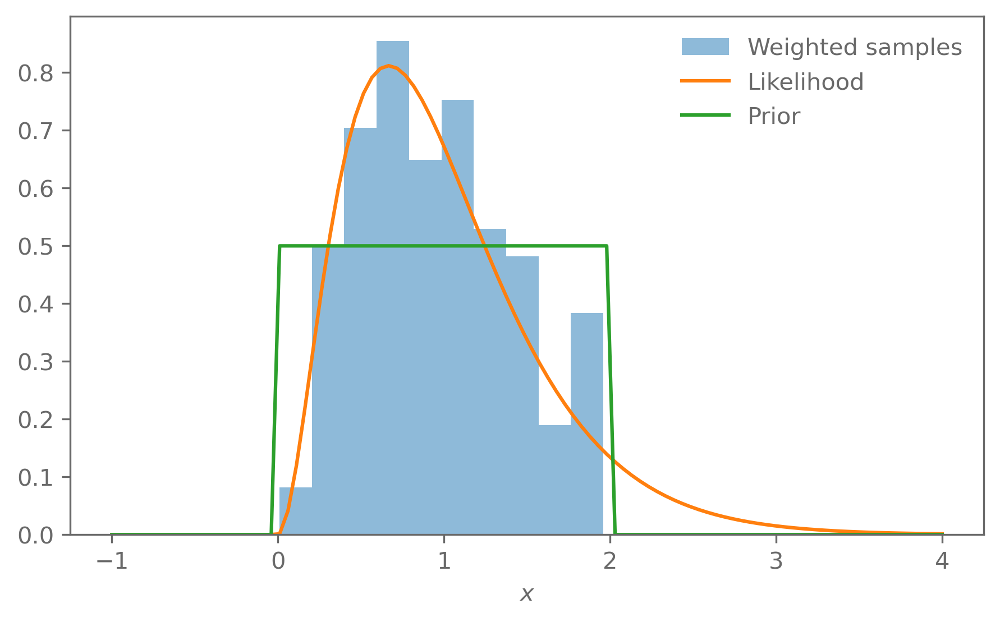

In [53]:
plt.hist(dead_points[:-1], density=True, weights=weights, alpha=0.5, label="Weighted samples")
plt.plot(grid, target_distr.pdf(grid), label="Likelihood")
plt.plot(grid, prior.pdf(grid), label="Prior")
plt.xlabel("$x$")
plt.legend(frameon=False);

### Clicker

What is the primary function of live points in the algorithm?
- They are used to randomly sample new points from the likelihood distribution, which speeds up the convergence.
- They track the likelihood of all previously explored points, ensuring none are revisited during sampling.
- They are used to directly estimate the posterior distribution at each iteration.
- They define the current region of the prior being explored and are iteratively replaced to shrink the likelihood volume.

### Challenges with nested sampling
The big challenge in implementing nested sampling in practice is sampling from the prior with a likelihood constraint. This requires running MCMC or rejection sampling at each step to get a new live point.

If all you care about is posterior samples, then nested sampling can be quite inefficient. 
Its strength is really the estimation of the evidence, which is important for model comparison.

### Clicker

Recall the Bayes' ratio to compare the probability of two models $M_1$ and $M_2$:
$$
    R = \frac{p(d | M_1)}{p(d | M_2)}
$$
With evidences $Z_1 = p(d | M_1)$ and $Z_2 = p(d | M_2)$.

Does the choice of a prior affect the Bayes ratio?
- Yes, because larger prior ranges allow for a broader range of parameter values to contribute to the evidence, leading to a more flexible model comparison.
- No, the prior only affects the normalization of the posterior distribution, not the evidence $Z$.
- Yes, because the prior volume changes the evidence.
- No, because the priors cancel out in the Bayes ratio.

 
The evidence is sensitive to the prior volume:
$$
    Z = \int L(\theta)\pi(\theta)\dd \theta
$$

Let us assume we have a uniform prior over some volume $V$: $\pi(\theta) \propto \frac{1}{V}$.

If the likelihood is much more constraining than the prior, the posterior does not change when we change the size of the prior. 

But the evidence scales with the prior volume: $Z\propto \frac{1}{V}$. When comparing models, some care must be taken as not to be affected by prior volumes.

### Dynesty

A well-developed package for doing nested sampling is [dynesty](https://dynesty.readthedocs.io). Other options are [PolyChord](https://github.com/PolyChord/PolyChordLite) or [ultranest](https://johannesbuchner.github.io/UltraNest/index.html), or [JAXNS](https://jaxns.readthedocs.io) if you have a differentiable likelihood (we get to these next week).

The dynesty and ultranest documentations also have good tutorials and explanations on how nested sampling works.



To allow sampling from the prior, these packages usually require you define a prior transform function that maps samples from the unit (hyper)-cube to samples from your prior using inverse transform sampling.

In [54]:
def prior_transform(u):
    """Transforms samples `u` drawn from the unit cube to samples to those
    from our U(0, 2) prior"""

    return 2*u

def prior_transform_with_scipy(u):
    return scipy.stats.norm(loc=1, scale=2).ppf(u)

In [55]:
import dynesty

sampler = dynesty.NestedSampler(
    loglikelihood=lambda x: log_likelihood(x).squeeze(), # Need to add the squeeze so it works in 1d
    prior_transform=prior_transform,
    ndim=1,
    nlive=100,
)
sampler.run_nested(print_progress=False)

# Show summary of the run
sampler.results.summary()

# We can samples from the distribution
samples = sampler.results.samples_equal()

Summary
nlive: 100
niter: 291
ncall: 1667
eff(%): 23.455
logz: -0.827 +/-  0.063


## Application: is the Universe flat?

As the Universe expands, photons lose energy: space expands, which causes the wave length of photons to increase.

Objects further away thus have their spectrum shifted to longer wave lengths: the cosmological redshift.

If we can measure the distance and redshift of an object, we can learn about how the Universe expands, from which we can infer how much dark energy there is, if the Universe is spatially flat, etc.



Here we want to find out if the Universe is better described by a model that assumes that the Universe is spatially flat or one that allows curvature.

Recall that we can use the Bayes' ratio to compare the probability of two models $M_1$ and $M_2$:
$$
    R = \frac{p(d | M_1)}{p(d | M_2)}
$$
With nested sampling we can compute the evidences $Z_1 = p(d | M_1)$ and $Z_2 = p(d | M_2)$.

One way to do this to look at Type Ia super novae: due to the astrophysical processes behind them, we know how bright they are intrinsically. This allows us to estimate the distance to a Type Ia super nova. This is a special property, usually we do not know how far objects are away!



Given a redshift $z$ and a cosmological model, we can compute the luminosity distance $d_L(z)$:
$$
d_L(z) = (1+z) c \int_0^z \frac{\dd z'}{H(z')}\,,
$$
where $c$ is the speed of light and
$$
H(z)^2 = H_0^2\left(\Omega_m(1+z)^3 + \Omega_\Lambda + (1-\Omega_m-\Omega_\Lambda)(1+z)^{-2}\right) \,.
$$
Here $H_0$ is the Hubble constant (the expansion rate of the Universe today), $\Omega_m$ the amount of matter in the Universe, and $\Omega_\Lambda$ the amount of dark energy.



For historical reasons, units in astronomy are weird. Instead of using the luminosity distance as the quantity to compare with data, we use the distance modulus $\mu(z)$:
$$
\mu(z) = 5\log_{10}\left(\frac{d_L(z)}{10\,\mathrm{pc}}\right) + M\,,
$$
where $M$ is a calibration parameter that we will marginalise over.


For the data we use the Pantheon sample (Brout+2022, https://arxiv.org/abs/2202.04077). This includes about 1500 Type Ia super novae and is the state-of-the-art data set fort this observation. We simplify our analysis a little bit here but the full setup is not that much more complicated.

The data are observations of the distance moduli $\hat{\mu_i}$ at redshfits $z_i$. The data are correlated, so we need a multivariate Gaussian likelihood:
$$
\vec{\hat{\mu}} \sim \Norm(\vec{\mu}(\vec z), \Sigma)\,,
$$
where the $\vec{\mu}(\vec z)$ is the predicted distance modulus from the last slide.

The full model and data is implemented in `projects/dark_energy_SN`:

In [56]:
import sys
sys.path.append("../projects/dark_energy_SN/")
from likelihood import PantheonSH0ESLikelihood

# This holds the data and takes care of the modelling
pantheon_sh0es = PantheonSH0ESLikelihood(
    data_file_name="../projects/dark_energy_SN/data/pantheon_sh0es.npz",
)

# Pull out data for our simplified analysis
z_data = pantheon_sh0es.z_CMB
data = pantheon_sh0es.magnitude_data
data_error_bar = pantheon_sh0es.magnitude_data_error
inv_covariance = np.linalg.inv(pantheon_sh0es.covariance_no_calibrator)

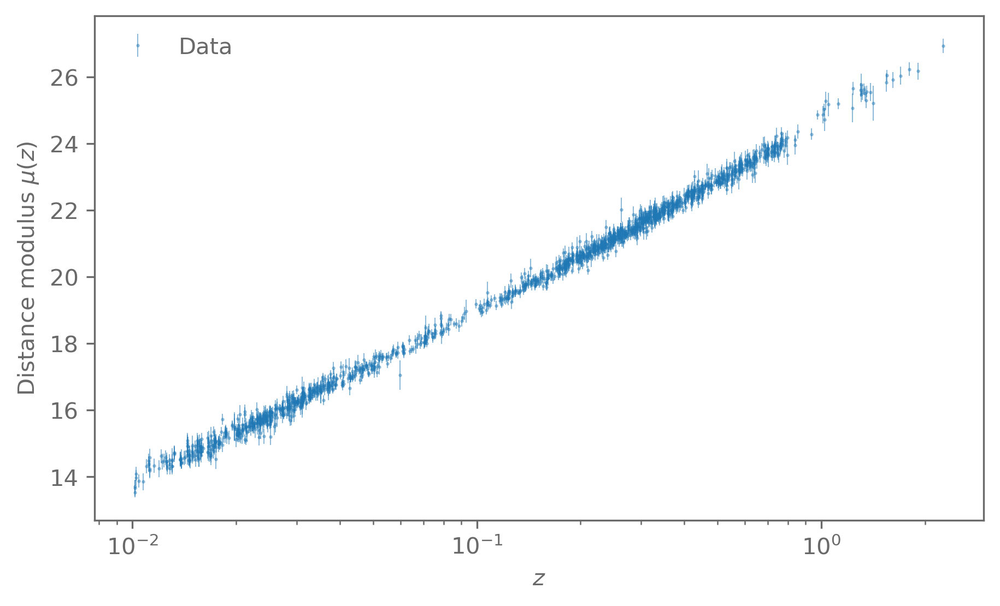

In [57]:
# And plot it
fig, ax = bayesian_stats_course_tools.analyse.plot_data(
    x=z_data, y=data, y_err=data_error_bar, axis_labels=["$z$", r"Distance modulus $\mu(z)$"],
    linestyle="none", marker=".", markersize=1, alpha=0.5, elinewidth=0.5,
)
ax.set_xscale("log")

Implement the physics model. We use the `astropy` library to compute the luminosity distance.

In [58]:
def compute_distance_modulus(cosmology, z):
    luminosity_distance = cosmology.luminosity_distance(z)
    luminosity_distance = (luminosity_distance/astropy.units.Mpc).value

    mu = 5.0*np.log10(luminosity_distance*1e6/10)
    return mu

def LCDM_distance_modulus_model(theta, z):
    H_0, Omega_m, Omega_de, M = theta
    cosmology = astropy.cosmology.LambdaCDM(H0=H_0, Om0=Omega_m, Ode0=Omega_de)

    prediction = compute_distance_modulus(cosmology, z)
    prediction += M

    return prediction

We also look at another model where we assume the Universe is spatially flat. This is the case when $\Omega_m + \Omega_\Lambda = 1$. We then want to find out if the data prefer the general model or the flat model.

In [19]:
def flat_LCDM_distance_modulus_model(theta, z):
    H_0, Omega_m, M = theta
    cosmology = astropy.cosmology.FlatLambdaCDM(H0=H_0, Om0=Omega_m)

    prediction = compute_distance_modulus(cosmology, z)
    prediction += M

    return prediction

Define our priors. In our simplified analysis we cannot constrain $H_0$, we use the results from another experiment as our prior.

In [20]:
# From the SH0ES analysis Riess+2022 (https://arxiv.org/abs/2112.04510)
H_0_prior = scipy.stats.norm(loc=73.04, scale=1.04)

# scipy.stats.uniform defines the interval as [loc, loc+scale]
Omega_m_prior = scipy.stats.uniform(loc=0.1, scale=0.8)
Omega_de_prior = scipy.stats.uniform(loc=0.1, scale=0.8)
M_prior = scipy.stats.uniform(loc=-20, scale=2)

Finally the multivariate Gaussian likelihood.

In [21]:
def make_likelihood(model):
    def log_likelihood(theta):
        r = data - model(theta, z=z_data)
        return -0.5 * r @ inv_covariance @ r
    
    L = np.linalg.cholesky(pantheon_sh0es.covariance_no_calibrator)

    def sample_from_likelihood(theta):
        # scipy.stats.multivariate_normal is VERY slow for the 
        # large covariance we have, so we sample it ourselves
        mu = model(theta, z=z_data)
        sample = L @ np.random.normal(size=mu.size) + mu
        return sample
    
    return log_likelihood, sample_from_likelihood

In [22]:
log_likelihood_LCDM, sample_from_likelihood_LCDM = make_likelihood(LCDM_distance_modulus_model)

def log_prior_lcdm(theta):
    H_0, Omega_m, Omega_de, M = theta
    return H_0_prior.logpdf(H_0) + Omega_m_prior.logpdf(Omega_m) + Omega_de_prior.logpdf(Omega_de) + M_prior.logpdf(M)

def log_posterior_lcdm(theta):
    p = log_prior_lcdm(theta)
    if not np.isfinite(p):
        return -np.inf
    return log_likelihood_LCDM(theta) + p

theta_init_lcdm = np.array([80.0, 0.2, 0.5, -19.5])

MAP_result = scipy.optimize.minimize(
    fun=lambda theta: -log_posterior_lcdm(theta),
    x0=theta_init_lcdm,
    method="Nelder-Mead",
)
theta_MAP_lcdm = MAP_result.x

In [23]:
log_likelihood_flat_LCDM, sample_from_likelihood_flat_LCDM = make_likelihood(flat_LCDM_distance_modulus_model)

def log_prior_flat_lcdm(theta):
    H_0, Omega_m, M = theta
    return H_0_prior.logpdf(H_0) + Omega_m_prior.logpdf(Omega_m) + M_prior.logpdf(M)

def log_posterior_flat_lcdm(theta):
    p = log_prior_flat_lcdm(theta)
    if not np.isfinite(p):
        return -np.inf
    return log_likelihood_flat_LCDM(theta) + p

theta_init_flat_lcdm = np.array([80.0, 0.2, -19.5])

MAP_result = scipy.optimize.minimize(
    fun=lambda theta: -log_posterior_flat_lcdm(theta),
    x0=theta_init_flat_lcdm,
    method="Nelder-Mead",
)
theta_MAP_flat_lcdm = MAP_result.x


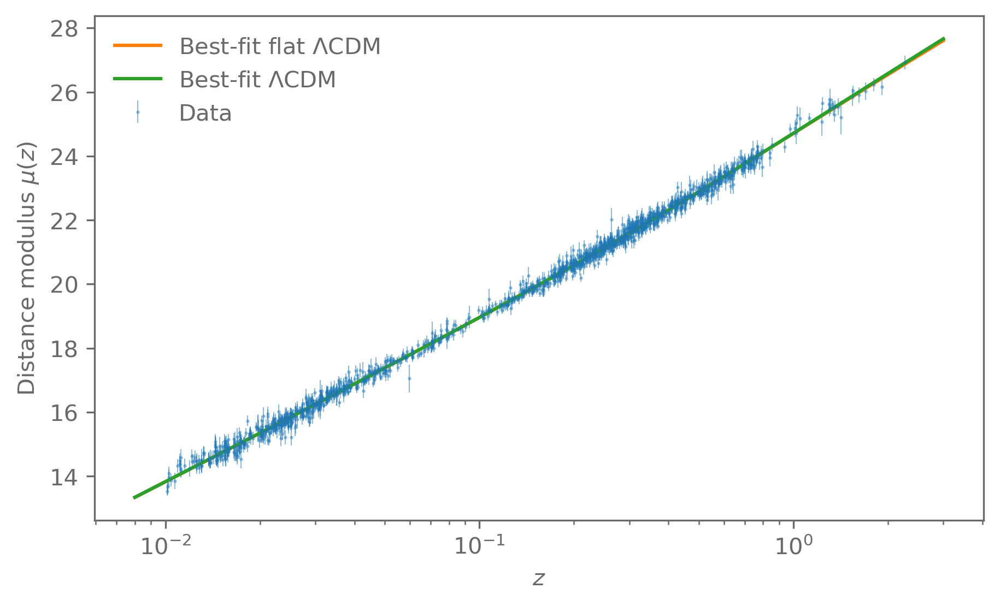

In [24]:
z_fine = np.geomspace(0.008, 3, 100)

fig, ax = bayesian_stats_course_tools.analyse.plot_data(
    x=z_data, y=data, y_err=data_error_bar, axis_labels=["$z$", r"Distance modulus $\mu(z)$"],
    linestyle="none", marker=".", markersize=1, alpha=0.5, elinewidth=0.5,
    models=[
        dict(x=z_fine, y=flat_LCDM_distance_modulus_model(theta=theta_MAP_flat_lcdm, z=z_fine), style={"label": r"Best-fit flat $\Lambda$CDM"}),
        dict(x=z_fine, y=LCDM_distance_modulus_model(theta=theta_MAP_lcdm, z=z_fine), style={"label": r"Best-fit $\Lambda$CDM"})
    ]
)
ax.set_xscale("log")

Both models fit the data very well. Can we still say which one we should prefer?

Recall that we can use the Bayes' ratio to compare the probability of two models $M_1$ and $M_2$:
$$
    R = \frac{p(d | M_1)}{p(d | M_2)}
$$

With nested sampling we can compute the evidences $Z_1 = p(d | M_1)$ and $Z_2 = p(d | M_2)$.

Set up the priors for `dynesty`:

In [25]:
def prior_transform_flat_LCDM(u):
    x = np.array([
        H_0_prior.ppf(u[0]),
        Omega_m_prior.ppf(u[1]),
        M_prior.ppf(u[2])
    ])

    return x

def prior_transform_LCDM(u):
    x = np.array([
        H_0_prior.ppf(u[0]),
        Omega_m_prior.ppf(u[1]),
        Omega_de_prior.ppf(u[2]),
        M_prior.ppf(u[3])
    ])

    return x

And run `dynesty` to get estimates of the evidence. We get samples from the posterior as well during this.

In [26]:
sampler_flat_lcdm = dynesty.NestedSampler(
    loglikelihood=log_likelihood_flat_LCDM,
    prior_transform=prior_transform_flat_LCDM,
    ndim=3,
    nlive=100,
)
sampler_flat_lcdm.run_nested(print_progress=True)

sampler_flat_lcdm.results.summary()

1070it [01:23, 12.78it/s, +100 | bound: 71 | nc: 1 | ncall: 14410 | eff(%):  8.176 | loglstar:   -inf < -720.845 <    inf | logz: -729.220 +/-  0.270 | dlogz:  0.001 >  0.109]

Summary
nlive: 100
niter: 1070
ncall: 14310
eff(%):  8.176
logz: -729.220 +/-  0.321


In [27]:
sampler_lcdm = dynesty.NestedSampler(
    loglikelihood=log_likelihood_LCDM,
    prior_transform=prior_transform_LCDM,
    ndim=4,
    nlive=100,
)
sampler_lcdm.run_nested(print_progress=True)

sampler_lcdm.results.summary()

1074it [01:28, 12.09it/s, +100 | bound: 83 | nc: 1 | ncall: 15568 | eff(%):  7.590 | loglstar:   -inf < -720.723 <    inf | logz: -729.147 +/-  0.266 | dlogz:  0.001 >  0.109]

Summary
nlive: 100
niter: 1074
ncall: 15468
eff(%):  7.590
logz: -729.147 +/-  0.315


To get an estimate of the uncertainty of the Bayes' ratio, we use a tool from `dynesty` to resample our runs to get a set of evidence estimates.

In [28]:
log_R = []
for i in range(100):
    log_z_flat_lcdm = dynesty.utils.jitter_run(sampler_flat_lcdm.results).logz[-1]
    log_z_lcdm = dynesty.utils.jitter_run(sampler_lcdm.results).logz[-1]
    log_R.append(log_z_flat_lcdm - log_z_lcdm)

log_R = np.array(log_R)

R_mean = np.mean(np.exp(log_R))
R_std = np.std(np.exp(log_R))
print(f"Bayes' ratio: {R_mean:.2f} ± {R_std:.2f}")

Bayes' ratio: 0.97 ± 0.36


This suggets that flat model is about as likely than the more general model.

## Project ideas

- Look deeper into one of the sampling methods. For example, how do the more sophisticated algorithms in `emcee`, `zeus`, or `dynesty` work?
- Do a full analysis of the super nova data set, following the Bayesian data analysis workflow:
    1. Build the model (that's already done for you), check that the model is reasonable with prior predictive checks
    1. Fit the model (MAP, posterior). Analyse the posterior distribution.
    1. Check the model, compare between models

General data analysis projects:

No original research is expected. If you use real data, it is probably better to follow and reproduce an existing analysis of these data. 

Even if it is a published paper, there is a very good chance that you can improve the statistical analysis by using the methods from this course!

Focus on the statistics, not the messiness of real data!

## Exercise

Implement your own nested sampling or slice sampling routine. Or both if you are ambitious.

Use both emcee and dynesty on the 2D Gaussian from the Metropolis-Hastings exercise.

Go back to the line-fitting exercise. Use nested sampling to find the evidences for a linear and a quadratic model. Which model is preferred by the data?

In [2]:
import numpy as np
import scipy.stats
import matplotlib.pyplot as plt

import emcee

import jax
jax.config.update("jax_enable_x64", True)

import jax.random as random
import jax.numpy as jnp
from jax.lax import cond
from jax import jit, hessian, vmap

import jaxopt

import tensorflow_probability.substrates.jax as tfp
tfd = tfp.distributions

import getdist
import getdist.plots

from bayesian_stats_course_tools.analyse import plot_data, analyse_data

import warnings
warnings.filterwarnings('ignore')

In [19]:
title = "# Working with posteriors and model checking"
# Print title and setup TeX defs for both KaTeX and MathJax
import bayesian_stats_course_tools
bayesian_stats_course_tools.misc.display_markdown_and_setup_tex(title)

import matplotlib.style
matplotlib.style.use("bayesian_stats_course_tools.light")

# Working with posteriors and model checking

<!-- Define LaTeX macros -->
$\def\E{\operatorname{E}}$
$\def\Var{\operatorname{Var}}$
$\def\Cov{\operatorname{Cov}}$
$\def\dd{\mathrm{d}}$
$\def\ee{\mathrm{e}}$
$\def\Norm{\mathcal{N}}$
$\def\Uniform{\mathcal{U}}$

<!-- MathJax needs them to be defined again for the non-inline environment -->
$$\def\E{\operatorname{E}}$$
$$\def\Var{\operatorname{Var}}$$
$$\def\Cov{\operatorname{Cov}}$$
$$\def\dd{\mathrm{d}}$$
$$\def\ee{\mathrm{e}}$$
$$\def\Norm{\mathcal{N}}$$
$$\def\Uniform{\mathcal{U}}$$

## Checking MCMC outputs

We spent the last two lectures on sampling algorithms. But how do we check that their outputs actually sample from our target distribution?

- Trace plots
- Auto-correlation time/number of effective samples
- If applicable: Gelman-Rubin $\hat R$ statistic

### Trace plots

Plot the value of each parameter in the chain(s) vs iteration.

A simple visualisation that can flag many common issues, like burn-in, poor mixing, non-stationarity, etc.

In [28]:
import emcee

n_walker = 9
n_param = 3
param_names = ["Omega_m", "H0", "M"]

# Here we read a file with a chain that was run before
chain_per_walker = np.load("data/mcmc_data/emcee_chain.npy")
assert chain_per_walker.shape == (5000, 9, 3)

Imagine we ran an MCMC with `emcee` (the super nova example in this case):

In [ ]:
sampler = emcee.EnsembleSampler(
    nwalkers=n_walker, ndim=n_param,
    ...
)
state = sampler.run_mcmc(...)
chain_per_walker = state.get_chain()

The trace plot of this chain looks like this:

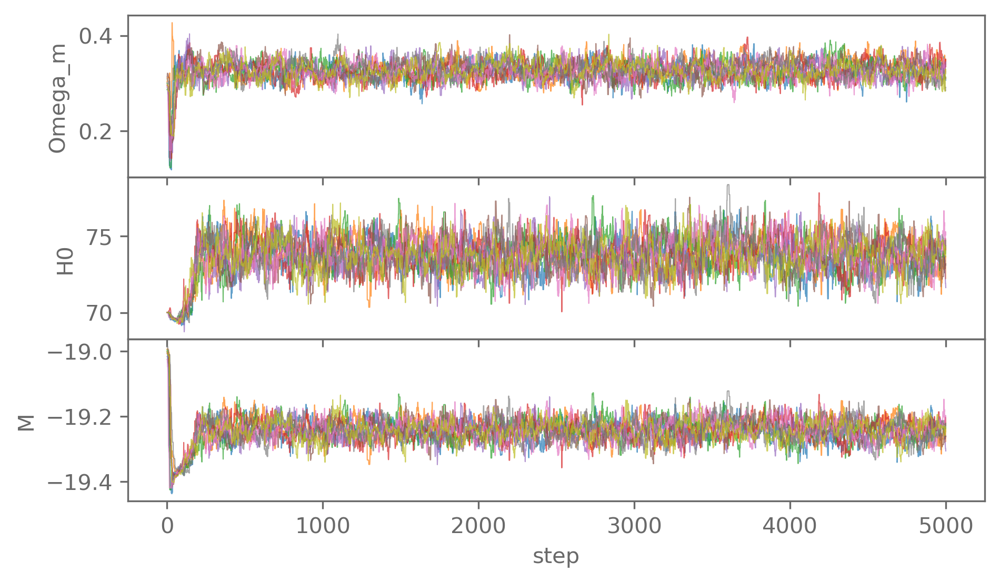

In [11]:
n_walker = 9
param_names = ["Omega_m", "H0", "M"]

# Plot the tracer of the chain, this time for all the walkers
fig, ax = plt.subplots(len(param_names), 1, sharex=True)
plt.subplots_adjust(hspace=0)

for i, name in enumerate(param_names):
    for j in range(n_walker):
        ax[i].plot(chain_per_walker[:, j, i], lw=0.5, alpha=0.7, color=f"C{j}")
    ax[i].set_ylabel(name)

ax[-1].set_xlabel("step");

The first couple hundred steps are clearly affected by burn-in.

Otherwise the chain looks good:
- The mean and variance do not vary with time, indicating that the distribution is stationary.
- The different walkers all explore the distribution and do not get stuck in a subspace.

## Auto-correlation/effective number of samples

A more quantitative check is the (integrated) auto-correlation time $\tau$, which tells us how long the chain takes to "forget" a previous position.

The `emcee` documentation has an excellent write-up on this: https://emcee.readthedocs.io/en/stable/tutorials/autocorr/


In short, if the chain has $n$ samples in it, the number of effective independent samples is $n_\mathrm{eff}\approx \frac{n}{\tau}$.


One thing to keep in mind is that for $n \lesssim 50\tau$, the estimate for $\tau$ will be unreliable.

In [29]:
# If the chain is an array (for example from a different MCMC algorithm)
tau = emcee.autocorr.integrated_time(chain_per_walker)

# If the algorithm does use walkers, set the has_walkers=False argument
# tau = emcee.autocorr.integrated_time(chain_per_walker[:, 0], has_walkers=False)

# Or directly from emcee:
# tau = sampler.get_autocorr_time()

print("Integrated auto-correlation time")
for name, iat in zip(param_names, tau):
    print(f"{name}: {iat:.1f}")

Integrated auto-correlation time
Omega_m: 46.0
H0: 79.8
M: 48.8


This indicates that the chain needs 50-80 steps to produce a new independent sample. 


To get rid of the burn-in phase, it is good to discard a few (5-10) auto-correlation times. 

This agrees with what we could estimate from the trace plots earlier.

Since many of the samples in the chain are correlated, we can thin down the chain by a factor of $\approx\tau$.

In [37]:
max_autocorr = max(tau)
burn_in = int(5*max_autocorr)
thin = int(max_autocorr/2)

chain = chain_per_walker[burn_in::thin].reshape(-1, n_param)
# Directly from an emcee sampler:
# chain = sampler.get_chain(discard=burn_in, thin=thin, flat=True)

# Interpreting posteriors

We have evaluated and sampled a few posteriors so far. As Bayesians, that is the end-goal, since the full posterior distribution is what we care about.

In practice, we need to summarise the posterior in a form that allows it to be represented on a sheet of paper.



- Mode of the posterior 
    - pro: summary of the full $n$-dimensional joint posterior
    - con: point estimate, uncertainty is hard to define in practice


- Credible intervals
    - pro: intuitive interpretation, can be put in a table
    - con: only applies to 1D (marginal) distributions, can suffer from projection effects



- Corner plots
    - pro: more information than credible intervals due to showing 2D marginals as well
    - con: still only marginals, can suffer from projection effects

#### Credible interval or region

A credible region for a probability distribution $p(x)$ is a set $\Omega(\alpha)$ such that the probability enclosed within that region is $1-\alpha$:
$$
    \int_{\Omega(\alpha)} p(x)\dd x = 1 - \alpha\,.
$$

There are infinitely many ways to define such regions but two common ones are 
- equal-tail intervals
- highest posterior density intervals

The equal-tail interval $(x_\mathrm{L}, x_\mathrm{R})$ is defined by requiring the tails of the distribution to each contain $\frac{\alpha}{2}$ of the total probability. 
$$
    \mathrm{CDF}(x_\mathrm{L}) = \frac{\alpha}{2}, \quad 1-\mathrm{CDF}(x_\mathrm{R}) = 1-\frac{\alpha}{2}
$$



The equal-tail interval is centred on the median of $p(x)$. The equal-tail interval has the advantage that it is easy to compute, for example from samples from a posterior.

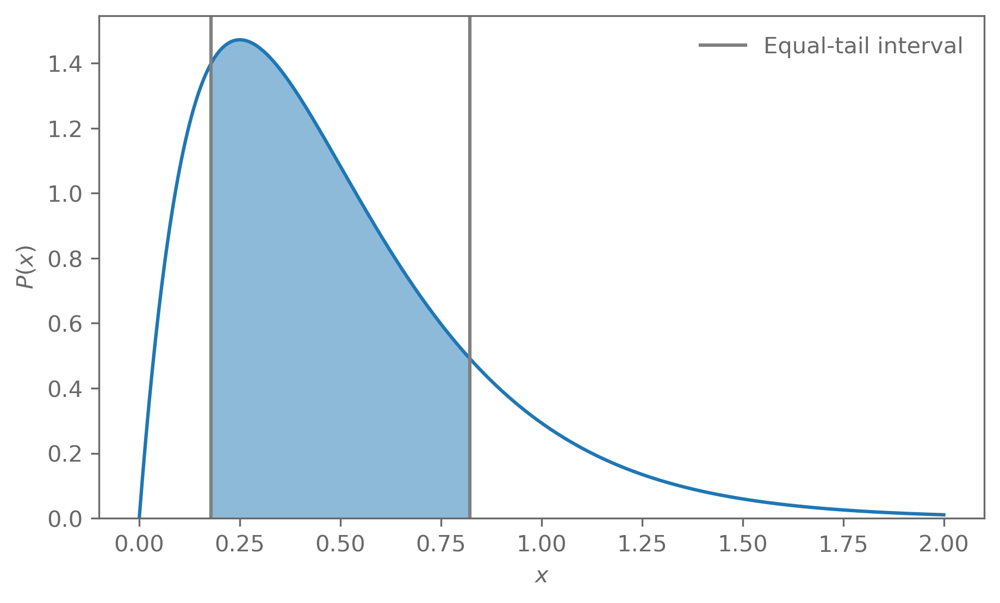

In [3]:
distr = scipy.stats.gamma(a=2, scale=1/4)

alpha = 1-0.68

x = np.linspace(0, 2, 500)

ci = distr.ppf(alpha/2), distr.ppf(1 - alpha/2)

plt.plot(x, distr.pdf(x))
x_ci = np.linspace(ci[0], ci[1], 100)
plt.fill_between(x_ci, 0, distr.pdf(x_ci), alpha=0.5)

plt.axvline(x=ci[0], c="grey", label="Equal-tail interval")
plt.axvline(x=ci[1], c="grey")

plt.ylim(bottom=0)

plt.xlabel("$x$")
plt.ylabel("$P(x)$")

_ = plt.legend()

The highest-density interval (or region) is defined as the region for which $p(x)$ is above a threshold $c_\alpha$, such that
$$
    \int_{\Omega(\alpha)} p(x)\dd x = 1 - \alpha\,,
$$
where
$$
    \Omega(\alpha) = \{x| p(x) > c_\alpha\}\,.
$$



The highest-density regions are the smallest possible credible region that can be defined. It is centred on the mode of $p(x)$.

The downside is that it is more complicated to compute (even in 1D). 

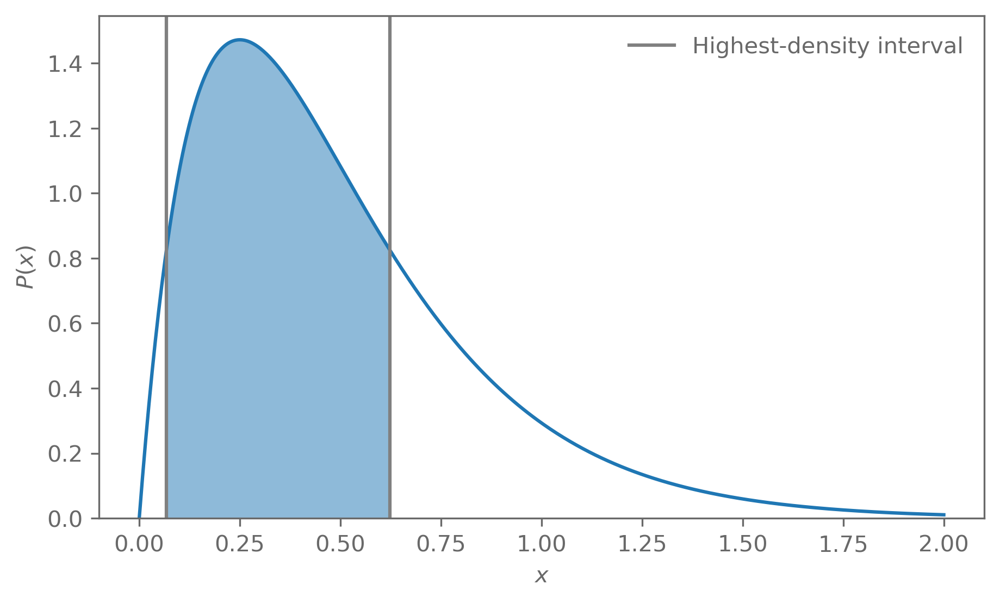

In [4]:
def find_ci(alpha, pdf_fn, mode, support):
    def c_to_alpha(c):
        ci_L = scipy.optimize.root_scalar(
            f=lambda x: c-pdf_fn(x),
            bracket=(support[0], mode)).root
        ci_R = scipy.optimize.root_scalar(
            f=lambda x: c-pdf_fn(x),
            bracket=(mode, support[1])).root
        alpha = distr.cdf(ci_R) - distr.cdf(ci_L)
        return alpha, (ci_L, ci_R)
    
    min_c = max(pdf_fn(support[0]), pdf_fn(support[1]))

    c = scipy.optimize.root_scalar(
        f=lambda c: c_to_alpha(c)[0] - alpha,
        bracket=(min_c, pdf_fn(mode))).root
    
    return c_to_alpha(c)[1]

mode = scipy.optimize.minimize(lambda x: -distr.logpdf(x), x0=1.0).x.squeeze()

ci = find_ci(alpha=0.68, pdf_fn=distr.pdf, mode=mode, support=(0, 2))

plt.plot(x, distr.pdf(x))
x_ci = np.linspace(ci[0], ci[1], 100)
plt.fill_between(x_ci, 0, distr.pdf(x_ci), alpha=0.5)

plt.axvline(x=ci[0], c="grey", label="Highest-density interval")
plt.axvline(x=ci[1], c="grey")

plt.ylim(bottom=0)

plt.xlabel("$x$")
plt.ylabel("$P(x)$")

_ = plt.legend()


<img style="display: block; 
    margin-left: auto;
    margin-right: auto;
    width: 70%;"
    src="../assets/hpd_animation.gif" alt="HPD"/>

#### Projection effects

Once we have more than 2 dimensions in our posterior, we can only visualise marginal distributions of it (unless you use a fancy 3D plotting library).

These marginal distributions can behave in unintuitive ways when the posterior is not symmetric and Gaussian.

In [5]:
def model(x, a, b, c, d):
    x0=0.5
    return a + b * x * ((1+x)/(1+x0))**c * ((1+x**2)/(1+x0**2))**d

In [6]:
a_prior = tfd.Uniform(low=-10, high=10)
b_prior = tfd.Uniform(low=-10, high=10)
c_prior = tfd.Uniform(low=-1000, high=1000)
d_prior = tfd.Uniform(low=-1000, high=1000)


# Generate synthetic data
np.random.seed(42)
x = jnp.linspace(0, 1, 10)
true_params = [2, 0.1, 0, 0]
y = model(x, *true_params)
y_err = 0.05 * jnp.ones_like(y)


def create_likelihood_distribution(model, y_err):
    def distr(params, x):
        mu = model(x, *params)
        return tfd.MultivariateNormalDiag(loc=mu, scale_diag=y_err)

    return distr


def log_likelihood(params):
    return create_likelihood_distribution(model=model, y_err=y_err)(params, x).log_prob(y)

def log_prior(params):
    return a_prior.log_prob(params[0]) + b_prior.log_prob(params[1]) + c_prior.log_prob(params[2]) + d_prior.log_prob(params[3])

# Define the log posterior
def log_posterior(params):
    return log_likelihood(params) + log_prior(params)


In [7]:
params_initial = jnp.array([1.0, 1.0, 1.0, 1.0])
param_names = ["a", "b", "c", "d"]

solver = jaxopt.ScipyMinimize(fun=jit(lambda x: -log_posterior(x)), method="L-BFGS-B")
solution = solver.run(params_initial)
MAP_params = solution.params
cov = jnp.linalg.inv(-hessian(log_posterior)(MAP_params))

print("Model 1")
for name, p, p_std, p_true in zip(param_names, MAP_params, np.sqrt(np.diag(cov)), true_params):
    print(f"{name} = {p:.2f} ± {p_std:.2f} (truth: {p_true:.2f})")


Model 1
a = 2.00 ± 0.05 (truth: 2.00)
b = 0.10 ± 0.11 (truth: 0.10)
c = 0.28 ± 18.64 (truth: 0.00)
d = -0.17 ± 11.37 (truth: 0.00)


In [8]:

# Set up the initial parameters for the MCMC
initial_params = np.array([1.0, 1.0, 1.0, 1.0])
ndim = len(initial_params)
nwalkers = 32
nsteps = 10000

# Set up the sampler
sampler = emcee.EnsembleSampler(nwalkers, ndim, jit(vmap(log_posterior)), vectorize=True)

# Initialize the walkers
p0 = np.random.normal(initial_params, scale=0.1, size=(nwalkers, ndim))

# Run the MCMC
sampler.run_mcmc(p0, nsteps, progress=True)

max_autocorr = max(sampler.get_autocorr_time())
# Extract the samples
samples = sampler.get_chain(discard=int(5*max_autocorr), thin=int(max_autocorr/2), flat=True)

100%|██████████| 10000/10000 [00:03<00:00, 2667.46it/s]


In [9]:
getdist_samples = getdist.MCSamples(
    samples=samples,
    names=param_names,
    label="Model 1",
    ranges={"c": (-1000, 1000), "d": (-1000, 1000)}
)

Removed no burn in


In [10]:
g = getdist.plots.get_single_plotter()

<Figure size 1800x1350 with 0 Axes>

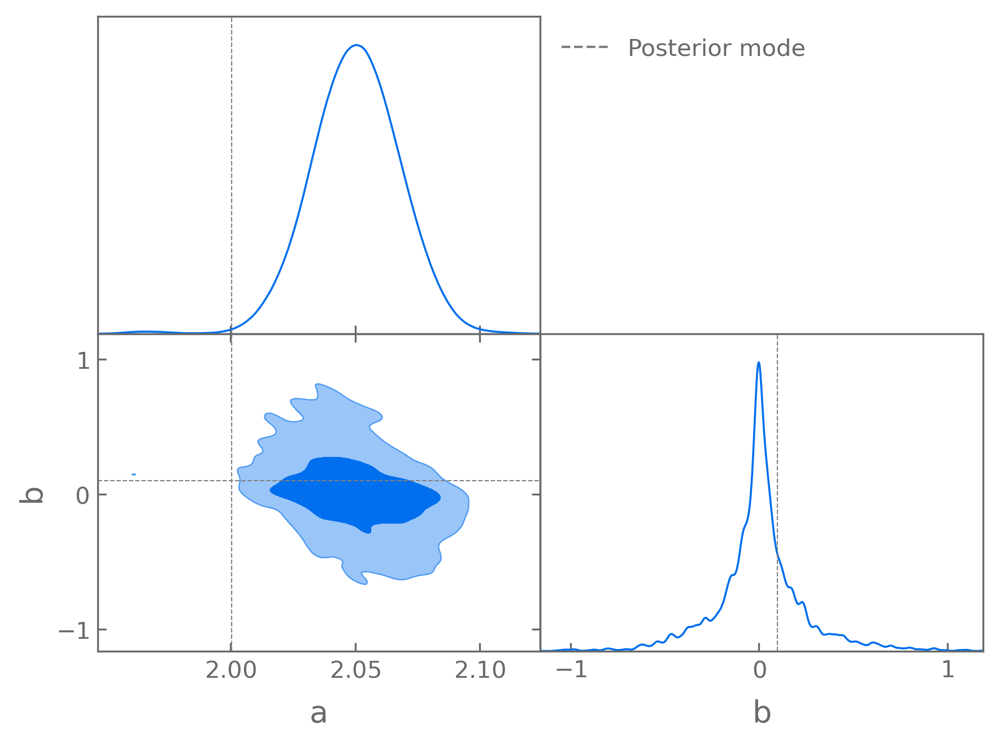

In [11]:
g.triangle_plot([getdist_samples],
                params=["a", "b"],
                filled=True,
                markers={k: v for k, v in zip(param_names, MAP_params)})

g.subplots[0,0].plot([],[], **{"lw" : 1.0, "ls" : "--", "c" : "k", "alpha" : 0.5}, label="Posterior mode")
g.subplots[0,0].legend(frameon=False, loc=2, bbox_to_anchor=(1,1));

In [12]:
g = getdist.plots.get_single_plotter()

<Figure size 1800x1350 with 0 Axes>

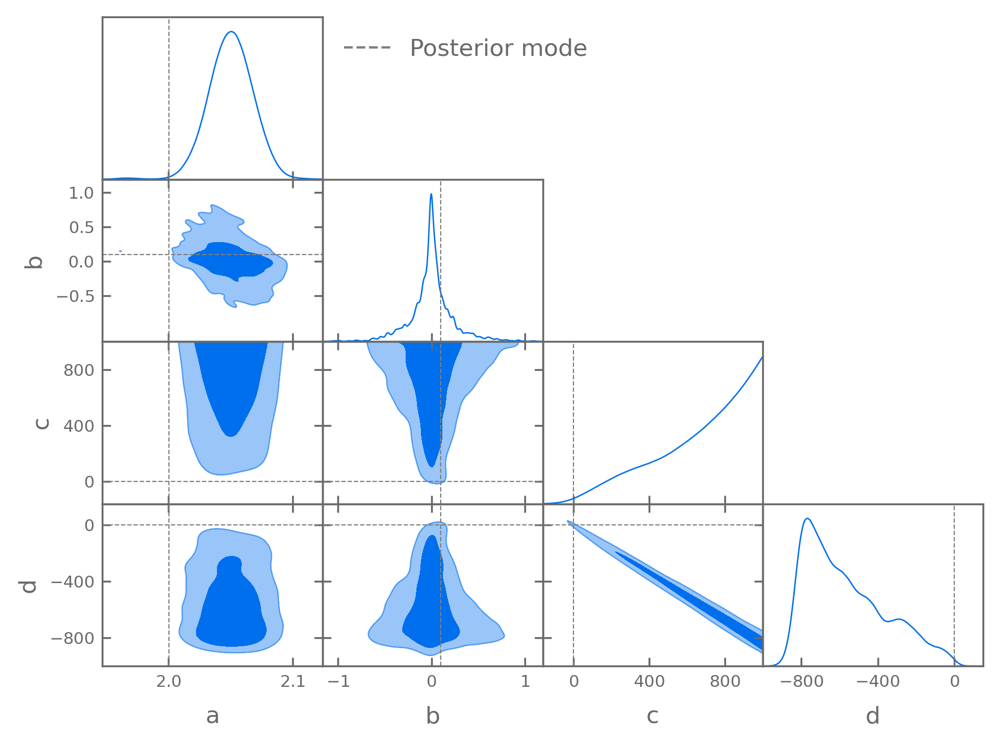

In [13]:
fig = g.triangle_plot([getdist_samples], filled=True,
                 markers={k: v for k, v in zip(param_names, MAP_params)})
g.subplots[0,0].plot([],[], **{"lw" : 1.0, "ls" : "--", "c" : "k", "alpha" : 0.5}, label="Posterior mode")
g.subplots[0,0].legend(frameon=False, loc=2, bbox_to_anchor=(1,1));

The model here is a Gaussian likelihood with mean
$$
    \mu = a + bx  \left(\frac{1+x}{1 + x_0}\right)^c \left(\frac{1+x^2}{1 + x_0^2}\right)^d\,,
$$
for parameters $a$, $b$, $c$, $d$, with $x_0=0.5$.

When $b\approx 0$, the terms involving $c$ and $d$ do not contribute to the model anymore and $c$ and $d$ are not constrained.

Depending on how the prior is chosen, this can lead to large volumes of posterior space where $b\approx 0$.

When projecting the posterior into marginal distributions, this leads to marginals that are not centred on the mode of the joint posterior.

This can be seen with very skewed distributions even in 2 dimensions:

In [14]:
def log_p(p):
    x, y = p
    if y < 0 or x < 0 or y > x or y < x/2:
        return -np.inf
    
    return -(x+y)**2

theta_fid = (0.5, 0.5)
nwalkers = 32
ndim = len(theta_fid)

n_sample = 12000
burn_in = 2000

sampler = emcee.EnsembleSampler(nwalkers, ndim, log_p)

sampler.run_mcmc(np.random.normal(loc=0, scale=0.1, size=(nwalkers,ndim))+theta_fid, n_sample, progress=True)
max_autocorr = max(sampler.get_autocorr_time())

samples = getdist.MCSamples(name_tag="Full",
                            samples=sampler.get_chain(flat=True, discard=int(5*max_autocorr), thin=int(max_autocorr/2)),
                            names=["theta0", "theta1"], labels=["x", "y"],
                            ranges={"theta0" : [0,4], "theta1" : [0,4],}
                                   )

100%|██████████| 12000/12000 [00:02<00:00, 4749.10it/s]

Removed no burn in


In [15]:
MAP = [0,0]

samples.smooth_scale_1D = 0.2
samples.smooth_scale_2D = 0.2

g = getdist.plots.get_single_plotter()
g.settings.legend_frame = False


<Figure size 1800x1350 with 0 Axes>

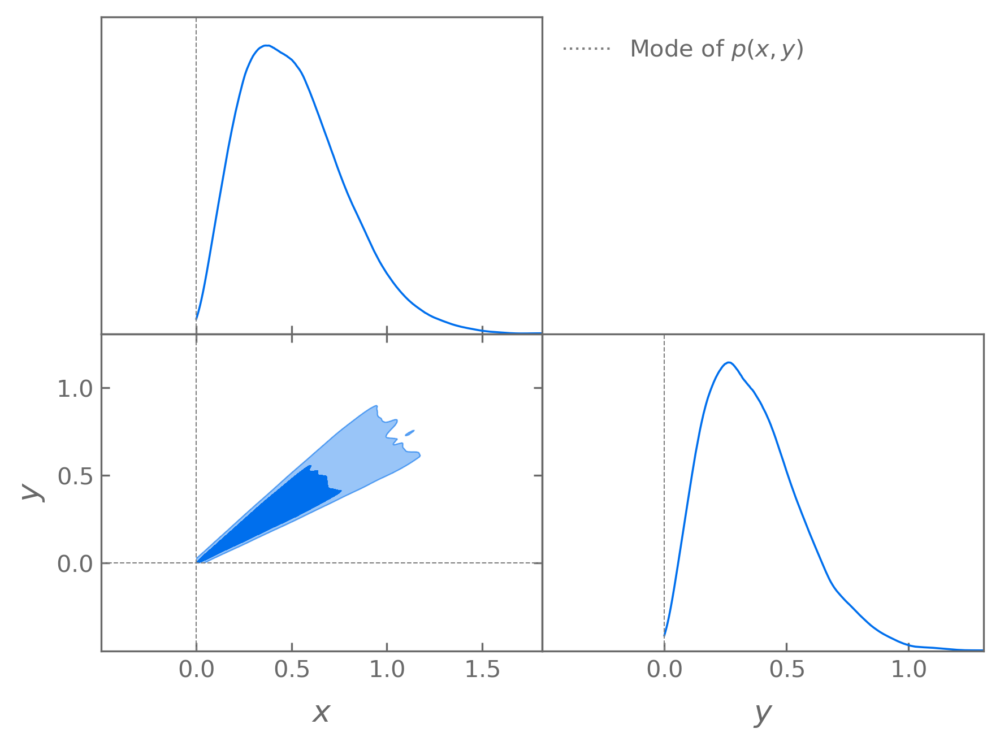

In [16]:

g.triangle_plot([samples],
                filled_compare=True,
                params=["theta0", "theta1"],
                markers={"theta0" : MAP[0], 
                         "theta1" : MAP[1],
                         },
               )

g.subplots[0,0].set_xlim(left=-0.5)
g.subplots[1,1].set_xlim(left=-0.5)

g.subplots[0,0].plot([],[], **{"lw" : 1.0, "ls" : ":", "c" : "k", "alpha" : 0.5}, label="Mode of $p(x, y)$")
g.subplots[0,0].legend(frameon=False, loc=2, bbox_to_anchor=(1,1));

### Clicker

What causes volume or projection effects?
- The projection of high dimensions onto marginal distributions.
- Unconstrained regions in the parameter space due to degeneracy between parameters.
- The influence of the prior distribution on the effective number of parameters.
- Data rescaling on the posterior distribution.

## The Bayesian data analysis workflow

1. Model the data generating process probabilistically.
2. Condition the generative process on the observed data.
3. Check that the results fit the observed data and improve the model.
    - Compare different models.

## Model checking

A first step to check your model is to plot it against the data.

This can be plotting the best-fit model, but better are the posterior predictive distributions.

If there are obvious issues, such as outliers or misspecified errors, making some plots can already flag these problems.

Our eyes can be easily deceived though. For example, strongly correlated data can have _very_ unintuitive behaviour of the best-fitting model.

### Chi-square goodness-of-fit

If the data $\vec y$ are Gaussian distributed
$$
    \vec y\sim \Norm\left(\vec \mu(\vec\theta), \Sigma(\vec\theta)\right)
$$
then a traditional test of how well our model fits the data is the chi-square test. 



Let us assume we have a set $\vec\theta^*$ of "best" model parameters. For example the MAP or mean of the posterior.

If these are the true parameters that generated the data and the data are Gaussian distributed, then the quantity
$$
    \chi^2(\vec y, \vec\theta^*) = \left(\vec y - \vec\mu(\vec\theta^*)\right)^T\Sigma(\vec\theta^*)^{-1}\left(\vec y - \vec\mu(\vec\theta^*)\right)
$$
is distributed as $\chi^2_\nu$. 



With this we can calculate the probability that the $\chi^2$ statistic would take a higher value in imaginary repeated experiments than the one we have observed
$$
    \text{Probability to exceed (PTE) } \chi^2(\vec y, \vec\theta^*) = 1 - \mathrm{CDF}\left(\chi^2(\vec y, \vec\theta^*)\right)\ .
$$
If the PTE is small, it is unlikely that an experiment would see a $\chi^2$ statistic larger than what we observerd. This indicates that our model is a poor fit to the data.



The number of degrees of freedom is $\nu = n_\mathrm{data} - n_\mathrm{param}$, where $n_\mathrm{data}$ is the dimensionality of the data and $n_\mathrm{param}$ is the number of constrained parameters.


By fitting the model to the data, we reduce the scatter in the residuals $\vec y - \vec\mu(\theta)$, so the number of degrees of freedom is reduced from $n_\mathrm{data}$ by $n_\mathrm{param}$.

Finding $n_\mathrm{param}$ in a Bayesian context can be challenging because some parameters might be constrained by the prior, instead of by the likelihood. In this case, they do not reduce the degrees of freedom.

We use the data in `"data/linear_fits/data_2.txt"` has an example and fit both a linear and quadratic model to it.

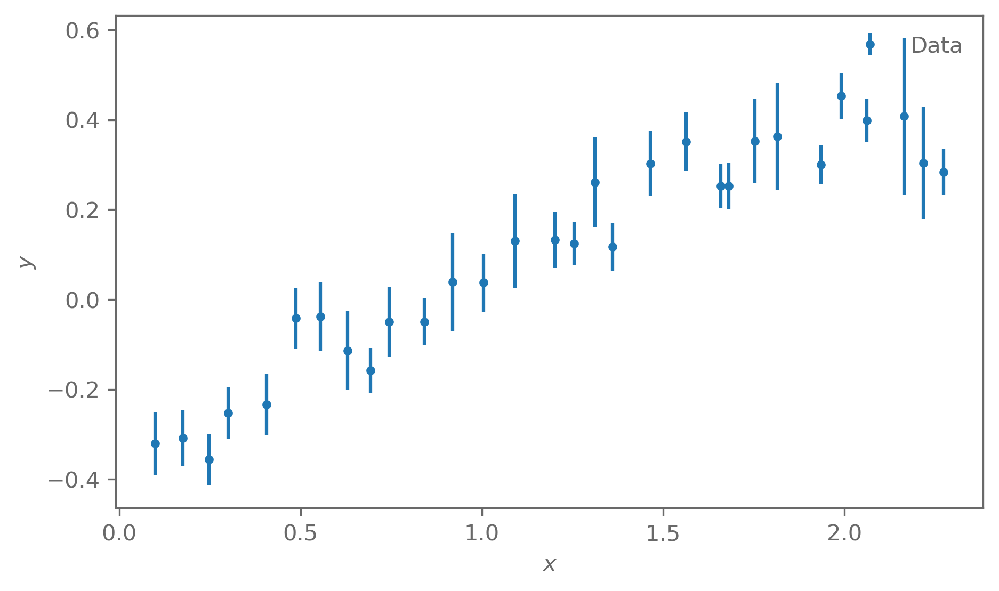

In [56]:
x, y, y_err = np.loadtxt("data/linear_fits/data_2.txt", unpack=True)
a_true, b_true, c_true,  = -0.15, 0.7, -0.45

plot_data(x, y, y_err);

In [57]:
def make_gaussian_likelihood_components(model, log_prior):
    """Create the log_likelihood, log_posterior, predict functions from a
    model and log_prior"""
    def log_likelihood(y, theta, x, sigma_y):
        prediction = model(theta, x)

        return (
            -0.5 * np.sum((y - prediction)**2/sigma_y**2)    # Exponent
            -0.5 * np.sum(np.log(2*np.pi*sigma_y**2))        # Normalisation
        )
    
    def log_posterior(theta, x, sigma_y, y):
        return log_likelihood(y, theta, x, sigma_y) + log_prior(theta)
    
    def predict(theta, x, sigma_y):
        mu = model(theta, x)
        return np.random.normal(loc=mu, scale=sigma_y)
    
    return log_likelihood, log_posterior, predict

In [58]:
def linear_model(theta, x):
    m, b = theta
    return m*x + b

def log_prior_linear_model(theta):
    m, b = theta
    # Unnormalised uniform prior m\simU(-2, 2), b \sim U(-3, 3)
    if -2 < m < 2 and -3 < b < 3:
        return 0
    else:
        return -np.inf

log_likelihood_lin, log_posterior_lin, predict_lin = \
    make_gaussian_likelihood_components(
        linear_model, log_prior_linear_model
    )

In [59]:
def quadratic_model(theta, x):
    a, b, c = theta
    return a*x**2 + b*x + c

def log_prior_quadratic_model(theta):
    a, b, c = theta
    # Unnormalised uniform prior m\simU(-2, 2), b \sim U(-3, 3)
    if -1 < a < 1 and -2 < b < 2 and -3 < c < 3:
        return 0
    else:
        return -np.inf

log_likelihood_quad, log_posterior_quad, predict_quad = \
    make_gaussian_likelihood_components(
        quadratic_model, log_prior_quadratic_model
    )

In [69]:
# From bayesian_stats_course_tools.analyse
# This function returns a dict with the following entries:
# - MAP: parameter values at the MAP
# - PPD: samples from the posterior predictive distribution
# - PPD_params: the parameter samples for the samples in of the PPD
# - TPD: samples from the TPD (samples of model predictions)
# - chain: MCMC chain of the parameters
results_linear = analyse_data(
    data=dict(x=x, y=y, y_err=y_err),
    log_posterior_fn=log_posterior_lin,
    model_fn=linear_model,
    predict_fn=predict_lin,
    param_names=["m", "b"],
    theta_init=[1, 0],
    plot=False
)

results_quadratic = analyse_data(
    data=dict(x=x, y=y, y_err=y_err),
    log_posterior_fn=log_posterior_quad,
    model_fn=quadratic_model,
    predict_fn=predict_quad,
    param_names=["a", "m", "b"],
    theta_init=[0.1, 1, 0],
    plot=False
)

MAP results
m_MAP = 0.34908377290541787
b_MAP = -0.33212704099855833


100%|██████████| 5000/5000 [00:01<00:00, 3970.07it/s]


Auto-correlation time of chain:
m = 16.3
b = 37.9
Posterior results (mean±std)
m = 0.35±0.017
b = -0.33±0.024
MAP results
a_MAP = -0.10547710642388063
m_MAP = 0.5990527808099008
b_MAP = -0.4340001193160153


100%|██████████| 5000/5000 [00:01<00:00, 3810.05it/s]

Auto-correlation time of chain:
a = 65.4
m = 56.2
b = 58.9
Posterior results (mean±std)
a = -0.11±0.031
m = 0.6±0.076
b = -0.43±0.038


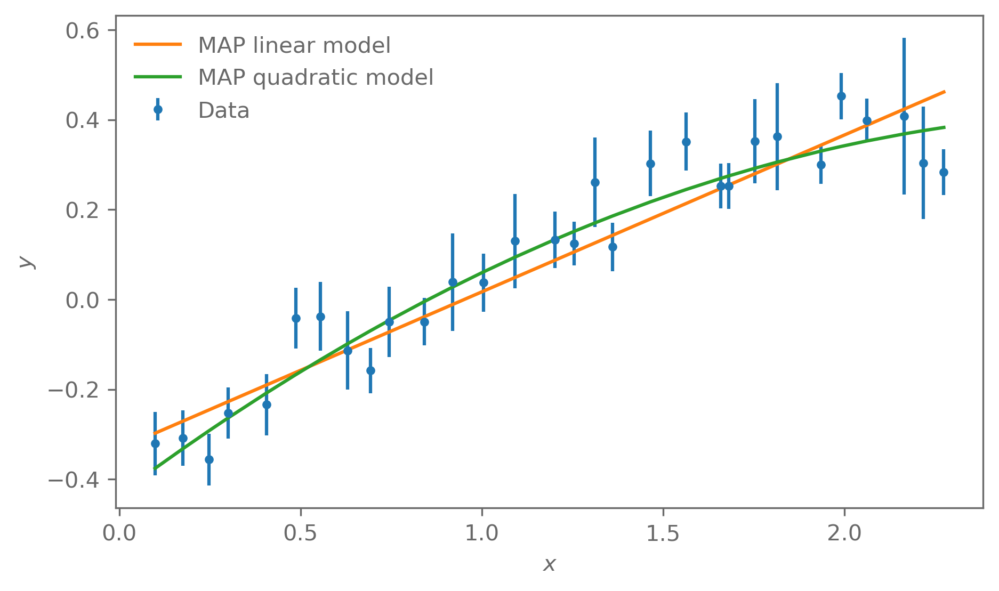

In [70]:
plot_data(
    x, y, y_err,
    models=[
        dict(x=x, y=linear_model(results_linear["MAP"], x), style=dict(label="MAP linear model")),
        dict(x=x, y=quadratic_model(results_quadratic["MAP"], x), style=dict(label="MAP quadratic model"))
    ]
);

Implement the $\chi^2$ statistic:

In [71]:
def chi_squared(y, sigma_y, mu):
    return np.sum((y - mu)**2/sigma_y**2)

chi_squared_linear = chi_squared(
    y, y_err,
    mu=linear_model(results_linear["MAP"], x)
)
chi_squared_quadratic = chi_squared(
    y, y_err,
    mu=quadratic_model(results_quadratic["MAP"], x)
)

In [63]:
n_data = len(y)
n_param_lin = 2
n_param_quad = 3

PTE_lin = scipy.stats.chi2(df=n_data - n_param_lin).sf(chi_squared_linear)
PTE_quad = scipy.stats.chi2(df=n_data - n_param_quad).sf(chi_squared_quadratic)

print(f"Linear: χ²={chi_squared_linear:.1f}, "
      f"ndof={n_data}-{n_param_lin}, PTE={PTE_lin:.3f}")

print(f"Quadratic: χ²={chi_squared_quadratic:.1f}, "
      f"ndof={n_data}-{n_param_quad}, PTE={PTE_quad:.3f}")

Linear: χ²=40.8, ndof=30-2, PTE=0.056
Quadratic: χ²=29.3, ndof=30-3, PTE=0.347


The quadtratic model fits much better to the data. Note that for the linear model, the probability of getting data that has an even higher $\chi^2$ than we observed is quite low, indicating that the linear model is a poor fit. 

## Posterior predictive checks

For more details, see chapter 6 in Bayesian Data Analysis

The chi-squared test has some downsides:
- It assumes the data are Gaussian distributed.
- It depends on the effective number of constrained parameters, which can be challenging to define.
- It uses a point estimate for the parameters $\vec\theta^*$ for which to calculate the goodness-of-fit. As Bayesians, we want to avoid point estimates and instead account for the full uncertainty in the posterior.


We use the posterior predictive distribution (PPD) to assess how well our model fits the data.

We define a test statistic $T(y, \theta)$ of the data and the parameters.
For example, we could choose the $\chi^2$ statistic
$$
    T(\vec y, \vec\theta) = \left(\vec y - \vec\mu(\vec\theta)\right)^T\Sigma(\vec\theta)^{-1}\left(\vec y - \vec\mu(\vec\theta)\right) \ .
$$
The $\chi^2$ statistic is often convenient but other choice for $T(y, \theta)$ are possible too.




We then sample replicates $\vec y^\mathrm{rep}$ of the data from the PPD $p(\vec y^\mathrm{rep}|\vec y)$. Remember,
$$
    p(\vec y^\mathrm{rep}|\vec y) = \int p(\vec y^\mathrm{rep}, \vec \theta | \vec y)\dd \theta = \int p(\vec y^\mathrm{rep} |\vec  \theta)p(\vec \theta|\vec y)\dd \theta\,.
$$



Then compute the probability
$$
    \Pr\left(T(\vec y^\mathrm{rep}, \vec\theta) \geq T(\vec y, \vec\theta)|\vec y\right)\ .
$$

In practice:
1. Sample $S$ samples $\vec\theta_i$ from the posterior $p(\vec\theta|\vec y)$
2. Sample one $\vec y^\mathrm{rep}_i$ from the likelihood $p(\vec y^\mathrm{rep}|\vec\theta_i)$ for each $\theta_i$
3. Count the fraction of samples where $T(\vec y^\mathrm{rep}_i, \vec\theta_i) \geq T(\vec y, \vec\theta_i)$

In [64]:
def test_statistic(y, theta, x, sigma_y, model):
    mu = model(theta, x)
    t = chi_squared(y, sigma_y, mu)
    return t

def ppd_model_check(test_statistic, y, ppd, ppd_params):
    t_data = []
    t_rep = []
    for y_rep, theta in zip(ppd, ppd_params):
        t_data.append(test_statistic(y, theta))
        t_rep.append(test_statistic(y_rep, theta))

    t_data = np.array(t_data)
    t_rep = np.array(t_rep)

    pte = (t_rep >= t_data).sum()/len(t_data)
    return pte, t_rep, t_data


In [65]:
PPD_PTE_lin, t_rep_lin, t_data_lin = ppd_model_check(
    test_statistic=lambda y, theta: test_statistic(
        y, theta, x, y_err, linear_model),
    y=y,
    ppd=results_linear["PPD"],
    ppd_params=results_linear["PPD_params"]
)

PPD_PTE_quad, t_rep_quad, t_data_quad = ppd_model_check(
    test_statistic=lambda y, theta: test_statistic(
        y, theta, x, y_err, quadratic_model),
    y=y,
    ppd=results_quadratic["PPD"],
    ppd_params=results_quadratic["PPD_params"]
)

print(f"Linear: PPD PTE={PPD_PTE_lin:.3f}")
print(f"Quadratic: PPD PTE={PPD_PTE_quad:.3f}")

Linear: PPD PTE=0.064
Quadratic: PPD PTE=0.372


We get quite similar results to the $\chi^2$ test just from samples from the posterior, without further assumptions or point estimates.

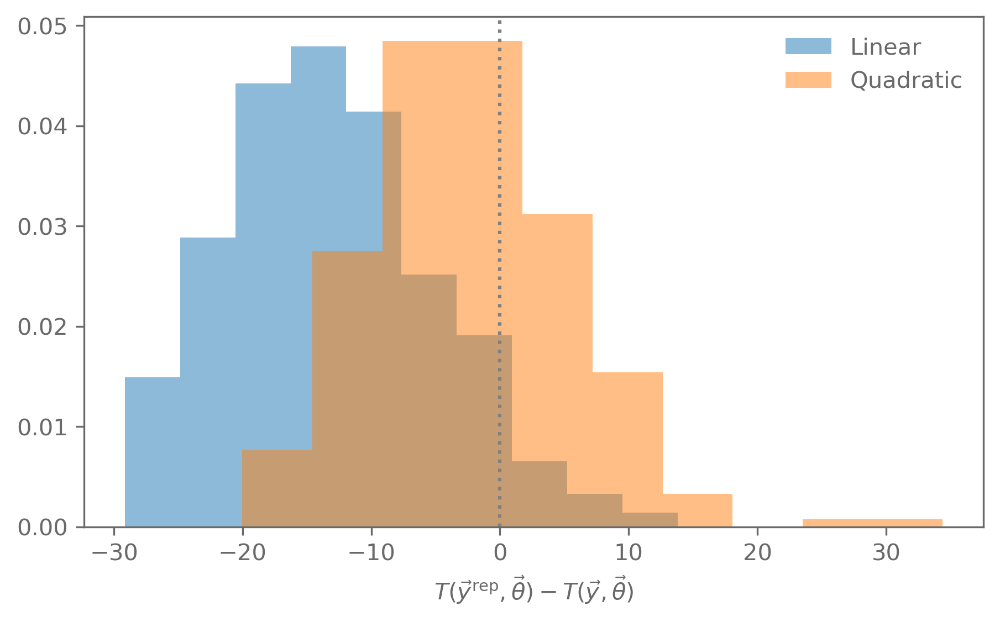

In [66]:
plt.hist(t_rep_lin - t_data_lin, density=True, alpha=0.5, label="Linear")
plt.hist(t_rep_quad - t_data_quad, density=True, alpha=0.5, label="Quadratic")
plt.axvline(0, ls=":", color="grey")
plt.legend(frameon=False)
plt.xlabel(r"$T(\vec y^\mathrm{rep}, \vec\theta) - T(\vec y, \vec\theta)$");

### Clicker

What is the difference between a chi-square test and a posterior predictive check with a chi-square test statistic?
- A chi-square test measures predictive accuracy, while a posterior predictive check measures overfitting.
- In the chi-square test, the chi-square statistic always decreases with more parameters, but in a posterior predictive check, it increases as parameters are added.
- The chi-square test assumes Gaussianity whereas the PPC with a chi-square test statistic doesn’t.
- The chi-square test uses a point estimate for model parameters, while the posterior predictive check accounts for the full uncertainty in the posterior.

# Model comparison

After we have checked that the model is describing the data well, we might want to compare different models.

We have already discussed the Bayes ratio $\frac{p(y| M_1)}{p(y| M_2)}$ as a tool to decide between models.

Here we look at two other approaches to compare models that do not need computing the evidence.

## Deviance information criterion (DIC)

The deviance information criterion (DIC) is defined as
$$
    \text{DIC} = -2\left(\log p(\vec y |\vec\theta^*) - p_\mathrm{D}\right) \ ,
$$
with the number of effective model parameters
$$
    p_\mathrm{D} = 2\left(\log p(\vec y |\vec\theta^*) - \E_{p(\theta |\vec y)}[\log p(\vec y |\vec\theta)]\right)\ ,
$$
where the last term is the mean of the log likelihood over the posterior.



An alternative estimate of the number of effective model parameteres is
$$
    p_\mathrm{V} = 2\Var_{p(\theta |\vec y)}[\log p(\vec y |\vec\theta)]\,.
$$


$$
    \text{DIC} = -2\left(\log p(\vec y |\vec\theta^*) - p_\mathrm{D}\right) \ ,
$$

Interpretation: log-likelihood at the point of the best-fit parameter $\vec\theta^*$ minus the number of parameters in the model.

The better the fit, the higher the likelihood. The DIC is lower for better models, but adding more parameters that do not significantly improve the likelihood are penalised. 

Why are $p_\mathrm{D}$ and $p_\mathrm{V}$ estimates of the effective number of model parameters?

Let us consider the case where the likelihood, posterior, and prior are approximately Gaussian, with $d$ model parameters. 

Define $D(\theta) = -2\log p(\vec y |\vec\theta)$. First, expand around the best-fit $\vec\theta^*$:
$$
    D(\theta) \approx D(\theta^*) + (\theta - \theta^*)D'_{\theta^*} + \frac{1}{2}(\theta - \theta^*)^T D''_{\theta^*}(\theta - \theta^*)\,,
$$
where $D'_{\theta^*}$ and $D''_{\theta^*}$ are the first and second derivatives of $D$ with respect to $\vec\theta$ at $\vec\theta^*$.



Then take the expectation with respect to the posterior:
$$
\begin{split}
    \E[D(\theta)] &\approx D(\theta^*) + E[(\theta - \theta^*)^T D''_{\theta^*}(\theta - \theta^*)] \\
    &= D(\theta^*) + \mathrm{tr}(D''_{\theta^*}E[(\theta - \theta^*)(\theta - \theta^*)^T ]) \\
    &= D(\theta^*) + \mathrm{tr}(D''_{\theta^*}\Sigma_{p(\theta|y)})\,,
\end{split}
$$
where $\Sigma_{p(\theta|y)}$ is the covariance of the posterior.



Remember the definition of $p_\mathrm{D}$:
$$
    p_\mathrm{D} = D(\theta^*) - \E[D(\theta)] \approx \mathrm{tr}(D''_{\theta^*}\Sigma_{p(\theta|y)})
$$

We can write $D(\theta)$ in terms of the posterior and prior using Bayes' theorem:
$$
    D(\theta) = -2\log p(\vec y |\vec\theta) = -2 \log\left( \frac{p(\theta |\vec y)}{p(\vec\theta)} p(\vec y)\right)\,.
$$



The Hessian of $D''_{\theta^*}$ can now be written as
$$
    D''_{\theta^*, ij} = -2 \frac{\partial^2}{\partial\theta_i\partial\theta_j}\log p(\theta |\vec y) + 2 \frac{\partial^2}{\partial\theta_i\partial\theta_j}\log p(\theta) \approx \Sigma_{p(\theta|y)}^{-1} -  \Sigma_{p(\theta)}^{-1}\,,
$$
where we assumed the posterior and prior are Gaussian, with covariances $\Sigma_{p(\theta|y)}$ and $\Sigma_{p(\theta)}$.



Putting things together, we find the effective number of model parameters
$$
    p_\mathrm{D} \approx \mathrm{tr}(D''_{\theta^*}\Sigma_{p(\theta|y)}) \approx d - \mathrm{tr}(\Sigma_{p(\theta)}^{-1}\Sigma_{p(\theta|y)})
$$
This behaves as we would hope:
- In the case where the prior is very uninformative ($\Sigma_{p(\theta)}\to\infty$) all parameters are constrained by the data: $p_\mathrm{D} = d$. 
- In the case where the prior is the same as the posterior ($\Sigma_{p(\theta)} = \Sigma_{p(\theta|y)}$), none of the parameters are constrained by the data: $p_\mathrm{D} = 0$.

Implement the DIC:

In [22]:
def DIC(theta_star, theta_samples, log_likelihood):
    # Compute log likelihood at theta_star and the samples theta_i
    log_likelihood_star = log_likelihood(theta_star)
    log_likelihood_samples = np.array(
        [log_likelihood(theta) for theta in theta_samples]
    )
    p_D = 2*(log_likelihood_star - np.mean(log_likelihood_samples))
    p_V = 2*np.var(log_likelihood_samples)
    return -2*(log_likelihood_star - p_D), p_D, p_V

In [50]:
DIC_lin, p_D_lin, p_V_lin = DIC(
    theta_star=results_linear["MAP"],
    theta_samples=results_linear["PPD_params"],
    log_likelihood=lambda theta: log_likelihood_lin(y, theta, x, y_err)
)

DIC_quad, p_D_quad, p_V_quad = DIC(
    theta_star=results_quadratic["MAP"],
    theta_samples=results_quadratic["PPD_params"],
    log_likelihood=lambda theta: log_likelihood_quad(y, theta, x, y_err)
)
print(f"Linear: DIC = {DIC_lin:.1f}, p_D = {p_D_lin:.1f}, p_V = {p_V_lin:.1f}")
print(f"Quadratic: DIC = {DIC_quad:.1f}, p_D = {p_D_quad:.1f}, p_V = {p_V_quad:.1f}")

Linear: DIC = -60.2, p_D = 1.9, p_V = 2.0
Quadratic: DIC = -69.4, p_D = 3.1, p_V = 2.9


The quadratic model has a lower DIC and is therefore preferred. The much better fit is not offset by the larger number of parameters.

### Clicker

How does the Bayes factor conceptually differ from DIC when comparing models?
- The Bayes factor has a probabilistic interpretation whereas the DIC hasn’t, it is just a quantitative criterion.
- The Bayes factor is more sensitive to the number of data points than DIC.
- The Bayes factor incorporates prior information, while DIC relies purely on the likelihood.
- DIC focuses on the posterior distribution, while the Bayes factor focuses on point estimates of parameters.

## WAIC

The DIC is easy to calculate but has the downside that it relies on a point estimate for $\vec\theta^*$. A more Bayesian information criterion is the Watanabe-Akaike or widely applicable information criterion (WAIC).

It assumes we can partition the data into $M$ partitions, for example the $n$ entries $y_i$ in the data vector $\vec y$. Then the log pointwise predictive density (lppd) is
$$
    \text{lppd} = \sum_{i=1}^n\log\E[p(y_i |\vec\theta)] = \sum_{i=1}^n\log\int p(y_i |\vec\theta)p(\vec\theta|\vec y)\dd \theta^n
$$



The number of parameters are estimated as
$$
    p_\mathrm{WAIC} = \sum_{i=1}^n \Var[\log p(\vec y_i |\vec\theta)]
$$

Finally, the WAIC is calculated as
$$
    \text{WAIC} = -2\left(\text{lppd} - p_\mathrm{WAIC}\right)
$$

In [23]:
def WAIC(theta_samples, log_likelihood, y_partitions, x_partitions, y_err_partitons):
    # Compute the log likelihood for each partition separately
    pointwise_log_likelihood_samples = np.array(
        [[log_likelihood(y_partitions[i], theta, x_partitions[i], y_err_partitons[i])
            for i in range(len(y_partitions))] 
         for theta in theta_samples]
    )

    # Compute the lppd and p_waic for each partition
    lppd = np.log(np.mean(np.exp(pointwise_log_likelihood_samples), axis=0))
    p_waic = np.var(pointwise_log_likelihood_samples, axis=0)
    # Check if the any of the terms in p_waic are too large, which indicates
    # a problem
    if np.any(p_waic > 0.4):
        print(f"Warning: Var[log p(y_i|theta)] > 0.4 for data points "
              f"{np.argwhere(p_waic > 0.4)}. p_WAIC unreliable!")
    # Sum up the partitions
    lppd = np.sum(lppd)
    p_waic = np.sum(p_waic)

    return -2*(lppd - p_waic), p_waic, pointwise_log_likelihood_samples

In [73]:
WAIC_lin, p_WAIC_lin, pointwise_log_likelihood_samples_lin = WAIC(
    theta_samples=results_linear["PPD_params"],
    log_likelihood=log_likelihood_lin,
    y_partitions=y,
    x_partitions=x,
    y_err_partitons=y_err
)

WAIC_quad, p_WAIC_quad, pointwise_log_likelihood_samples_quad = WAIC(
    theta_samples=results_quadratic["PPD_params"],
    log_likelihood=log_likelihood_quad,
    y_partitions=y,
    x_partitions=x,
    y_err_partitons=y_err
)
print(f"Linear: WAIC = {WAIC_lin:.1f}, p_WAIC = {p_WAIC_lin:.1f}")
print(f"Quadratic: WAIC = {WAIC_quad:.1f}, p_WAIC = {p_WAIC_quad:.1f}")

 [29]]. p_WAIC unreliable!
 [29]]. p_WAIC unreliable!
Linear: WAIC = -57.7, p_WAIC = 4.0
Quadratic: WAIC = -67.7, p_WAIC = 4.2


The WAIC also prefers the quadratic model. Warnings and oddly high number of parameters should give us pause, however.

## Cross-validation

Both the DIC and WAIC are approximations to leave-one-out cross-validation (LOO-CV). 

The idea behind cross-validation is to split the data into a training set $y_\mathrm{train}$ and a holdout set $y_\mathrm{holdout}$.

We then evaluate the PPD (using the posterior $p(\theta | y_\mathrm{train})$) at $y_\mathrm{holdout}$.

This checks if the model can predict each data point given all the other data points.

This is a very clean apporach to model checking but it usually assumes that there are $n$ i.i.d. data points, or at least that the data can be partitioned as such. For correlated data, that might not be the case.


More specifically, we split the data into $n$ partions and for each compute
$$
    \log \int p(y_{i} | \theta)p(\theta | y_{(-i)}) \dd \theta\ ,
$$
where $y_i$ is the partion $i$ of the data and $y_{(-i)}$ is the data without the partion $i$.

This becomes computationally expensive quickly, since for each partion we need to create samples from the posterior $p(\theta | y_{(-i)})$. It also explicitly requires the data to be able to be split into partitions, which might be difficult for structured or dependent data.

A sophisticated approximation to LOO-CV that avoids recalculating the posterior for the partions is implemented in the package `arviz`. It also implements WAIC and other statistical diagnostics, for example for MCMC.

In [18]:
import arviz

inference_data_lin = arviz.from_dict(
    posterior={"lin": results_linear["PPD_params"][None, ...]},
    log_likelihood={"lin": pointwise_log_likelihood_samples_lin[None, ...]},
)

inference_data_quad = arviz.from_dict(
    posterior={"quad": results_quadratic["PPD_params"][None, ...]},
    log_likelihood={"quad": pointwise_log_likelihood_samples_quad[None, ...]},
)
arviz.compare({"lin": inference_data_lin, "quad": inference_data_quad}, ic="loo", scale="deviance")

,rank,elpd_loo,p_loo,elpd_diff,weight,se,dse,warning,scale
quad,0,-66.855284,4.660655,0.000000,0.793203,8.325738,0.000000,False,deviance
lin,1,-57.497176,4.131351,9.358108,0.206797,14.849195,9.453856,False,deviance


### Clicker

How does LOO-CV conceptually differ from WAIC or DIC when comparing models?
- LOO-CV is less computationally intensive than WAIC or DIC, making it more suitable for large datasets.
- WAIC and DIC rely on resampling methods, while LOO-CV only uses a point estimate from the posterior distribution.
- LOO-CV penalizes models more heavily for complexity than WAIC or DIC, which tend to overfit the data.
- LOO-CV directly measures how well the model predicts unseen data by holding out one data point at a time, while WAIC and DIC estimate predictive performance using the entire dataset.

## Supernovae

Let us apply the goodness-of-fit tests and DIC to the supernova example!

In [3]:
import sys
sys.path.append("../projects/dark_energy_SN/")
from likelihood import PantheonSH0ESLikelihood

import astropy

# This holds the data and takes care of the modelling
pantheon_sh0es = PantheonSH0ESLikelihood(
    data_file_name="../projects/dark_energy_SN/data/pantheon_sh0es.npz",
)

# Pull out data for our simplified analysis
z_data = pantheon_sh0es.z_CMB
data = pantheon_sh0es.magnitude_data
data_error_bar = pantheon_sh0es.magnitude_data_error
inv_covariance = np.linalg.inv(pantheon_sh0es.covariance_no_calibrator)

In [4]:
def compute_distance_modulus(cosmology, z):
    luminosity_distance = cosmology.luminosity_distance(z)
    luminosity_distance = (luminosity_distance/astropy.units.Mpc).value

    mu = 5.0*np.log10(luminosity_distance*1e6/10)
    return mu

def LCDM_distance_modulus_model(theta, z):
    H_0, Omega_m, Omega_de, M = theta
    cosmology = astropy.cosmology.LambdaCDM(H0=H_0, Om0=Omega_m, Ode0=Omega_de)

    prediction = compute_distance_modulus(cosmology, z)
    prediction += M

    return prediction

In [5]:
def flat_LCDM_distance_modulus_model(theta, z):
    H_0, Omega_m, M = theta
    cosmology = astropy.cosmology.FlatLambdaCDM(H0=H_0, Om0=Omega_m)

    prediction = compute_distance_modulus(cosmology, z)
    prediction += M

    return prediction

In [6]:
# From the SH0ES analysis Riess+2022 (https://arxiv.org/abs/2112.04510)
H_0_prior = scipy.stats.norm(loc=73.04, scale=1.04)

# scipy.stats.uniform defines the interval as [loc, loc+scale]
Omega_m_prior = scipy.stats.uniform(loc=0.1, scale=0.8)
Omega_de_prior = scipy.stats.uniform(loc=0.1, scale=0.8)
M_prior = scipy.stats.uniform(loc=-20, scale=2)

In [7]:
def make_likelihood(model):
    def log_likelihood(theta):
        r = data - model(theta, z=z_data)
        return -0.5 * r @ inv_covariance @ r
    
    L = np.linalg.cholesky(pantheon_sh0es.covariance_no_calibrator)

    def sample_from_likelihood(theta):
        # scipy.stats.multivariate_normal is VERY slow for the 
        # large covariance we have, so we sample it ourselves
        mu = model(theta, z=z_data)
        sample = L @ np.random.normal(size=mu.size) + mu
        return sample
    
    return log_likelihood, sample_from_likelihood

In [8]:
log_likelihood_LCDM, sample_from_likelihood_LCDM = make_likelihood(LCDM_distance_modulus_model)

def log_prior_lcdm(theta):
    H_0, Omega_m, Omega_de, M = theta
    return H_0_prior.logpdf(H_0) + Omega_m_prior.logpdf(Omega_m) + Omega_de_prior.logpdf(Omega_de) + M_prior.logpdf(M)

def log_posterior_lcdm(theta):
    p = log_prior_lcdm(theta)
    if not np.isfinite(p):
        return -np.inf
    return log_likelihood_LCDM(theta) + p

theta_init_lcdm = np.array([80.0, 0.2, 0.5, -19.5])

MAP_result = scipy.optimize.minimize(
    fun=lambda theta: -log_posterior_lcdm(theta),
    x0=theta_init_lcdm,
    method="Nelder-Mead",
)
theta_MAP_lcdm = MAP_result.x

In [11]:
log_likelihood_flat_LCDM, sample_from_likelihood_flat_LCDM = make_likelihood(flat_LCDM_distance_modulus_model)

def log_prior_flat_lcdm(theta):
    H_0, Omega_m, M = theta
    return H_0_prior.logpdf(H_0) + Omega_m_prior.logpdf(Omega_m) + M_prior.logpdf(M)

def log_posterior_flat_lcdm(theta):
    p = log_prior_flat_lcdm(theta)
    if not np.isfinite(p):
        return -np.inf
    return log_likelihood_flat_LCDM(theta) + p

theta_init_flat_lcdm = np.array([80.0, 0.2, -19.5])

MAP_result = scipy.optimize.minimize(
    fun=lambda theta: -log_posterior_flat_lcdm(theta),
    x0=theta_init_flat_lcdm,
    method="Nelder-Mead",
)
theta_MAP_flat_lcdm = MAP_result.x


First, the chi-squared test:

In [12]:
n_data = len(data)
n_param_flat_lcdm = 3
n_param_lcdm = 4

# Get the chi-squared statistics from the Gaussian log likelihood
chi_squared_flat_lcdm = -2*log_likelihood_flat_LCDM(theta_MAP_flat_lcdm)
chi_squared_lcdm = -2*log_likelihood_LCDM(theta_MAP_lcdm)

# Compute the PTE using the survival function
PTE_flat_lcdm = scipy.stats.chi2(
    df=n_data - n_param_flat_lcdm).sf(chi_squared_flat_lcdm)

PTE_lcdm = scipy.stats.chi2(
    df=n_data - n_param_lcdm).sf(chi_squared_lcdm)

print(f"Flat LCDM: χ²={chi_squared_flat_lcdm:.2f}, "
      f"ndof={n_data}-{n_param_flat_lcdm}, PTE={PTE_flat_lcdm:.3f}")

print(f"LCDM: χ²={chi_squared_lcdm:.2f}, "
      f"ndof={n_data}-{n_param_lcdm}, PTE={PTE_lcdm:.3f}")

Flat LCDM: χ²=1441.69, ndof=1580-3, PTE=0.993
LCDM: χ²=1441.41, ndof=1580-4, PTE=0.993


The $\chi^2$ values are too low for the number of data points. This suggests that the data uncertainties are overestimated. Let us run an MCMC chain (with `zeus` in this case) and look at the PPD test statistic.

In [25]:
import zeus

n_param = 4
n_walker = 12
n_step = 100

start_point = np.random.normal(
    size=(n_walker, n_param),
    loc=theta_MAP_lcdm,
    scale=(0.1, 0.01, 0.01, 0.1)
)
 
sampler_lcdm = zeus.EnsembleSampler(
    nwalkers=n_walker, ndim=n_param,
    logprob_fn=log_posterior_lcdm
)

sampler_lcdm.run_mcmc(start=start_point, nsteps=n_step, progress=True)

Initialising ensemble of 12 walkers...
Sampling progress : 100%|██████████| 100/100 [00:26<00:00,  3.77it/s]


The auto-correlation times for `zeus` are usually lower, but this is somewhat offset by the larger computational effort to create a sample.

In [26]:
print("Integrated autocorrelation time:")
for param_name, iat in zip(["H0", "Omega_m", "Omega_de", "M"],
                           zeus.AutoCorrTime(sampler_lcdm.get_chain())):
    print(f"{param_name}: {iat:.2f}")

chain_lcdm = sampler_lcdm.get_chain(discard=50, flat=True)

Integrated autocorrelation time:
H0: 7.20
Omega_m: 8.42
Omega_de: 11.75
M: 6.18


In [27]:
n_param = 3
n_walker = 12
n_step = 100

start_point = np.random.normal(size=(n_walker, n_param), loc=theta_MAP_flat_lcdm, scale=(0.1, 0.01, 0.1))
 
sampler_flat_lcdm = zeus.EnsembleSampler(nwalkers=n_walker, ndim=n_param, logprob_fn=log_posterior_flat_lcdm)

sampler_flat_lcdm.run_mcmc(start=start_point, nsteps=n_step, progress=True)

print("Integrated autocorrelation time:", zeus.AutoCorrTime(sampler_flat_lcdm.get_chain()))

chain_flat_lcdm = sampler_flat_lcdm.get_chain(discard=50, flat=True)

Initialising ensemble of 12 walkers...
Sampling progress : 100%|██████████| 100/100 [00:28<00:00,  3.45it/s]

Integrated autocorrelation time: [4.55288151 5.37734392 4.36298858]


We use the $\chi^2$ as the test statistic for the posterior predictive check again:

In [17]:
def test_statistic(data, mu):
    r = data - mu
    return r @ inv_covariance @ r

T_rep_flat_lcdm = np.array([
    test_statistic(
        data=sample_from_likelihood_flat_LCDM(p),
        mu=flat_LCDM_distance_modulus_model(p, z_data)
    ) for p in chain_flat_lcdm
])
T_flat_lcdm = np.array([
    test_statistic(
        data=data,
        mu=flat_LCDM_distance_modulus_model(p, z_data)
    ) for p in chain_flat_lcdm
])

ppd_pte_flat_lcdm = (T_rep_flat_lcdm > T_flat_lcdm).sum()/T_rep_flat_lcdm.size

print(f"Flat LCDM PPD PTE: {ppd_pte_flat_lcdm:.3f}")

Flat LCDM PPD PTE: 0.992


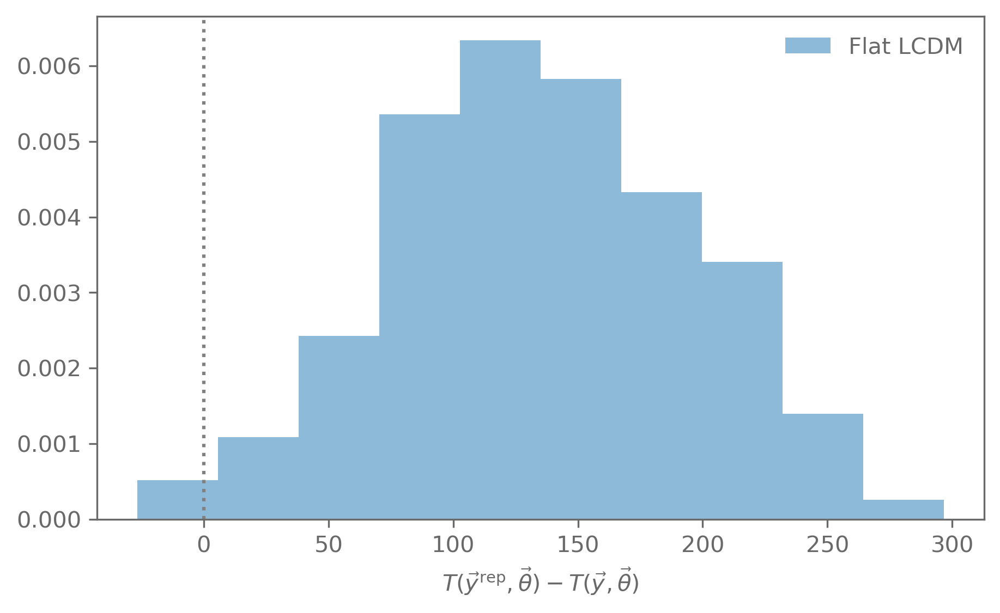

In [20]:
plt.hist(T_rep_flat_lcdm - T_flat_lcdm, density=True, alpha=0.5, label="Flat LCDM")
plt.axvline(0, ls=":", color="grey")
plt.legend(frameon=False)
plt.xlabel(r"$T(\vec y^\mathrm{rep}, \vec\theta) - T(\vec y, \vec\theta)$");

This also indicates that the observed data do not scatter as much as our model suggests. 

Something is not right. The first suspect is the data covariance.

We used the STAT+SYS covariance here. That means the covariance includes the systematic uncertainty on top of the statistical uncertainty. This could explain the very high PTE on the test statistic.

We already compared the flat and non-flat $\Lambda\text{CDM}$ models using the Bayes' ratio. Now er see what the DIC tells us:

In [28]:
DIC_flat_lcdm, p_D_flat_lcdm, p_V_flat_lcdm = DIC(
    theta_star=theta_MAP_flat_lcdm,
    theta_samples=chain_flat_lcdm,
    log_likelihood=log_likelihood_flat_LCDM
)
DIC_lcdm, p_D_lcdm, p_V_lcdm = DIC(
    theta_star=theta_MAP_lcdm,
    theta_samples=chain_lcdm,
    log_likelihood=log_likelihood_LCDM
)

print(f"Flat LCDM: DIC = {DIC_flat_lcdm:.1f}, p_D = {p_D_flat_lcdm:.1f}, "
      f"p_V = {p_V_flat_lcdm:.1f}")
print(f"LCDM: DIC = {DIC_lcdm:.1f}, p_D = {p_D_lcdm:.1f}, "
      f"p_V = {p_V_lcdm:.1f}")

Flat LCDM: DIC = 1445.9, p_D = 2.1, p_V = 2.3
LCDM: DIC = 1447.7, p_D = 3.1, p_V = 3.0


The DIC slightly prefers the simpler, flat $\Lambda\text{CDM}$ model.

We also see that the estimates of the number of model parameters makes sense: the flat $\Lambda\text{CDM}$ model has 3 parameters ($H_0$, $\Omega_\mathrm{m}$, $M$) but $H_0$ is completly constrained by the prior. So effectively, the data can only inform $\approx 2$ parameters.

The non-flat model has 4 parameters but again, $H_0$ is completly constrained by the prior, so we are left with $\approx 3$ effective free parameters.

## Exercise

Reproduce the chi-squared and PPD-based test with your own analysis code.

Show that for a Gaussian posterior with a wide and uniform prior, the estimate $p_\mathrm{V}$ of the effective number of free parameters reduces to the dimensionality of the Gaussian.

Try a cubic model. What are the DIC, WAIC, and Bayes factor?

In [1]:
import numpy as np
import scipy.stats
import matplotlib.pyplot as plt

In [10]:
title = "# Estimators and data exploration"
# Print title and setup TeX defs for both KaTeX and MathJax
import bayesian_stats_course_tools
bayesian_stats_course_tools.misc.display_markdown_and_setup_tex(title)

import matplotlib.style
matplotlib.style.use("bayesian_stats_course_tools.light")

# Estimators and data exploration

<!-- Define LaTeX macros -->
$\def\E{\operatorname{E}}$
$\def\Var{\operatorname{Var}}$
$\def\Cov{\operatorname{Cov}}$
$\def\dd{\mathrm{d}}$
$\def\ee{\mathrm{e}}$
$\def\Norm{\mathcal{N}}$
$\def\Uniform{\mathcal{U}}$

<!-- MathJax needs them to be defined again for the non-inline environment -->
$$\def\E{\operatorname{E}}$$
$$\def\Var{\operatorname{Var}}$$
$$\def\Cov{\operatorname{Cov}}$$
$$\def\dd{\mathrm{d}}$$
$$\def\ee{\mathrm{e}}$$
$$\def\Norm{\mathcal{N}}$$
$$\def\Uniform{\mathcal{U}}$$

## Statistics and estimators

A statistic is a function of a sample of RVs.

An *estimator* is a statistic that estimates a parameter of the population distribution that the samples are drawn from.

An estimator for population parameter $\theta$ is usually written with a hat: $\hat \theta (X_1,\dots,X_n)$, for sample $X_1,\dots,X_n$.



For example:
- Sample mean:
    - $\hat\mu = \bar X = \frac{1}{n}\sum_{i=1}^n X_i$

- Sample variance:
    - $\hat\sigma^2 = s^2 = \frac{1}{n-1}\sum_{i=1}^n (X_i-\bar X)^2$


### Bias
An estimator is unbiased if its expectation agrees with the population parameter:
$$
    \E[\hat\theta] = \theta
$$

For example, the sample mean:

$$
    \E[\bar X] = \E[\frac{1}{n}\sum_i X_i] = \frac{1}{n}\sum_i\int x_i p_{X_i}(x_i)\dd x_i
$$



If the $X_i$ are all from the same distribution $p_{X_i}(x_i) = p_{X}(x)$ then 

$$
    \E[\bar X] = \frac{1}{n}\sum_i\int x p_{X}(x)\dd x = \int x p_{X}(x)\dd x = \mu
$$
So the sample mean is an unbiased estimator of the population mean.

### Variance
Another property of an estimator is its variance. For the sample mean:

\begin{align*}
    \Var[\bar X] &= \E[\bar X^2] - \E[\bar X]^2 = \frac{1}{n^2}\sum_{ij}\E[X_i X_j] - \mu^2 \\
    &= \frac{1}{n^2}\sum_{i=j}\E[X_i X_j] + \frac{1}{n^2}\sum_{i\neq j}\E[X_i X_j]  - \mu^2 \\
\end{align*}



If the $X_i$ are iid, then $\E[X_i X_j] = \E[X_i]\E[X_j] = \mu^2$ and
\begin{align*}
    \Var[\bar X] &= \frac{1}{n^2}\sum_{i=j}\E[X_i X_j] + \frac{n^2 - n}{n^2}\mu^2  - \mu^2 \\
    &= \frac{1}{n}\left(\E[X_1^2] - \mu^2\right) = \frac{1}{n}\sigma^2
\end{align*}

The variance of the mean therefore decreases as $\frac{1}{n}$ and the standard deviation as $\frac{1}{\sqrt{n}}$.

Note that for dependent $X_1,\dots,X_n$ this is not the case (generally, not just for Gaussian distributed $X_i$):
\begin{equation}
    \begin{split}
        \Var[\bar X] &= \Var[\frac{1}{n}\sum X_i] = \frac{1}{n^2}\sum_{i}\Var[X_i] + \frac{1}{n^2}\sum_{i\neq j}\Cov[X_i, X_j] \\
        & = \frac{1}{n}\Var[X_1] + \frac{2}{n^2}\sum_{i>j}\Cov[X_i, X_j]
    \end{split}
\end{equation}

### Clicker

Why does the estimator for the sample variance $\hat\sigma^2 = \frac{1}{n-1}\sum_{i=1}^n (X_i-\bar X)^2$ use the prefactor $\frac{1}{n-1}$ instead of $\frac{1}{n}$?

Because we calculate the residuals $X_i - \bar X$ with respect to the sample mean, this minimises the sum of squares and underestimates the variance if we use the $\frac{1}{n}$ factor.


One way to see this is to note that the $n$ residuals $X_i - \bar X$ are not independent. 

Given $n-1$ of the $X_i$ and the sample mean $\bar X$, we know what $X_n$ is.


Formally, we can also show this with some matrix algebra. Write the mean as
$$
    \bar X = \frac{1}{n}\sum_i X_i = \frac{1}{n}\vec{𝟙}^T \vec X, \quad \vec{𝟙} = (1,\dots, 1)\,.
$$

The residuals can now be written as
$$
    \vec X - \bar X = (𝟙 - \frac{1}{n}\vec{𝟙}\vec{𝟙}^T)\vec X, \quad 𝟙 = 
        \begin{pmatrix}
            1 &  & \\
              &  \ddots & \\
              &  & 1
        \end{pmatrix}\,.
$$


Now we note that (hint, using the matrix determinant lemma $\det{(A + \vec u{\vec v}^T)} = (1 + \vec{v}^T A^{-1}\vec{u})\det A$)
$$
    \mathrm{rank}(𝟙 - \frac{1}{n}\vec{𝟙}\vec{𝟙}^T) = n - 1\,,
$$
that is, there are only $n-1$ independent rows in $(𝟙 - \frac{1}{n}\vec{𝟙}\vec{𝟙}^T)$.

## Sampling distributions

In a Bayesian analysis, we need to know the likelihood of the data: the conditional probability of the observed data, given the parameters: $p(d | \theta)$. 

If we compress the data $d$ using a statistic $\hat S = S(d)$, we therefore need to know the distribution of the statistic: $p(\hat S | \theta)$.



Even if the underlying data are normally distributed and the statistic is a simple function, the resulting distribution can become quite complicated.

We can often appeal to the central limit theorem and assume that our statistic is approximately Gaussian distributed but this assumption should be carefully checked, especially when the averaging happens over low number of data.


#### Sample mean:
- For $n$ iid $\vec X_i\sim\Norm(\vec\mu,\Sigma)$, the sample mean is also Gaussian distributed: $\hat{\vec\mu}\sim\Norm(\vec\mu, \frac{1}{n}\Sigma)$. 


#### Sample variance

$$
    \hat\sigma^2 = s^2 = \frac{1}{n-1}\sum_{i=1}^n (X_i-\bar X)^2
$$

The sample variance is distributed as $\frac{\hat\sigma^2}{\sigma^2}\sim \chi^2_{n-1}$, or written differently $\hat\sigma^2\sim \sigma^2\chi^2_{n-1} = \mathrm{Gamma}(\frac{n-1}{2}, 2\sigma^2)$, where $\mathrm{Gamma}$ is the Gamma distribution.

If the statistic you use for your analysis is the sample variance, you probably need to use a Gamma distribution for your likelihood.

#### Example: angular power spectra

The cosmic microwave background as observed by the Planck satellite:
<img style="display: block; 
    margin-left: auto;
    margin-right: auto;
    width: 60%;"
    src="../assets/Planck_2018_T_CMB.png" alt="Planck T map"/>


The cosmic microwave background (CMB) is the left-over radiation from when the Universe was about 300k years old. It is an almost perfect blackbody, with a temperature of 2.725 K today. It is the same in all directions, with only very small ($\mathcal{O}(10^{-5})$) perturbations. 



The perturbations form a Gaussian random field. A Gaussian random field is a generalisation of multivariate Gaussians to functions: any set of points is jointly Gaussian distributed. This is also called a Gaussian process. 

The Gaussian random field is completly characterised by its covariance function and mean. In cosmology, the mean is zero.



A scalar field $T$ on the sphere can be decomposed into spherical harmonic coefficients $a_{\ell m} = \int Y_{\ell m}(\vec\vartheta)T(\vec\vartheta)\dd^2\vartheta$. 

If T is a Gaussian random field, these are independently Gaussian distributed 
$$
    \Re(a_{\ell m}), \Im(a_{\ell m}) \sim \Norm(0, \frac{C_\ell}{2})\,.
$$
Assuming isotropy (there is no preferred direction), the angular power spectrum $C_\ell$ is defined as
$$
    \E[a_{\ell m}a_{\ell' m'}^*]=\delta_{\ell\ell'}\delta_{mm'}C_\ell \,.
$$

<img style="display: block; 
    margin-left: auto;
    margin-right: auto;
    width: 80%;"
    src="../assets/planck_Cl_TT.png" alt="Planck TT Cl"/>


Because the mean is zero, the angular power spectrum $C_\ell$ captures all the information of the perturbations of the CMB. This makes it a good statistic to use.



The estimator for the angular power spectrum is
$$
    \hat C_\ell = \frac{1}{2\ell + 1}\sum_{m=-\ell}^\ell a_{\ell m}^* a_{\ell m}\,.
$$

From this follows that 
$$
    \hat C_\ell \sim \mathrm{Gamma}\left( \frac{2\ell+1}{2}, \frac{2C_\ell}{2\ell+1}\right)\,.
$$

For low $\ell$, this distribution is not Gaussian and the likelihood needs to take this into account.


### Covariance

The multivariate generalisation of the sample variance is the sample covariance. For $n$ vector RV $\vec X_i$, $i=1,\dots,n$, the sample covariance matrix is
$$
    \hat\Sigma = \frac{1}{n-1}\sum_i^n (\vec X_i - \bar{\vec X})(\vec X_i - \bar{\vec X})^T
$$



If $\vec X_i$ are Gaussian distributed, $\vec X_i\sim\Norm(\mu,\Sigma)$, the sample covariance is Wishart distributed. 
$$
    \hat\Sigma \sim \mathcal{W}_p(\frac{1}{\nu}\Sigma, \nu)\ ,
$$
where $p$ is the size of the data vector and the number of degrees of freedom $\nu$ is $\nu = n-1$.

The Wishart distribution is a matrix distribution, that is it assigns probabilities to matrices. 
It is a multivariate generalisation of the Gamma distribution.

#### Example: Bias of the inverse of the sample covariance

We are often in the situation where we estimate the covariance from a sample but what we actually care about is the the inverse to compute likelihoods.

If $\hat \Sigma$ is Wishart distributed, then $\hat \Sigma^{-1}$ is inverse Wishart distributed:
$$
    \hat \Sigma^{-1} \sim \mathcal{W}^{-1}_p(\nu\Sigma^{-1}, \nu)
$$


Note that $\hat \Sigma^{-1}$ is a biased estimator of the precision matrix $\Sigma^{-1}$:
$$
    \E[\hat \Sigma^{-1}] = \frac{\nu}{\nu - p - 1}\Sigma^{-1} = \frac{n - 1}{n - p - 2}\Sigma^{-1}
$$

An unbiased estimate of the inverse of the covariance is therefore $\frac{n - p - 2}{n-1} \hat \Sigma^{-1}$.


The factor $\frac{n - 1}{n - p - 2}$ is sometimes known as the Hartlap factor in cosmology but it is just a consequence of the inverse Wishart distribution.

A cleaner treatment is to marginalise the likelihood over the distribution of the (unknown) true covariance (see [Selletin et al. 2016](http://adsabs.harvard.edu/abs/2016MNRAS.456L.132S))

## Correlation

If we know little about the data, looking for correlations is often a good start. 
The Pearson correlation coefficient is defined as
$$
    \rho_{X,Y} = \frac{\Cov[X, Y]}{\sigma_X \sigma_Y}\ .
$$
It takes values between -1 and 1, with 0 being no correlation.

An estimator for the correlation is:
$$
    \hat r = \frac{\sum_i(X_i - \bar X)(Y_i - \bar Y)}{\sqrt{\sum_i(X_i - \bar X)^2}\sqrt{\sum_i (Y_i - \bar Y)^2}}\,.
$$

### Clicker

If two random variables X and Y have zero correlation, what does this imply about their relationship?

- X and Y are independent.
- X and Y must have a correlation coefficient of 1.
- X and Y have no relationship at all.
- X and Y have no linear relationship but may still be dependent.

Except for jointly Gaussian distributed RVs, lack of correlation does not mean lack of dependence!

![correlation](../assets/Correlation_examples2.svg.png)

by Denis Boigelot

If there is a non-linear relationship between the RVs, the correlation can also be a very insufficient statistic, as illustrated by Anscombe's quartet: all entries have the same mean, variance, and correlation

<img src="../assets/Anscombes_quartet_3.svg" height=200>

The distribution of the Pearson correlation coefficient is slightly complicated, involving hypergeometric functions. But we can implement it:

In [5]:
def pearson_r(x, y, axis=0):
    """Compute the Pearson correlation coefficient."""
    x_ = x - np.mean(x, axis=axis, keepdims=True)
    y_ = y - np.mean(y, axis=axis, keepdims=True)

    r = np.sum(x_*y_, axis=axis) / (np.sqrt(np.sum(x_**2, axis=axis))*np.sqrt(np.sum(y_**2, axis=axis)))
    return r

def pearson_r_pdf(r, n, rho):
    """Compute the PDF of the Pearson correlation coefficient."""
    # https://mathworld.wolfram.com/CorrelationCoefficientBivariateNormalDistribution.html
    hypergeom = scipy.special.hyp2f1(0.5, 0.5, (2*n-1)/2, (rho*r+1)/2)
    Gamma = scipy.special.gamma
    return (
        (n-2)*Gamma(n-1)*(1-rho**2)**((n-1)/2)*(1-r**2)**((n-4)/2) 
        / (np.sqrt(2*np.pi)*Gamma(n-0.5)*(1-rho*r)**(n-3/2))
        * hypergeom
    )

To check if the PDF is implemented correctly, let us simulate a large number of iid bivariate normal RVs and compare the histogram of the estimated Pearson correlation coefficient to the analytic PDF.

In [8]:
# Define the covariance matrix for our RVs
rho = 0.5
cov = np.array(
    [[1, rho],
     [rho, 1]]
)
# We use 20 sample to estimate the correlation coefficient from
n = 20

s = scipy.stats.multivariate_normal(cov=cov).rvs((1000, n))
# s.shape = (1000, n, 2), r.shape = (1000,)
r = pearson_r(x=s[...,0], y=s[..., 1], axis=1)

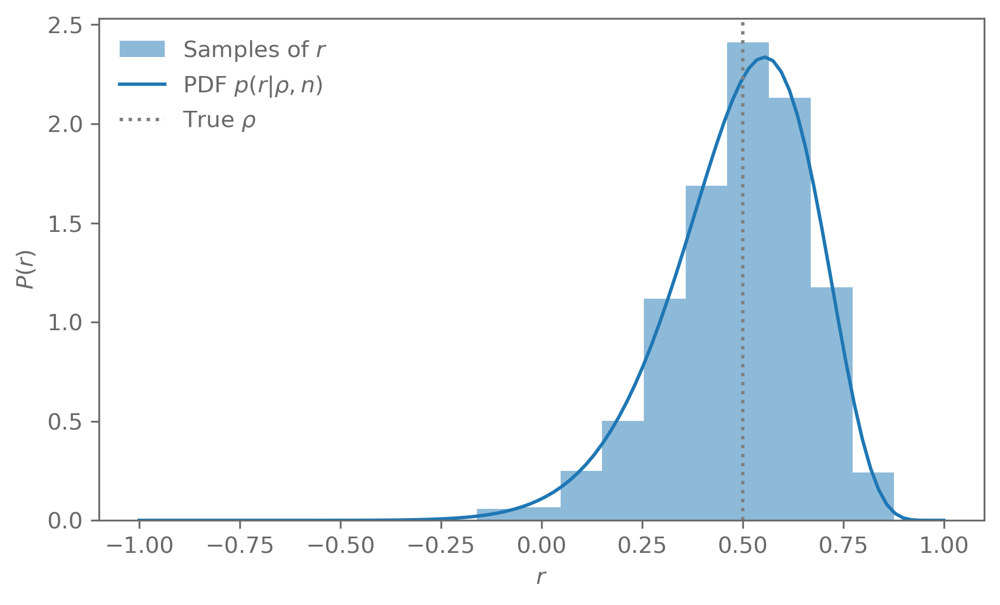

In [9]:

# Make plots
fig, ax = plt.subplots()

x = np.linspace(-1, 1, 100)
ax.hist(r, density=True, alpha=0.5, label=r"Samples of $r$")
ax.plot(x, pearson_r_pdf(r=x, n=n, rho=rho), color="C0", label=r"PDF $p(r|\rho, n)$")
ax.axvline(rho, ls=":", c="grey", label=r"True $\rho$")
ax.set_xlabel("$r$")
ax.set_ylabel("$P(r)$")
ax.legend(frameon=False);

## Malmquist bias

Imagine you measure the (intrinsic) luminosities and distances of a sample of galaxies. 
The plot might look something like this:

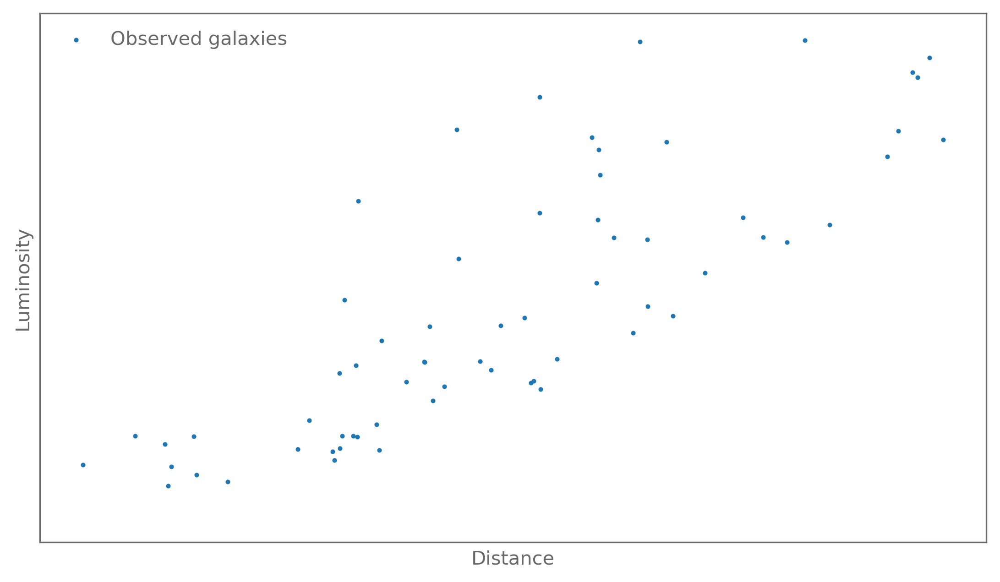

In [12]:
np.random.seed(42)

def powerlaw_pdf(x, alpha, a, b):
    A = (b**(1-alpha)-a**(1-alpha))
    return np.piecewise(x, [(a<=x) & (x <=b)], [lambda x: (1-alpha)/A * x**(-alpha), 0])

def powerlaw_cdf(x, alpha, a, b):
    A = (b**(1-alpha)-a**(1-alpha))
    return np.piecewise(x, [x < a, (a<=x) & (x <=b)], [0, lambda x: 1/A * (x**(1-alpha) - a**(1-alpha)), 1])

# Allows us to sample from the power-law distribution using inverse transform sampling
def powerlaw_ppf(x, alpha, a, b):
    A = (b**(1-alpha)-a**(1-alpha))
    return (x*A + a**(1-alpha))**(1/(1-alpha))

def mag_lim(d):
    """Magnitude limit at distance d"""
    return 0.35 + 0.2*d**2

distance_bins = np.linspace(0.2, 3.0, 20)
Delta_d = distance_bins[1] - distance_bins[0]

samples = []
observed = []
for d in distance_bins:
    # Assume uniform galaxy density, from which follows number of galaxies 
    # at distance d is proportional to d^2
    n = 100*d**2

    # Get n samples from the power-law distribution
    u = np.random.rand(int(n))
    s = powerlaw_ppf(u, 2.8, 0.1, 4)

    # Jitter the distance by the distance bin width
    samples.append(
        np.vstack((d + Delta_d*(np.random.rand(s.size)-0.5), s)).T
    )
    # Impose magnitude limit
    observed.append(s > mag_lim(d))

samples = np.concatenate(samples)
observed = np.concatenate(observed)

fig, ax = plt.subplots(figsize=(16/9*5, 5))

ax.scatter(*samples[observed].T, s=2, label="Observed galaxies")

ax.legend(frameon=False)
ax.set_ylim(0.1, 3)
ax.set_xlabel("Distance")
ax.set_ylabel("Luminosity")

ax.tick_params(labelleft=False, left=False, labelbottom=False, bottom=False);

Is there a correlation of galaxy luminosity with distance?

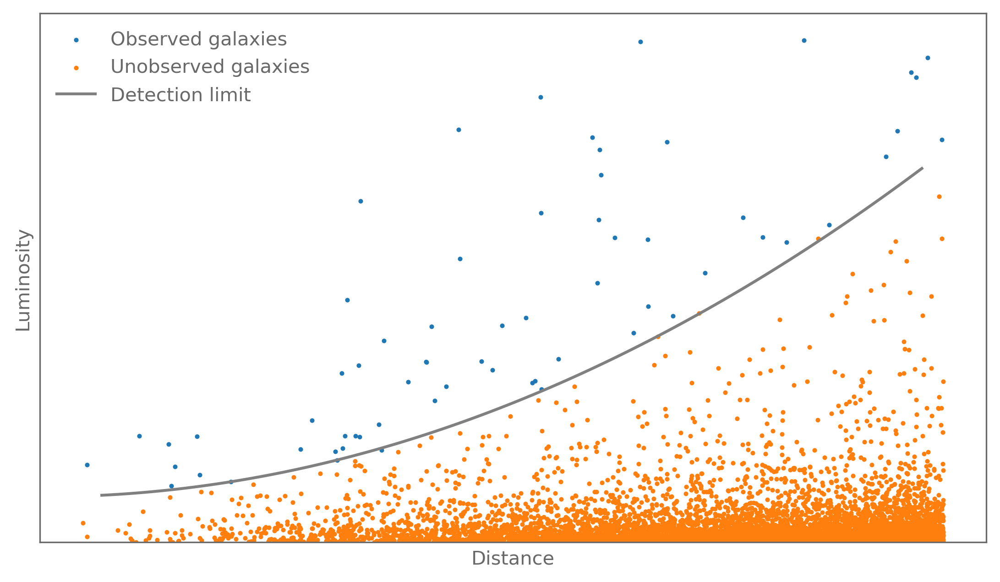

In [13]:
fig, ax = plt.subplots(figsize=(16/9*5, 5))

d = np.linspace(distance_bins[0], distance_bins[-1], 100)
ax.scatter(*samples[observed].T, s=2, label="Observed galaxies")
ax.scatter(*samples[~observed].T, s=2, label="Unobserved galaxies")
ax.plot(d, mag_lim(d), c="grey", label="Detection limit")

ax.legend(frameon=False)
ax.set_ylim(0.1, 3)
ax.set_xlabel("Distance")
ax.set_ylabel("Luminosity")

ax.tick_params(labelleft=False, left=False, labelbottom=False, bottom=False)

fig.dpi = 300;

Be wary of selection effects!

Power-law distributions are common in the physical sciences but they can behave in unintuitive ways. 

## Exercise

Show that the sample variance $s^2 = \frac{1}{n-1}\sum_{i=1}^n (X_i-\bar X)^2$ is an unbiased estimator of the population variance.

Where does the factor of $\frac{1}{n-1}$ come from? What is the unbiased estimator of the population variance if the population mean $\mu$ is known?

Make a toy data set by sampling from a bivariate Gaussian.
Compute the posterior of the correlation coefficient $\rho$, given the observed $\hat r$. 

# Data exploration

## PCA

Principal component analysis (PCA) is useful when the data has many dimensions and we want to know which of the dimensions are important, in the sense that we can reproduce the salient features of the data with a smaller number of dimensions.



We start with $n$ observations $\vec X_i$, $i=1,\dots,n$ with $d$ features, that we arrange in a $n\times d$ matrix $X_{ij}$.

1. Remove the mean of the observations from each row $Y_{ij} = X_{ij} -  \frac{1}{n}\sum_k X_{kj}$
2. Take the covariance $C = Y^T Y$
3. Find the eigenvalues $\lambda_i$ and eigenvectors $\vec E_j$ of the covariance $C$
4. Sort the eigenvalues by descending order, sort the eigenvectors the same way, and arrange the eigenvectors as columns in a matrix $E$
5. Project the data onto the principal components (the eigenvectors) to get the principal component coefficients $T = Y E$
6. Optionally project back into data-space, using only a small number of coefficients

To illustrate, we look at data from a bivariate Gaussian distribution, so the number of data dimensions is $d = 2$.

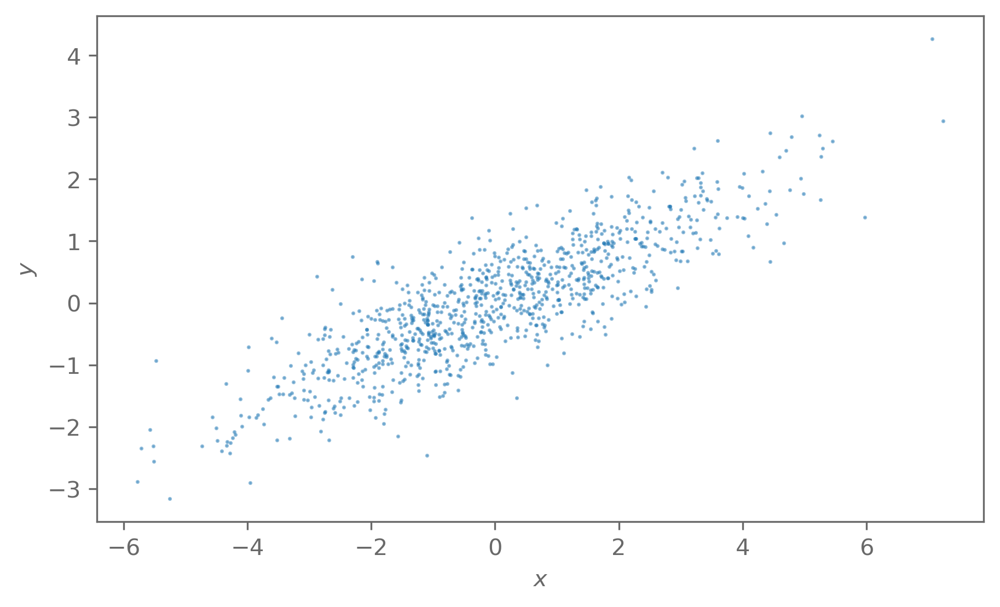

In [10]:
# Define variances and correlation
sigma_x = 2
sigma_y = 1
rho = 0.85

# Define mean and covariance
mean = np.array([0.0, 0.0])
cov = np.array([[sigma_x**2, sigma_x*sigma_y*rho],
                [sigma_x*sigma_y*rho, sigma_y**2]])

# Create distribution object
samples = scipy.stats.multivariate_normal(mean=mean, cov=cov).rvs(1000)

plt.scatter(*samples.T, s=0.5, alpha=0.5, label="Data")
plt.xlabel("$x$")
plt.ylabel("$y$")
plt.gca().set_aspect('equal');

In [11]:
def PCA(data):
    # Remove the mean
    data_mean = data.mean(axis=1)[:, None]
    X = data - data_mean
    # Get covariance and its eigenvectors
    cov_X = np.cov(X)
    l, E = np.linalg.eigh(cov_X)

    # Sort by the eigenvalues
    sort_idx = np.argsort(l)[::-1]
    l = l[sort_idx]
    E = E[:,sort_idx]

    def project_onto_pc(d):
        if d.ndim == 1:
            d = d[:, np.newaxis]
        return E.T @ (d - data_mean)
    
    def reconstruct_from_pc(c):
        if c.ndim == 1:
            c = c[:, np.newaxis]
        return E[:, :c.shape[0]] @ c + data_mean

    return l, E, project_onto_pc, reconstruct_from_pc

l, E, project_onto_pc, reconstruct_from_pc = PCA(samples.T)

The first principal component describes most of the variance of the data. In other words, we were to reconstruct the data with just the first component, we would already capture most of the features of the distribution of the data.


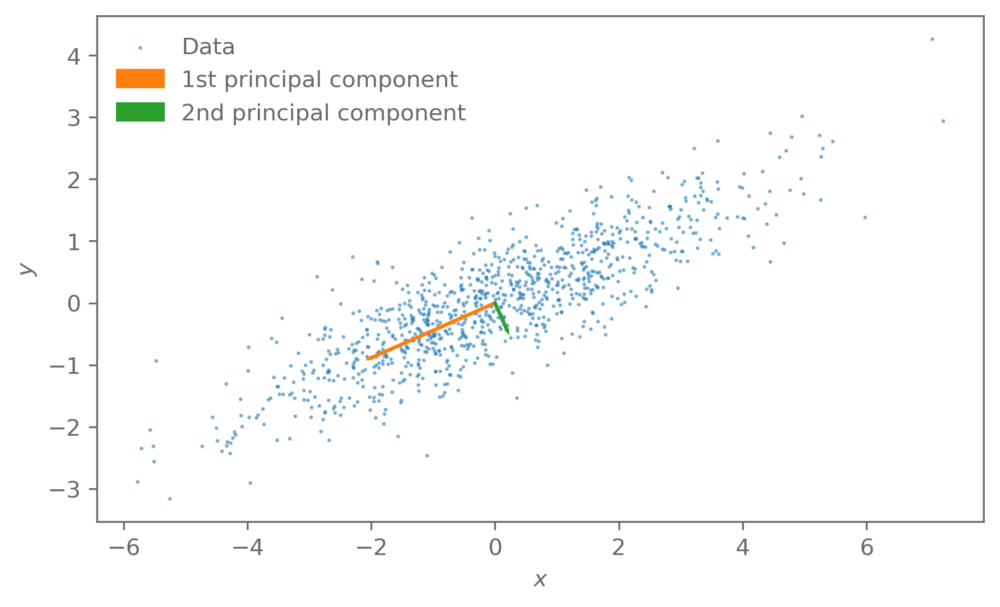

In [12]:
plt.scatter(*samples.T, s=0.5, alpha=0.5, label="Data")
plt.arrow(0, 0, *(np.sqrt(l[0])*E[:, 0]), lw=1.5, color="C1", label="1st principal component")
plt.arrow(0, 0, *(np.sqrt(l[1])*E[:, 1]), lw=1.5, color="C2", label="2nd principal component")
plt.gca().set_aspect('equal')
plt.xlabel("$x$")
plt.ylabel("$y$")
plt.legend(frameon=False);

For Gaussian data, the principal components capture all the information about the distribution.

For non-Gaussian data that is not the case but PCA might still be useful for finding informative subspaces.

### Clicker

If you have a dataset where the first two principal components account for 95% of the variance, what can you infer about the dataset's structure, assuming it is Gaussian?
- The original features are highly independent, so reducing dimensionality will lose essential information.
- The data points are distributed uniformly across all dimensions.
- The data has a strong structure in one or two dimensions, allowing reduction to two dimensions without major information loss.
- The eigenvalues associated with other dimensions must be nearly as large as the first two.

#### Example: matter power spectra

Because the Universe started out as a Gaussian random field, it is common to analyse data in cosmology using power spectra. 

Similar to the case of the CMB, for an isotropic 3D field $\delta(\vec x)$ with Fourier transform $\delta(\vec k)$, the power spectrum is defined as
$$
    \E[\delta(\vec k)\delta^*(\vec k)] \propto P(|\vec k|)\,.
$$
This can be understood as the variance of the field at wave-number $k$. Or more informally, how clumpy is the field on a specific scale.

In this example, we look at the power spectra of some of the state-of-the-art simulations of the Universe.

<img style="display: block; 
    margin-left: auto;
    margin-right: auto;
    width: 60%;"
    src="../assets/flamingo_full.png" alt="FLAMINGO"/>

Depending on how galaxy formation is modelled in these simulations, the power spectrum of the matter distribution changes. Here we look at the ratio between the matter power spectrum of a simulation that models galaxy formation and one where there is only dark matter.

In `data/Pk_lib/power_spectrum_suppression.txt` are a list of ratios of matter power spectra from hydrodynamical simulations and the same simulations but assuming all matter is dark matter.

In [14]:
d = np.loadtxt("data/Pk_lib/power_spectrum_suppression.txt")
k = d[:, 0]
power_spectra = d[:, 1:]

with open("data/Pk_lib/power_spectrum_suppression.txt", "r") as f:
    names = [s.strip() for s in f.readline().lstrip("#").split(",")][1:]

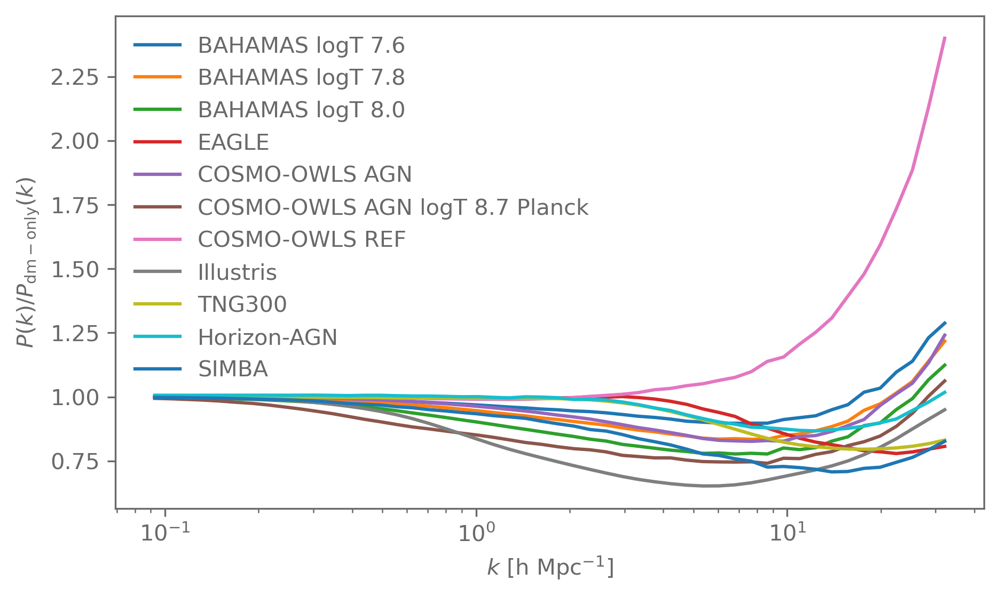

In [15]:
for name, r in zip(names, power_spectra.T):
    plt.plot(k, r, label=name)

plt.xscale("log")
plt.legend(frameon=False)
plt.xlabel("$k$ [h Mpc$^{-1}$]")
plt.ylabel(r"$P(k) / P_\mathrm{dm-only}(k)$");

In [16]:
l, E, project_onto_pc, reconstruct_from_pc = PCA(power_spectra)

Check the eigenvalues:

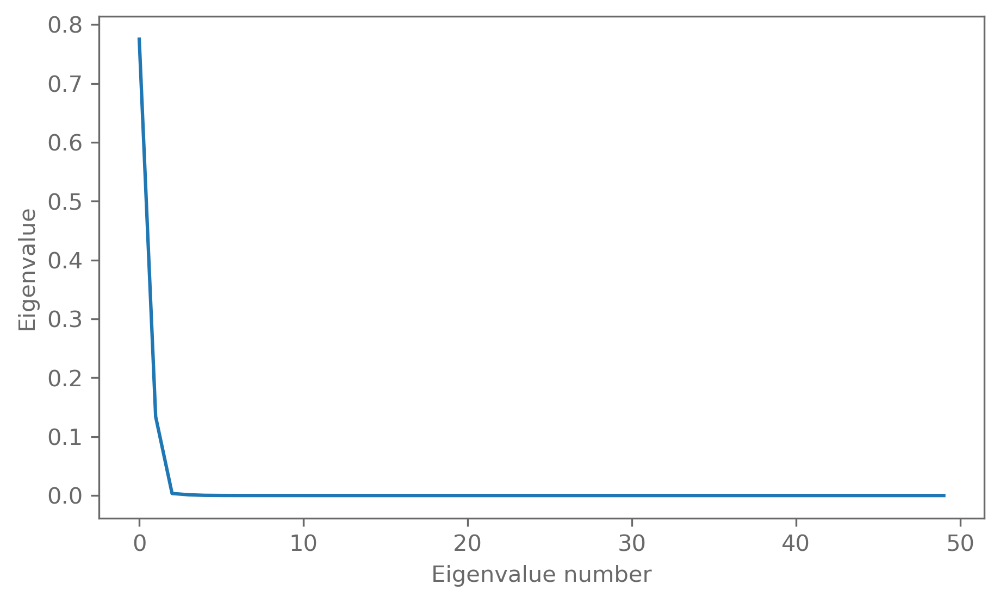

In [17]:
# Check the eigenvalues
plt.plot(l)
plt.ylabel("Eigenvalue")
plt.xlabel("Eigenvalue number");

What are the principal components that the data are projected onto (show in data space here)?

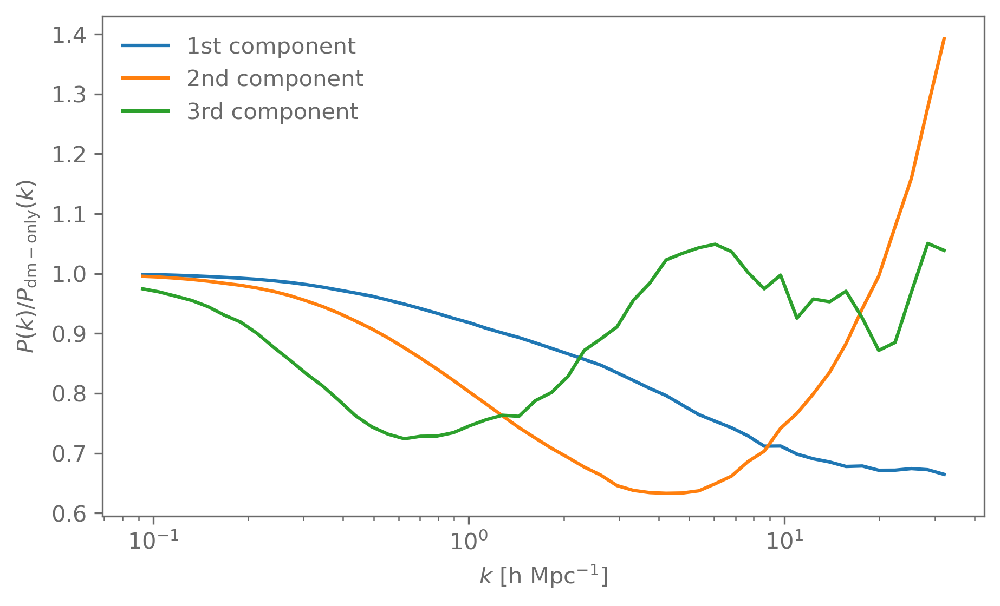

In [18]:
# plt.semilogx(k, E[:, 0])
# plt.semilogx(k, E[:, 1])
# plt.semilogx(k, E[:, 2])

plt.semilogx(k, reconstruct_from_pc(np.array([1,])), label="1st component");
plt.semilogx(k, reconstruct_from_pc(np.array([0,1])), label="2nd component");
plt.semilogx(k, reconstruct_from_pc(np.array([0,0,1])), label="3rd component");

plt.legend(frameon=False)
plt.xlabel("$k$ [h Mpc$^{-1}$]")
plt.ylabel(r"$P(k) / P_\mathrm{dm-only}(k)$");
# plt.semilogx(k, E[:, 1])
# plt.semilogx(k, E[:, 2])

Project back into data space with only a few components.

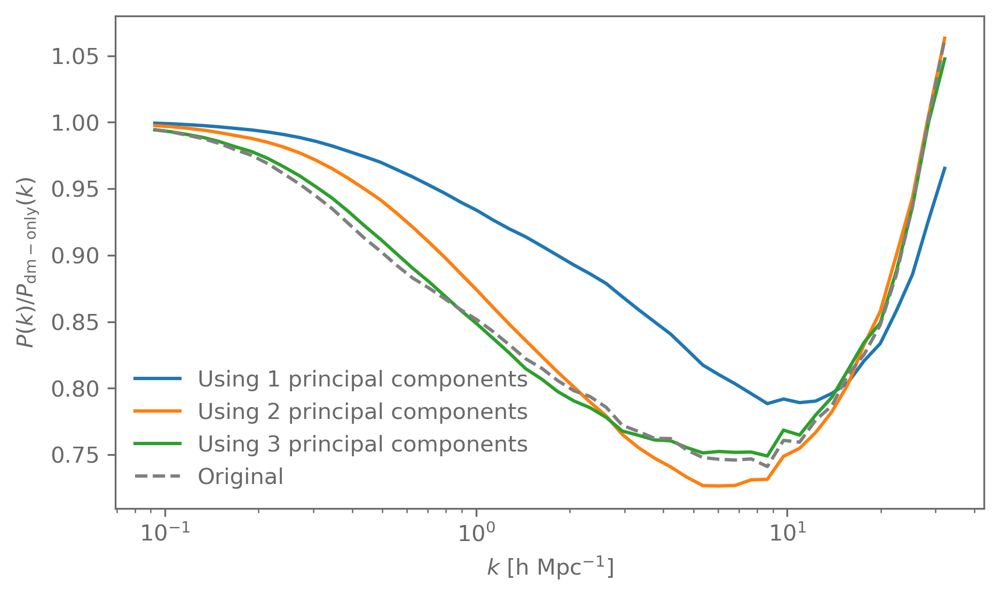

In [19]:
data_point = power_spectra[:, 5]
coefficients = project_onto_pc(data_point)

for n_components in range(1, 4):
    reconstructed = reconstruct_from_pc(coefficients[:n_components])
    plt.semilogx(k, reconstructed, label=f"Using {n_components} principal components")

plt.semilogx(k, data_point, ls="--", color="grey", label=f"Original")
plt.legend(frameon=False)
plt.xlabel("$k$ [h Mpc$^{-1}$]")
plt.ylabel(r"$P(k) / P_\mathrm{dm-only}(k)$");

## Bootstrap

We are often in the situation where we have data but do not know the distribution of the statistics of the data.

Here the [bootstrap](http://dx.doi.org/10.1214/aos/1176344552) comes in handy, as it allows us to approximate the sampling distribution of our statistic from the sample:

Assume we have $n$ iid data $X_i$, and a statistic $\phi$.

We can calculate the value of the statistic on the sample $\hat f = \phi(X_1,\dots,X_n)$.

What we want to know is the sampling distribution of $\phi$, i.e., what values $\hat f$ would take if we were to sample new $X_i$ from the true distribution of $X$.

If the $X_i$ are not Gaussian distributed and $\phi$ is non-linear, this can be very difficult to do analytically.

Here the bootstrap comes in handy:

1. Sample with replacement $n$ times from the $n$ samples $X_i$. Let us call these $Y_i$
2. Compute the statistic using the resampled data: $\hat f^* = \phi(Y_1,\dots,Y_n)$
3. Repeat steps 1) and 2) $N$ times ($N$ being large), recording the values of $\hat f^*_j$, $j=1,\dots,N$

The distribution of $\hat f^*_j$ approximates the true sampling distribution of $\hat f$.

This is a pretty amazing result. Because we seem to get something (the sampling distribution) from nothing (just the one realisation of the samples), this is called the bootstrap.

In its basic form it assumes independent data, extensions to dependent data do exist and usually revolve around resampling blocks of the data that are approximately independent.

In [23]:
def bootstrap(data, statistic, n_trial):
    n_data = data.shape[1]
    s = []
    for i in range(n_trial):
        idx = np.random.choice(n_data, size=n_data, replace=True)
        data_resampled = data[:, idx]
        s.append(statistic(data_resampled))
    
    return np.array(s)

Let us apply the bootstrap to find the distribution of the PCA coefficients of the power spectrum example from earlier:

In [24]:
def PCA_coefficients(data, data_point):
    l, E, project_onto_pc, reconstruct_from_pc = PCA(data)
    coefficients = project_onto_pc(data_point)
    return coefficients

coefficient_samples = bootstrap(
    power_spectra,
    statistic=lambda data: PCA_coefficients(
        data, data_point=data_point),
    n_trial=1000
)

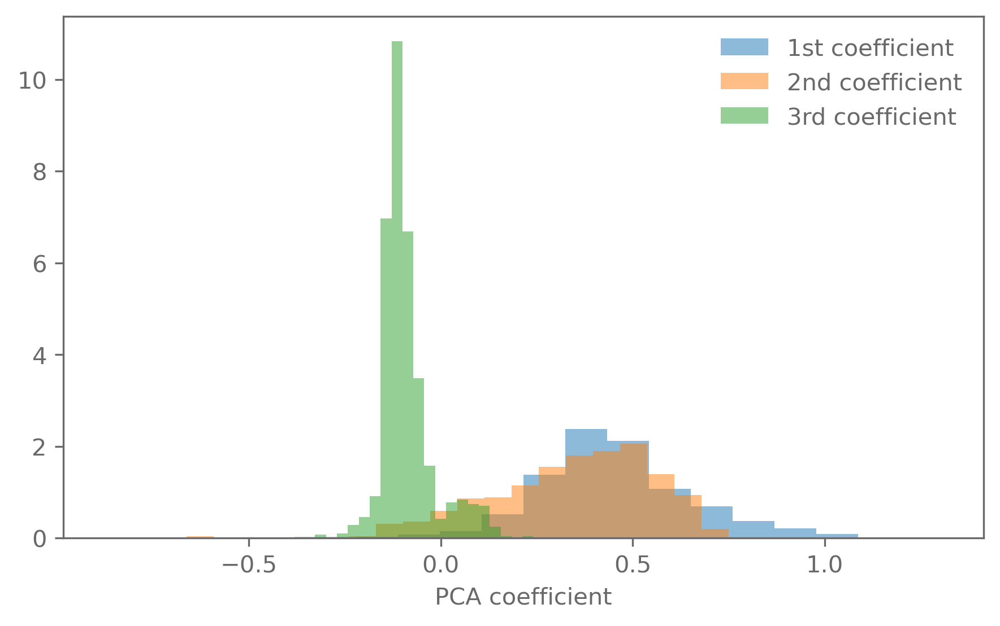

In [25]:
plt.hist(coefficient_samples[:,0], bins=20, density=True, alpha=0.5, label="1st coefficient")
plt.hist(coefficient_samples[:,1], bins=20, density=True, alpha=0.5, label="2nd coefficient")
plt.hist(coefficient_samples[:,2], bins=20, density=True, alpha=0.5, label="3rd coefficient")
plt.legend(frameon=False)
plt.xlabel("PCA coefficient");

We can also use the bootstrap to estimate the uncertainty of a reconstructed power spectrum.

In [26]:
def PCA_and_reconstruct(data, data_point, n_component):
    l, E, project_onto_pc, reconstruct_from_pc = PCA(data)
    coefficients = project_onto_pc(data_point)
    return reconstruct_from_pc(coefficients[:n_component])

data_point = power_spectra[:, 5]
l, E, project_onto_pc, reconstruct_from_pc = PCA(power_spectra)
coefficients = project_onto_pc(data_point)
reconstructed = reconstruct_from_pc(coefficients[:3])

reconstructed_samples = bootstrap(
    power_spectra,
    statistic=lambda data: PCA_and_reconstruct(
        data, data_point=data_point, n_component=3),
    n_trial=200
)

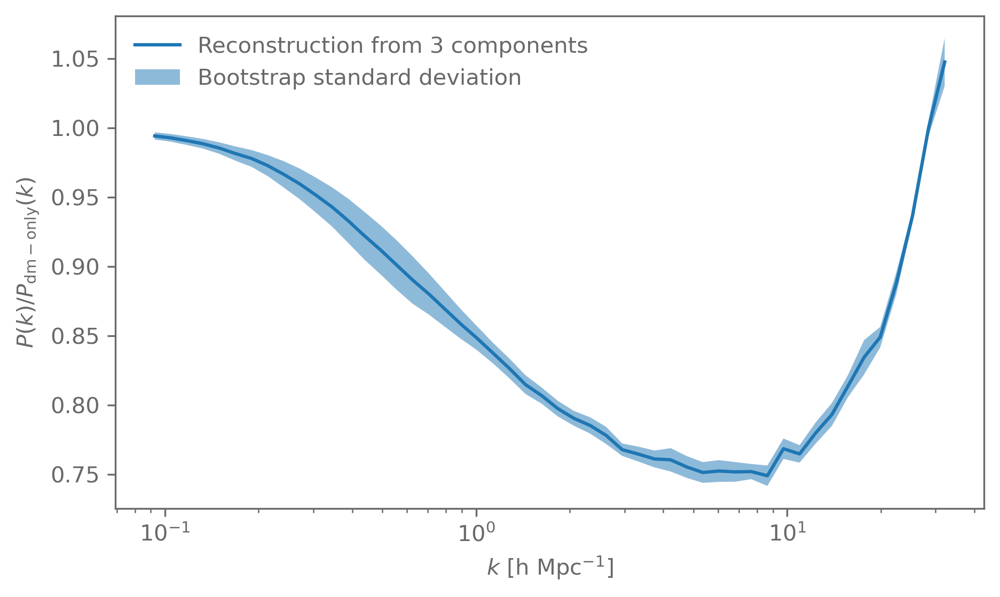

In [34]:
reconstructed = reconstructed.squeeze()
plt.semilogx(k, reconstructed, label="Reconstruction from 3 components")
std = reconstructed_samples.std(axis=0).squeeze()
plt.fill_between(k, reconstructed-std, reconstructed+std,
                 alpha=0.5, label="Bootstrap standard deviation")
plt.legend(frameon=False)
plt.xlabel("$k$ [h Mpc$^{-1}$]")
plt.ylabel(r"$P(k) / P_\mathrm{dm-only}(k)$");

### Clicker

Why might bootstrapping fail to approximate the sampling distribution?
- Resampling the data might introduce artificial artifacts by overfitting.
- The bootstrap requires an infinite sample size to correct for dependencies.
- Bootstrap resampling increases bias in the original estimator, compounding dependencies.
- The bootstrap relies on independent observations to ensure that each sample approximates the population, hence it might fail if the data are not i.i.d.

## Exercise

Check that the boostrap works for a case where we do know the sampling distribution. For example the estimators discussed at the beginning of this lecture.

In [3]:
import numpy as np

import jax.numpy as jnp
from jax import jit, vmap, grad, jacfwd, hessian
import jax.random

import scipy.optimize
import matplotlib.pyplot as plt

import emcee
import corner

from bayesian_stats_course_tools.plotting import plot_contours


In [4]:
title = "# Fisher, Hamilton Monte Carlo, and JAX"
# Print title and setup TeX defs for both KaTeX and MathJax
import bayesian_stats_course_tools
bayesian_stats_course_tools.misc.display_markdown_and_setup_tex(title)

import matplotlib.style
matplotlib.style.use("bayesian_stats_course_tools.light")

# Fisher, Hamilton Monte Carlo, and JAX

<!-- Define LaTeX macros -->
$\def\E{\operatorname{E}}$
$\def\Var{\operatorname{Var}}$
$\def\Cov{\operatorname{Cov}}$
$\def\dd{\mathrm{d}}$
$\def\ee{\mathrm{e}}$
$\def\Norm{\mathcal{N}}$
$\def\Uniform{\mathcal{U}}$

<!-- MathJax needs them to be defined again for the non-inline environment -->
$$\def\E{\operatorname{E}}$$
$$\def\Var{\operatorname{Var}}$$
$$\def\Cov{\operatorname{Cov}}$$
$$\def\dd{\mathrm{d}}$$
$$\def\ee{\mathrm{e}}$$
$$\def\Norm{\mathcal{N}}$$
$$\def\Uniform{\mathcal{U}}$$

## Fisher matrix

For a distribution $p(X | \theta)$ of a RV $X$, given a parameter $\theta$, the Fisher information tells us how much information $X$ can give us about $\theta$.



The Fisher information is defined as
\begin{align}
    I(\theta) &= \E_{p(X|\theta)}\left[\left.\left(\frac{\partial\log p(X|\theta)}{\partial\theta}\right)^2 \right| \theta\right] \\
    &=^* -\E_{p(X|\theta)}\left[\left.\frac{\partial^2 \log p(X|\theta)}{\partial\theta^2}\right|\theta\right]\ .
\end{align}
The second equality applies in most cases of relevance.


#### Example: 1d Gaussian with known variance

Let
$$
    \log p(X | \mu) = -\frac{1}{2}\frac{(X - \mu)^2}{\sigma^2} + \text{const}
$$
then
$$
    I(\mu) = \frac{1}{\sigma^2}
$$

Larger $\sigma$ means less information gained on $\mu$ by data $X$.


### Cramer-Rao bound

The variance of an estimator $\hat\theta$ is bounded from below by the inverse of the Fisher information for that parameter:
$$
    \Var[\hat\theta] \geq \frac{1}{I(\theta)}\,.
$$


For $n$ idd Gaussian $\vec X\sim \Norm(\mu, \sigma^2 I_n)$, with known variance $\sigma^2$ and unknown mean $\mu$
$$
    \log p(\vec X |\mu) = -\frac{1}{2}\sum_i \frac{(X_i - \mu)^2}{\sigma^2} + \text{const}
$$
The Fisher informaton on $\mu$ is
$$
    I(\mu) = \frac{n}{\sigma^2}\,.
$$

The Cramer-Rao bound is therefore
$$
    \Var[\hat\mu] \geq \frac{\sigma^2}{n}
$$
That means that the variance of the sample mean is the lowest possible variance of an estimator for the mean.

### Multivariate case

For multiple parameters $\vec\theta$, the generalisation is the Fisher information matrix
\begin{align}
    I_{ij}(\vec\theta) &= \E_{p(X|\vec\theta)}\left[\left.\left(\frac{\partial \log p(X|\vec\theta)}{\partial \theta_i}\right)\left(\frac{\partial\log p(X|\vec\theta)}{\partial \theta_j}\right)\right|\theta\right] \\
    &= -\E_{p(X|\vec\theta)}\left[\left.\frac{\partial^2 \log p(X|\vec\theta)}{\partial \theta_i\partial\theta_j}\right|\theta\right]
\end{align}

We can get an estimate of the covariance of the parameters $\vec\theta$ by taking the inverse of the Fisher information matrix:
$$
    \Cov[\vec\theta] = I(\vec\theta)^{-1}\,.
$$

This allows us to make predictions on what the constraints on the parameters are going to be before we take data. 

This is only exact in the case of Gaussian distributed parameters but even if not this is a useful tool to get an idea on what an experimental setup (as encoded in the likelihood) is expected to produce.

For the case of a Gaussian likelihood where the covariance $\Sigma$ does not depend on the parameters, this reduces to
$$
    I_{ij}(\vec\theta) = \sum_{kl}\frac{\partial\mu_k(\vec\theta)}{\partial\theta_i}(\Sigma^{-1})_{kl}\frac{\partial\mu_l(\vec\theta)}{\partial\theta_j}
$$

### Jeffreys prior

Another place where the Fisher information appears is the Jeffreys prior.

We have talked about uninformative priors a couple of times so far. 
We choose uninformative priors when we do not want our posteriors to be influenced by our choice of priors.


But what does uninformative mean? 

### Clicker

Consider a Gaussian likelihood $p(X | \mu, \sigma) = \frac{1}{\sqrt{2\pi\sigma^2}}\mathrm{e}^{-\frac{1}{2}\frac{(X - \mu)^2}{\sigma^2}}$ where the variance is also an unknown parameter we want to infer. We therefore need to choose a prior - how should we define it?
- We define a prior on $\sigma$: $p(\sigma)$.
- We define a different prior on $\sigma^2$: $p(\sigma^2)$.
- It doesn't matter whether we use $\sigma$ or $\sigma^2$, the prior is the same.


A flat prior in $\theta$ will not be flat for $\theta^2$ for example:

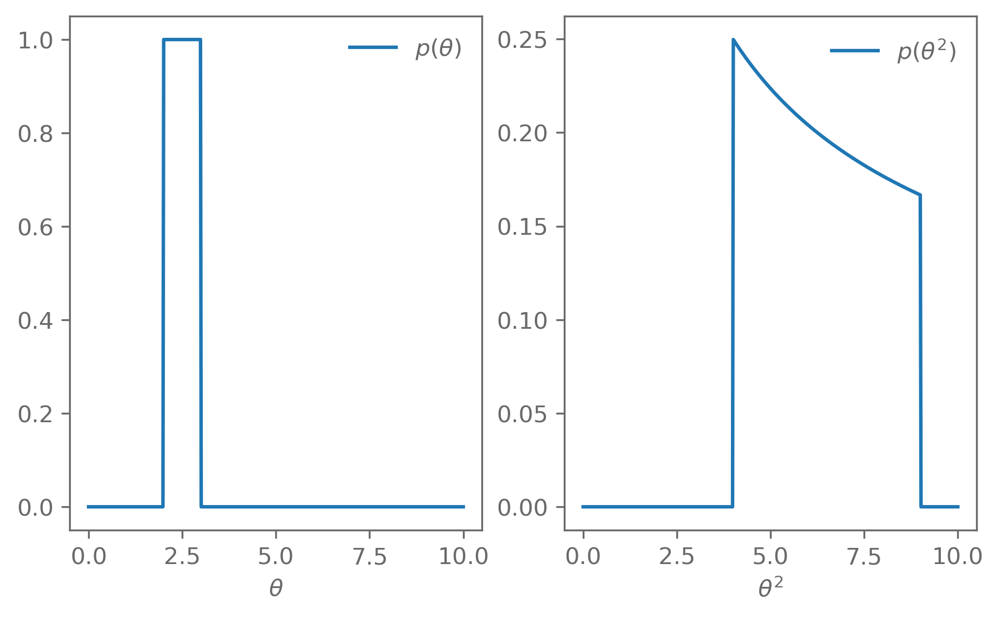

In [104]:
a, b = 2, 3
u = np.random.uniform(a, b, 10000)

fig, ax = plt.subplots(1, 2)

x = np.linspace(0, 10, 500)

p_u = np.piecewise(x, [(a < x) & (x < b)], [lambda x: 1/(b-a), 0])
p_u2 = np.piecewise(
    x, [(a < np.sqrt(x)) & (np.sqrt(x) < b)],
    [lambda x: 0.5*1/(b-a)/np.sqrt(x), 0]
)

ax[0].plot(x, p_u, label=r"$p(\theta)$")
ax[0].set_xlabel(r"$\theta$")
ax[0].legend()
ax[1].plot(x, p_u2, label=r"$p(\theta^2)$")
ax[1].set_xlabel(r"$\theta^2$")
ax[1].legend();

Jeffreys' priors address this, as they are constructed such that they are invariant to reparameterisation. This is achieved by setting the prior to
$$
    p(\theta) \propto \sqrt{\det I(\theta)}\,.
$$



This definition gives us the desired reparameterisation invariance, because under a reparameterisation $\theta \rightarrow \rho$, the Fisher information transforms as
$$
    I(\rho) = I(\theta)\left(\frac{\dd \theta}{\dd\rho}\right)^2\ ,
$$
while the change of variables transforms the distribution $p(\theta)$ as
$$
    p(\rho) = p(\theta)\left|\frac{\dd\theta}{\dd\rho}\right|\ .
$$



By choosing $p(\theta) \propto \sqrt{\det I(\theta)}$, we also have $p(\rho) \propto \sqrt{\det I(\rho)}$, the invariance to reparameterisation we are looking for.

#### Example: Jeffreys prior for mean and variance

As we have seen before, the Fisher information of the mean of Gaussian is
$$
    I(\mu) = \frac{1}{\sigma^2}
$$
The Jeffreys prior for $\mu$ is therefore
$$
    p(\mu) \propto \frac{1}{\sigma} \propto \text{const}\ ,
$$
i.e., it does not depend on $\mu$. So for the mean (or location parameters in general), a flat prior is appropriate.



Note that the constant prior is not a probability distribution, since it cannot be normalised. 
It is an improper prior. In this case the posterior is still well-defined though.

In practice there are usually physical limits on the parameter, which addresses this.

Now, the case where $\mu$ is fixed but $\sigma$ is a parameter:
$$
    I(\sigma) = \frac{2}{\sigma^2}
$$
This gives the Jeffreys prior for the standard deviation (and scale parameters in general)
$$
    p(\sigma) \propto \frac{1}{\sigma}
$$



This is also equivalent to having a flat prior on $\log \sigma$: $p(\log\sigma)\propto \text{const}$. 

The intuition is that if there is no information on the scale of something, then the probability of it being in the range 1-10 or 10-100 should be the same. This corresponds to a flat prior on a log scale.



Now the prior depends on $\sigma$ and is not a flat prior. This is again an improper prior, and depending on the likelihood, it might lead to an ill-defined posterior.

Summary:
- How models are parametrised matters.
- If this affects your analysis, consider using Jeffreys' priors.
- For multiple parameters, this can be generalised to so-called reference priors.
    - These can be difficult to define in practise.
- These priors are often improper, so some physical insight or other prior knowledge needs to be included in most cases anyways.

### Clicker

In the multivariate case, the Fisher information matrix $I_{ij}(\vec{\theta})$ is given by the expectation of the product of partial derivatives of the log-likelihood with respect to the parameters $\theta_i$ and $\theta_j$. What does the inverse of this matrix represent?
 - The gradient of the likelihood.
 - An estimate of the covariance of $\vec{\theta}$.
 - The information density of each parameter.
 - The posterior distribution of $\vec{\theta}$.

## JAX

[JAX](https://jax.readthedocs.io) brings autodifferentiation to numpy and allows it to run fast on CPUs, GPUs, etc.

I will go briefly over the main features here but I suggest you have a look at the [tutorial](https://jax.readthedocs.io/en/latest/jax-101/01-jax-basics.html) (or others, in case you find something better) to get a feel for the features.

### Autodifferentiation

The code we run on computers ultimatively is just a sequence of elementary operations, such as addition and multiplication.

If we can track all the operations a function executes internally, we can use the chain rule to compute the derivatives of the function.

Autodifferentiation frameworks do the hard work for us by tracking all the operations from our code down to the elementary operations and giving us access to derivatives.

In [105]:
from jax import grad

# Define our function
def f(x):
    return x**2 - 1

# jax.grad takes a function and returns another function, which is the gradient
df_dx = grad(f)
d2f_dx2 = grad(df_dx)

x = 1.0
print(f"f({x}) = {f(x)}")
print(f"df({x})/dx = {df_dx(x)}")
print(f"d^2f({x})/dx^2 = {d2f_dx2(x)}")

f(1.0) = 0.0
df(1.0)/dx = 2.0
d^2f(1.0)/dx^2 = 2.0


### Auto-vectorisation

JAX also gives a convenient utility to vectorise our functions.

In [106]:
from jax import vmap

# Define a vectorised version of our derivative df/dx
batched_df_dx = vmap(df_dx)

batched_df_dx(jnp.array([1.0, 2.0]))

Array([2., 4.], dtype=float32)

### Just-in-time compilation

Finally, JAX allows compiling functions to run fast on CPUs, as well as GPUs. 
This puts some [mild restrictions](https://jax.readthedocs.io/en/latest/jax-101/02-jitting.html) on how your code needs to be structured (see also https://jax.readthedocs.io/en/latest/notebooks/Common_Gotchas_in_JAX.html).

In [107]:
from jax import jit

jitted_batched_df_dx = jit(batched_df_dx)

# For complex functions, this can me MUCH faster
jitted_batched_df_dx(jnp.array([1.0, 2.0]))

Array([2., 4.], dtype=float32)

### Random numbers

The way that JAX handles random numbers is a bit different to how they are being handled in other frameworks, such as numpy. 

For details, have a look at https://jax.readthedocs.io/en/latest/jax-101/05-random-numbers.html

The core is that instead of setting a seed once and each subsequent call to a function that generates random numbers advances the seed automatically, each random function needs to be given an explicit key.

New keys are generated by splitting an existing key:

In [108]:
key = jax.random.PRNGKey(42)

key, sub_key = jax.random.split(key)

### Example: gradients of a log probability

In [7]:
# Define variances and correlation
sigma_x = 1.5
sigma_y = 1
rho = 0.85

# Define mean and covariance
mean = jnp.array([0.0, 0.0])
cov = jnp.array([[sigma_x**2, sigma_x*sigma_y*rho],
                 [sigma_x*sigma_y*rho, sigma_y**2]])
cov_inv = jnp.linalg.inv(cov)

# Define grids for plotting
x_grid = jnp.linspace(-5, 5, 15)
y_grid = jnp.linspace(-3, 3, 10)
xx, yy = jnp.meshgrid(x_grid, y_grid)
coords = jnp.dstack((xx, yy)).reshape(-1, 2)

In [8]:
def log_pdf(x):
    r = x - mean
    return -0.5 * r @ cov_inv @ r

# Compute the gradients
grads = vmap(grad(log_pdf))(coords)

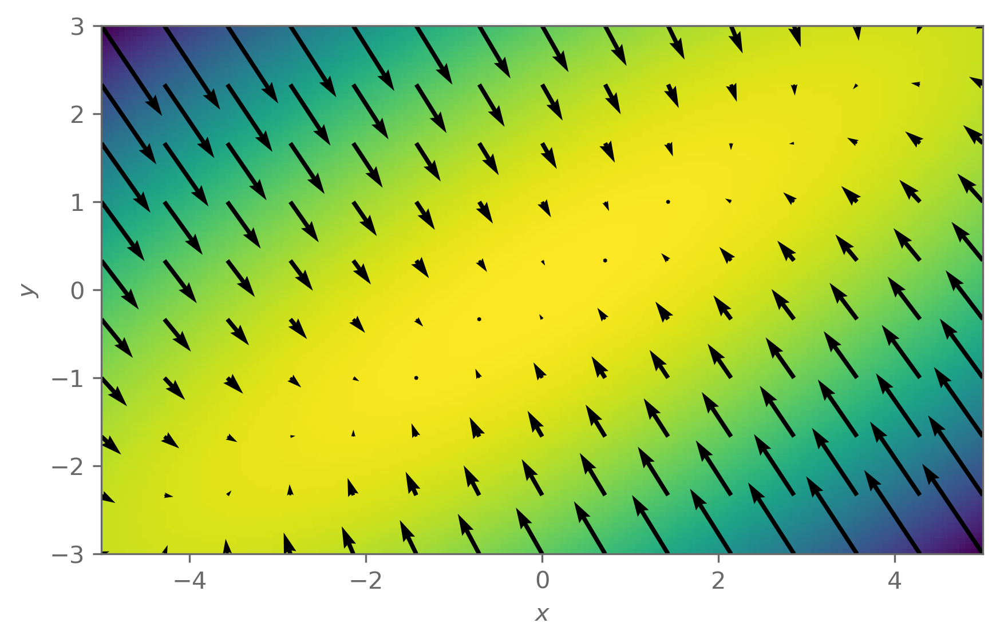

In [11]:
x_grid_fine = jnp.linspace(-5, 5, 150)
y_grid_fine = jnp.linspace(-3, 3, 100)
coords_fine = jnp.dstack(jnp.meshgrid(x_grid_fine, y_grid_fine)).reshape(-1, 2)

plt.imshow(
    vmap(log_pdf)(coords_fine).reshape(y_grid_fine.size, x_grid_fine.size),
    extent=(x_grid[0], x_grid[-1], y_grid[0], y_grid[-1]), origin="lower")
plt.quiver(*coords.T, *grads.T)
plt.xlabel("$x$")
plt.ylabel("$y$");

### Example: Fisher information of the Jovian moon data

We can use the Fisher information matrix to predict what kind of constraints we can expect from our data. For complex and computationally expensive likelihoods this is a useful to get a rough estimate of the contraints without having to run an expensive MCMC.

Let us go back to the Jovian moon example.

In [113]:
moon = "Io"
t, distance, distance_alt, distance_err = np.loadtxt(
    f"./data/jovian_moons/{moon}.dat", unpack=True)

# Use the offset between the distance estimates as an extra error
cov = np.diag(distance_err**2 + (distance-distance_alt)**2)
inv_cov = np.linalg.inv(cov)

In [114]:
def model(theta, t):
    semimajor, period, phi = theta
    return semimajor * jnp.sin(2*np.pi/period * t + phi)

def log_likelihood(theta):
    mu = model(theta, t=t)
    r = distance - mu
    return -0.5 * r @ inv_cov @ r

def log_prior(theta):
    # Use flat priors for now
    return 0

def log_posterior(theta):
    return log_likelihood(theta) + log_prior(theta)

In [115]:
theta_MAP = scipy.optimize.minimize(
    fun=lambda x: -log_posterior(x),
    jac=grad(lambda x: -log_posterior(x)),  # We can use JAX's autodifferentiation
                                            # to use gradient-based optimisation
                                            # methods.
    method="L-BFGS-B",
    x0=(1.0, 40.0, 1.0),
).x

semimajor_MAP, period_MAP, phase_MAP = theta_MAP
print("MAP results")
print(f"{semimajor_MAP=:.3f}, {period_MAP=:.3f}, {phase_MAP=:.3f}")

MAP results
semimajor_MAP=0.419, period_MAP=42.323, phase_MAP=2.912


Because we use a Gaussian likelihood with parameter-independent covariance
$$
    I_{ij}(\vec\theta) = \sum_{kl}\frac{\partial\mu_k(\vec\theta)}{\partial\theta_i}(\Sigma^{-1})_{kl}\frac{\partial\mu_l(\vec\theta)}{\partial\theta_j}
$$

In [116]:
jacobian = jacfwd(model)(theta_MAP, t)

fisher_I = np.einsum("ip,ij,js", jacobian, inv_cov, jacobian)

fisher_cov = np.linalg.inv(fisher_I)

print(f"Expected uncertainty on a: {np.sqrt(cov[0,0]):.4f}")
print(f"Expected uncertainty on T: {np.sqrt(cov[1,1]):.3f}")

Expected uncertainty on a: 0.0087
Expected uncertainty on T: 0.010


In [92]:
n_param = 3
n_walker = 10
n_step = 8000

# The starting point for each walker
theta_init = np.array([0.5, 40.0, 3.0]) \
    + 0.1*np.random.normal(size=(n_walker, n_param))

sampler = emcee.EnsembleSampler(
    nwalkers=n_walker, ndim=n_param,
    log_prob_fn=jit(vmap(log_posterior)),
    vectorize=True
)
state = sampler.run_mcmc(theta_init, nsteps=n_step, progress=True)

print("Auto-correlation time:")
for name, value in zip(["a", "T", "phi"], autocorr_time := sampler.get_autocorr_time()):
    print(f"{name} = {value:.1f}")

chain = sampler.get_chain(
    discard=int(5*max(autocorr_time)),
    thin=int(max(autocorr_time)/4),
    flat=True
)

100%|██████████| 8000/8000 [00:02<00:00, 2731.44it/s]


Auto-correlation time:
a = 51.4
T = 38.9
phi = 57.6


How does the Fisher estimate of the parameter covariance compare to the posteriors we get from a MCMC?

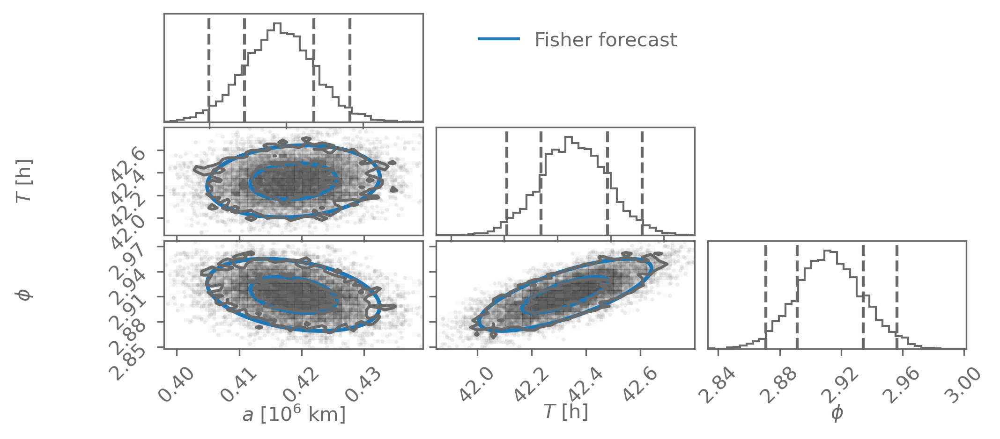

In [112]:
fig = plt.figure()
fig = corner.corner(
    chain,
    bins=40,
    labels=["$a$ [$10^6$ km]", "$T$ [h]", r"$\phi$"],
    levels=1-np.exp(-0.5*np.array([1, 2])**2),
    quantiles=[0.025, 0.16, 0.84, 0.975],
    labelpad=0.2,
    fig=fig
)
fig.subplots_adjust(bottom=0.35)

for idx, ax in zip([[0, 1], [0, 2], [1, 2]], [fig.axes[3], fig.axes[6], fig.axes[7]]):
    plot_contours(cov=fisher_cov[np.ix_(idx, idx)], pos=theta_MAP[idx], nstd=1, fill=False, ax=ax, color="C0", linewidth=2)
    plot_contours(cov=fisher_cov[np.ix_(idx, idx)], pos=theta_MAP[idx], nstd=2, fill=False, ax=ax, color="C0", linewidth=2)

fig.axes[1].plot([], [], color="C0", label="Fisher forecast")
_ = fig.axes[1].legend(frameon=False)

The Fisher information matches the posterior well. One reason is that we did not include any prior information. 



Instead of the Fisher information (which is the expectation over the Hessian of the log likelihood), we might just want to get a Gaussian approximation of the posterior.

Expand the log-posterior around the posterior mode $\vec \theta^*$:
$$
    \log p(\vec\theta | \vec d) = \log p(\vec \theta^* | \vec d) + \frac{1}{2}(\vec \theta - \vec \theta^*)_i\left(\frac{\partial^2}{\partial\theta_i\partial\theta_j}\log p(\vec \theta|\vec d)\right)_{\vec \theta=\vec \theta^*}(\vec \theta - \vec \theta^*)_j\,.
$$
The term $\propto (\vec \theta - \vec \theta^*)$ is zero at the mode.

From this expansion we see that the posterior can be approximated by 
$$
    p(\vec\theta | \vec d) \approx \Norm(\vec\theta^*, I(\vec\theta^*)^{-1})\,,
$$
where the _observed_ information $I(\vec\theta)$ is given by
$$
    I(\vec\theta) = -\frac{\partial^2}{\partial\theta_i\partial\theta_j}\log p(\vec \theta|\vec d)\,.
$$

In [101]:
# JAX makes this very easy
posterior_observed_information = -hessian(log_posterior)(theta_MAP)
posterior_covariance_estimate = np.linalg.inv(posterior_observed_information)

## Exercises

Read the JAX tutorials.

Use JAX to confirm the Fisher information for the case of a Gaussian with either fixed mean or fixed variance.

Implement one of the likelihoods you have used so far (for example from the quadratic model fit exercise) in JAX and compute the Fisher information matrix.

## Hamiltonian Monte Carlo

Hamiltonian Monte Carlo is an MCMC algorithm that scales well to high dimensions. 

The downside is that it requires the gradient of the log probability. But with JAX we can get that easily now.

Hamilton Monte Carlo casts the sampling problem as a physics problem of exploring a potential using Hamiltonian dynamics.


 
We define a Hamiltonian
$$
    H(\vec x, \vec p) = U(\vec x) + K(\vec p)
$$
with potential $U(\vec x)$ at position $\vec x$ and kinetic energy $K(\vec p) = \frac{1}{2}\vec p^T M^{-1}\vec p$ of momentum $\vec p$ with mass matrix $M$.



From this we can define a probability
$$
    p_H(\vec x, \vec p) = \frac{1}{Z}\ee^{-H(\vec x, \vec p)} = \frac{1}{Z}\ee^{-U(\vec x)}\ee^{-K(\vec p)}
$$
The positions and momenta are independent, such that the marginal distribution of $\vec x$ is
$$
    p(\vec x) \propto \ee^{-U(\vec x)}
$$
This is the distribution we want to sample from. To do this, we define $U(\vec x) = -\log p(\vec x)$.

Hamiltonian dynamics are defined by the equations of motion
\begin{align}
    \frac{\dd x_i}{\dd t} &= \frac{\partial H}{\partial p_i} \\
    \frac{\dd p_i}{\dd t} &= -\frac{\partial H}{\partial x_i} \\
\end{align}

In our case we have
\begin{align}
    \frac{\dd x_i}{\dd t} &= \frac{\partial K}{\partial p_i} = (M^{-1}\vec p)_i \\
    \frac{\dd p_i}{\dd t} &= -\frac{\partial U}{\partial x_i} \\
\end{align}


Hamiltonian Monte Carlo works as follows:

Start at $\vec x_0$.
1. Sample $\vec p_0$ from a Gaussian with mean 0 and covariance $M$: $\vec p_0\sim\Norm(0, M)$
2. Evolve $\vec x$ and $\vec p$ with the dynamics defined by the Hamiltonian using the leap frog algorithm
3. Accept the new position using a Metropolis-Hastings acceptance criterion based on the integration error of the Hamiltonian


The leap frog algorithm is a method to integrate the equation of motion to evolve the system a small amount $\epsilon$ from time $t$ to time $t+\epsilon$.

1. Evolve the momentum a half step: $\vec p_{t+\epsilon/2} = \vec p_\epsilon - \frac{\epsilon}{2}\nabla U(\vec x_t)$
2. Evolve the position by a full step: $\vec x_{t+\epsilon} = \vec x_t + \epsilon M^{-1} \vec p_{t+\epsilon/2}$
3. Evolve the momentum another half step: $\vec p_{t+\epsilon} = \vec p_{t+\epsilon/2} - \frac{\epsilon}{2}\nabla U(\vec x_{t+\epsilon})$

Repeat this for $L$ steps to move from the state $\vec x_\mathrm{old}, \vec p_\mathrm{old}$ to $\vec x_\mathrm{new}, \vec p_\mathrm{new}$.


Then accept the new state $\vec x_\mathrm{new}, \vec p_\mathrm{new}$ with probability
$$
    a = \min\left(1, \frac{\ee^{-H(\vec x_\mathrm{new}, \vec p_\mathrm{new})}}{\ee^{-H(\vec x_\mathrm{old}, \vec p_\mathrm{old})}}\right)\,.
$$

If the equations of motions are solved exactly, the Hamiltonian is be conserved, and the acceptance probability is always be 1.

In practice, we get an integration error, which depends on the step size $\epsilon$ and number of steps $L$. These are the main tuning parameters.



For the integration to be stable, $\epsilon$ needs to be smaller than the smallest length scale in the distribution we want to sample.

The number of steps should be chosen such that $L\epsilon$ is long enough to cover the longest length scale.

In addition, the mass matrix $M$ can be chosen to align the momenta better with the shape of the distribution.

In [5]:
def sample_hmc(x0, log_pdf, n, L, epsilon, mass_matrix, key):

    mass_matrix_inv = jnp.linalg.inv(mass_matrix)

    # Define the potential and Hamiltonian
    def U(x):
        return -log_pdf(x)

    def H(x, p):
        return U(x) + 0.5 * p @ mass_matrix_inv @ p

    # Use JAX to get the gradient of U
    grad_x_U = grad(U)

    # The leap frog integrator. We speed this up using just-in-time compilation
    @jit
    def leap_frog(x, p):
        t = [x]
        for _ in range(L):
            p_prime = p - epsilon/2 * grad_x_U(x)
            x = x + epsilon * mass_matrix_inv @ p_prime
            p = p_prime - epsilon/2 * grad_x_U(x)
            t.append(x)
        return x, p, jnp.array(t)
    
    samples = [x0]
    trajectories = []
    n_accpeted = 0
    for _ in range(n):
        key, subkey = jax.random.split(key)
        # Sample a new momentum
        p0 = jax.random.multivariate_normal(
            subkey, mean=jnp.zeros_like(x0), cov=mass_matrix
        )
        # Integrate Hamiltonian dynamics
        x, p, t = leap_frog(x0, p0)

        # Metropolis-Hastings step
        a = min(1, jnp.exp(H(x0, p0) -  H(x, p)))

        key, subkey = jax.random.split(key)
        u = jax.random.uniform(subkey)
        if a >= u:
            x0 = x
            n_accpeted += 1
        
        samples.append(x0)
        trajectories.append(t)
    
    acceptance_rate = n_accpeted/n
    return jnp.array(samples), trajectories, acceptance_rate

In [23]:
# Setup our PRNG keys
key, subkey = jax.random.split(jax.random.PRNGKey(42))

samples, trajectories, acceptance_rate = sample_hmc(
    x0=jnp.array([0.0, 2.0]),
    log_pdf=log_pdf,
    n=30,
    L=20, epsilon=0.2, mass_matrix=jnp.eye(2),
    key=subkey
)
print(f"Acceptance rate: {acceptance_rate:.3f}")

Acceptance rate: 0.967


In [22]:
from matplotlib.collections import LineCollection
from matplotlib.animation import ArtistAnimation
from IPython.display import HTML

fig, ax = plt.subplots()

levels = 1-np.exp(-0.5*np.array([1, 2])**2)

def pdf(x):
    return jnp.exp(log_pdf(x))

ax.contour(
    vmap(pdf)(coords_fine).reshape(y_grid_fine.size, x_grid_fine.size)/pdf(mean),
    extent=(x_grid[0], x_grid[-1], y_grid[0], y_grid[-1]), origin="lower",
    levels=(1-levels)[::-1], colors="grey", linewidths=1)

ax.set_xlim(-5, 5)
ax.set_ylim(-3, 3)
ax.set_xlabel("$x$")
ax.set_ylabel("$y$")

trail_length = 10
alpha = np.linspace(0.0, 1, trail_length)[::-1]

artists = []

sample_points = []

for s, t in zip(samples, trajectories):
    sample_points += ax.plot(*s, marker="o", ms=3, c="C3")

    for i in range(t.shape[0]+trail_length//2):
        trail = t[max(0, i-trail_length): min(i, t.shape[0])]
        n = trail.shape[0]
        colors = np.zeros((n, 4))
        colors[:, 3] = alpha[:n][::-1]

        points = trail.reshape(-1, 1, 2)
        segments = np.concatenate([points[:-1], points[1:]], axis=1)
        collection = LineCollection(segments, colors=colors)
        
        artists.append(sample_points + [ax.add_collection(collection)])
    
hmc_sampling_ani = ArtistAnimation(fig, artists=artists, interval=70, blit=True)
plt.close()
# HTML(hmc_sampling_ani.to_jshtml())
hmc_sampling_ani.save(filename="../hmc.webp", writer="pillow")

![hmc](../assets/hmc.webp)

The tuning steps are important but can be tedious. Mature implemetations, such as the no-U-turn algorithm (NUTS) with automatic tuning are available.

Here is an implementation in `tensorflow_probability`. This works without the need for `tensorflow` thanks to the JAX backend.

In [167]:
import tensorflow_probability.substrates.jax as tfp

num_results = 2000
num_burnin_steps = 1000

# Set the adaptation strategy...
adaptive_hmc = tfp.mcmc.DualAveragingStepSizeAdaptation(
    # ... for the sampler, which is NUTS here
    tfp.mcmc.NoUTurnSampler(
        target_log_prob_fn=jax.jit(jax.vmap(log_pdf)), # The target distribution
        step_size=1.),
    num_adaptation_steps=int(num_burnin_steps * 0.8) # How many steps to use for tuning
)

In [168]:
def run_chain(seed):
    # Run the chain (with burn-in).
    samples, info = tfp.mcmc.sample_chain(
        num_results=num_results,
        num_burnin_steps=num_burnin_steps,
        current_state=jnp.array([0.0, 0.0]), 
        kernel=adaptive_hmc,
        trace_fn=lambda _, pkr: (pkr.inner_results.target_log_prob, pkr.inner_results.is_accepted),
        seed=seed
    )

    log_prob, is_accepted = info
    print(f"Acceptance rate: {is_accepted.sum()/is_accepted.size}")
    return samples, log_prob

samples, log_prob = run_chain(seed=jax.random.PRNGKey(42))

Acceptance rate: 0.8647500276565552


## Exercises

Implement HMC yourself. 

Experiment with the step size, number of steps, and mass matrix.

Try an implementation of NUTS, for example the one in tensorflow probability shown earlier.

In [18]:
import numpy as np
import scipy.stats

import jax.numpy as jnp
from jax import jit, vmap, grad
import jax.random

import matplotlib.pyplot as plt

import warnings
warnings.simplefilter("ignore")

In [19]:
title = "# Simulation-based inference"
# Print title and setup TeX defs for both KaTeX and MathJax
import bayesian_stats_course_tools
bayesian_stats_course_tools.misc.display_markdown_and_setup_tex(title)

import matplotlib.style
matplotlib.style.use("bayesian_stats_course_tools.light")

# Simulation-based inference

<!-- Define LaTeX macros -->
$\def\E{\operatorname{E}}$
$\def\Var{\operatorname{Var}}$
$\def\Cov{\operatorname{Cov}}$
$\def\dd{\mathrm{d}}$
$\def\ee{\mathrm{e}}$
$\def\Norm{\mathcal{N}}$
$\def\Uniform{\mathcal{U}}$

<!-- MathJax needs them to be defined again for the non-inline environment -->
$$\def\E{\operatorname{E}}$$
$$\def\Var{\operatorname{Var}}$$
$$\def\Cov{\operatorname{Cov}}$$
$$\def\dd{\mathrm{d}}$$
$$\def\ee{\mathrm{e}}$$
$$\def\Norm{\mathcal{N}}$$
$$\def\Uniform{\mathcal{U}}$$

## Simulation-based inference

If our data generating process is complex, we might not be able to write down a likelihood density function that computes the probability of the data given the parameters.



We can usually still sample data realisations from this likelihood by building a forward model or simulator that reproduces the data-generating process.

- For a given $x$ and $\theta$, we cannot compute the density $p(x|\theta)$
- But we can sample $x_i|\theta\sim p(\cdot|\theta)$



In simulation-based inference we make posterior inference using only the data-generating process, without evaluating likelihood functions.


## Approximate Bayesian computation (ABC)

The simplest implementation is rejection ABC.

1. Sample $\theta_i$ from the prior
2. Generate $y^\mathrm{rep}_i$ from the forward model, based on $\theta_i$
3. Accept $\theta_i$ if some distance metric $d(y, y^\mathrm{rep}_i)$ between $y$ and $y^\mathrm{rep}_i$ is smaller than a threshold $\epsilon$

For an in-depth review of ABC, see for example [Sisson et al. 2018](https://doi.org/10.1201/9781315117195).

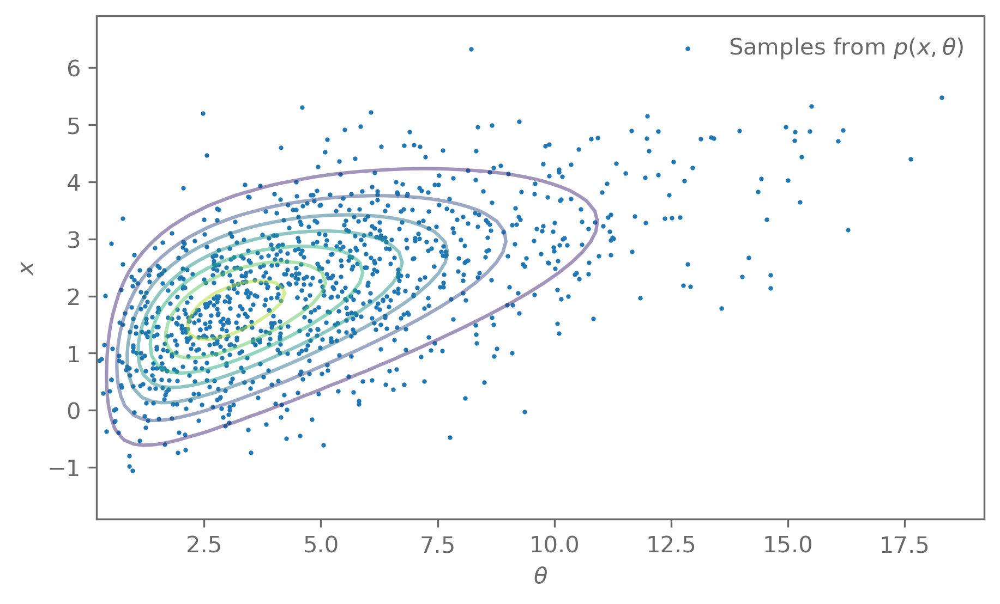

In [21]:
prior_distr = scipy.stats.chi2(df=5)

def likelihood_distr(theta):
    return scipy.stats.norm(loc=np.sqrt(theta), scale=1)

def joint_pdf(theta, x):
    joint_pdf = prior_distr.pdf(theta) * likelihood_distr(theta).pdf(x)
    return joint_pdf

n = 1000
theta_samples = prior_distr.rvs(n)
x_samples = likelihood_distr(theta_samples).rvs(n)

theta_grid = np.linspace(0.1, 15, 75)
x_grid = np.linspace(-2, 7, 50)
coords = np.dstack(np.meshgrid(theta_grid, x_grid)).reshape(-1, 2)

joint_grid = np.array([joint_pdf(*c) for c in coords]).reshape(x_grid.size, theta_grid.size)
fig, ax = plt.subplots()

ax.scatter(theta_samples, x_samples, s=1, label=r"Samples from $p(x, \theta)$")
ax.contour(joint_grid, origin="lower", alpha=0.5,
              extent=(theta_grid[0], theta_grid[-1], x_grid[0], x_grid[-1]))
ax.set_xlabel(r"$\theta$")
ax.set_ylabel(r"$x$")
_ = ax.legend()


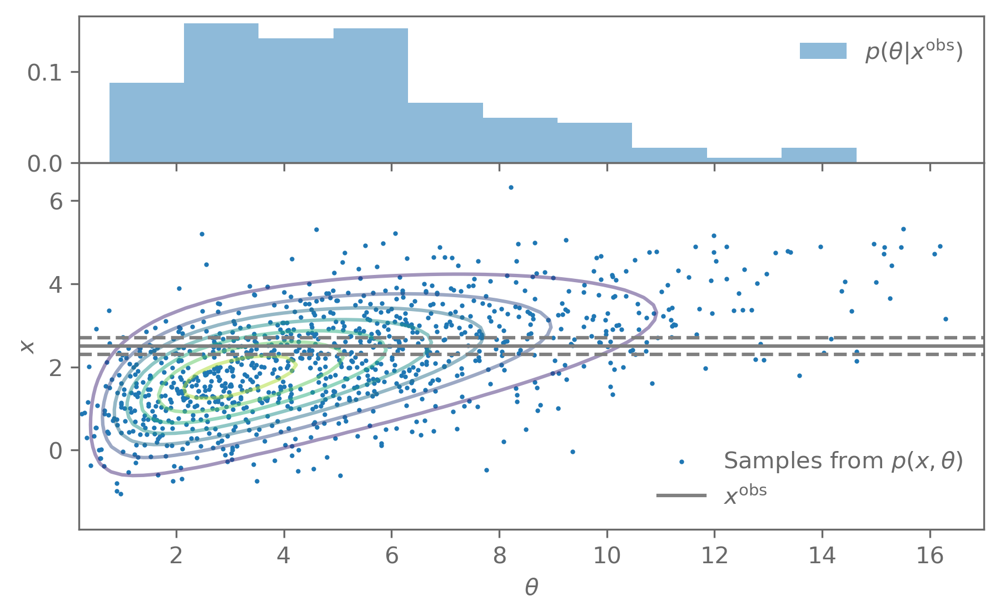

In [23]:
fig, ax = plt.subplots(
    2, 1, sharex="col",
    # figsize=(7, 5),
    gridspec_kw=dict(
        height_ratios=[0.4, 1.0],
        wspace=0, hspace=0
    )
)

ax[1].scatter(theta_samples, x_samples, s=1, label=r"Samples from $p(x, \theta)$")
ax[1].contour(joint_grid, origin="lower", alpha=0.5,
              extent=(theta_grid[0], theta_grid[-1], x_grid[0], x_grid[-1]))

x_true = 2.5
epsilon = 0.2

ax[1].axhline(x_true, color="grey", label=r"$x^\mathrm{obs}$")
ax[1].axhline(x_true-epsilon, color="grey", ls="--")
ax[1].axhline(x_true+epsilon, color="grey", ls="--")
ax[1].set_xlim(right=17)
ax[0].hist(theta_samples[np.abs(x_samples-x_true) < epsilon],
           density=True, alpha=0.5, label=r"$p(\theta|x^\mathrm{obs})$")

ax[1].set_xlabel(r"$\theta$")
ax[1].set_ylabel(r"$x$")
ax[1].legend()
ax[0].legend();

### Clicker

In rejection Approximate Bayesian Computation (ABC), if we choose a very small tolerance level $\epsilon$, which of the following consequences is most likely?
- Higher acceptance rate, leading to a more accurate posterior
- The approximation to the posterior will be poor regardless of sample size
- The approximation will perfectly match the true posterior
- Lower acceptance rate, increasing the computational cost, but more accurate posterior

- If $\epsilon$ is chosen too small, the acceptance rate will be low
- If $\epsilon$ is chosen too large, the approximation to the posterior will be poor
- If the dimensionality of the data is large, we are hit with the curse of dimensionality and the acceptance rate will be very low.
    - To combat this, usually summary statistics are used. If these summary statistics are not sufficient statistics (capturing all the information of the data), then some information will be lost

Number of accepted samples for 𝜖 = 0.1: 509/10000
Number of accepted samples for 𝜖 = 1.5: 6484/10000


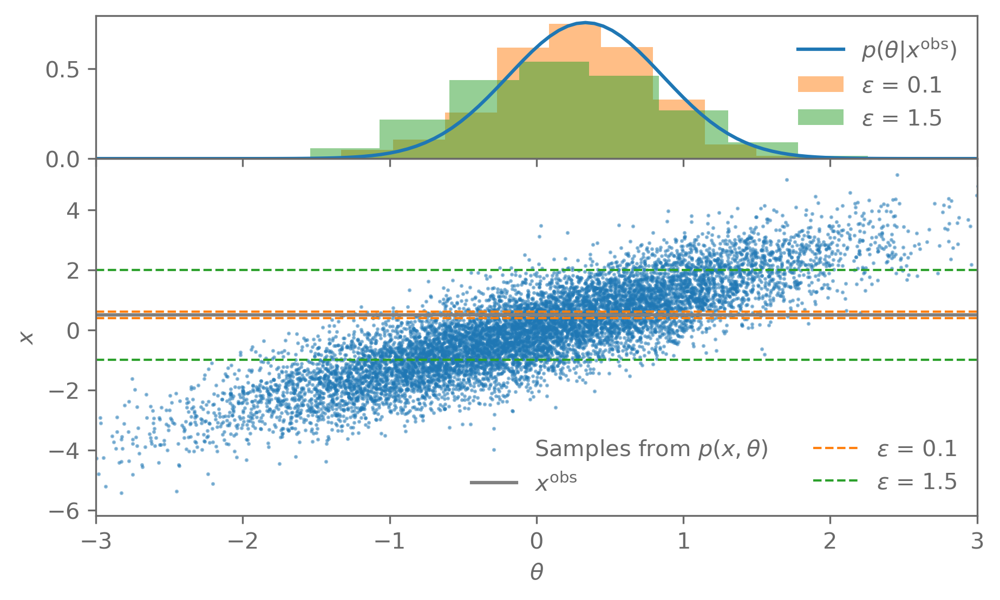

In [93]:
# Define variances and correlation
sigma_x = 1.5
sigma_theta = 1
rho = 0.85

mu_x = 0
mu_theta = 0
# Define mean and covariance
mean = np.array([mu_x, mu_theta])
cov = np.array([[sigma_x**2, sigma_x*sigma_theta*rho],
                 [sigma_x*sigma_theta*rho, sigma_theta**2]])
joint_distr = scipy.stats.multivariate_normal(mean=mean, cov=cov)

x_obs = 0.5

distr_theta_cond_x_obs = scipy.stats.norm(
    loc=mu_theta + sigma_theta/sigma_x*(x_obs-mu_x),
    scale=np.sqrt((1-rho**2)*sigma_theta**2)
)

samples = joint_distr.rvs(10000)
samples = samples[:, ::-1]

fig, ax = plt.subplots(
    2, 1, sharex="col",
    # figsize=(7, 5),
    gridspec_kw=dict(
        height_ratios=[0.4, 1.0], hspace=0
    )
)

theta_grid = np.linspace(-3, 3, 100)
ax[0].set_xlim(-3, 3)

ax[0].plot(theta_grid, distr_theta_cond_x_obs.pdf(theta_grid), label=r"$p(\theta|x^\mathrm{obs})$")

ax[1].scatter(*samples.T, s=0.5, alpha=0.5, label=r"Samples from $p(x, \theta)$")

ax[1].axhline(x_obs, color="grey", label=r"$x^\mathrm{obs}$")

for i, epsilon in enumerate([0.1, 1.5]):
    selection = np.abs(samples[:,1]-x_obs) < epsilon
    print(f"Number of accepted samples for 𝜖 = {epsilon}: {selection.sum()}/{len(selection)}")
    ax[0].hist(
        samples[selection, 0],
        density=True, alpha=0.5, color=f"C{i+1}", #histtype="step",
        label=r"$\epsilon$ = " + f"{epsilon}")

    ax[1].axhline(x_obs-epsilon, color=f"C{i+1}", ls="--", lw=1,
                  label=r"$\epsilon$ = " + f"{epsilon}")
    ax[1].axhline(x_obs+epsilon, color=f"C{i+1}", ls="--", lw=1)

ax[1].set_xlabel(r"$\theta$")
ax[1].set_ylabel(r"$x$")
ax[1].legend(ncols=2)
ax[0].legend();

## Neural density estimation

Often the simulators are expensive to run and producing samples from the likelihood or posterior is expensive.

The idea of (conditional) density estimation is to estimate a probability density function that approximates the true distribution that the samples came from.



We want to fit an approximate distribution $q_\phi(x)$, which is parametrised by $\phi$.


The optimisation objective is often the Kullback-Leibler (KL) divergence
$$
    D_\mathrm{KL}(p \| q) = \int p(x)\log\frac{p(x)}{q(x)}\dd x
$$
between the true distribution $p$ and our approximation $q$.

The KL divergence measures how well the two distributions agree:
- $D_\mathrm{KL}(p \| q) = 0$ when the distributions agree
- $D_\mathrm{KL}(p \| q) \geq 0$ in general
- Not symmetric
- Mutual information $I(X, Y) = D_\mathrm{KL}(p(X, Y) \| p(X)p(Y))$


We want to fit an approximate distribution $q_\phi(x)$, which is parametrised by $\phi$.

$$
    D_\mathrm{KL}(p \| q_\phi) = \E_p\left[\log\frac{p(x)}{q_\phi(x)}\right] \\
    = \E_p\left[-\log q_\phi(x)\right] + \underbrace{\E_p\left[\log p(x)\right]}_{\text{does not depend on } q_\phi}
$$



The second term $\E_p\left[\log p(x)\right]$ does not depend on $\phi$, so it can be ignored when optimising:
$$
    \phi^* = \underset{\phi}{\mathrm{argmin}}\ D_\mathrm{KL}(p \| q_\phi)  =\underset{\phi}{\mathrm{argmin}}\  \E_p\left[-\log q_\phi(x)\right]
$$



Given samples $x_i \sim p$ from the target distribution, the loss function for the optimisation is then
$$
    L(\phi) = \E_p\left[-\log q_\phi(x)\right] \approx -\frac{1}{n}\sum_i \log q_\phi(x_i)
$$

In [100]:
# We will use tensorflow probability wit JAX
import tensorflow_probability.substrates.jax as tfp
tfd = tfp.distributions

# Define a Gaussian mixture model
# We use logits (log of probabilities) and log of standard deviations as 
# parameters to make optimisation easier
def gmm(logits, means, log_stds):
    distr = tfd.MixtureSameFamily(
        mixture_distribution=tfd.Categorical(logits=logits),
        components_distribution=tfd.Normal(loc=means, scale=jnp.exp(log_stds))
    )
    return distr

# Put in some test parameters
mixture = gmm(
    logits=jnp.log(jnp.array([0.5, 0.7])),
    means=jnp.array([0.0, 2.0]),
    log_stds=jnp.log(jnp.array([0.3, 0.7])),
)

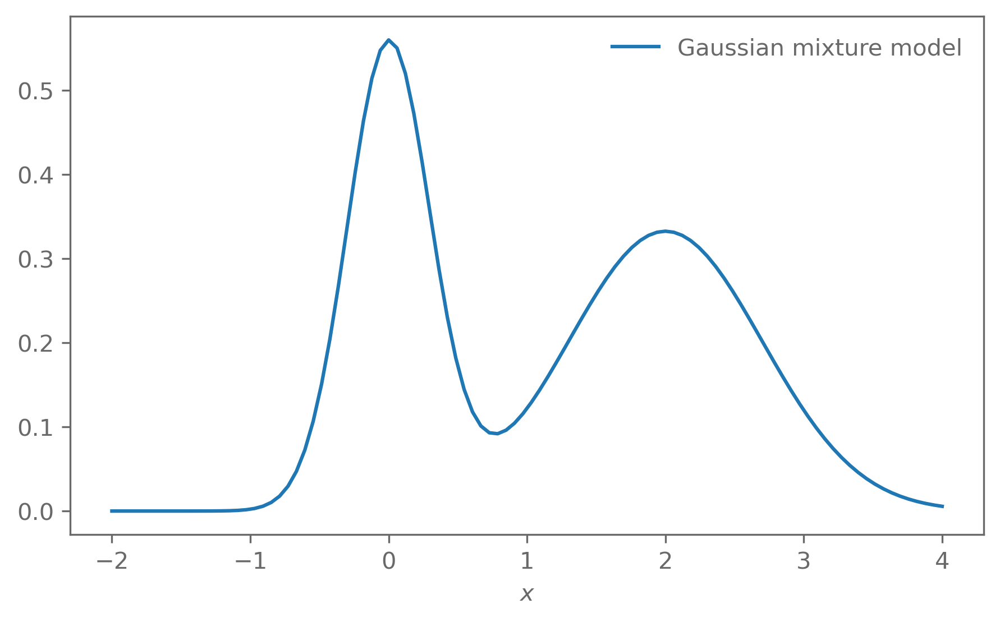

In [101]:
x = np.linspace(-2, 4, 100)
plt.plot(x, mixture.prob(x), label="Gaussian mixture model")
plt.xlabel("$x$")
plt.legend();

Let us now fit a distribution.

In [105]:
target_distr = scipy.stats.gamma(a=3, scale=1/3)
target_distr_samples = target_distr.rvs(1000)

In [106]:
import jaxopt

# Define the loss function
def loss_fn(params):
    variational_distr = gmm(**params)
    loss = jnp.mean(-variational_distr.log_prob(target_distr_samples))
    return loss

key, *subkeys = jax.random.split(jax.random.PRNGKey(42), 4)

# We will use a 5-component Gaussian mixture model
n_components = 5
theta_init = dict(
    logits=jax.random.normal(key=subkeys[0], shape=(n_components,)),
    means=jax.random.normal(key=subkeys[1], shape=(n_components,)),
    log_stds=jax.random.normal(key=subkeys[2], shape=(n_components,)),
)

# Fit the model
solver = jaxopt.ScipyMinimize(fun=jit(loss_fn))
solution = solver.run(theta_init)

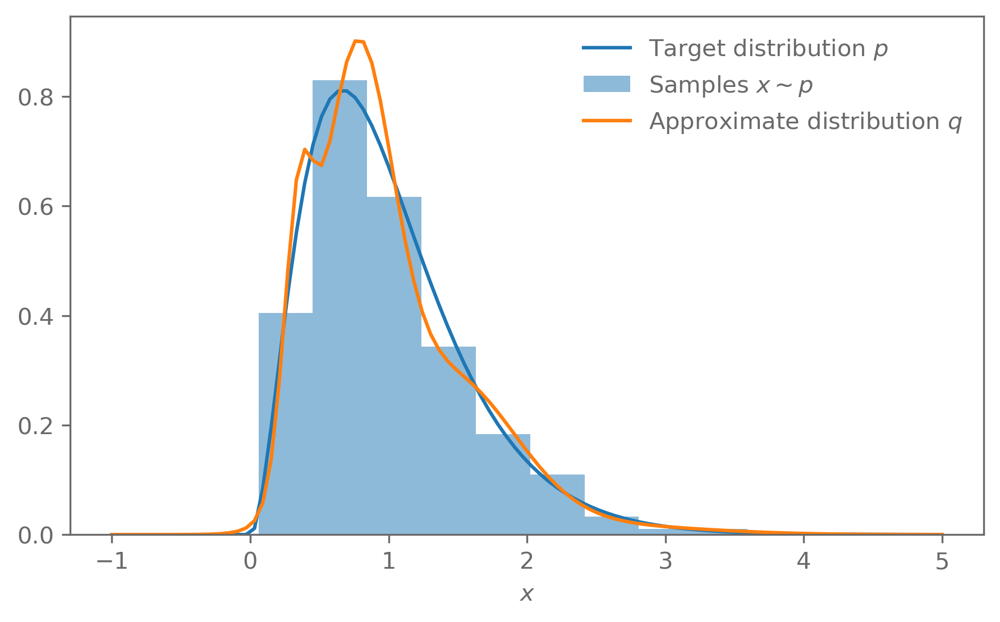

In [111]:
x = np.linspace(-1, 5, 100)
plt.plot(x, target_distr.pdf(x), label="Target distribution $p$")
plt.hist(target_distr_samples, density=True, alpha=0.5, color="C0", label="Samples $x\sim p$")
plt.plot(x, gmm(**solution.params).prob(x), color="C1", label="Approximate distribution $q$")
plt.legend()
plt.xlabel("$x$");

Once we have fit $q_\phi$ we can use it to create new samples very quickly.

We can also do conditional density estimation by defining a function that first maps $x$ to the parameters $\phi$ of our approximate distribution.

If we use a neural network for that mapping from $x$ to $\phi$ and/or to define flexible distributions, we talk about (conditional) neural density estimation.


When used to approximate the likelihood $p(x|\theta)$, this is called neural likelihood estimation.
- Once we have the approximate likelihood $q_\phi(x|\theta)$, we can continue to our usual Bayesian workflow with sampling the posterior, since now we have a likelihood where we can compute the density.



When used to approximate the posterior $p(\theta|x)$ directly, this is call neural posterior estimation.
- This has the advantage that once we have found $q_\phi(\theta|x)$, we can reuse this for many different observations $x^\mathrm{obs}$ without having to run an MCMC.
- If we change the priors, we need to redo the process, however.



Neural density estimation is often amortised: after creating the training set of pairs of $(\theta_i, x_i)$ and fitting the approximate distribution $q_\phi$, we can do inference very quickly for different observed data and parameters.

In contrast, ABC is not amortised: the posterior we estimate is specific to a single observation and everything needs to be redone for different observations.

### Further resources

A python package that implements a number of simulation-based inference algorithms (using pytorch) is [sbi](https://www.mackelab.org/sbi/).

A brief overview of recent developments [Cranmer et al. 2020](10.1073/pnas.1912789117) and some discussion on when things can go wrong [Hermans et al. 2022](https://arxiv.org/abs/2110.06581).

## Exercises

Try rejection ABC on the linear-fit example. Think about what distance metric you want to use, since the data vector is now multidimensional.


## Loss functions and posteriors

### A (very) quick intro to machine learning and neural networks

Machine learning is fundamentally about finding pattern in data. 

There are different flavours of machine learning, today we focus on supervised learning.

In supervised learning, we have 
- a training set $D = \{x_i, y_i\}$ of pairs of inputs $x_i$ and outputs $y_i$,
- a function $f_\theta(x)$ with parameters $\theta$, such that $y = f_\theta(x) + \epsilon$, where $\epsilon$ is some noise.



We want to predict the outputs $y^*$ for inputs $x^*$ not in the training set:  $p(y^* | x^*, x, y)$.

The input-output pairs can be anything: from 1D points $x$ and $y$ that we model with linear regression to assigning labels to images:
- $x_i$ = <img style="display:inline; vertical-align:middle; height: 4em" src="../assets/cat_small.jpg">, 
    $y_i$ = "cat"
- $x_j$ = <img style="display:inline; vertical-align:middle; height: 4em" src="../assets/dog_small.jpeg">, 
    $y_j$ = "dog"
- etc


The distribution over outputs from unseen inputs $p(y^* | x^*, x, y)$ is just the posterior predictive distribution that we have seen and used before:
$$
    p(y^* | x^*, x, y) = \int p(y^* | x^*,\theta)p(\theta | x, y)\dd \theta\,,
$$
where $\theta$ are the parameters of the function $f_\theta$.


The direct Bayesian approach we learned is: 
- define likelihood $p(y | x,\theta)$ and prior $p(\theta|x)$
- sample posterior $\theta_i \sim p(\cdot | x, y)$
- sample prediction from likelihood $y_i^* \sim p(\cdot| x^*, \theta_i)$.



In machine learning, especially deep learning, $f_\theta(x)$ can be very complex:
- <span style="font-size: x-large"> f<sub>θ</sub>(<img style="display:inline; vertical-align:middle; height: 3em" src="../assets/cat_small.jpg">)</span> = "cat"
- <span style="font-size: x-large"> f<sub>θ</sub>(<img style="display:inline; vertical-align:middle; height: 3em" src="../assets/dog_small.jpeg">)</span> = "dog"

The function $f_\theta(x)$ can have millions or billions of parameters $\theta$. Not even Hamilton Monte Carlo will help you there.




In machine learning, the problem is therefore usually phrased as an optimisation problem where we want to minimise some loss function $L(x, y, \theta)$ such that the differences between the training outputs $y_i$ and $f_\theta(x_i)$ is minimised.

Common loss functions for regression are
- $L_2$ loss: $L(x, y, \theta) = \|f_\theta(x) - y\|^2$
- $L_1$ loss: $L(x, y, \theta) = \|f_\theta(x) - y\|$


To find $f_\theta(x)$, we minimise the expectation of the loss function over the (training) data distribution $p(x, y)$:
$$
    \theta^* = \underset{\theta}{\mathrm{argmin}} \E_{p(x,y)}\left[L(x,y,\theta)\right]\,.
$$

Or for a finite training set ${x_i, y_i}$, $i=1,\dots,n$:
$$
    \theta^* = \underset{\theta}{\mathrm{argmin}} \frac{1}{n}\sum_i^n L(x_i,y_i,\theta)\,.
$$


How does the choice of the loss function affect what kind of function $f_\theta(x)$ we get? And how does it relate to our Bayesian distributions?

Let us look at this (very simple) dataset of points $(x_i, y_i)$ drawn from some (unknown) distribution $p(x, y)$.

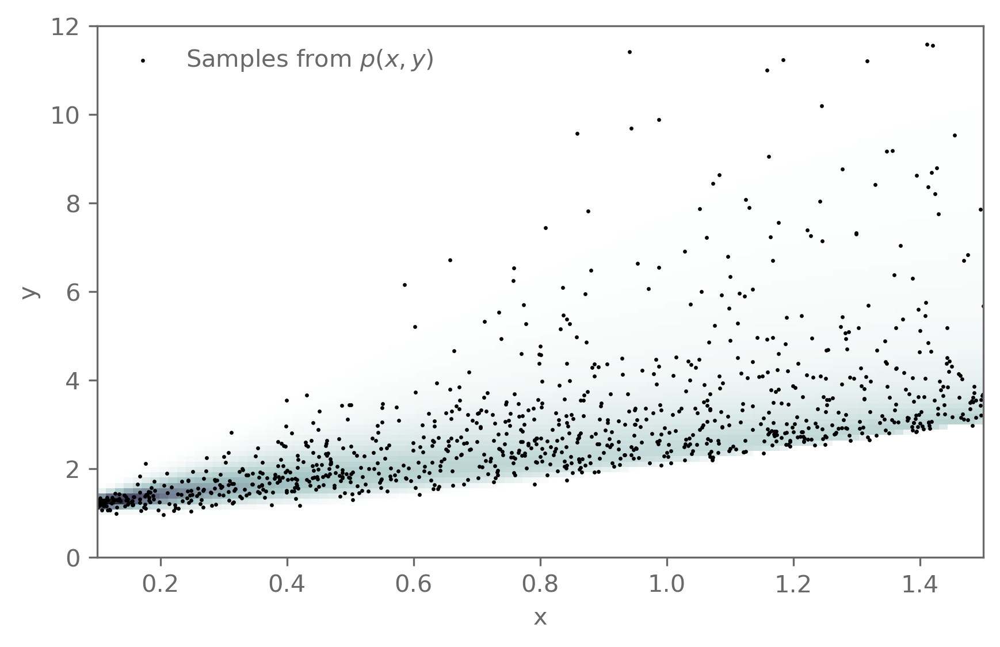

In [24]:
def distr(x):
    d =  scipy.stats.lognorm(s=x, loc=2*x)
    # Patch in mode method for log-normal distribution
    def mode(x=x):
        return np.exp(-x**2) + 2*x
    d.mode = mode
    return d  

x = np.random.uniform(0.1, 1.5, size=1000)
y = distr(x).rvs()

fig, ax = plt.subplots(1, 1)
ax.scatter(x, y, s=0.4, color="black", label="Samples from $p(x, y)$")

x_grid = np.linspace(0.1, 1.5, 100)

ax.legend(frameon=False)

y_grid = np.linspace(0, 12, 100)
pdf_grid = distr(x_grid).pdf(y_grid[:,None])
ax.imshow(
    pdf_grid,
    origin="lower",
    extent=(min(x_grid), max(x_grid), min(y_grid), max(y_grid)),
    cmap="bone_r"
)
ax.set_aspect(0.07)

ax.set_xlabel("x")
ax.set_ylabel("y");

### Clicker

If we use the $L_2$ to fit a function $f_\theta: x\rightarrow y$ on the training set $(x_i, y_i)$, what kind of function will we get?
- The mean of $p(y|x)$
- The mode (most likely value) of $p(y|x)$
- The median of $p(y|x)$
- The variance of $p(y|x)$

We want to find a function $f_\theta(x)$ that best describes the relationship between $x$ and $y$.

If we have no physical model, we can use a general, flexible function. The more complex the data is, the more flexible the function needs to be.

One way to define very flexible functions is using artifical neural networks.


The output $\vec y$ is computed from the input $\vec x$ as
\begin{align*}
    \vec h^{(1)} &= \sigma( W^{(1)}\vec x + \vec b^{(1)}) \\
    \vec h^{(2)} &= \sigma( W^{(2)}\vec h^{(1)} + \vec b^{(2)}) \\
    \dots \\
    \vec h^{(L)} &= \sigma( W^{(L)}\vec h^{(L-1)} + \vec b^{(L)}) \\
    \vec y &= W^{(L+1)}\vec h^{(L)} + \vec b^{(L+1)}\,.
\end{align*}

The hidden layers $\vec h^{(i)}$ are computed by first linearly transforming the input using the weight matrices $W^{(i)}$ and biases $\vec b^{(i)}$ and then applying a _non-linear_ activation function $\sigma(\cdot)$.

This is repeated for $L$ layers, where the hidden layer $\vec h^{(i)}$ is used as input compute the next layer $\vec h^{(i+1)}$.

At the end, there is a final function to map $\vec h^{(L)}$ to the output $\vec y$.

This is a very powerful way to define flexible functions. 

The universal approximation theorems state that if the activation function $\sigma(\cdot)$ is non-polynomial and the network is sufficiently large, then such a neural network can approximate _any_ function.

For our example, we use a fully-connected (or dense) neural network.

Fully-connected means that the weights $W^{(i)}$ are matrices $W^{(i)} \in \mathbb{R}^{n\times m}$ that connect all inputs to a layer to all its outputs. 

Other neural network architecures, for example convolutional neural networks, connect subsets of the layer inputs to the outputs.


For an introduction to deep learning in JAX, have a look at the very extensive lectures from the University of Amsterdam:
https://uvadlc-notebooks.readthedocs.io/en/latest/tutorial_notebooks/JAX/tutorial2/Introduction_to_JAX.html#

For our example, we implement a neural network using JAX and the `flax` library.

In [9]:
import flax.linen as nn

# Define a two-layer multilayer perceptron (MLP)
class MLP(nn.Module):
    n_hidden: int = 128  # Size of hidden layer dimension
    n_output: int = 1    # Size of output dimension

    @nn.compact
    def __call__(self, x):
        x = nn.Dense(features=self.n_hidden)(x)
        x = nn.swish(x)  # We use the swish activation function
        x = nn.Dense(features=self.n_hidden)(x)
        x = nn.swish(x)
        x = nn.Dense(features=self.n_output)(x)
        return x

We train the network using the $L_2$ loss:
$$
    L_2(x, y, \theta) = \|y - f_\theta(x)\|^2\,.
$$
This corresponds to least-squares if with homoscedastic errors.

In [17]:
def L2_loss_fn(params, model, x, y):
    predictions = model.apply(params, x)

    mse = (predictions - y)**2
    return jnp.mean(mse)

To optimise the parameters $\theta$ (which consist of the weights and biases $W^{(l)}$ and biases $\vec b^{(l)}$), we use (stochastic) gradient descent.

In gradient descent, we compute the loss on our training set $D = \{x_i, y_i\}$:
$$
    L(D, \theta) = \frac{1}{n}\sum_i L(x_i, y_i, \theta) \,.
$$

We then update the parameters using the gradient of the loss:
$$
    \theta \rightarrow \theta -\gamma\nabla_\theta L(D,\theta)\,,
$$
where $\gamma$ is the _learning rate_. This process is repeated until convergence.



Because the size of training data can be very large in practice, instead of minimising the expected loss over all $n$ training points $\{x_i, y_i\}$, we compute the gradient only on batches $B_i$ of the training data. A batch $B_i \subset D$ is a subset of the training data.
$$
    \theta \rightarrow \theta -\gamma\nabla_\theta L(B_i,\theta)\,.
$$
This is repeated for all batches. This is called stochastic gradient descent, because it replaces the loss over the whole data set $L(D, \theta)$ with a noisy approximation $L(B_i,\theta)$.

In [11]:
import optax
import tqdm

# Get n samples from our target distribution
def get_batch(n=64):
    x = np.random.uniform(0.1, 1.5, size=(n, 1))
    y = distr(x).rvs()
    return x, y


def train(model, loss_fn, n_iter, seed):
    # Initialise the model
    x, y = get_batch()
    params = model.init(seed, x)

    # Set up the optimiser. Here we use Adam, which is a variant of 
    # stochastic gradient descent
    optimizer = optax.adam(learning_rate=0.001)
    opt_state = optimizer.init(params)

    # This function takes care of applying the parameters with the gradients
    @jax.jit
    def update_model(params, opt_state, x, y):
        # Computes the gradients of the model
        loss, grads = jax.value_and_grad(loss_fn)(params, model, x, y)

        # Computes the weights updates and apply them
        updates, opt_state = optimizer.update(grads, opt_state)
        params = optax.apply_updates(params, updates)

        return params, opt_state, loss

    # Now run the actual optimisation
    progress = tqdm.tqdm(range(n_iter))
    for i in progress:
        # Get a batch of data
        x, y = get_batch(n=1024)

        # Apply the update function
        params, opt_state, loss = update_model(params, opt_state, x, y)

        # Print the current loss
        progress.set_postfix({"loss": loss})
    
    return params, loss

Define our model for the function $f_\theta(x)$ (the neural network) and train it using the $L_2$ loss:

In [25]:
model = MLP()

params, loss = train(model, L2_loss_fn, n_iter=1000, seed=jax.random.PRNGKey(42))
L2_trained_model = model.bind(params)

100%|██████████| 1000/1000 [00:05<00:00, 192.63it/s, loss=5.672119] 


Let us to the same thing for the $L_1$ loss:

In [27]:
def L1_loss_fn(params, model, x, y):
    predictions = model.apply(params, x)

    return jnp.mean(jnp.abs(predictions - y))

params, loss = train(model, L1_loss_fn, n_iter=1000, seed=jax.random.PRNGKey(42))
L1_trained_model = model.bind(params)

100%|██████████| 1000/1000 [00:04<00:00, 201.16it/s, loss=1.3839406]


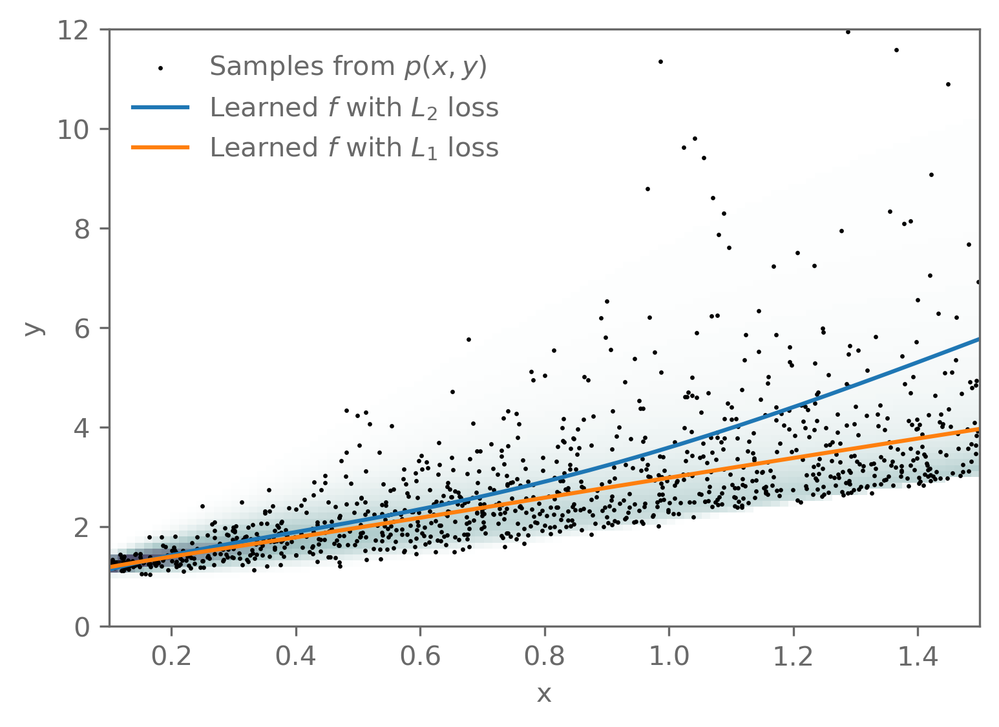

In [14]:
x_test = jnp.linspace(0.1, 1.5, 30)

L1_predictions_test = L1_trained_model(x_test[:, None])
L2_predictions_test = L2_trained_model(x_test[:, None])

fig, ax = plt.subplots(1, 1)
ax.scatter(x, y, s=0.4, color="black", label="Samples from $p(x, y)$")

ax.plot(x_test, L2_predictions_test, ls="-", c="C0", label="Learned $f$ with $L_2$ loss")
ax.plot(x_test, L1_predictions_test, ls="-", c="C1", label="Learned $f$ with $L_1$ loss")

ax.legend(frameon=False)

x_grid = np.linspace(0.1, 1.5, 100)
y_grid = np.linspace(0, 12, 100)
pdf_grid = distr(x_grid).pdf(y_grid[:,None])
ax.imshow(
    pdf_grid,
    origin="lower",
    extent=(min(x_grid), max(x_grid), min(y_grid), max(y_grid)),
    cmap="bone_r"
)
ax.set_aspect(0.08)

ax.set_xlabel("x")
ax.set_ylabel("y");

Why are the functions learned with different losses different? Or a better question, what functions did we learn?


The expected loss over the population distribution $p(x,y)$ is given by
$$
    L_2 = \E_{p(x, y)}[\|y-f(x)\|^2] = \int \|y-f\|^2 p(x, y)\dd x\dd y\,.
$$



We want to find a function $f$ that minimises the functional
$$
    I[f] = \int \|y-f(x)\|^2 p(x, y)\dd x\dd y = \int \left(\int\|y-f(x)\|^2 p(y|x)p(x)\dd y\right)\dd x = \int \mathcal{L}(x, y, f) \dd x \,,
$$
where we defined
$$
    \mathcal{L}(x, y, f) = p(x)\int\|y-f(x)\|^2 p(y|x)\dd y \,.
$$

The Euler-Lagrange equation tells us that the function $f$ that minimises $I$ satisfies
$$
    \frac{\partial\mathcal{L}}{\partial f} = 0 \,,
$$
since $\mathcal{L}$ does not depend on derivatives of $f$.



Using
$$
    \int \|y-f\|^2 p(y|x)\dd y = \int^f (f-y)^2 p(y|x)\dd y + \int_f (y-f)^2 p(y|x)\dd y\,,
$$
we find
$$
    \frac{\partial\mathcal{L}}{\partial f} = -2p(x)\int \left(y-f(x)\right) p(y|x)\dd y = 0
$$
and we get
\begin{align*}
    f(x) &= \int y p(y|x)\dd y = \E_{p(y|x)}[y] \\
\end{align*}



The function $f$ that minimises the $L_2$ loss is therefore the mean of the conditional distribution $p(y|x)$.

### Clicker

What if we had used another loss function?  For example $L_1(y, f(x)) = |y - f(x)|$?

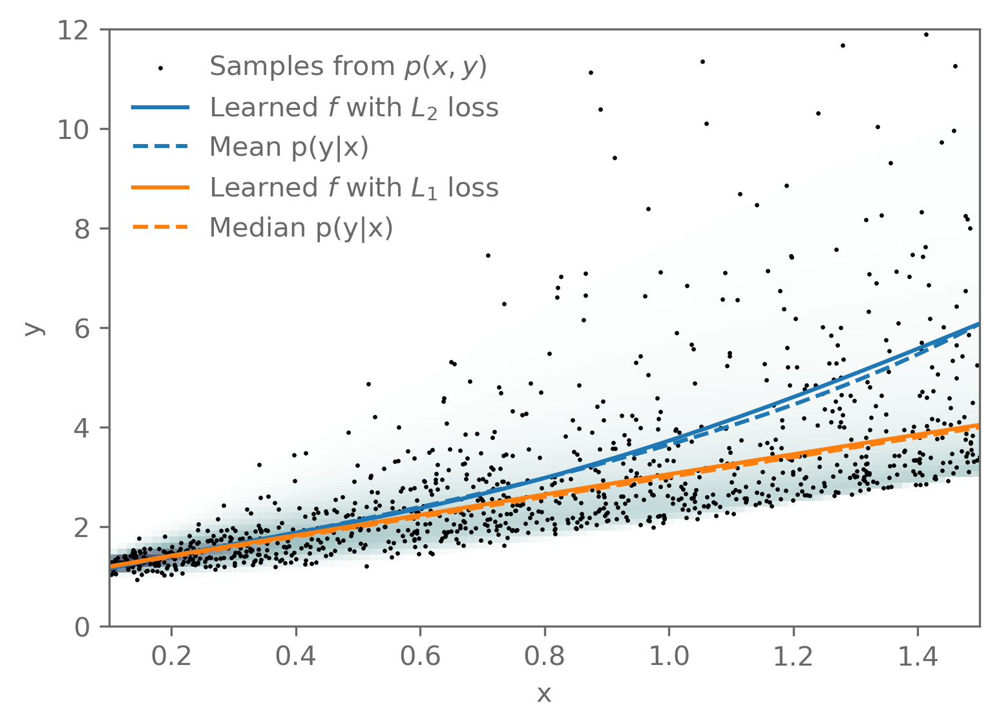

In [146]:
x_test = jnp.linspace(0.1, 1.5, 30)
mean_y_test = distr(x_test).mean()
median_y_test = distr(x_test).median()

L1_predictions_test = L1_trained_model(x_test[:, None])
L2_predictions_test = L2_trained_model(x_test[:, None])

fig, ax = plt.subplots(1, 1)
ax.scatter(x, y, s=0.4, color="black", label="Samples from $p(x, y)$")

ax.plot(x_test, L2_predictions_test, ls="-", c="C0", label="Learned $f$ with $L_2$ loss")
ax.plot(x_test, mean_y_test, c="C0", ls="--", label="Mean p(y|x)")
ax.plot(x_test, L1_predictions_test, ls="-", c="C1", label="Learned $f$ with $L_1$ loss")
ax.plot(x_test, median_y_test, c="C1", ls="--", label="Median p(y|x)")


ax.legend(frameon=False)

x_grid = np.linspace(0.1, 1.5, 100)
y_grid = np.linspace(0, 12, 100)
pdf_grid = distr(x_grid).pdf(y_grid[:,None])
ax.imshow(
    pdf_grid,
    origin="lower",
    extent=(min(x_grid), max(x_grid), min(y_grid), max(y_grid)),
    cmap="bone_r"
)
ax.set_aspect(0.08)

ax.set_xlabel("x")
ax.set_ylabel("y");

How does this approach of minimising a loss function compare to what we have been doing in the Bayesian context? For example, finding the maximum of the posterior?

The mode $\theta^*$ of the posterior $p(\theta|x, y)$ is
$$
    \theta^* = \underset{\theta}{\mathrm{argmax}}\ p(\theta|x, y) \,.
$$


Writing this in terms of the logarithm of the likelihood and prior
$$
    \theta^* = \underset{\theta}{\mathrm{argmax}}\left[ \log p(y | x, \theta) + \log p(\theta | x) \right] \,.
$$

Or equivalently
$$
    \theta^* = \underset{\theta}{\mathrm{argmin}}\left[ -\log p(y | x, \theta) -\log p(\theta | x) \right] \,.
$$



This can be seen as minimising a loss function (the negative log-likelihood) with a regularisation term (the negative log-prior).

In case of a Gaussian likelihood, this corresponds to a (weighted) $L_2$ loss.

We have seen that using the $L_2$ loss yields a function $f_\theta(x)$ that approximates the mean of the conditional data distribution $p(y | x)$.

What loss function do we need to use to get an approximation of the mode? Or better yet, the full distribution?



Instead of having our neural network predict a point estimate of $y$ given $x$, we have the network predict a distribution $q(y|x)$ of $y$ given $x$. 

We achieve this by having the network $f_\theta(x)$ predict parameters $\phi$ based on the input $x$, which parametrise the distribution $q_\phi(y|x)$.


We then optimise the network using the KL loss from the discussion on conditional density estimation:
$$
    L_\mathrm{KL}(x, y) = -\frac{1}{n}\sum_i \log q_{\phi = f(x)}(y_i)
$$

Here we use a Gaussian mixture model again for $q_\phi$. There are more flexible options, such as normalising flows as well but these are a bit more involved to implement.

In [147]:
def NLL_loss_fn(params, model, x, y):
    q = model.apply(params, x)
    # Compute the negative log likelihood of the outputs
    nll = - q.log_prob(y[:, 0])
    return jnp.mean(nll)

In [148]:
# We need to adapt our model a bit to make the output a distribution.
class MDN(nn.Module):
    n_hidden: int = 128
    n_components: int = 8
    n_output: int = 1

    @nn.compact
    def __call__(self, x):
        x = nn.Dense(features=self.n_hidden)(x)
        x = nn.swish(x)
        x = nn.Dense(features=self.n_hidden)(x)
        x = nn.swish(x)
        x = nn.tanh(nn.Dense(features=self.n_components)(x))

        # Predict the weights, means, and standard deviations of the 
        # Gaussian mixture model
        categorical_logits = nn.Dense(self.n_components)(x)
        loc = nn.Dense(self.n_components)(x)
        scale = nn.softplus(nn.Dense(self.n_components)(x))

        # Build the distribution based on these parameters
        dist = tfd.Independent(
            tfd.MixtureSameFamily(
                mixture_distribution=tfd.Categorical(logits=categorical_logits),
                components_distribution=tfd.Normal(loc=loc, scale=scale)
            )
        )
        return dist

In [149]:
model = MDN(n_components=16)

params, loss = train(model, NLL_loss_fn, n_iter=1000, seed=jax.random.PRNGKey(42))
NLL_trained_model = model.bind(params)

  0%|          | 0/2000 [00:00<?, ?it/s]

100%|██████████| 2000/2000 [00:08<00:00, 247.38it/s, loss=0.9764868] 


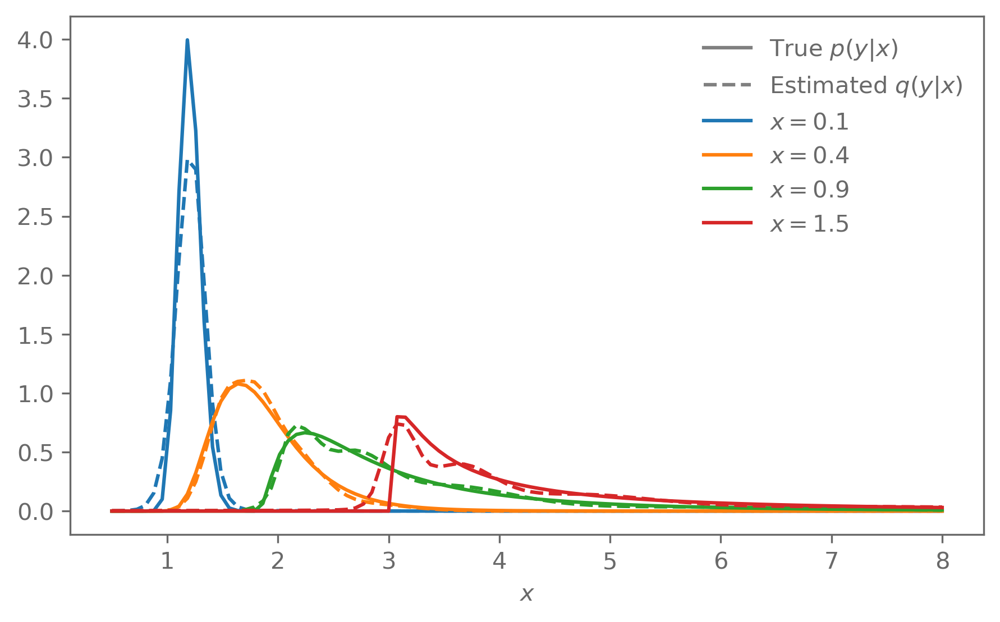

In [150]:
y_grid = np.linspace(0.5, 8, 100)

plt.plot([], [], c="grey", label="True $p(y|x)$")
plt.plot([], [], c="grey", ls="--", label="Estimated $q(y|x)$")

for i, x_test in enumerate([0.1, 0.4, 0.9, 1.5]):
    q = NLL_trained_model([x_test])
    plt.plot(y_grid, distr(x_test).pdf(y_grid), c=f"C{i}", label="$x =$" + f"{x_test}")
    plt.plot(y_grid, np.exp(q.log_prob(y_grid)), c=f"C{i}", ls="--")

plt.legend()
plt.xlabel("$x$");

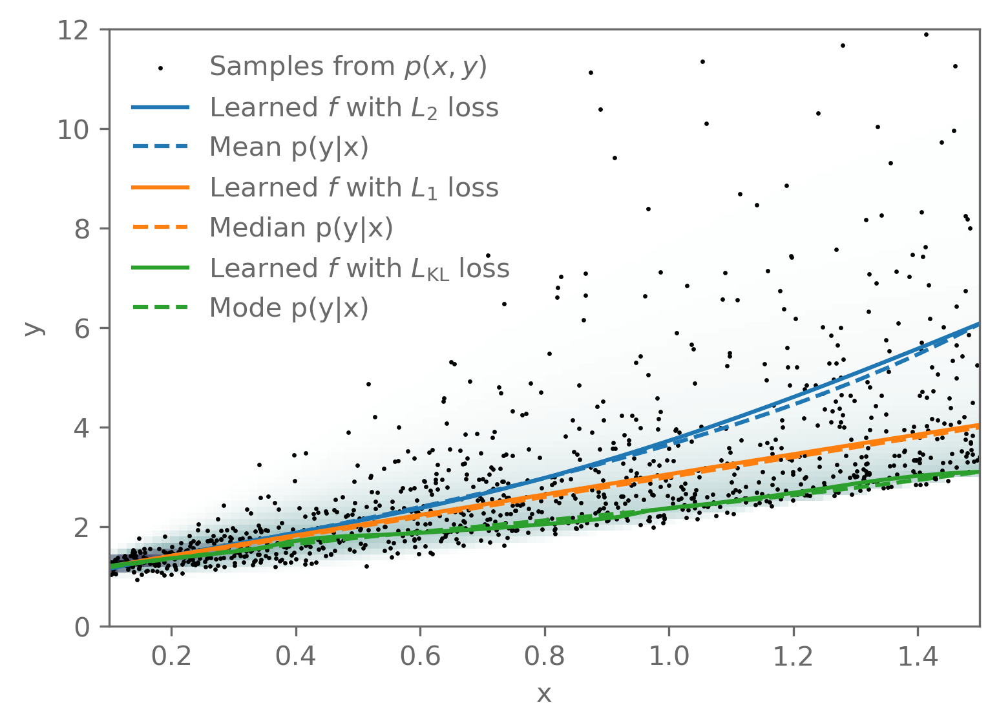

In [151]:
def mode_grid(x):
    q = NLL_trained_model(x[:, None])
    y_grid = np.linspace(0.2, 5, 500)
    log_prob = q.log_prob(y_grid[:, None])
    
    return y_grid[jnp.argmax(log_prob, axis=0)]

x_test = jnp.linspace(0.1, 1.5, 30)
mean_y_test = distr(x_test).mean()
median_y_test = distr(x_test).median()
mode_y_test = distr(x_test).mode()

L1_predictions_test = L1_trained_model(x_test[:, None])
L2_predictions_test = L2_trained_model(x_test[:, None])
NLL_predictions_test = mode_grid(x_test)

fig, ax = plt.subplots(1, 1)
ax.scatter(x, y, s=0.4, color="black", label="Samples from $p(x, y)$")

ax.plot(x_test, L2_predictions_test, ls="-", c="C0", label="Learned $f$ with $L_2$ loss")
ax.plot(x_test, mean_y_test, c="C0", ls="--", label="Mean p(y|x)")
ax.plot(x_test, L1_predictions_test, ls="-", c="C1", label="Learned $f$ with $L_1$ loss")
ax.plot(x_test, median_y_test, c="C1", ls="--", label="Median p(y|x)")
ax.plot(x_test, NLL_predictions_test, ls="-", c="C2", label="Learned $f$ with $L_\mathrm{KL}$ loss")
ax.plot(x_test, mode_y_test, c="C2", ls="--", label="Mode p(y|x)")

ax.legend(frameon=False)

x_grid = np.linspace(0.1, 1.5, 100)
y_grid = np.linspace(0, 12, 100)
pdf_grid = distr(x_grid).pdf(y_grid[:,None])
ax.imshow(
    pdf_grid,
    origin="lower",
    extent=(min(x_grid), max(x_grid), min(y_grid), max(y_grid)),
    cmap="bone_r"
)
ax.set_aspect(0.08)

ax.set_xlabel("x")
ax.set_ylabel("y");

## Exercise

Show that the function that minimises the $L_1$ loss is the median.

Try the neural network predictor on the toy data sets we looked at so far. Does it work with few samples? How many data points do you need for it to work reliably? You can reuse the function from the ABC exercise to create new data points.


### Project idea

In this [Google colab notebook](https://colab.research.google.com/drive/1A9wG9UVIRbWjxtM5XzDO3Sqc-aY5TzLJ) is a demonstration on how to use these methods to estimate the mass of galaxy clusters from the number of galaxies and their velocity dispersion.
A possible project would be to work through this yourself as well as the associated paper that goes into more of the details.

## Master's thesis project FS25: regularising neural density estimation with Bayesian neural networks

In simulation-based inference, running the simulations can be very expensive, so few data points are available to estimate probability densities from. 
This project, we will look at some approaches on how the density estimation can be regularised by using Bayesian neural networks to account for the uncertainty in the neural density estimation.

Literature:
- https://arxiv.org/abs/2207.08435
- https://arxiv.org/abs/2408.15136

In [1]:
import numpy as np
import scipy.stats
import scipy.optimize

import matplotlib.pyplot as plt

import emcee

import jax
jax.config.update("jax_enable_x64", True)

import jax.random as random
import jax.numpy as jnp
from jax.lax import cond
from jax import jit, hessian, vmap

import jaxopt

import tensorflow_probability.substrates.jax as tfp
tfd = tfp.distributions

import getdist
import getdist.plots

import bayesian_stats_course_tools.analyse
from bayesian_stats_course_tools.plotting import plot_contours

import warnings
warnings.simplefilter("ignore")

In [2]:
title = "# Interpreting posteriors and recap"
# Print title and setup TeX defs for both KaTeX and MathJax
import bayesian_stats_course_tools
bayesian_stats_course_tools.misc.display_markdown_and_setup_tex(title)

import matplotlib.style
matplotlib.style.use("bayesian_stats_course_tools.light")

# Interpreting posteriors and recap

<!-- Define LaTeX macros -->
$\def\E{\operatorname{E}}$
$\def\Var{\operatorname{Var}}$
$\def\Cov{\operatorname{Cov}}$
$\def\dd{\mathrm{d}}$
$\def\ee{\mathrm{e}}$
$\def\Norm{\mathcal{N}}$
$\def\Uniform{\mathcal{U}}$

<!-- MathJax needs them to be defined again for the non-inline environment -->
$$\def\E{\operatorname{E}}$$
$$\def\Var{\operatorname{Var}}$$
$$\def\Cov{\operatorname{Cov}}$$
$$\def\dd{\mathrm{d}}$$
$$\def\ee{\mathrm{e}}$$
$$\def\Norm{\mathcal{N}}$$
$$\def\Uniform{\mathcal{U}}$$

We have evaluated and sampled a few posteriors so far. As Bayesians, that is the end-goal, since the full posterior distribution is what we care about.

In practice, we need to summarise the posterior in a form that allows it to be represented on a sheet of paper.



- Mode of the posterior 
    - pro: summary of the full $n$-dimensional joint posterior
    - con: point estimate, uncertainty is hard to define in practice
- Credible intervals
    - pro: intuitive interpretation, can be put in a table
    - con: only applies to 1D (marginal) distributions, can suffer from projection effects
- Corner plots
    - pro: more information than credible intervals due to showing 2D marginals as well
    - con: still only marginals, can suffer from projection effects

#### Credible interval or region

A credible region for a probability distribution $p(x)$ is a set $\Omega(\alpha)$ such that the probability enclosed within that region is $1-\alpha$:
$$
    \int_{\Omega(\alpha)} p(x)\dd x = 1 - \alpha\,.
$$

There are infinitely many ways to define such regions but two common ones are 
- equal-tail intervals
- highest posterior density intervals

The equal-tail interval $(x_\mathrm{L}, x_\mathrm{R})$ is defined by requiring the tails of the distribution to each contain $\frac{\alpha}{2}$ of the total probability. 
$$
    \mathrm{CDF}(x_\mathrm{L}) = \frac{\alpha}{2}, \quad 1-\mathrm{CDF}(x_\mathrm{R}) = 1-\frac{\alpha}{2}
$$

The equal-tail interval is centred on the median of $p(x)$. The equal-tail interval has the advantage that it is easy to compute, for example from samples from a posterior.

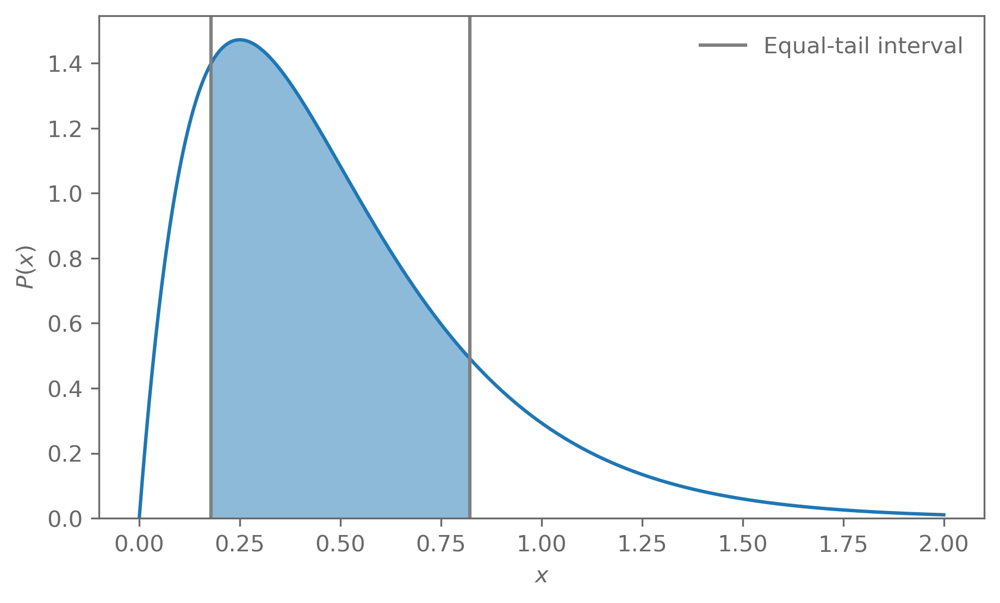

In [3]:
distr = scipy.stats.gamma(a=2, scale=1/4)

alpha = 1-0.68

x = np.linspace(0, 2, 500)

ci = distr.ppf(alpha/2), distr.ppf(1 - alpha/2)

plt.plot(x, distr.pdf(x))
x_ci = np.linspace(ci[0], ci[1], 100)
plt.fill_between(x_ci, 0, distr.pdf(x_ci), alpha=0.5)

plt.axvline(x=ci[0], c="grey", label="Equal-tail interval")
plt.axvline(x=ci[1], c="grey")

plt.ylim(bottom=0)

plt.xlabel("$x$")
plt.ylabel("$P(x)$")

_ = plt.legend()

The highest-density interval (or region) is defined as the region for which $p(x)$ is above a threshold $c_\alpha$, such that
$$
    \int_{\Omega(\alpha)} p(x)\dd x = 1 - \alpha\,,
$$
where
$$
    \Omega(\alpha) = \{x| p(x) > c_\alpha\}\,.
$$



The highest-density regions are the smallest possible credible region that can be defined. It is centred on the mode of $p(x)$.

The downside is that it is more complicated to compute (even in 1D). 

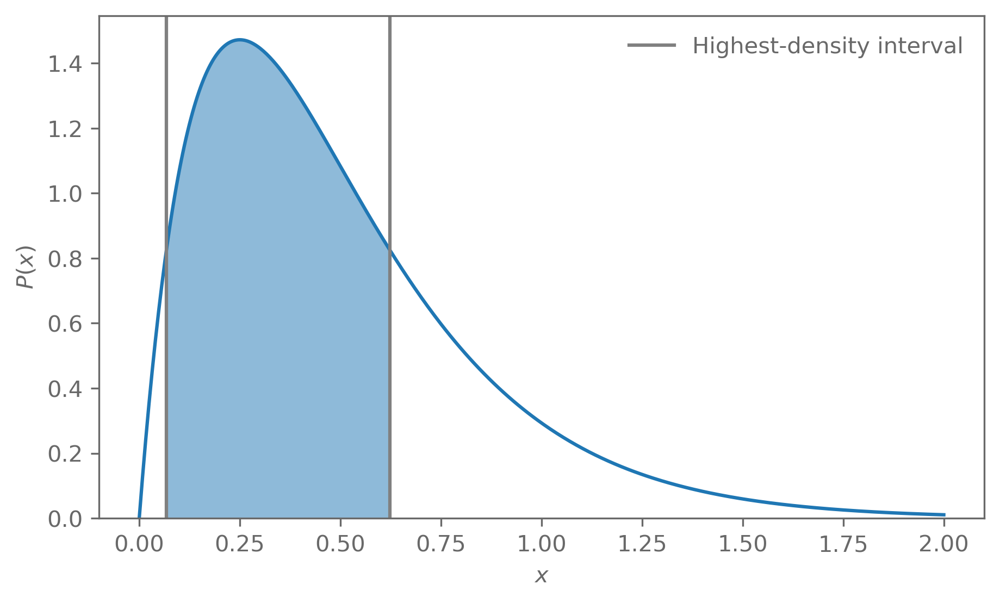

In [4]:
def find_ci(alpha, pdf_fn, mode, support):
    def c_to_alpha(c):
        ci_L = scipy.optimize.root_scalar(
            f=lambda x: c-pdf_fn(x),
            bracket=(support[0], mode)).root
        ci_R = scipy.optimize.root_scalar(
            f=lambda x: c-pdf_fn(x),
            bracket=(mode, support[1])).root
        alpha = distr.cdf(ci_R) - distr.cdf(ci_L)
        return alpha, (ci_L, ci_R)
    
    min_c = max(pdf_fn(support[0]), pdf_fn(support[1]))

    c = scipy.optimize.root_scalar(
        f=lambda c: c_to_alpha(c)[0] - alpha,
        bracket=(min_c, pdf_fn(mode))).root
    
    return c_to_alpha(c)[1]

mode = scipy.optimize.minimize(lambda x: -distr.logpdf(x), x0=1.0).x.squeeze()

ci = find_ci(alpha=0.68, pdf_fn=distr.pdf, mode=mode, support=(0, 2))

plt.plot(x, distr.pdf(x))
x_ci = np.linspace(ci[0], ci[1], 100)
plt.fill_between(x_ci, 0, distr.pdf(x_ci), alpha=0.5)

plt.axvline(x=ci[0], c="grey", label="Highest-density interval")
plt.axvline(x=ci[1], c="grey")

plt.ylim(bottom=0)

plt.xlabel("$x$")
plt.ylabel("$P(x)$")

_ = plt.legend()


<img style="display: block; 
    margin-left: auto;
    margin-right: auto;
    width: 70%;"
    src="../assets/hpd_animation.gif" alt="HPD"/>

#### Projection effects

Once we have more than 2 dimensions in our posterior, we can only visualise marginal distributions of it (unless you use a fancy 3D plotting library).

These marginal distributions can behave in unintuitive ways when the posterior is not symmetric and Gaussian.

In [5]:
def model(x, a, b, c, d):
    x0=0.5
    return a + b * x * ((1+x)/(1+x0))**c * ((1+x**2)/(1+x0**2))**d

In [6]:
a_prior = tfd.Uniform(low=-10, high=10)
b_prior = tfd.Uniform(low=-10, high=10)
c_prior = tfd.Uniform(low=-1000, high=1000)
d_prior = tfd.Uniform(low=-1000, high=1000)


# Generate synthetic data
np.random.seed(42)
x = jnp.linspace(0, 1, 10)
true_params = [2, 0.1, 0, 0]
y = model(x, *true_params)
y_err = 0.05 * jnp.ones_like(y)


def create_likelihood_distribution(model, y_err):
    def distr(params, x):
        mu = model(x, *params)
        return tfd.MultivariateNormalDiag(loc=mu, scale_diag=y_err)

    return distr


def log_likelihood(params):
    return create_likelihood_distribution(model=model, y_err=y_err)(params, x).log_prob(y)

def log_prior(params):
    return a_prior.log_prob(params[0]) + b_prior.log_prob(params[1]) + c_prior.log_prob(params[2]) + d_prior.log_prob(params[3])

# Define the log posterior
def log_posterior(params):
    return log_likelihood(params) + log_prior(params)


In [7]:
params_initial = jnp.array([1.0, 1.0, 1.0, 1.0])
param_names = ["a", "b", "c", "d"]

solver = jaxopt.ScipyMinimize(fun=jit(lambda x: -log_posterior(x)), method="L-BFGS-B")
solution = solver.run(params_initial)
MAP_params = solution.params
cov = jnp.linalg.inv(-hessian(log_posterior)(MAP_params))

print("Model 1")
for name, p, p_std, p_true in zip(param_names, MAP_params, np.sqrt(np.diag(cov)), true_params):
    print(f"{name} = {p:.2f} ± {p_std:.2f} (truth: {p_true:.2f})")


Model 1
a = 2.00 ± 0.05 (truth: 2.00)
b = 0.10 ± 0.11 (truth: 0.10)
c = 0.28 ± 18.64 (truth: 0.00)
d = -0.17 ± 11.37 (truth: 0.00)


In [8]:

# Set up the initial parameters for the MCMC
initial_params = np.array([1.0, 1.0, 1.0, 1.0])
ndim = len(initial_params)
nwalkers = 32
nsteps = 10000

# Set up the sampler
sampler = emcee.EnsembleSampler(nwalkers, ndim, jit(vmap(log_posterior)), vectorize=True)

# Initialize the walkers
p0 = np.random.normal(initial_params, scale=0.1, size=(nwalkers, ndim))

# Run the MCMC
sampler.run_mcmc(p0, nsteps, progress=True)

max_autocorr = max(sampler.get_autocorr_time())
# Extract the samples
samples = sampler.get_chain(discard=int(5*max_autocorr), thin=int(max_autocorr/2), flat=True)

100%|██████████| 10000/10000 [00:03<00:00, 2667.46it/s]


In [9]:
getdist_samples = getdist.MCSamples(
    samples=samples,
    names=param_names,
    label="Model 1",
    ranges={"c": (-1000, 1000), "d": (-1000, 1000)}
)

Removed no burn in


In [10]:
g = getdist.plots.get_single_plotter()

<Figure size 1800x1350 with 0 Axes>

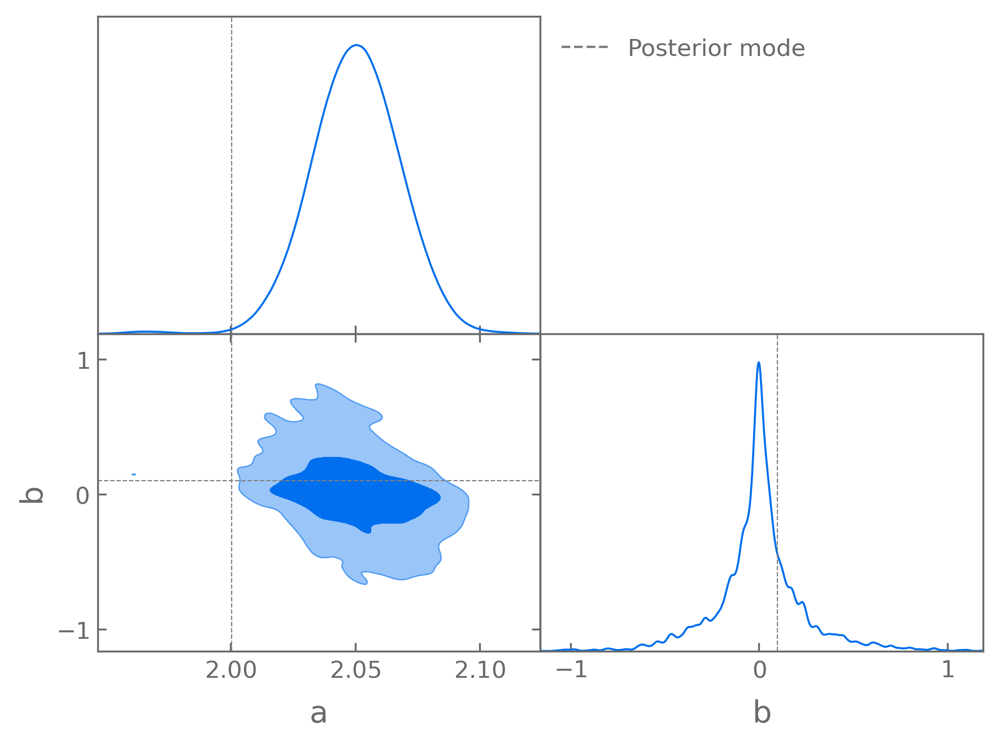

In [11]:
g.triangle_plot([getdist_samples],
                params=["a", "b"],
                filled=True,
                markers={k: v for k, v in zip(param_names, MAP_params)})

g.subplots[0,0].plot([],[], **{"lw" : 1.0, "ls" : "--", "c" : "k", "alpha" : 0.5}, label="Posterior mode")
g.subplots[0,0].legend(frameon=False, loc=2, bbox_to_anchor=(1,1));

In [12]:
g = getdist.plots.get_single_plotter()

<Figure size 1800x1350 with 0 Axes>

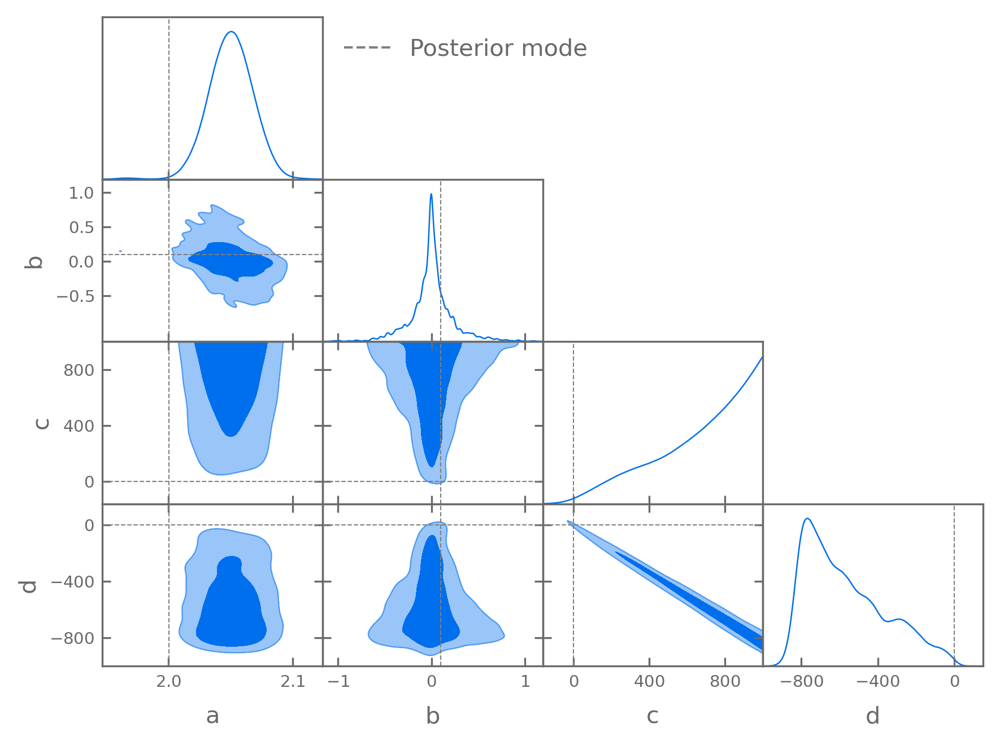

In [13]:
fig = g.triangle_plot([getdist_samples], filled=True,
                 markers={k: v for k, v in zip(param_names, MAP_params)})
g.subplots[0,0].plot([],[], **{"lw" : 1.0, "ls" : "--", "c" : "k", "alpha" : 0.5}, label="Posterior mode")
g.subplots[0,0].legend(frameon=False, loc=2, bbox_to_anchor=(1,1));

The model here is
$$
    \mu = a + bx  \left(\frac{1+x}{1 + x_0}\right)^c \left(\frac{1+x^2}{1 + x_0^2}\right)^d\,,
$$
for parameters $a$, $b$, $c$, $d$, with $x_0=0.5$.

When $b\approx 0$, the terms involving $c$ and $d$ do not contribute to the model anymore and $c$ and $d$ are not constrained.

Depending on how the prior is chosen, this can lead to large volumes of posterior space where $b\approx 0$.

When projecting the posterior into marginal distributions, this leads to marginals that are not centred on the mode of the joint posterior.

This can be seen with very skewed distributions even in 2 dimensions:

In [14]:
def log_p(p):
    x, y = p
    if y < 0 or x < 0 or y > x or y < x/2:
        return -np.inf
    
    return -(x+y)**2

theta_fid = (0.5, 0.5)
nwalkers = 32
ndim = len(theta_fid)

n_sample = 12000
burn_in = 2000

sampler = emcee.EnsembleSampler(nwalkers, ndim, log_p)

sampler.run_mcmc(np.random.normal(loc=0, scale=0.1, size=(nwalkers,ndim))+theta_fid, n_sample, progress=True)
max_autocorr = max(sampler.get_autocorr_time())

samples = getdist.MCSamples(name_tag="Full",
                            samples=sampler.get_chain(flat=True, discard=int(5*max_autocorr), thin=int(max_autocorr/2)),
                            names=["theta0", "theta1"], labels=["x", "y"],
                            ranges={"theta0" : [0,4], "theta1" : [0,4],}
                                   )

100%|██████████| 12000/12000 [00:02<00:00, 4749.10it/s]

Removed no burn in


In [15]:
MAP = [0,0]

samples.smooth_scale_1D = 0.2
samples.smooth_scale_2D = 0.2

g = getdist.plots.get_single_plotter()
g.settings.legend_frame = False


<Figure size 1800x1350 with 0 Axes>

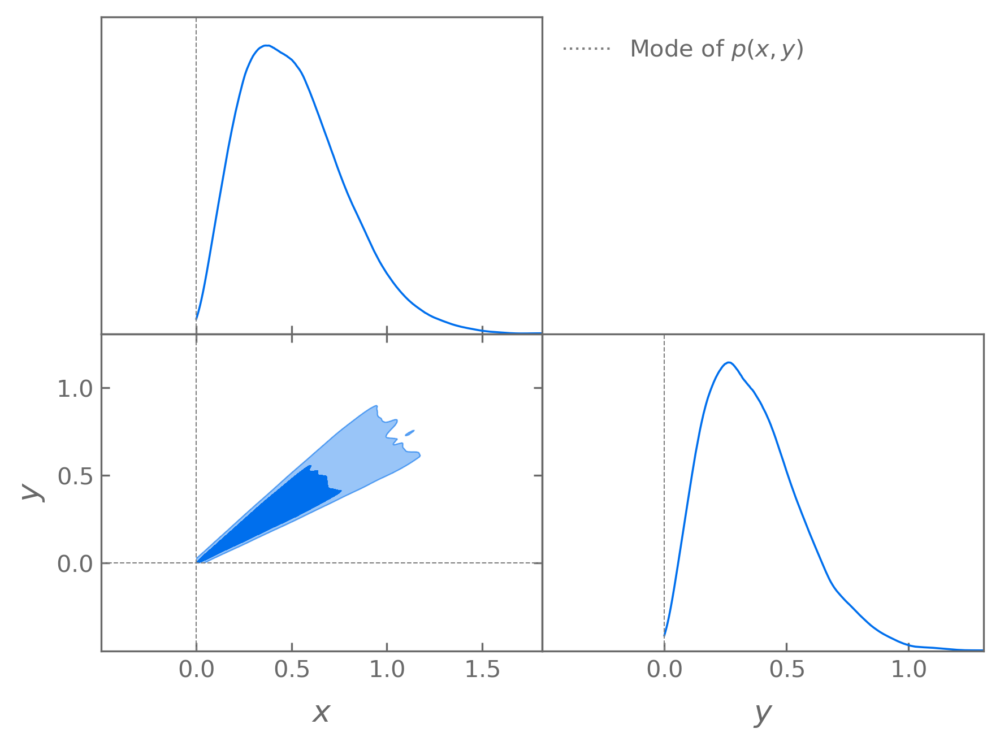

In [16]:

g.triangle_plot([samples],
                filled_compare=True,
                params=["theta0", "theta1"],
                markers={"theta0" : MAP[0], 
                         "theta1" : MAP[1],
                         },
               )

g.subplots[0,0].set_xlim(left=-0.5)
g.subplots[1,1].set_xlim(left=-0.5)

g.subplots[0,0].plot([],[], **{"lw" : 1.0, "ls" : ":", "c" : "k", "alpha" : 0.5}, label="Mode of $p(x, y)$")
g.subplots[0,0].legend(frameon=False, loc=2, bbox_to_anchor=(1,1));

## The Bayesian data analysis workflow


1. Model the data generating process probabilistically.
    1. Understand the data
        - PCA
        - Bootstrap
        - Correlations
    2. Model the data & build a likelihood
        - Estimators
        - Non-Gaussian likelihoods
        - Fisher information & forecasts
        - Jeffreys prior

2. Condition the generative process on the observed data.
    - Sampling the posterior
        - MCMC (Metropolis-Hastings, slice sampling, Hamiltonian Monte Carlo)
        - Nested sampling
        - Simulation-based inference



3. Check that the results fit the observed data and improve the model.
    1. Goodness of fit
        - Posterior predictive distributions
        - Chi-square test
    2. Compare models
        - Evidences, Bayes' ratio
        - DIC, WAIC

The paper [Bayesian Workflow, Gelman et al. 2021](https://arxiv.org/abs/2011.01808) gives a nice overview of these topics.

## Things we did not cover

- Hierarchical modelling
- Random walks
- Charateristic functions, proof central limit theorem
- Importance sampling
- Gaussian processes & Gaussian random fields
- Non-Gaussian likelihoods
- Classification, AUROC

## An analysis of the Pantheon+ SH0ES supernovae data set

Here we reproduce the main cosmological constraints from the paper [The Pantheon+ Analysis: Cosmological Constraints](https://arxiv.org/abs/2202.04077) by Brout et al. 2022.

The main work of the paper is producing and characterising the data and the cosmological analysis can be done relatively easily.

In [17]:
import sys
sys.path.append("../projects/dark_energy_SN/")
from jax_likelihood import JAXPantheonSH0ESDataModel

# This holds the data and takes care of the modelling
pantheon_sh0es = JAXPantheonSH0ESDataModel(
    data_file_name="../projects/dark_energy_SN/data/pantheon_sh0es.npz",
)

Plot the data.

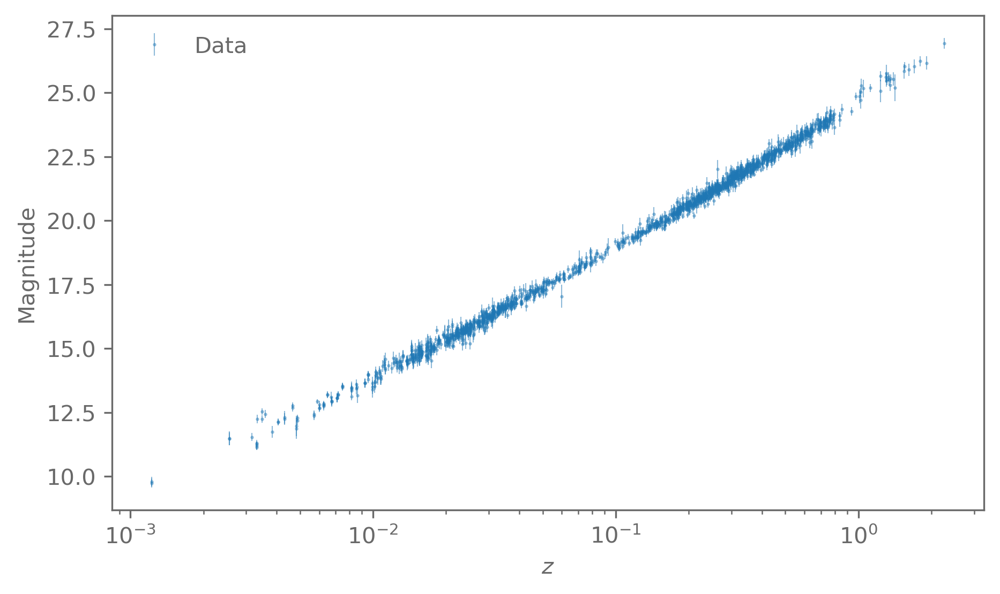

In [18]:
# A helper function to plot the data
def plot_data(models=None, data=None, subtract_y=None):
    sort_idx = np.argsort(pantheon_sh0es.z)
    x = pantheon_sh0es.z
    y = pantheon_sh0es.data
    y_err = pantheon_sh0es.data_error

    fig, ax = bayesian_stats_course_tools.analyse.plot_data(
        x=x[sort_idx], y=y[sort_idx], y_err=y_err[sort_idx],
        fmt=".", markersize=1, alpha=0.5, elinewidth=0.5,
        models=models, subtract_y=subtract_y,
        axis_labels=["$z$", "Magnitude"]
    )
    ax.set_xscale("log")
    return fig, ax

plot_data();

Define the model and the likelihood.

The model is relatively simple here. It mostly computes the distance given a redshift and from that the magnitude.

As in the paper we assume a Gaussian likelihood:

In [23]:
# We use a Gaussian likelihood
# To make sampling easier later on, we use the
# tensorflow-probability implementation
def create_likelihood_distribution(params):
    mu = pantheon_sh0es.model(params)

    return tfd.MultivariateNormalTriL(
        loc=mu, scale_tril=pantheon_sh0es.covariance_cholesky.astype(jnp.float64)
    )

In [24]:
# Set up some initial parameters
param_names = ["Omega_m", "H0", "M"]
param_labels = [r"\Omega_m", "H_0", "M"]

params_initial = dict(
    Omega_m=0.3, H0=70.0, M=-19.0
)
# Some functions require an array instead of a dict
params_initial_flat = jnp.array([params_initial[i] for i in param_names])

initial_likelihood = create_likelihood_distribution(params_initial)

# Create a mock data vector from the likelihood
key, subkey = random.split(random.PRNGKey(42))
mock_data = initial_likelihood.sample(seed=subkey)

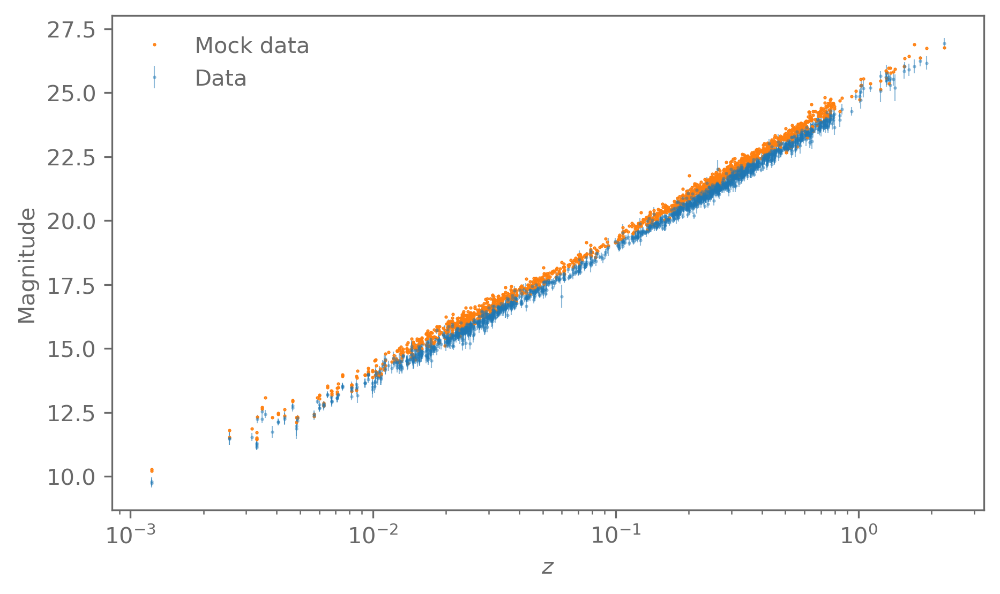

In [25]:
plot_data(models=[
    dict(x=pantheon_sh0es.z, y=mock_data,
         style=dict(ls="none", marker=".", ms=1, label="Mock data"))]
);

Now that we have defined a likelihood, let us make some forecasts on what the parameter constraints will look like user Fisher information matrices.

In [26]:
# Define a function that evaluates the log likelihood at a set of parameters,
# for a fixed datavector
def log_likelihood_fixed_data(params):
    log_L = create_likelihood_distribution(
        params
    ).log_prob(mock_data)
    return log_L

# Use JAX's autodiff tools to get the Hessian of the log likelihood
log_likelihood_hessian = jit(hessian(log_likelihood_fixed_data))

In [27]:
# Evaluate the Hessian and put it into a matrix form
# We need to do this because the parameters are a dict here.
# If they were in a flat array, we would get a matrix directly
log_likelihood_hessian_matrix = log_likelihood_hessian(params_initial)
fisher_matrix = -jnp.array(
    [[log_likelihood_hessian_matrix[i][j] for i in param_names]
     for j in param_names]
)

Expected uncertainty on Omega_m: 0.018
Expected uncertainty on H0: 1.03


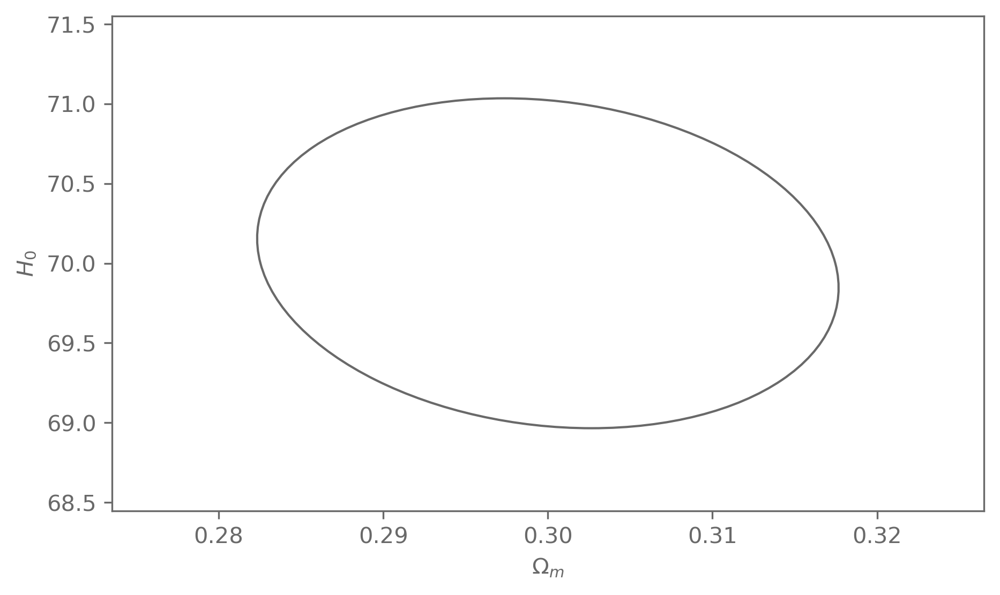

In [28]:
cov = np.linalg.inv(fisher_matrix)
ax = plot_contours(cov=cov[:2, :2], pos=params_initial_flat[:2], fill=False)
ax.set_xlabel("$\Omega_m$")
ax.set_ylabel("$H_0$")

print(f"Expected uncertainty on Omega_m: {np.sqrt(cov[0,0]):.3f}")
print(f"Expected uncertainty on H0: {np.sqrt(cov[1,1]):.2f}")

Now define our priors and posterior to do things like finding the MAP and sampling from the posterior.

In [29]:
H_0_prior = tfd.Uniform(low=55, high=91)
Omega_m_prior = tfd.Uniform(low=0.1, high=0.9)
M_prior = tfd.Uniform(low=-20, high=-18)

def log_prior(params):
    return (
        H_0_prior.log_prob(params["H0"]) 
        + Omega_m_prior.log_prob(params["Omega_m"]) 
        + M_prior.log_prob(params["M"])
    )

def log_posterior(params, data):
    likelihood = create_likelihood_distribution(params)
    return likelihood.log_prob(data) + log_prior(params)

Because we are using JAX, we can just-in-time compile the posterior function, making it fast.


In [30]:
%timeit jit(log_posterior)(params_initial, pantheon_sh0es.data).block_until_ready()

7.35 ms ± 2.11 ms per loop (mean ± std. dev. of 7 runs, 1 loop each)


Find the MAP.

In [31]:
# We minimise the negative log posterior to find the maximum of the posterior
def neg_log_posterior(params, data):
    return -log_posterior(params, data)

solver = jaxopt.ScipyMinimize(fun=jit(neg_log_posterior), method="L-BFGS-B")
solution = solver.run(params_initial, data=pantheon_sh0es.data)
MAP_params = solution.params

print("MAP")
for name, value in MAP_params.items():
    print(f"{name} = {value:.3f}")

MAP
H0 = 73.739
M = -19.244
Omega_m = 0.326


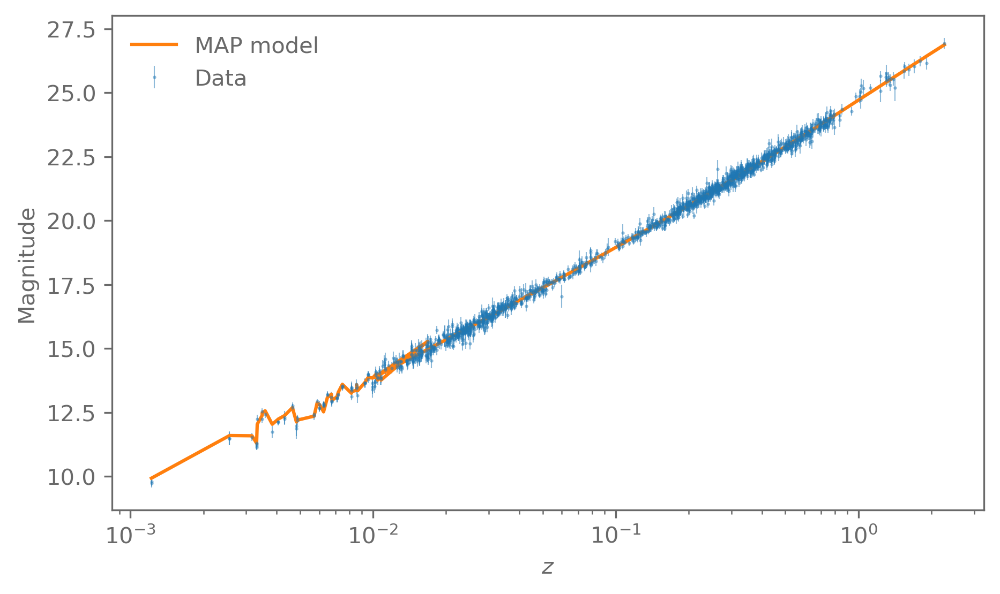

In [32]:
plot_data(
    models=[dict(x=pantheon_sh0es.z, y=pantheon_sh0es.model(MAP_params), style=dict(label="MAP model"))]
);

Now to sampling from the posterior. 

Here we use emcee to do the sampling. This wastes some of potential from JAX by not using gradients but the combination of vectorising the posterior evaluation and just-in-time compilation is still very powerful.

In [35]:
# Make wrapper around the posterior so it works with emcee
def log_posterior_wrapper(params):
    log_p = log_posterior(
        dict(Omega_m=params[0], H0=params[1], M=params[2]),
        data=pantheon_sh0es.data
    )
    # Use cond here to allow jit compilation
    log_p = cond(jnp.isfinite(log_p), lambda x: x, lambda x: -jnp.inf, log_p)
    return log_p

# Set the configuration for emcee
n_param = len(params_initial)
n_walker = 3*n_param
n_step = 5000

# Set initial positons for the walkers
params_init_walkers = (
    params_initial_flat + np.random.normal(scale=0.01, size=(n_walker, n_param))
)

sampler = emcee.EnsembleSampler(
    nwalkers=n_walker, ndim=n_param,
    log_prob_fn=jit(vmap(log_posterior_wrapper)),
    vectorize=True
)
state = sampler.run_mcmc(params_init_walkers, nsteps=n_step, progress=True)

100%|██████████| 5000/5000 [01:16<00:00, 65.26it/s]


We now need to check that the chain is well behaved and converged.

First check the integrated auto-correlation time to get a sense of how many independent samples we got in our chain.

In [36]:
# Check the autocorrelation times
print("Integrated auto-correlation time")
for name, iat in zip(param_names, sampler.get_autocorr_time()):
    print(f"{name}: {iat:.1f}")

Integrated auto-correlation time
Omega_m: 47.5
H0: 47.3
M: 42.2


Remove a few auto-correlation times for the burn-in and thin out the chain.

In [37]:
max_autocorr = max(sampler.get_autocorr_time())
burn_in = int(5*max_autocorr)
thin = int(max_autocorr/2)

chain_per_walker = sampler.get_chain(discard=burn_in, thin=thin)
chain = sampler.get_chain(discard=burn_in, thin=thin, flat=True)

Make a trace plot to check for weird chain behaviour.

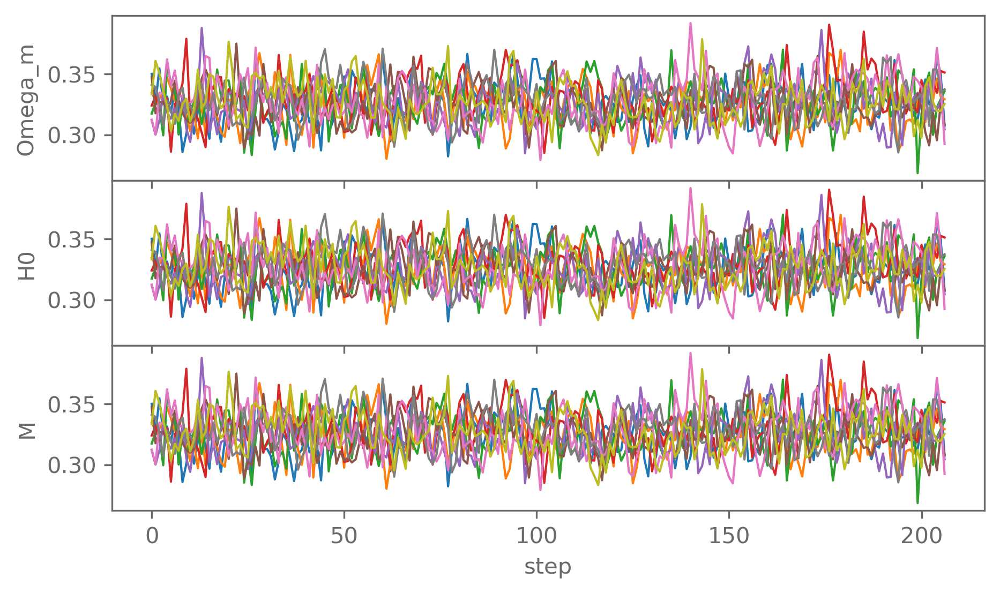

In [38]:

# Plot the tracer of the chain, this time for all the walkers
fig, ax = plt.subplots(len(params_initial), 1, sharex=True)
plt.subplots_adjust(hspace=0)

for i, name in enumerate(param_names):
    for j in range(n_walker):
        ax[i].plot(chain_per_walker[:, j, 0], lw=1, color=f"C{j}")
    ax[i].set_ylabel(name)

ax[-1].set_xlabel("step");

The chain looks good, so now to plot the chain and get summary statistics on the posterior.

We use `getdist` here, since it has a bit more features than `corner` and makes prettier plots.

In [39]:
getdist_samples = getdist.MCSamples(
    samples=chain,
    names=param_names,
    labels=param_labels,
    # We tell getdist what the ranges of the parameters are to avoid plotting
    # artefacts at the boundaries
    ranges={"Omega_m": (0.1, 0.9),
            "H0": (55, 91),
            "M": (-20, -18)},
    label="MCMC samples"
)

Removed no burn in


In [40]:
g = getdist.plots.get_single_plotter()

# Add the Fisher forecast to the plot to see how well we did in forecasting
# the constraints
MAP_params_flat = jnp.array([MAP_params[i] for i in param_names])
fisher_forecast = getdist.gaussian_mixtures.GaussianND(
    mean=MAP_params_flat, cov=cov, names=param_names,
    label="Fisher forecast"
)

<Figure size 1800x1350 with 0 Axes>

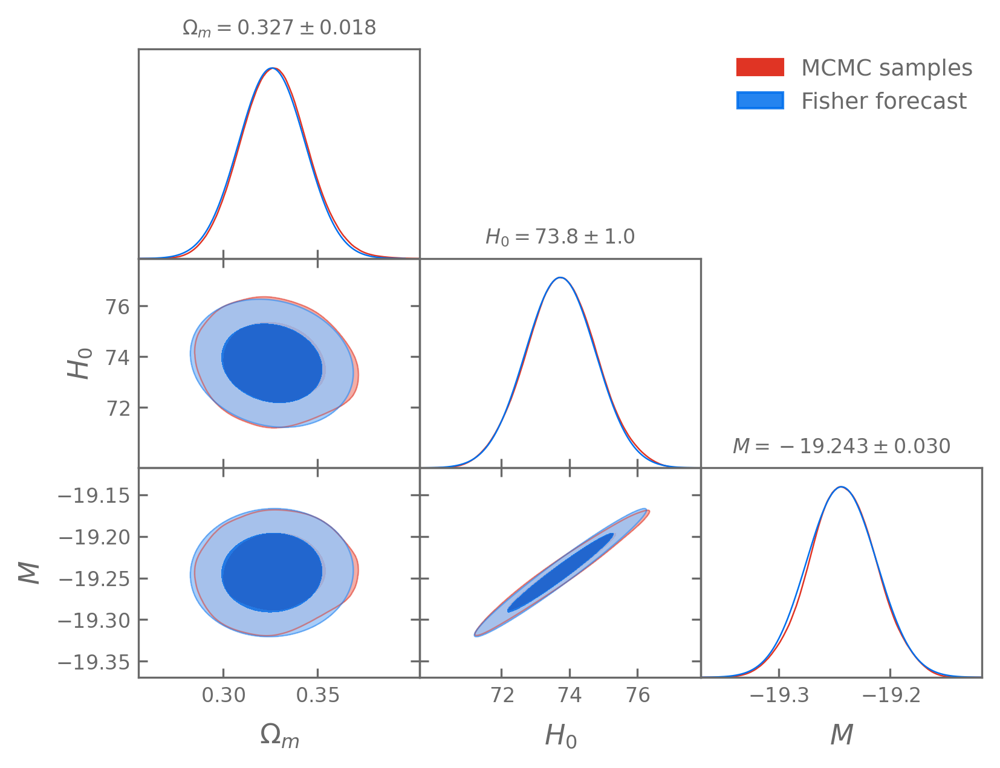

In [41]:
g.triangle_plot([getdist_samples, fisher_forecast], filled=True, title_limit=1)

We need to check that our model fits the data.

We first create samples from the posterior predictive distribution.

In [42]:
# Use 500 samples from the chain
posterior_predictive_samples = chain[np.random.choice(chain.shape[0], 500)]

# Define function that samples the likelihood given a set of parameter
def sample_ppd(params, seed):
    return create_likelihood_distribution(
        dict(Omega_m=params[0], H0=params[1], M=params[2])
    ).sample(seed=seed)

keys = random.split(random.PRNGKey(42), posterior_predictive_samples.shape[0])

# Use JAX vmap to get PPD samples for all the parameter samples
ppd = jit(vmap(sample_ppd))(posterior_predictive_samples, keys)

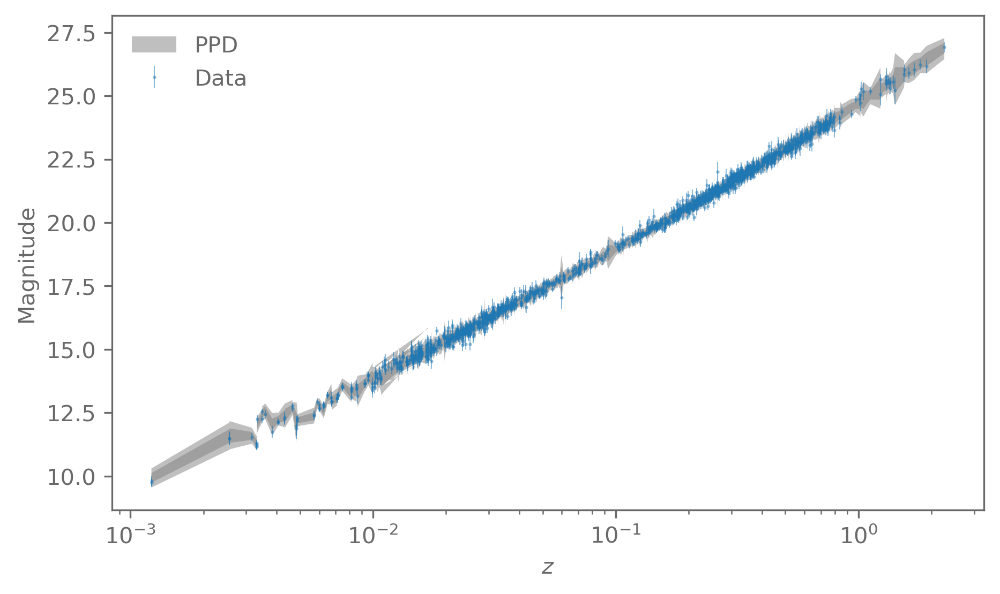

In [43]:
ppd_quantiles = np.quantile(ppd, q=[0.025, 0.16, 0.84, 0.975], axis=0)

plot_data(
    models=[dict(x=pantheon_sh0es.z,
                 lower=ppd_quantiles[0], upper=ppd_quantiles[-1],
                 style=dict(facecolor="grey", alpha=0.5, label="PPD")),
            dict(x=pantheon_sh0es.z,
                 lower=ppd_quantiles[1], upper=ppd_quantiles[-2],
                 style=dict(facecolor="grey", alpha=0.5))],
);

Now check the goodness of fit by comparing a test statistic over the PPD to that to the observed data.

In [44]:
# We use a statistic that basically the chi-square statistic
def test_statistic(data, params):
    chi2 = -2*create_likelihood_distribution(
        dict(Omega_m=params[0], H0=params[1], M=params[2])
    ).log_prob(data)
    return chi2

# vmap makes it easy to get the our samples of the test statistic
t_rep = jit(vmap(test_statistic))(ppd, posterior_predictive_samples)
t_data = jit(vmap(test_statistic, in_axes=[None, 0]))(
    pantheon_sh0es.data, posterior_predictive_samples
)

Find the fraction of where the test statistic on the PPD is larger than on the observed data.

In [45]:
print(f"PTE PPD = {(t_rep > t_data).sum()/t_rep.shape[0]:.3f}")

PTE PPD = 1.000


That does not look too good. The observed data is too likely in a sense.

Let us check the histogram of $T(y^\mathrm{rep},\theta) - T(y^\mathrm{obs},\theta)$.

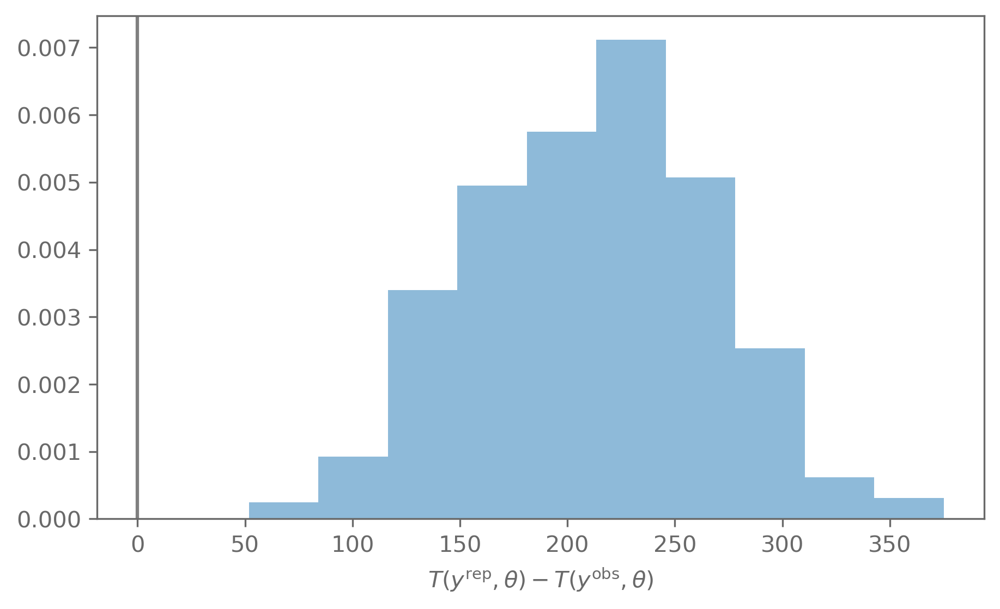

In [46]:
plt.hist(t_rep - t_data, density=True, alpha=0.5)
plt.axvline(0, c="grey")
plt.xlabel(r"$T(y^\mathrm{rep},\theta) - T(y^\mathrm{obs},\theta)$");

This is suspicious. Let us check the $\chi^2$ statistic to see if that gives us a similar result.

In [47]:
import scipy.stats

mu = pantheon_sh0es.model(MAP_params)
r = pantheon_sh0es.data - mu

chi2 = r @ pantheon_sh0es.inverse_covariance @ r

print(f"PTE chi-square: {scipy.stats.chi2(df=pantheon_sh0es.data.shape[0]-3).sf(chi2):.4f}")

PTE chi-square: 0.9999


Something is not right. The first suspect is the covariance.

We used the STAT+SYS covariance here. That means the covariance includes the systematic uncertainty on top of the statistical uncertainty. This could explain the very high PTE on the test statistic.

Doing the analysis with the STATONLY covariance lowers the PTE a little bit but it is still much too high. 



That means we need to go back and have a detailed look at the data and how the covariance is estimated.

For that we might want to focus on different parts of the data. 
For example, the current data vector has parts where the distances are assumed to be known (the Cepheid calibrators), while for the rest the distances are computed based on the parameters and redshifts. 

The data also come from different surveys. We could look at if any of the surveys has data that looks suspicious and does not fit into the model.

Once we have fixed the covariance and get acceptable fits, we can then move on the model comparison.

For example, here we assumed the Universe is spatially flat and that dark energy is a cosmological constant.

We can analyse the same data but with different models to assess whether a Universe with curvature or a form of dark energy with a different equation of state is preferred by the data.

For that we would use nested sampling to get the evidences, and cross-check with the DIC and WAIC information criteria.

## Project and reports

If you want credit points, the grade is going to be based on a small research project & report.
- The goal of the report is to show that you learned something about statistics in this course.
    - This can either cover a data analysis end-to-end, demonstrating the techniques we covered.
    - Alternatively, looking in-depths into an algorithm or the theory behind a statistical tool is also an option.
- Format: like a journal article (specifically a Letter):
    - Professional presentation, i.e. using LaTeX, nice plots
    - Proper references and appropriate structure
    - Page limit of 5 (excluding references)
    - There is a good example report on Moodle
- Group work is allowed. Conditions:
    - Max group size: 5
    - Everyone in the group gets the same grade
    - Everyone needs to contribute to both the report and the analysis
    - The report needs to include a contribution statement that briefly describes what each member has done

Deadline is 2024/07/19 at 23:59 CEST.

The report should be like a mini semester project or MSc thesis.

The structure should follow that of a scientific research article:
- Intro:
    - Context: why is this interesting? Particularly in the context of (Bayesian) statistics.
    - Literature: what have others done?
- Methods:
    - What are you doing in the project? How are you doing it?
- Results:
    - What are the results of the analysis or the tests you have done? How well does your method work?
- Discussion:
    - Why are the results interesting? Any unexpected results? Where to go from here?

# Thanks!

Please fill out the course evaluation & let me know if you have any feedback on what to do differently.

